# Libraries, data and installs

In [1]:
import tensorflow as tf
tf.config.list_physical_devices("GPU")


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [1]:
#!pip3 install visualkeras
!pip3 install -U numpy==1.18.5


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 10.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  error: subprocess-exited-with-error
  
  × Building wheel for numpy (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for numpy
Failed to build numpy
ERROR: Could not build wheels for numpy, which is required to install pyproject.toml-based projects


In [1]:
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
from keras.layers import Input, Dense, Dropout
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Add, Multiply
from keras.layers import ELU, PReLU, LeakyReLU
from keras.models import Model
from keras.utils.vis_utils import plot_model
from tensorflow.keras import optimizers
from keras.optimizers import SGD
from keras.optimizers import Adagrad
from keras import metrics
from sklearn.metrics import r2_score
from keras.callbacks import EarlyStopping
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.layers.experimental.preprocessing import Normalization
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.mobilenet import MobileNet
from tensorflow.keras.applications.densenet import DenseNet121

from tensorflow.keras.layers import GlobalAveragePooling2D

from keras import backend as K

from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import StandardScaler

%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import math as m
import numpy as np
import seaborn as sns
import os
import json

sns.set_style("darkgrid")
edgecolors=None

config = tf.compat.v1.ConfigProto()

config.gpu_options.allow_growth=True

sess = tf.compat.v1.Session(config=config)


Metal device set to: Apple M1

systemMemory: 8.00 GB
maxCacheSize: 2.67 GB



2023-05-03 23:11:33.102895: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-05-03 23:11:33.103659: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [2]:
'''
Nomenclature:

<DATASET-INITIALS><FRUIT-INITIAL><TEST-INITIAL>.csv|.pkl

DATASET-INITIALS:
CG = Classic Geometry
F = Form
C = Color
A = All
CI = Cropped Images

FRUIT-INITIAL:
B = Blueberry
R = Raspberry
S = Strawberry

TEST-INITIAL:
R = Raw
Y = YOLO
D = Detectron2

---------------------

EXAMPLES

CLASSIC GEOMETRY of RASPBERRIES from RAW test
CGRR.csv

CROPPED IMAGES of BLUEBERRIES from YOLO test
CIBY.pkl

---------------------

Cropped images are the only datasets that are saved in a pickle file


'''

#-----------------Blueberries------------------
###############################################
#Blueberries - RAW
#ClassicGeometry
!wget -O CGBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryBlueberriesRaw.csv
#Form
!wget -O FBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsBlueberriesRaw.csv
#Color
!wget -O CBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsBlueberriesRaw.csv
#All
!wget -O ABR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesBlueberriesRaw.csv
#Images
!wget -O CIBR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesRaw.pkl
###############################################
#Blueberries - YOLO
#ClassicGeometry
!wget -O CGBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryYOLOBlue.csv
#Form
!wget -O FBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsYOLOBlue.csv
#Color
!wget -O CBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsYOLOBlue.csv
#All
!wget -O ABY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesYOLOBlue.csv
#Images
!wget -O CIBY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesYOLO.pkl
###############################################
#Blueberries - Detectron2
#ClassicGeometry
!wget -O CGBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2blue.csv
#Form
!wget -O FBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2blue.csv
#Color
!wget -O CBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2blue.csv
#All
!wget -O ABD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2blue.csv
#Images
!wget -O CIBD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================
#-----------------Raspberries------------------
###############################################
#Raspberries - RAW
#ClassicGeometry
!wget -O CGRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryRaspberriesRaw.csv
#Form
!wget -O FRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsRaspberriesRaw.csv
#Color
!wget -O CRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsRaspberriesRaw.csv
#All
!wget -O ARR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesRaspberriesRaw.csv
#Images
!wget -O CIRR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesRaw.pkl
###############################################
#Raspberries - YOLO
#ClassicGeometry
!wget -O CGRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryYOLORasp.csv
#Form
!wget -O FRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsYOLORasp.csv
#Color
!wget -O CRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsYOLORasp.csv
#All
!wget -O ARY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesYOLORasp.csv
#Images
!wget -O CIRY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesYOLO.pkl
###############################################
#Raspberries - Detectron2
#ClassicGeometry
!wget -O CGRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2rasp.csv
#Form
!wget -O FRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2rasp.csv
#Color
!wget -O CRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2rasp.csv
#All
!wget -O ARD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2rasp.csv
#Images
!wget -O CIRD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================
#-----------------Strawberries------------------
###############################################
#Strawberries - RAW
#ClassicGeometry
!wget -O CGSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryStrawberriesRaw.csv
#Form
!wget -O FSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsStrawberriesRaw.csv
#Color
!wget -O CSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsStrawberriesRaw.csv
#All
!wget -O ASR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesStrawberriesRaw.csv
#Images
!wget -O CISR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesRaw.pkl
###############################################
#Strawberries - YOLO
#ClassicGeometry
!wget -O CGSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryStrawberriesYOLO.csv
#Form
!wget -O FSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsStrawberriesYOLO.csv
#Color
!wget -O CSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsStrawberriesYOLO.csv
#All
!wget -O ASY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesStrawberriesYOLO.csv
#Images
!wget -O CISY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesYOLO.pkl
###############################################
#Strawberries - Detectron2
#ClassicGeometry
!wget -O CGSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2straw.csv
#Form
!wget -O FSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2straw.csv
#Color
!wget -O CSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2straw.csv
#All
!wget -O ASD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2straw.csv
#Images
!wget -O CISD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================

%mkdir figures


--2023-05-03 10:18:18--  https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryBlueberriesRaw.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 2606:50c0:8001::154, 2606:50c0:8003::154, 2606:50c0:8000::154, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|2606:50c0:8001::154|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3594 (3.5K) [text/plain]
Saving to: ‘CGBR.csv’

CGBR.csv            100%[===================>]   3.51K  --.-KB/s    in 0.002s  

2023-05-03 10:18:18 (2.17 MB/s) - ‘CGBR.csv’ saved [3594/3594]

--2023-05-03 10:18:18--  https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsBlueberriesRaw.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 2606:50c0:8003::154, 2606:50c0:8000::154, 2606:50c0:8002::154, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|2606:50c0:8003::154|:443... connected.
HTTP request sent, awaiting re

# Data analysis

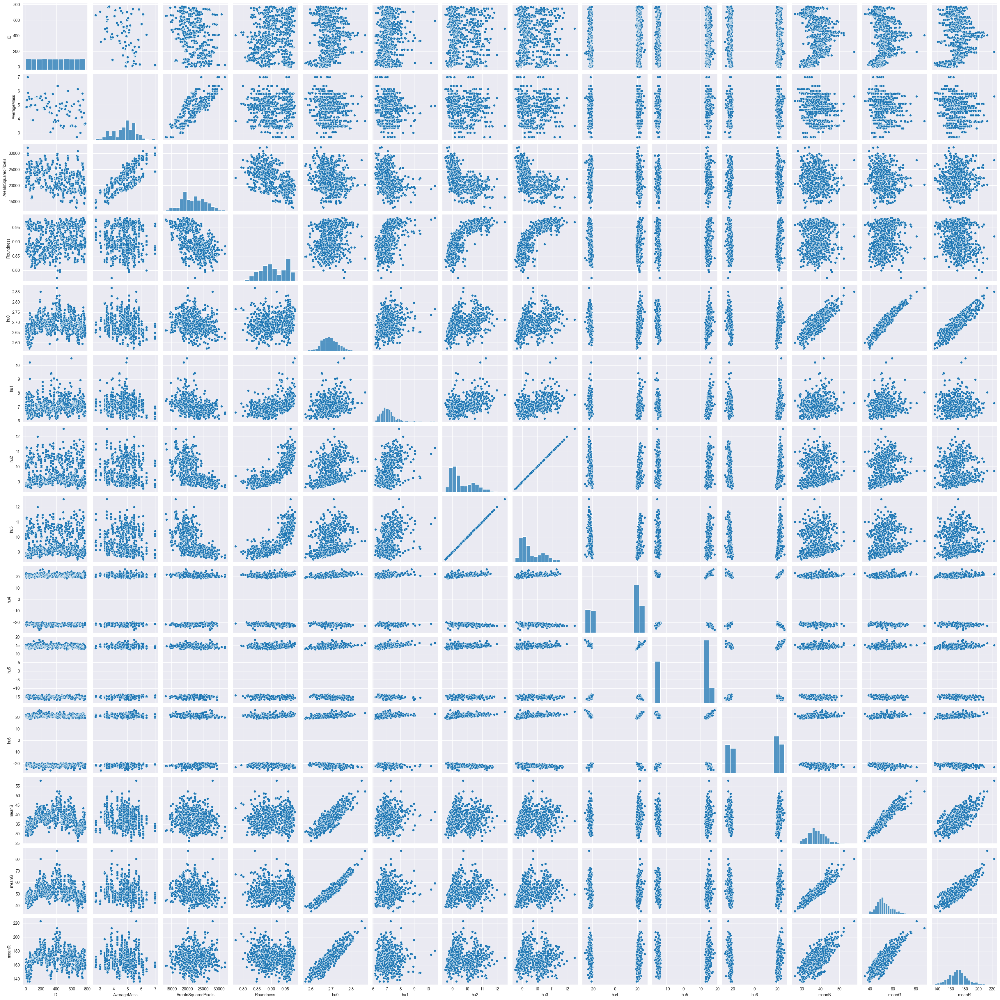

In [5]:
testdf = pd.read_csv("allfeaturesRaspberriesRaw.csv")

sns.pairplot(testdf)


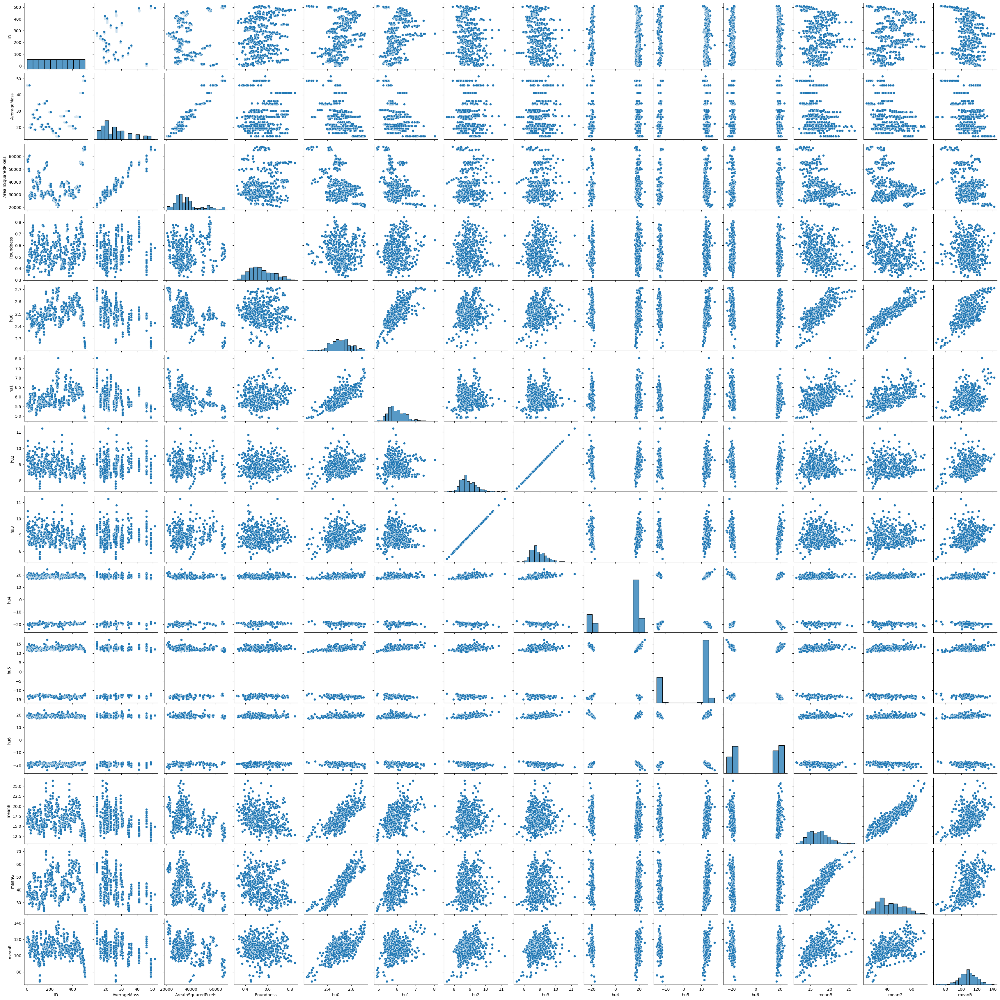

In [ ]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")

sns.pairplot(testdf)


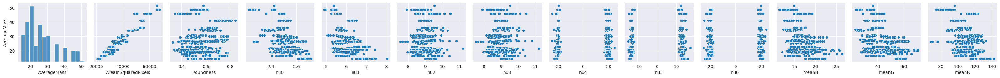

In [ ]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")

testdf = testdf.drop(['ID'], axis=1)

pp = sns.pairplot(data=testdf,
                  y_vars=['AverageMass'])

plt.savefig("./figures/StrawberriesPairplotAverageMass", dpi=300)




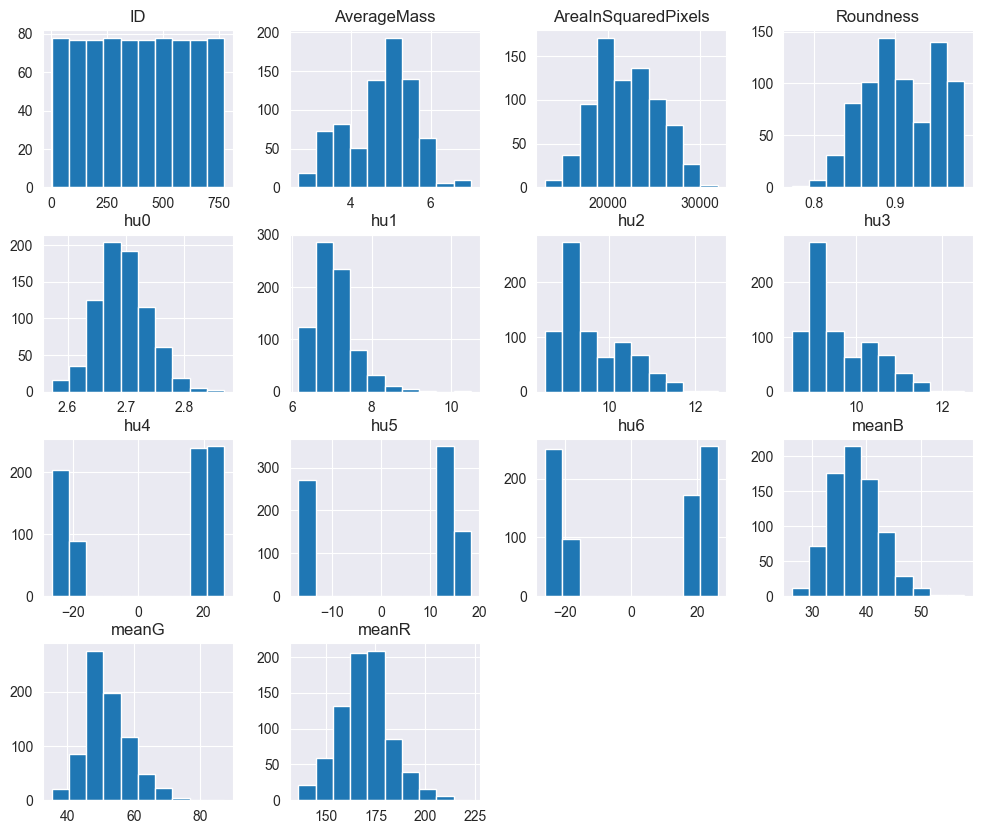

In [6]:
testdf.hist(figsize = (12,10))
plt.show()

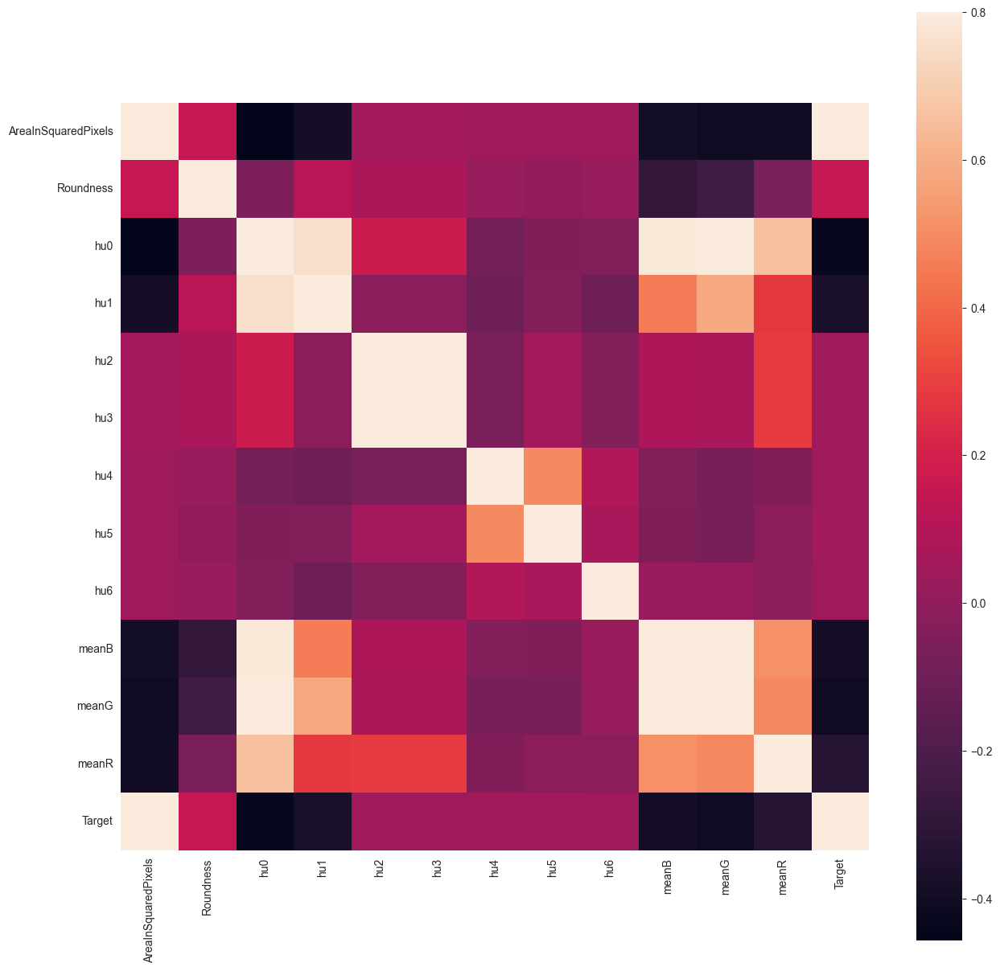

In [7]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)

testdf['Target'] = testdf['AverageMass']
testdf = testdf.drop(["AverageMass"], axis = 1)
C_mat = testdf.corr()
fig = plt.figure(figsize = (15,15))

sns.heatmap(C_mat, vmax = .8, square = True)
plt.show()

<AxesSubplot: >

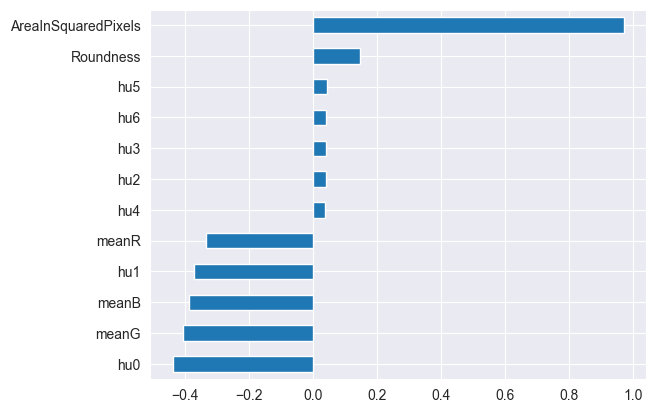

In [8]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

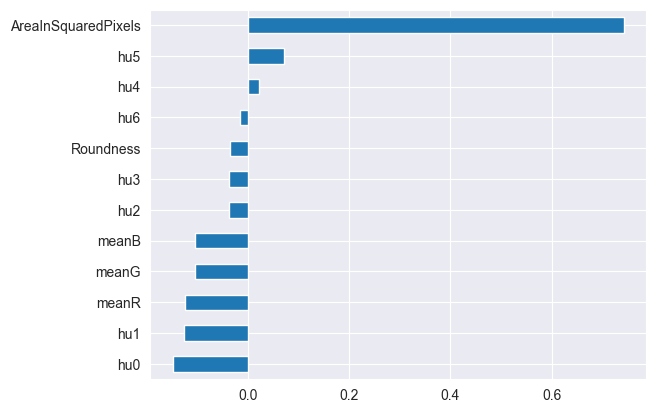

In [9]:
testdf = pd.read_csv("allfeaturesRaspberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

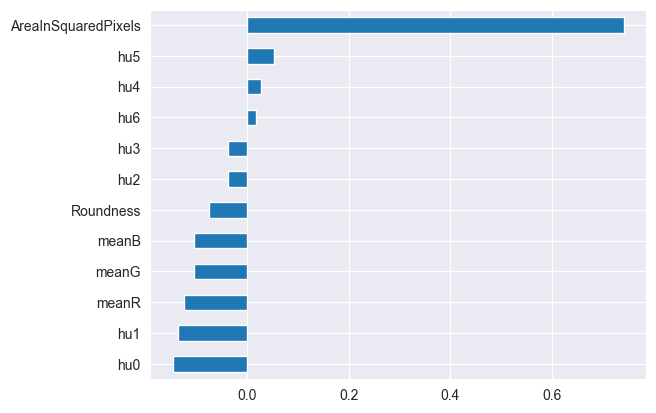

In [10]:
testdf = pd.read_csv("allfeaturesYOLORasp.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

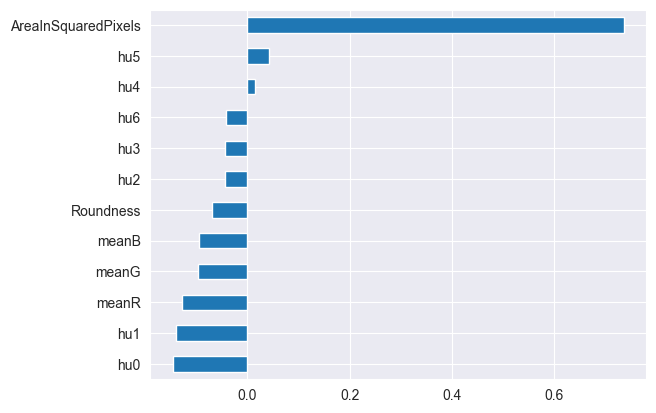

In [11]:
testdf = pd.read_csv("allfeaturesDetectron2rasp.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()



<AxesSubplot: >

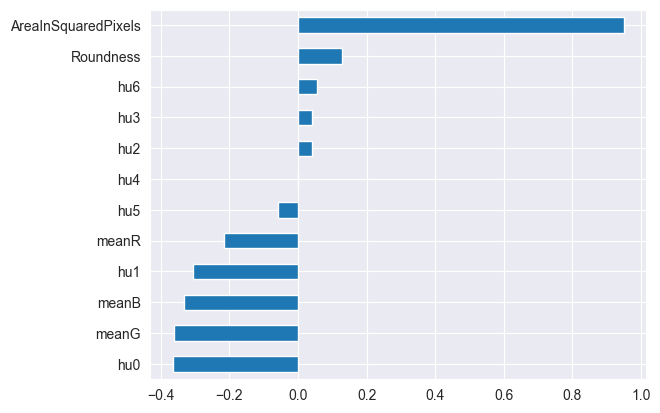

In [12]:
#checando correlacion no lineal con spearman
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr(method= 'spearman')["AverageMass"].sort_values()[:-1].plot.barh()


In [13]:
testdf.corr().style.background_gradient(cmap='coolwarm')


,AverageMass,AreaInSquaredPixels,Roundness,hu0,hu1,hu2,hu3,hu4,hu5,hu6,meanB,meanG,meanR
AverageMass,1.000000,0.971616,0.147975,-0.436478,-0.372183,0.041011,0.041011,0.037208,0.045287,0.041830,-0.386290,-0.404366,-0.333780
AreaInSquaredPixels,0.971616,1.000000,0.148809,-0.456898,-0.384775,0.054358,0.054358,0.037499,0.042792,0.035218,-0.389722,-0.406470,-0.399383
Roundness,0.147975,0.148809,1.000000,-0.055411,0.117716,0.070617,0.070617,0.016065,0.003740,0.016817,-0.289358,-0.244875,-0.065841
hu0,-0.436478,-0.456898,-0.055411,1.000000,0.756037,0.172867,0.172867,-0.085603,-0.049323,-0.041409,0.788042,0.893985,0.654910
hu1,-0.372183,-0.384775,0.117716,0.756037,1.000000,-0.019207,-0.019207,-0.102314,-0.034972,-0.104948,0.460615,0.580435,0.276126
hu2,0.041011,0.054358,0.070617,0.172867,-0.019207,1.000000,1.000000,-0.067787,0.052346,-0.043903,0.080962,0.074706,0.284754
hu3,0.041011,0.054358,0.070617,0.172867,-0.019207,1.000000,1.000000,-0.067787,0.052346,-0.043903,0.080962,0.074706,0.284754
hu4,0.037208,0.037499,0.016065,-0.085603,-0.102314,-0.067787,-0.067787,1.000000,0.493780,0.096488,-0.040366,-0.072974,-0.049212
hu5,0.045287,0.042792,0.003740,-0.049323,-0.034972,0.052346,0.052346,0.493780,1.000000,0.064254,-0.045144,-0.072504,-0.015929
hu6,0.041830,0.035218,0.016817,-0.041409,-0.104948,-0.043903,-0.043903,0.096488,0.064254,1.000000,0.027822,0.018287,-0.019152


<AxesSubplot: >

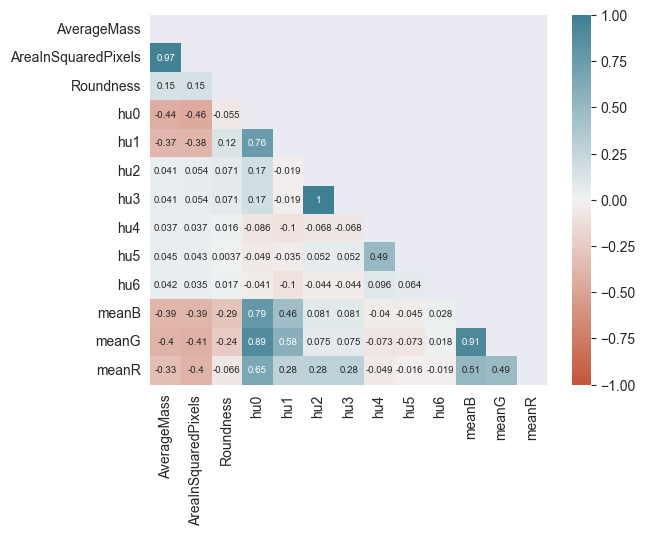

In [14]:

corrmat = testdf.corr()
mask= np.zeros_like(corrmat)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corrmat,
            vmax=1, vmin=-1,
            annot=True, annot_kws={'fontsize':7},
            mask=mask,
            cmap=sns.diverging_palette(20,220,as_cmap=True))

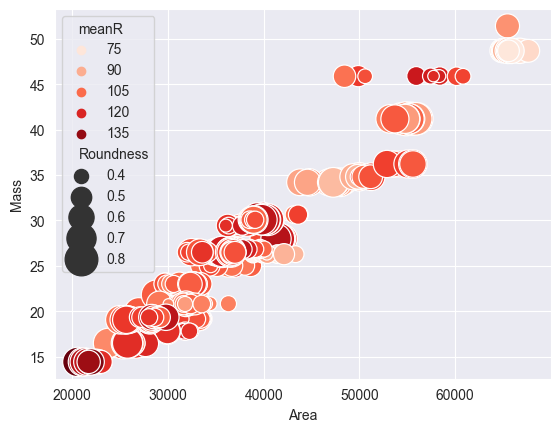

In [15]:
sns.scatterplot(data = testdf, x=testdf['AreaInSquaredPixels'], y=testdf['AverageMass'],
               size=testdf['Roundness'], hue=testdf['meanR'],
               sizes=(20,600),
               palette='Reds')

plt.xlabel('Area')
plt.ylabel('Mass')
plt.savefig("./figures/StrawberriesRawAreaVsMassAndRoundnessAndMeanRed", dpi=300)


# Deep learning

In [3]:
print(tf.__version__)
!pip3 install tensorflow_addons


2.9.0
Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


In [4]:
!pip3 install tensorflow-addons==0.16.1


Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


In [5]:
#%reload_ext tensorboard

#%rm -rf "logs/fit"

import tensorflow_addons as tfa
from tensorflow_addons.metrics import RSquare


/Users/pablo/Library/Python/3.9/lib/python/site-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.6.0 and strictly below 2.9.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.9.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/addons
  warnings.warn(


In [6]:
!pip3 install pydot

Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


# MASTER CLASS

In [2]:
class AutomaticLearning:



  def __init__(self , dataframe, title, model_name):

    #print(dataframe.head(2))

    self.df = dataframe
    self.model_name = model_name
    self.input_shape = None
    self.num_classes = None
    self.epochs = None
    self.model = None
    self.X = None
    self.y = None
    self.X_train = None
    self.X_test = None
    self.y_train = None
    self.y_test = None
    self.run_name = "run"
    self.history = None
    self.r2 = None
    self.loss = None
    self.mse = None
    self.mae = None
    self.rmse = None
    self.library = None
    self.title = title
    self.plottittle = ""
    self.save = None
    self.show = None
    return

  def gather_data(self):
    return {'r2': self.r2, 'loss': self.loss, 'mse': self.mse, 'mae': self.mae, 'rmse': self.rmse}

  def plotA(self):
    pd.DataFrame(self.history.history).plot(figsize=(8,5))
    plt.show()
    return

  def plotLinear(self):
    # plot the data and the predictions

    #print(self.X_test)
    predictions = self.model.predict(self.X_test)

    plt.xlabel('Area (pixels^2)')
    plt.ylabel('Mass (g)')

    plt.scatter(self.X_test, self.y_test)
    if(self.model_name == "SVR"):
      plt.scatter(self.X_test, predictions, color='red', marker="x")
    else:
      plt.plot(self.X_test, predictions, color='red')

    plt.title(self.plottittle +'-R2' + str(self.epochs), size = 20)

    if(self.show):
      plt.show()
      print()
    if(self.save):
      plt.savefig(self.folder +'/'+self.plottittle + '-R2' + str(self.epochs), dpi=200)
    #print(f'R-squared value: {self.r2:.4f}')
    plt.clf()


    plt.scatter(self.y_test, predictions)
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.text(0.05, 0.95, 'R^2 = {:.4f}'.format(self.r2), ha='left', va='center', transform=plt.gca().transAxes)
    plt.title(self.plottittle + '-Predictions', size = 20)
    if(self.show):
      print()
      plt.show()
    if(self.save):
      plt.savefig(self.folder +'/'+self.plottittle + '-Predictions'+ str(self.epochs), dpi=200)
    plt.clf()


    return

  def plotLoss(self):
    fig, ax = plt.subplots()
    ax.set(title='Loss')
    ax.plot(self.history.history['loss'], label='Loss')
    ax.plot(self.history.history['val_loss'], label='Val loss')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return

  def plotMSE(self):
    fig, ax = plt.subplots()
    ax.set(title='MSE')
    ax.plot(self.history.history['mse'], label='MSE')
    ax.plot(self.history.history['val_mse'], label='Val MSE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return
    

  def plotMAE(self):
    fig, ax = plt.subplots()
    ax.set(title='MAE')
    ax.plot(self.history.history['mae'], label='MAE')
    ax.plot(self.history.history['val_mae'], label='Val MAE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return

  def plotRMSE(self):
    fig, ax = plt.subplots()
    ax.set(title='RMSE')
    ax.plot(self.history.history['root_mean_squared_error'], label='RMSE')
    ax.plot(self.history.history['val_root_mean_squared_error'], label='Val RMSE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return
  
  def plotPredictions(self):
    predictions = self.model(self.X_test)
    self.r2 = r2_score(self.y_test, predictions)
    #print(f'R-squared value: {self.r2:.4f}')
    plt.scatter(self.y_test, predictions)
    plt.text(0.05, 0.95, 'R^2 = {:.4f}'.format(self.r2), ha='left', va='center', transform=plt.gca().transAxes)
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.title(self.plottittle + '-Predictions', size = 20)

    if(self.save):
      plt.savefig(self.folder +'/'+self.plottittle + '-Predictions'+ str(self.epochs), dpi=200)


    if(self.show):
      plt.show()
      print()
    plt.clf()


  def plotAll(self):

    fig, ax = plt.subplots(nrows = 2, ncols = 2, figsize = (15,15))
   
    fig.suptitle(self.plottittle, size = 35)   

    ax[0][0].set(title='Loss')
    ax[0][0].plot(self.history.history['loss'], label='Loss')
    ax[0][0].plot(self.history.history['val_loss'], label='Val loss')
    ax[0][0].set_xlabel('Epoch')
    ax[0][0].set_ylabel('Values')
    ax[0][0].legend()


    ax[0][1].set(title='MSE')
    ax[0][1].plot(self.history.history['mse'], label='MSE')
    ax[0][1].plot(self.history.history['val_mse'], label='Val MSE')
    ax[0][1].set_xlabel('Epoch')
    ax[0][1].set_ylabel('Values')
    ax[0][1].legend()

   

    ax[1][0].set(title='MAE')
    ax[1][0].plot(self.history.history['mae'], label='MAE')
    ax[1][0].plot(self.history.history['val_mae'], label='Val MAE')
    ax[1][0].set_xlabel('Epoch')
    ax[1][0].set_ylabel('Values')
    ax[1][0].legend()

    ax[1][1].set(title='RMSE')
    ax[1][1].plot(self.history.history['root_mean_squared_error'], label='RMSE')
    ax[1][1].plot(self.history.history['val_root_mean_squared_error'], label='Val RMSE')
    ax[1][1].set_xlabel('Epoch')
    ax[1][1].set_ylabel('Values')
    ax[1][1].legend()

    if(self.save):
      #print("IM SAVING", self.save)

      plt.savefig(self.folder +'/'+self.plottittle+'-Summary'+ str(self.epochs), dpi=200)

    if(self.show):
      #print("IM SHOWING", self.show)

      plt.show()
    plt.clf()


  def plotNonLinear(self):

    self.plotAll()
    self.plotPredictions()
    #self.plotLoss()
    #self.plotMAE()
    #self.plotMSE()
    #self.plotRMSE()
    return

  def plot(self, folder, save, show):
    self.save = save
    self.show = show
    self.folder = folder
    if not os.path.exists(self.folder):
      #print("creating folder:", self.folder)
      os.makedirs(self.folder)

    if(self.library == "Tensorflow"):
      if(self.save and self.show): 
        print(self.model.summary())
        #plot_model(self.folder + '/' + self.model, to_file= self.model_name + "-" + self.run_name + "-" + self.title + '.png', show_shapes=True, show_layer_names=False)
        #plot_model(self.model, show_shapes=True, show_layer_names=False)
      if(self.save):
        print("IM SAVING")
        #img = mpimg.imread(self.title +'/'+ self.model_name + "-" + self.run_name + "-" + self.title + '.png')
      if(self.show):
        print("IM SHOWING")
        #imgplot = plt.imshow(img)
        #imgplot = plt.imshow(img2)
        #plt.show()


    if(self.library == "Tensorflow"):
      self.plotNonLinear()
    elif(self.library == "scikit"):
      #print("plotting linear")
      self.plotLinear()


  def train(self, epochs = 2):

    self.epochs = epochs
    if(self.library != "scikit"):
      self.plottittle = self.title + "-" + str(self.epochs)
    else:
      self.plottittle = self.title

    #print(self.plottittle)
    
    if(self.library == "Tensorflow"):
      opt = optimizers.Adam(learning_rate=0.01)
      sgd = optimizers.SGD(learning_rate=0.01, momentum=0.9, nesterov=True)
      
      self.model.compile(loss=tf.keras.losses.MeanSquaredError(), optimizer = opt, metrics=['mse', 'mae', tf.keras.metrics.RootMeanSquaredError()])
      early_stop = EarlyStopping(monitor='val_loss', patience=250, verbose=1)

      self.history = self.model.fit(self.X_train, self.y_train, batch_size=32, epochs = self.epochs, validation_split=0.2, shuffle = True,callbacks=[early_stop], verbose = 1)
      K.clear_session()
      #['loss', 'mse', 'mae', 'root_mean_squared_error']
      results = self.model.evaluate(self.X_test, self.y_test)
      self.loss = results[0]
      self.mse = results[1]
      self.mae = results[2]
      self.rmse = results[3]
      #print("Test loss:", results)
      #print(self.model.metrics_names)

    elif(self.library == "scikit"):


      self.model.fit(self.X_train, self.y_train)
      self.y_pred = self.model.predict(self.X_test)
      #print(self.model_name, self.y_pred)


      self.predictions = self.model.predict(self.X_test)

      self.r2 = r2_score(self.y_test, self.y_pred)

      #self.r2 = self.model.score(self.X, self.y)
      self.mse = mean_squared_error(self.y_test, self.y_pred)
      self.mae = mean_absolute_error(self.y_test, self.y_pred)
      self.rmse = np.sqrt(self.mse)
      
    return
  def buildData(self):

    normalizer = Normalization()
    if(self.model_name == "linear" or self.model_name == "SVR"):
      self.df = self.df.drop(["Roundness"], axis = 1)

    if(self.model_name == 'CNN' or self.model_name == 'ResNet' or self.model_name == 'MobileNet' or self.model_name == 'DenseNet'):
      #print("entrando")
      self.X = np.array(self.df['img'].tolist())
      self.y = np.array(self.df['AverageMass'].tolist())
      self.X = self.X / 255.0

    else:
      self.X = self.df.drop(columns=['AverageMass', 'ID'])
      self.y = self.df['AverageMass']
        
      
    if(self.library == "Tensorflow" and self.model_name != 'CNN'):
      #self.X = scaler.fit_transform(self.X)
      normalizer.adapt(self.X)
      self.X = normalizer(self.X)

    #print(self.X.head(10))
  
    self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(self.X, self.y, test_size=0.2)


    if(self.model_name != 'CNN' or self.model_name != 'ResNet' or self.model_name != 'MobileNet' or self.model_name != 'DenseNet'):
      self.X_train = np.array(self.X_train)
      self.y_train = np.array(self.y_train)
      self.X_test = np.array(self.X_test)
      self.y_test = np.array(self.y_test)

    # Define the input shape and number of classes
    self.input_shape = (self.X_train.shape[1],)
    #print(self.input_shape)
    num_classes = 1
    return

  def buildModel(self):

    if(self.model_name == "FCNN"): 
      # FCNN
      self.library = "Tensorflow"
      self.model = keras.Sequential(
          [
          tf.keras.layers.Dense(64, activation='relu', input_shape = self.input_shape),
          tf.keras.layers.Dense(32, activation='relu'),
          tf.keras.layers.Dense(16, activation='linear'),
          tf.keras.layers.Dense(1)
          ]
      )
    elif(self.model_name == "DeepSVM"):

      self.library = "Tensorflow"
      self.model = tf.keras.Sequential([
          tf.keras.layers.Dense(128, activation='linear', input_shape=self.input_shape, kernel_regularizer=tf.keras.regularizers.l2(0.01)),
          tf.keras.layers.Dense(1)
      ])
    elif(self.model_name == "CNN"):
      # Autoencoder
      self.library = "Tensorflow"
      self.model = tf.keras.Sequential([
          tf.keras.layers.Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(140, 140, 3)),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Conv2D(64, kernel_size=(3, 3), activation='relu'),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Conv2D(128, kernel_size=(3, 3), activation='relu'),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Flatten(),
          tf.keras.layers.Dense(1)
      ])
    elif(self.model_name == "ResNet"):
      self.library = "Tensorflow"
      base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False


    elif(self.model_name == "DenseNet"):
      self.library = "Tensorflow"

      base_model = DenseNet121(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False

    elif(self.model_name == "MobileNet"):
      self.library = "Tensorflow"

      base_model = MobileNet(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False

    elif(self.model_name == "linear"):
      self.library = "scikit"
      self.model = LinearRegression()

    elif(self.model_name == "SVR"):
      self.library = "scikit"
      # Create an SVR object and fit the training data
      self.model = SVR(kernel='rbf', C=100, epsilon=0.01)

    elif(self.model_name == "MLP"):
      # MLP
      self.library = "Tensorflow"
      self.model = Sequential([
          Dense(64, activation='relu', input_shape=self.input_shape),
          Dropout(0.2),
          Dense(32, activation='relu'),
          Dropout(0.2),
          Dense(1, activation='linear')
      ])



    return




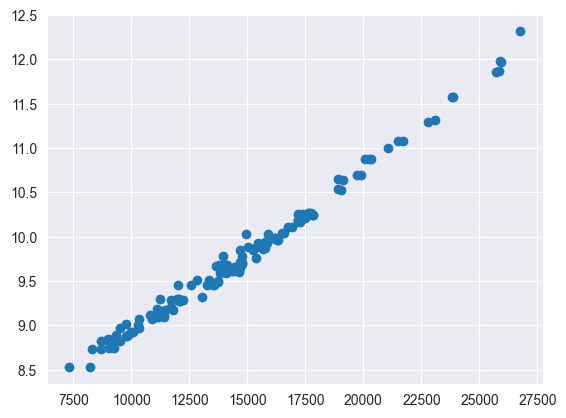

   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21      10.2444              17784.0     0.7531
1  22      10.2427              17844.0     0.7737
2  23      10.2425              17824.5     0.8063
3  24      10.1629              17287.5     0.7483
4  25      10.1636              17164.0     0.7635
5  26       9.7124              14675.5     0.8039
6  27       9.7125              14762.0     0.7448
7  28       9.8781              15341.5     0.8187
8  29       9.8802              15020.5     0.7621
9  30       9.9806              16184.0     0.7584
no ha tronado


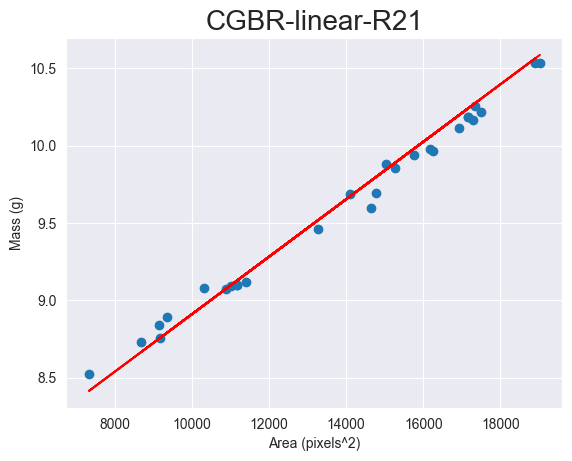

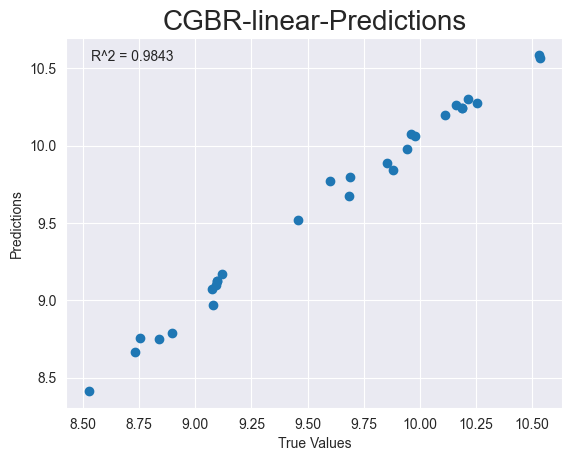

{'r2': 0.9842674365151411, 'loss': None, 'mse': 0.005414560172545546, 'mae': 0.060963479419887126, 'rmse': 0.07358369501829563}


<Figure size 640x480 with 0 Axes>

In [3]:
dataframe = None
data_ext = ".csv"
dataset_name = "CGBR"
model_name = "linear"
epoch = 1   
berry_type = "Blueberry"
experiment_name = "Linear"
if(data_ext == '.pkl'):
    dataframe = pd.read_pickle(dataset_name + data_ext)
else:
    dataframe = pd.read_csv(dataset_name + data_ext)
plt.scatter(dataframe["AreaInSquaredPixels"], dataframe["AverageMass"])
plt.show()
plt.clf()

print(dataframe.head(10))
test = AutomaticLearning(dataframe, dataset_name + "-" + model_name, model_name)
print("no ha tronado")
test.buildData()
test.buildModel()
test.train(epoch)
test.plot(berry_type + '-' + experiment_name, save = True, show = True)
result = test.gather_data()
print(result)

# EXPERIMENTS DICTIONARY

In [4]:


Experiments = {
    "Raw" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBR", "FBR", "CBR", "ABR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [2, 4, 10, 20]
                        },
                        "MachineLearning": {
                                "Datasets" : ["CGBR"],
                                "Extention" : ".csv",
                                "Models" : ["Linear", "SVR"],
                                "Epochs" : [1]
                        },
                        "Images" : {
                                "Datasets" : ["CIBR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3, 4, 5]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRR", "FRR", "CRR", "ARR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [2, 4, 10, 20]
                        },
                        "MachineLearning": {
                                "Datasets" : ["CGRR"],
                                "Extention" : ".csv",
                                "Models" : ["Linear", "SVR"],
                                "Epochs" : [1]
                        },
                        "Images" : {
                                "Datasets" : ["CIRR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3, 4, 5]
                        }
                }
        }
    },
    "YOLO" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBY", "FBY", "CBY", "ABY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [2, 4, 10, 20]
                        },
                        "MachineLearning": {
                                "Datasets" : ["CGBY"],
                                "Extention" : ".csv",
                                "Models" : ["Linear", "SVR"],
                                "Epochs" : [1]
                        },
                        "Images" : {
                                "Datasets" : ["CIBY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3, 4, 5]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRY", "FRY", "CRY", "ARY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [2, 4, 10, 20]
                        },
                        "MachineLearning": {
                                "Datasets" : ["CGRY"],
                                "Extention" : ".csv",
                                "Models" : ["Linear", "SVR"],
                                "Epochs" : [1]
                        },
                        "Images" : {
                                "Datasets" : ["CIRY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3, 4, 5]
                        }
                }
        }
    }
}

experimentsDeepLearning = {
    "Raw" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBR", "FBR", "CBR", "ABR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRR", "FRR", "CRR", "ARR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGSR", "FSR", "CSR", "ASR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        }
    },
    "YOLO" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBY", "FBY", "CBY", "ABY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRY", "FRY", "CRY", "ARY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBY", "FBY", "CBY", "ABY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        }
    },
    "Detectron2" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBD", "FBD", "CBD", "ABD"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRD", "FRD", "CRD", "ARD"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGSD", "FSD", "CSD", "ASD"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        }
    }
}


experimentsMachineLearning = {
    "Raw" : {
        "Blueberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGBR"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGRR"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGSR"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        }
    },
    "YOLO" : {
        "Blueberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGBY"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGRY"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGSY"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        }
    },
    "Detectron2" : {
        "Blueberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGBD"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGRD"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGSD"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        }
    }
}


experimentsCNN = {
    "Raw" : {
        "Blueberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIBR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIRR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CISR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        }
    },
    "YOLO" : {
        "Blueberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIBY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIRY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CISY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        }
    },
    "Detectron2" : {
        "Blueberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIBD"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIRD"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CISD"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        }
    }
}





Running experiments for Blueberries...
Running DeepLearning tests...
Running tests on CGBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_101"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_296 (Dense)           (None, 64)                192       
                                                                 
 dropout_66 (Dropout)        (None, 64)                0         
                                                                 
 dense_297 (Dense)           (None, 32)                2080      
                                                                 
 dropout_67 (Dropout)        (None, 32)                0         
                                                                 

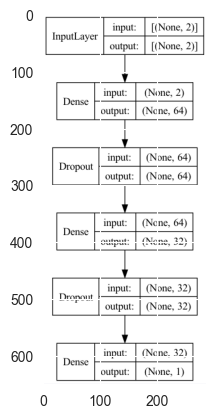

CGBR-MLP-1


2023-05-02 10:13:57.007428: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 300ms/step - loss: 1931104.5000 - mse: 1931104.5000 - mae: 1080.4812 - root_mean_squared_error: 1389.6418 - val_loss: 50933.7109 - val_mse: 50933.7109 - val_mae: 219.9613 - val_root_mean_squared_error: 225.6850


2023-05-02 10:13:58.516810: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 81ms/step - loss: 78186.1719 - mse: 78186.1719 - mae: 270.6571 - root_mean_squared_error: 279.6179
Test loss: [78186.171875, 78186.171875, 270.6570739746094, 279.6178894042969]
['loss', 'mse', 'mae', 'root_mean_squared_error']


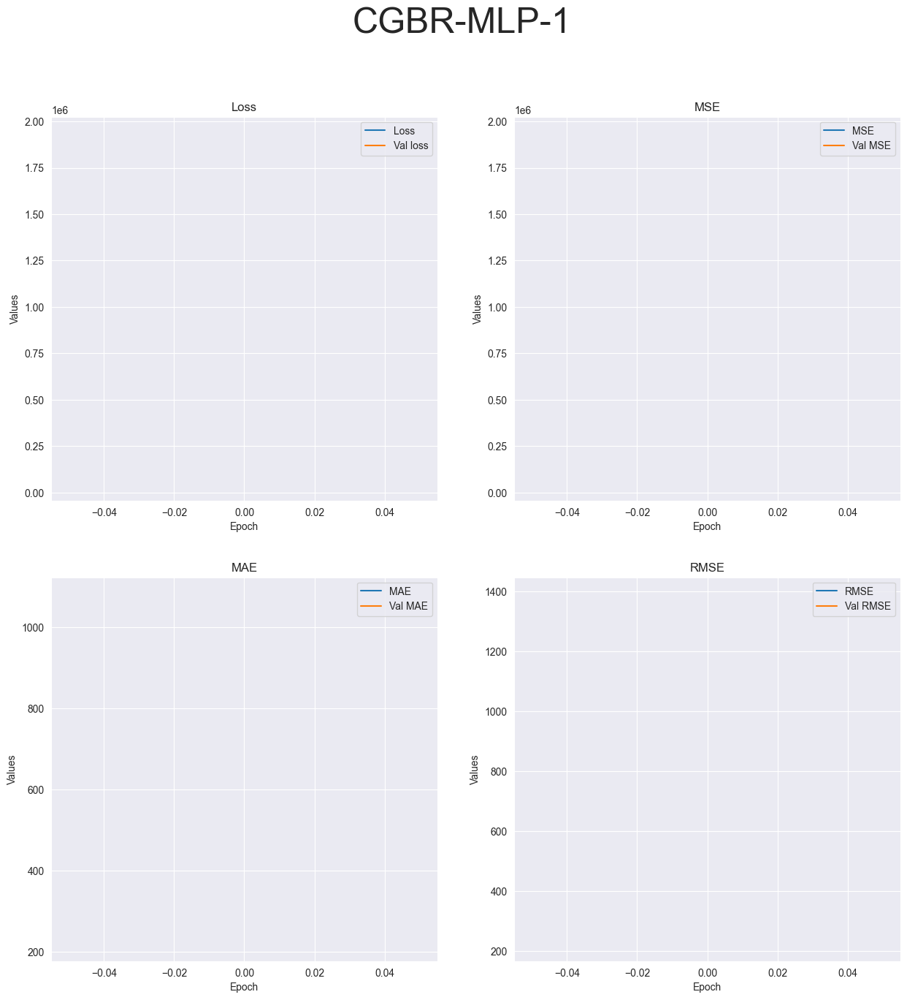

R-squared value: -133489.8933


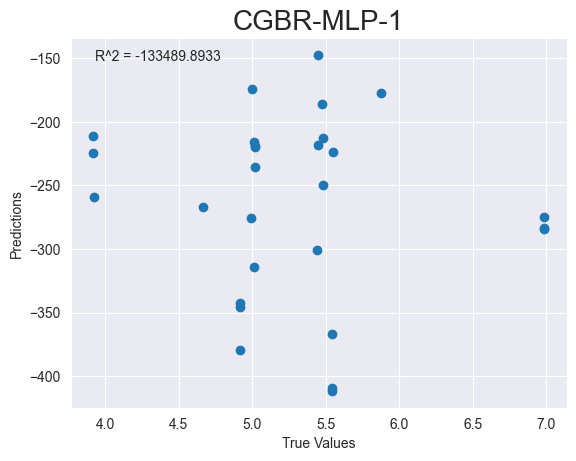

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_102"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_299 (Dense)           (None, 64)                192       
                                                                 
 dropout_68 (Dropout)        (None, 64)                0         
                                                                 
 dense_300 (Dense)           (None, 32)                2080      
                                                                 
 dropout_69 (Dropout)        (None, 32)                0         
                                                                 
 dense_301 (Dense)           (None, 1)                 33        
                                                                 


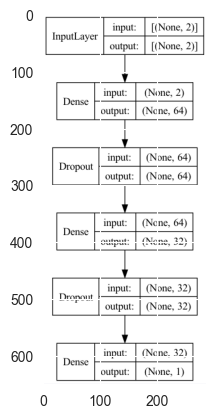

CGBR-MLP-4
Epoch 1/4


2023-05-02 10:14:00.018595: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 264ms/step - loss: 2730065.7500 - mse: 2730065.7500 - mae: 1343.4875 - root_mean_squared_error: 1652.2910 - val_loss: 1249.9309 - val_mse: 1249.9309 - val_mae: 34.1330 - val_root_mean_squared_error: 35.3544
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 541208.7500 - mse: 541208.7500 - mae: 609.3057 - root_mean_squared_error: 735.6689

2023-05-02 10:14:00.991140: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 39ms/step - loss: 493546.1562 - mse: 493546.1562 - mae: 548.7688 - root_mean_squared_error: 702.5284 - val_loss: 141150.8281 - val_mse: 141150.8281 - val_mae: 358.5188 - val_root_mean_squared_error: 375.7004
Epoch 3/4
3/3 [==============================] - 0s 25ms/step - loss: 376858.2500 - mse: 376858.2500 - mae: 464.1815 - root_mean_squared_error: 613.8878 - val_loss: 1027.1545 - val_mse: 1027.1545 - val_mae: 30.0109 - val_root_mean_squared_error: 32.0493
Epoch 4/4
1/1 [==============================] - 0s 100ms/step - loss: 12471.4229 - mse: 12471.4229 - mae: 105.7011 - root_mean_squared_error: 111.6755
Test loss: [12471.4228515625, 12471.4228515625, 105.70111846923828, 111.67552185058594]
['loss', 'mse', 'mae', 'root_mean_squared_error']


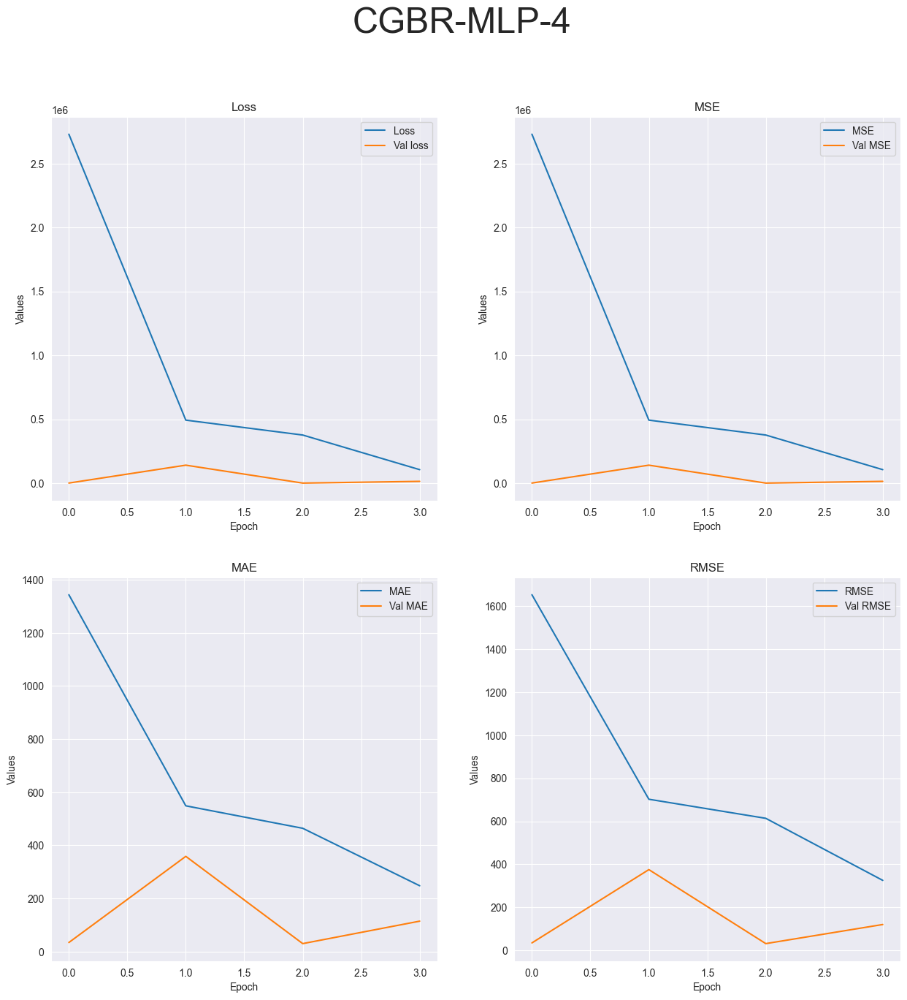

R-squared value: -35688.9116


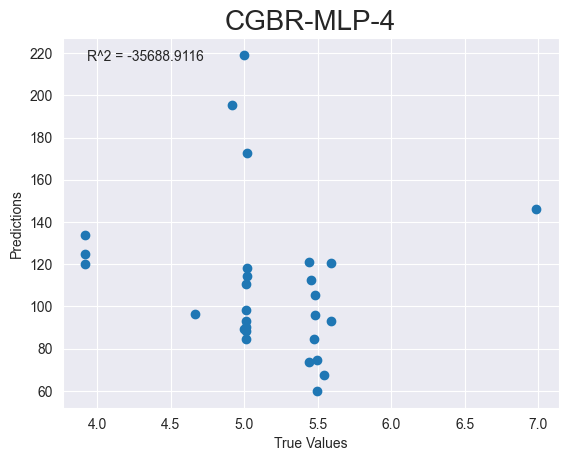

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_103"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_302 (Dense)           (None, 64)                192       
                                                                 
 dropout_70 (Dropout)        (None, 64)                0         
                                                                 
 dense_303 (Dense)           (None, 32)                2080      
                                                                 
 dropout_71 (Dropout)        (None, 32)                0         
                                                                 
 dense_304 (Dense)           (None, 1)                 33        
                                                                 

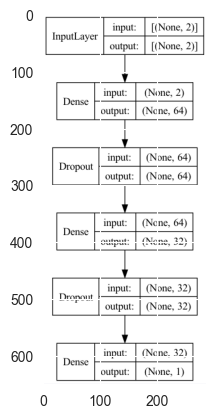

CGBR-MLP-10
Epoch 1/10


2023-05-02 10:14:02.733682: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 222ms/step - loss: 2508475.7500 - mse: 2508475.7500 - mae: 1262.2791 - root_mean_squared_error: 1583.8168 - val_loss: 658.6792 - val_mse: 658.6792 - val_mae: 24.0872 - val_root_mean_squared_error: 25.6647
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 659467.2500 - mse: 659467.2500 - mae: 596.9396 - root_mean_squared_error: 812.0759

2023-05-02 10:14:03.509332: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 24ms/step - loss: 527895.7500 - mse: 527895.7500 - mae: 543.3682 - root_mean_squared_error: 726.5643 - val_loss: 9679.7568 - val_mse: 9679.7568 - val_mae: 94.6234 - val_root_mean_squared_error: 98.3858
Epoch 3/10
3/3 [==============================] - 0s 40ms/step - loss: 234242.5156 - mse: 234242.5156 - mae: 362.8885 - root_mean_squared_error: 483.9861 - val_loss: 70071.3281 - val_mse: 70071.3281 - val_mae: 253.0035 - val_root_mean_squared_error: 264.7099
Epoch 4/10
3/3 [==============================] - 0s 31ms/step - loss: 80555.0000 - mse: 80555.0000 - mae: 209.2354 - root_mean_squared_error: 283.8221 - val_loss: 66226.6172 - val_mse: 66226.6172 - val_mae: 245.9524 - val_root_mean_squared_error: 257.3453
Epoch 5/10
3/3 [==============================] - 0s 40ms/step - loss: 57563.9531 - mse: 57563.9531 - mae: 198.7654 - root_mean_squared_error: 239.9249 - val_loss: 35728.9492 - val_mse: 35728.9492 - val_mae: 180.5332 - val_root_mean_squared

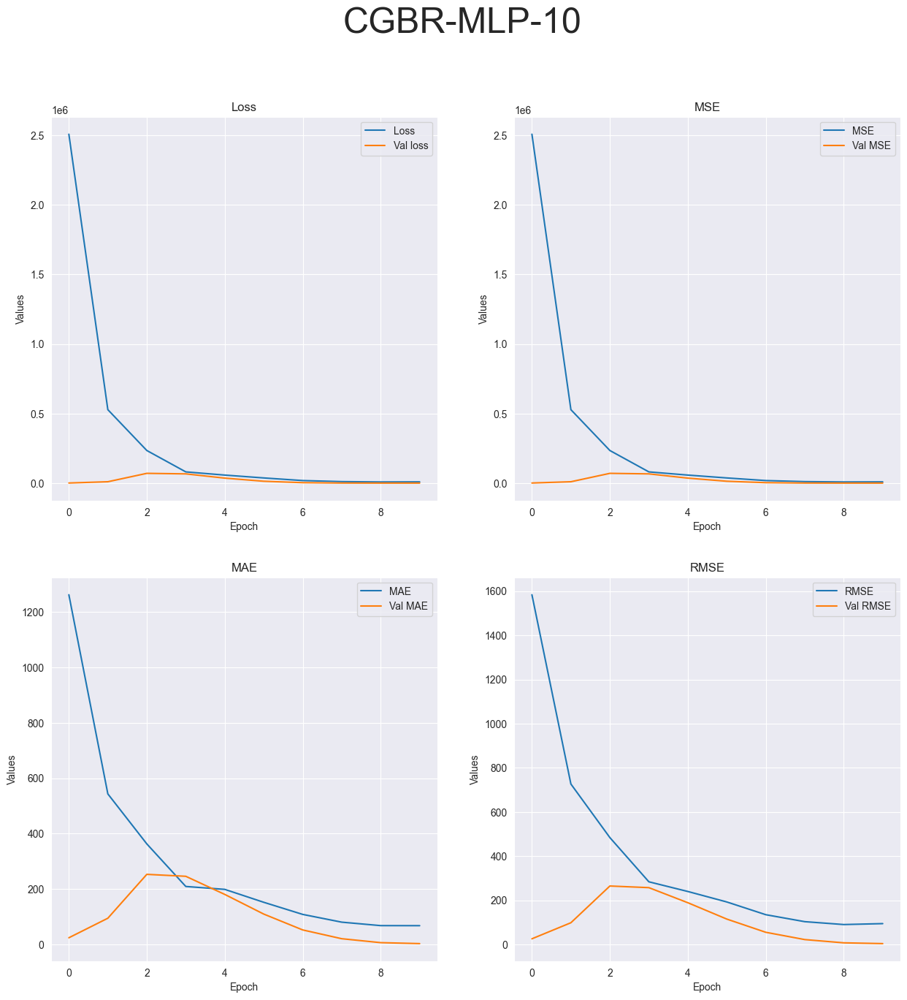

R-squared value: -23.9595


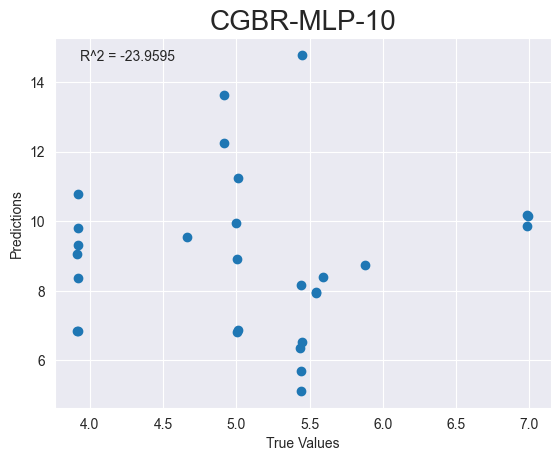

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_104"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_305 (Dense)           (None, 64)                192       
                                                                 
 dropout_72 (Dropout)        (None, 64)                0         
                                                                 
 dense_306 (Dense)           (None, 32)                2080      
                                                                 
 dropout_73 (Dropout)        (None, 32)                0         
                                                                 
 dense_307 (Dense)           (None, 1)                 33        
                                                                 

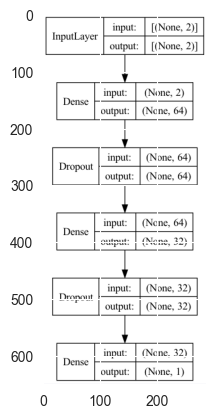

CGBR-MLP-20
Epoch 1/20


2023-05-02 10:14:05.431238: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 156ms/step - loss: 2737144.7500 - mse: 2737144.7500 - mae: 1291.3274 - root_mean_squared_error: 1654.4319 - val_loss: 24137.1758 - val_mse: 24137.1758 - val_mae: 148.9451 - val_root_mean_squared_error: 155.3614
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 591930.1250 - mse: 591930.1250 - mae: 635.6565 - root_mean_squared_error: 769.3699

2023-05-02 10:14:05.938118: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 53ms/step - loss: 605862.5625 - mse: 605862.5625 - mae: 589.9862 - root_mean_squared_error: 778.3718 - val_loss: 201718.5625 - val_mse: 201718.5625 - val_mae: 429.7851 - val_root_mean_squared_error: 449.1309
Epoch 3/20
3/3 [==============================] - 0s 43ms/step - loss: 337438.7500 - mse: 337438.7500 - mae: 445.4545 - root_mean_squared_error: 580.8948 - val_loss: 1000.1435 - val_mse: 1000.1435 - val_mae: 29.7585 - val_root_mean_squared_error: 31.6250
Epoch 4/20
3/3 [==============================] - 0s 30ms/step - loss: 100921.4844 - mse: 100921.4844 - mae: 228.9696 - root_mean_squared_error: 317.6814 - val_loss: 17335.1738 - val_mse: 17335.1738 - val_mae: 125.4251 - val_root_mean_squared_error: 131.6631
Epoch 5/20
3/3 [==============================] - 0s 24ms/step - loss: 82373.4219 - mse: 82373.4219 - mae: 216.5488 - root_mean_squared_error: 287.0077 - val_loss: 16178.7637 - val_mse: 16178.7637 - val_mae: 121.1544 - val_root_mean_squ

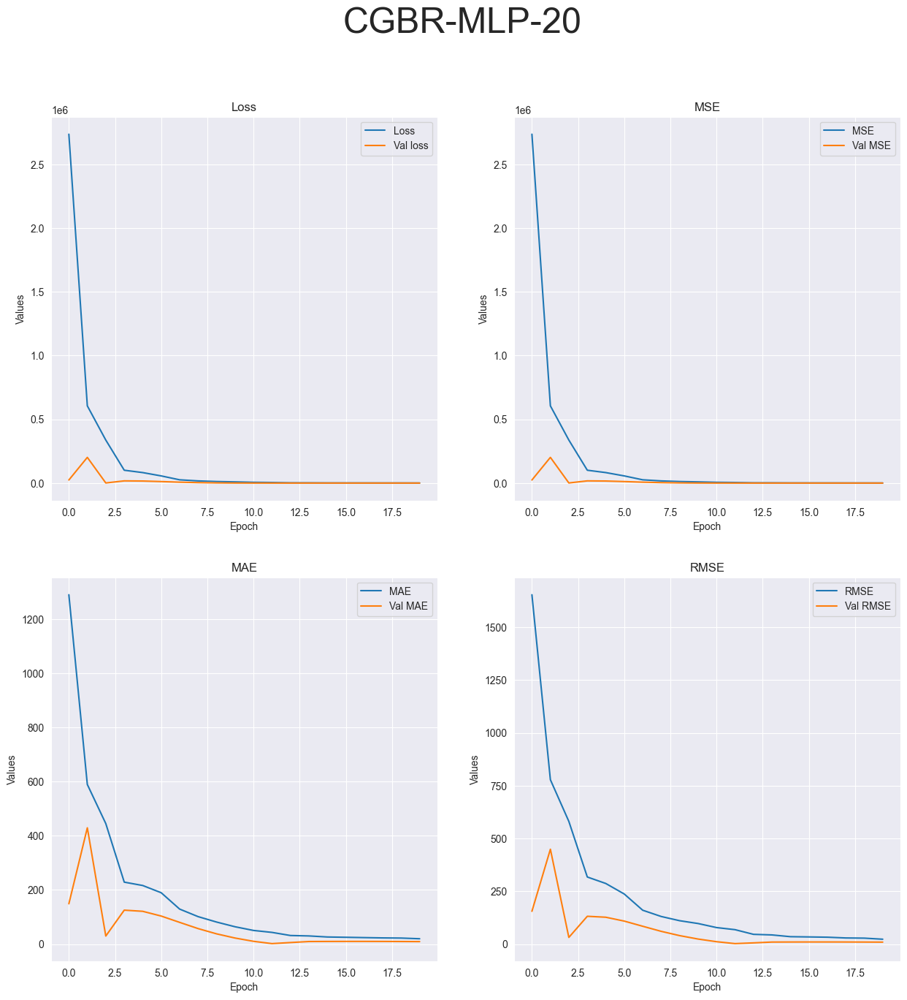

R-squared value: -259.2775


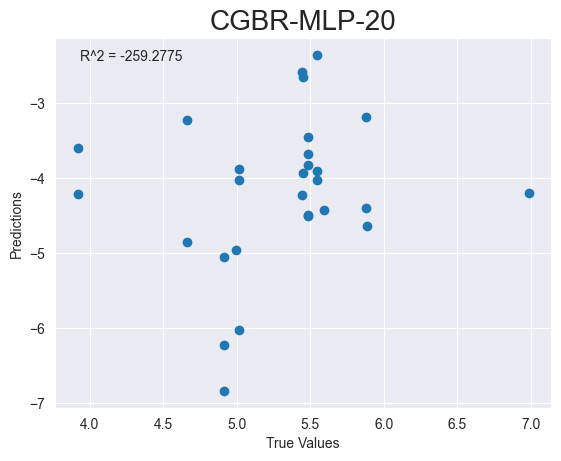

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_105"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_308 (Dense)           (None, 64)                192       
                                                                 
 dense_309 (Dense)           (None, 32)                2080      
                                                                 
 dense_310 (Dense)           (None, 16)                528       
                                                                 
 dense_311 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
____________________________________

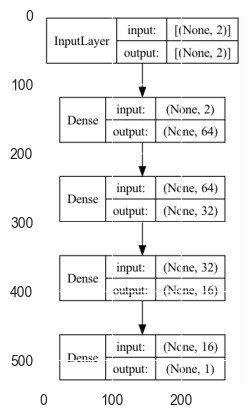

CGBR-FCNN-1


2023-05-02 10:14:08.510895: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 171ms/step - loss: 6314433.5000 - mse: 6314433.5000 - mae: 1906.4663 - root_mean_squared_error: 2512.8538 - val_loss: 124213.2812 - val_mse: 124213.2812 - val_mae: 338.1737 - val_root_mean_squared_error: 352.4391


2023-05-02 10:14:09.030574: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 130ms/step - loss: 166702.6719 - mse: 166702.6719 - mae: 390.7466 - root_mean_squared_error: 408.2924
Test loss: [166702.671875, 166702.671875, 390.74664306640625, 408.2923889160156]
['loss', 'mse', 'mae', 'root_mean_squared_error']


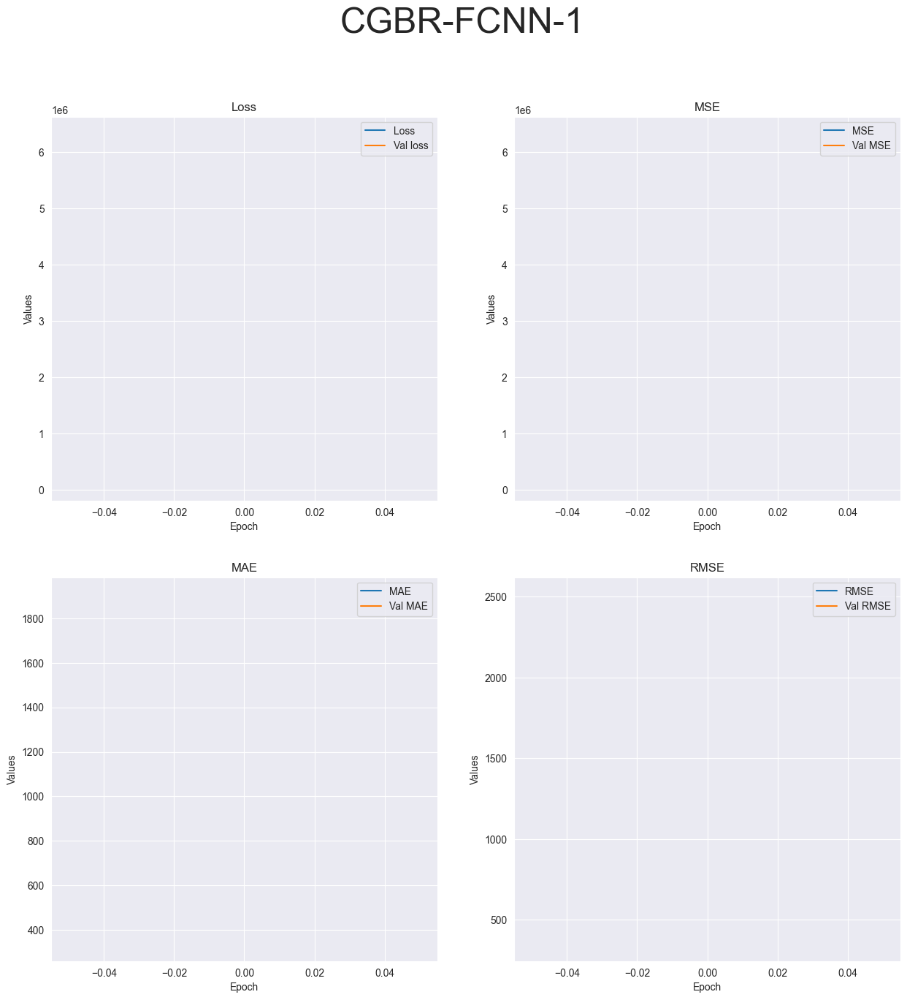

R-squared value: -603378.8153


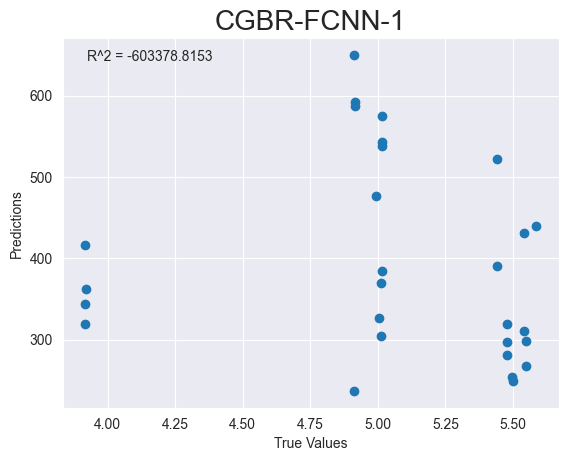

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_106"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_312 (Dense)           (None, 64)                192       
                                                                 
 dense_313 (Dense)           (None, 32)                2080      
                                                                 
 dense_314 (Dense)           (None, 16)                528       
                                                                 
 dense_315 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
________________________________________________________________

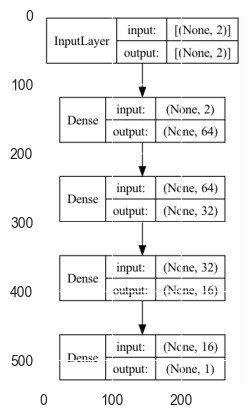

CGBR-FCNN-4
Epoch 1/4


2023-05-02 10:14:11.209421: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 178ms/step - loss: 7236614.0000 - mse: 7236614.0000 - mae: 1963.7477 - root_mean_squared_error: 2690.0955 - val_loss: 235005.6562 - val_mse: 235005.6562 - val_mae: 468.9122 - val_root_mean_squared_error: 484.7738
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 224611.2031 - mse: 224611.2031 - mae: 456.3471 - root_mean_squared_error: 473.9316

2023-05-02 10:14:11.848425: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 54ms/step - loss: 1687080.1250 - mse: 1687080.1250 - mae: 1131.4564 - root_mean_squared_error: 1298.8765 - val_loss: 3042655.0000 - val_mse: 3042655.0000 - val_mae: 1688.1107 - val_root_mean_squared_error: 1744.3208
Epoch 3/4
3/3 [==============================] - 0s 41ms/step - loss: 1889699.2500 - mse: 1889699.2500 - mae: 1291.8430 - root_mean_squared_error: 1374.6633 - val_loss: 352684.2188 - val_mse: 352684.2188 - val_mae: 574.5160 - val_root_mean_squared_error: 593.8723
Epoch 4/4
1/1 [==============================] - 0s 53ms/step - loss: 39144.0195 - mse: 39144.0195 - mae: 189.6787 - root_mean_squared_error: 197.8485
Test loss: [39144.01953125, 39144.01953125, 189.67868041992188, 197.84848022460938]
['loss', 'mse', 'mae', 'root_mean_squared_error']


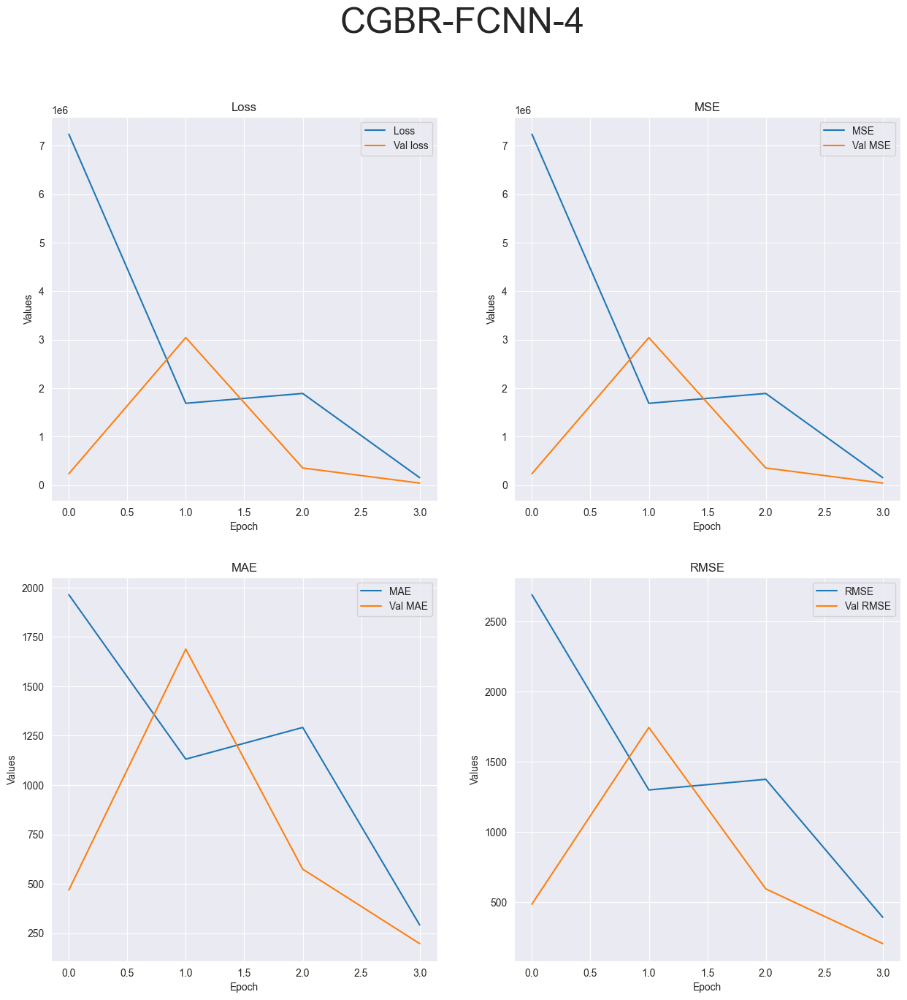

R-squared value: -67265.5389


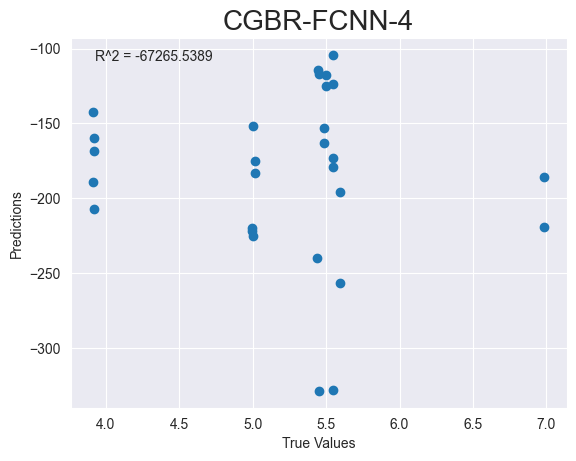

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_107"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_316 (Dense)           (None, 64)                192       
                                                                 
 dense_317 (Dense)           (None, 32)                2080      
                                                                 
 dense_318 (Dense)           (None, 16)                528       
                                                                 
 dense_319 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_______________________________________________________________

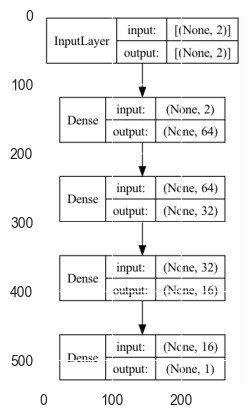

CGBR-FCNN-10
Epoch 1/10


2023-05-02 10:14:13.522041: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 212ms/step - loss: 6806653.0000 - mse: 6806653.0000 - mae: 1937.9410 - root_mean_squared_error: 2608.9563 - val_loss: 218846.9062 - val_mse: 218846.9062 - val_mae: 451.5173 - val_root_mean_squared_error: 467.8108
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 233807.1250 - mse: 233807.1250 - mae: 470.1488 - root_mean_squared_error: 483.5361

2023-05-02 10:14:14.084627: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 33ms/step - loss: 1907987.6250 - mse: 1907987.6250 - mae: 1203.3157 - root_mean_squared_error: 1381.2992 - val_loss: 2250288.2500 - val_mse: 2250288.2500 - val_mae: 1448.6025 - val_root_mean_squared_error: 1500.0961
Epoch 3/10
3/3 [==============================] - 0s 32ms/step - loss: 1703010.1250 - mse: 1703010.1250 - mae: 1223.5930 - root_mean_squared_error: 1304.9943 - val_loss: 195235.2969 - val_mse: 195235.2969 - val_mae: 426.4460 - val_root_mean_squared_error: 441.8544
Epoch 4/10
3/3 [==============================] - 0s 25ms/step - loss: 89980.8281 - mse: 89980.8281 - mae: 241.1797 - root_mean_squared_error: 299.9680 - val_loss: 54298.6289 - val_mse: 54298.6289 - val_mae: 225.4088 - val_root_mean_squared_error: 233.0207
Epoch 5/10
3/3 [==============================] - 0s 24ms/step - loss: 123582.3359 - mse: 123582.3359 - mae: 332.2378 - root_mean_squared_error: 351.5428 - val_loss: 190976.4375 - val_mse: 190976.4375 - val_mae: 422.4427

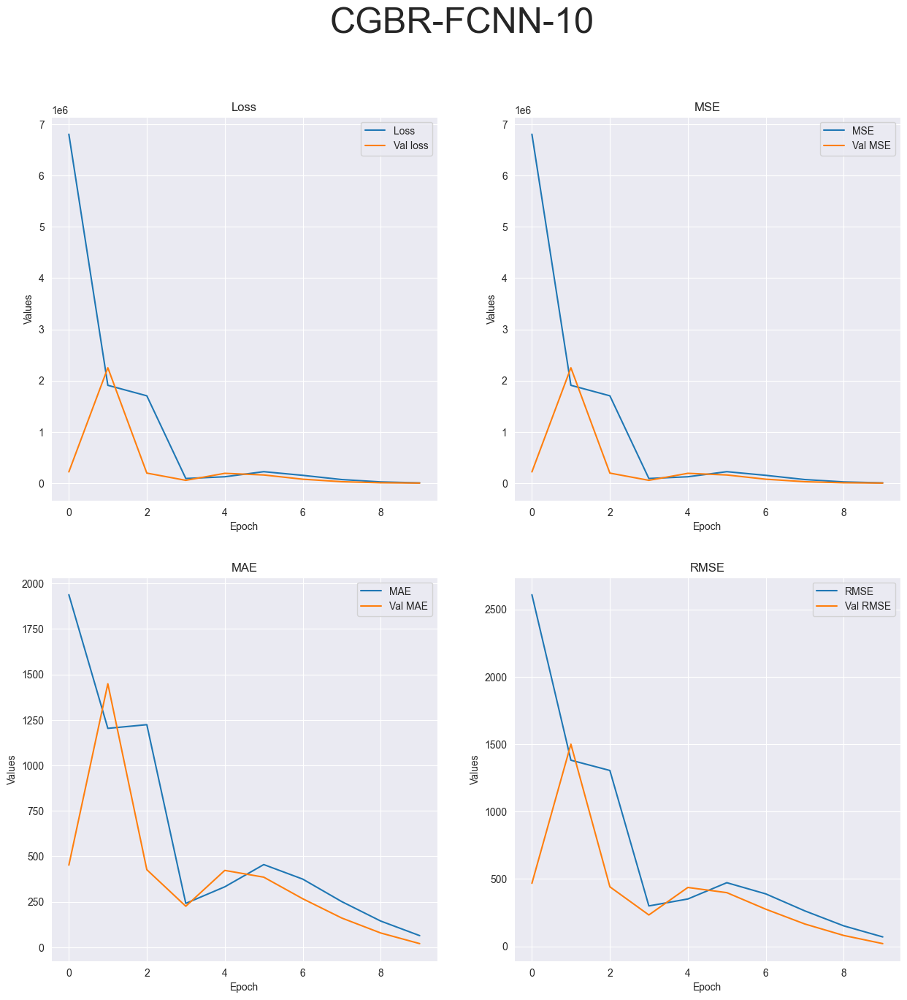

R-squared value: -917.3556


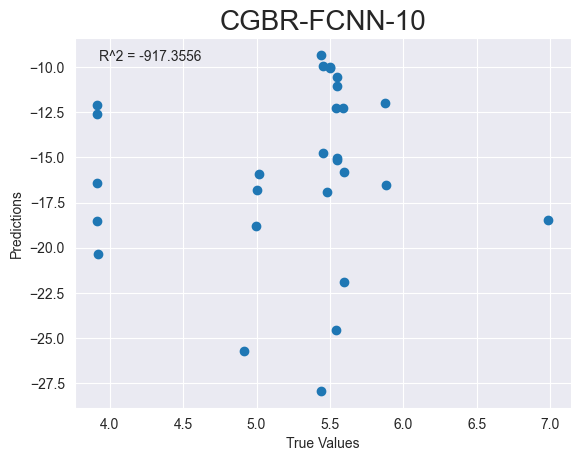

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_108"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_320 (Dense)           (None, 64)                192       
                                                                 
 dense_321 (Dense)           (None, 32)                2080      
                                                                 
 dense_322 (Dense)           (None, 16)                528       
                                                                 
 dense_323 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_______________________________________________________________

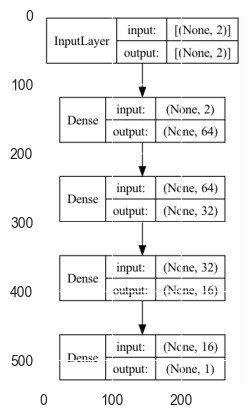

CGBR-FCNN-20
Epoch 1/20


2023-05-02 10:14:15.977271: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 221ms/step - loss: 6727961.0000 - mse: 6727961.0000 - mae: 1933.4480 - root_mean_squared_error: 2593.8313 - val_loss: 210865.0156 - val_mse: 210865.0156 - val_mae: 439.6473 - val_root_mean_squared_error: 459.2004
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 241104.3438 - mse: 241104.3438 - mae: 468.0579 - root_mean_squared_error: 491.0238

2023-05-02 10:14:16.520212: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 30ms/step - loss: 1677465.8750 - mse: 1677465.8750 - mae: 1146.1877 - root_mean_squared_error: 1295.1702 - val_loss: 2464343.7500 - val_mse: 2464343.7500 - val_mae: 1504.0598 - val_root_mean_squared_error: 1569.8229
Epoch 3/20
3/3 [==============================] - 0s 34ms/step - loss: 1785752.2500 - mse: 1785752.2500 - mae: 1260.4187 - root_mean_squared_error: 1336.3204 - val_loss: 242056.6250 - val_mse: 242056.6250 - val_mae: 471.0752 - val_root_mean_squared_error: 491.9925
Epoch 4/20
3/3 [==============================] - 0s 33ms/step - loss: 108882.9453 - mse: 108882.9453 - mae: 259.3523 - root_mean_squared_error: 329.9742 - val_loss: 48234.0000 - val_mse: 48234.0000 - val_mae: 210.9215 - val_root_mean_squared_error: 219.6224
Epoch 5/20
3/3 [==============================] - 0s 16ms/step - loss: 114059.2500 - mse: 114059.2500 - mae: 316.1373 - root_mean_squared_error: 337.7266 - val_loss: 194340.7031 - val_mse: 194340.7031 - val_mae: 422.93

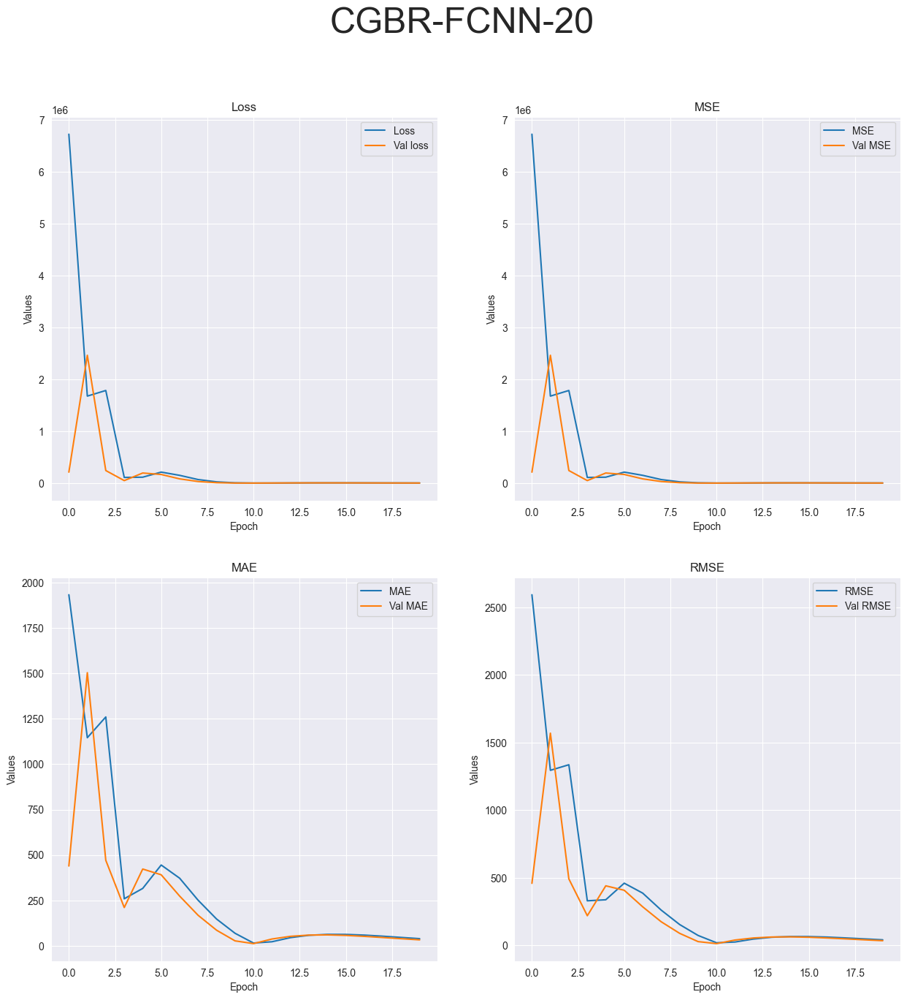

R-squared value: -3031.6609


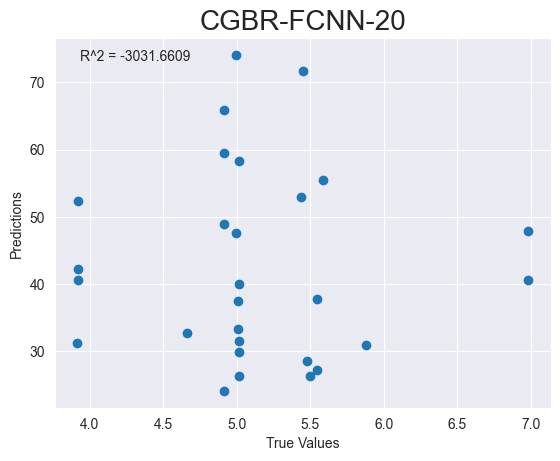

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_109"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_324 (Dense)           (None, 128)               384       
                                                                 
 dense_325 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


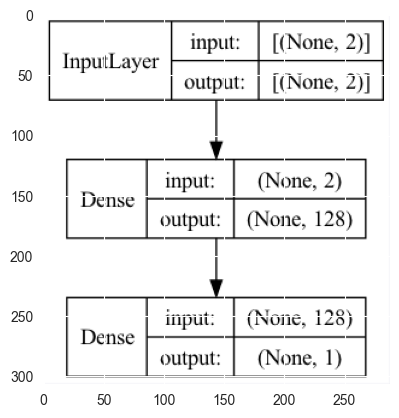

CGBR-DeepSVM-1


2023-05-02 10:14:19.003432: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 163ms/step - loss: 648374592.0000 - mse: 648374592.0000 - mae: 24240.5059 - root_mean_squared_error: 25463.2012 - val_loss: 367628608.0000 - val_mse: 367628608.0000 - val_mae: 18319.2637 - val_root_mean_squared_error: 19173.6445


2023-05-02 10:14:19.517714: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 51ms/step - loss: 343187616.0000 - mse: 343187616.0000 - mae: 17722.6484 - root_mean_squared_error: 18525.3242
Test loss: [343187616.0, 343187616.0, 17722.6484375, 18525.32421875]
['loss', 'mse', 'mae', 'root_mean_squared_error']


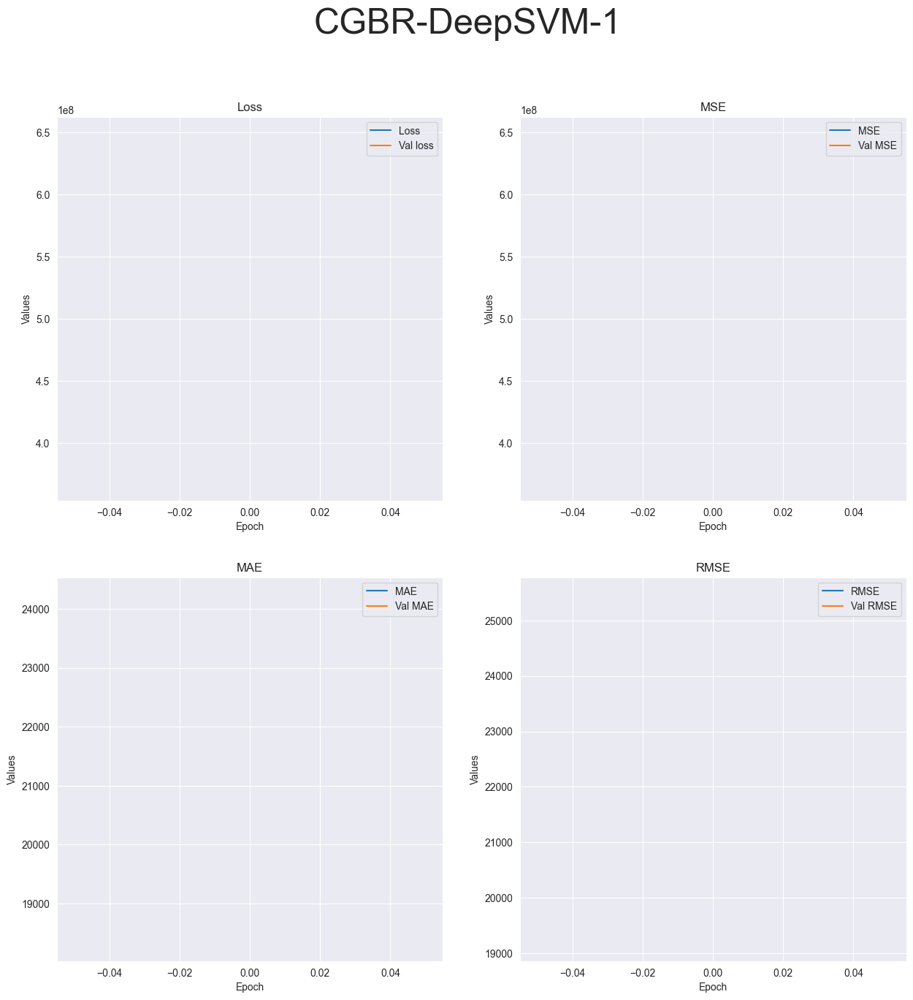

R-squared value: -418208501.7853


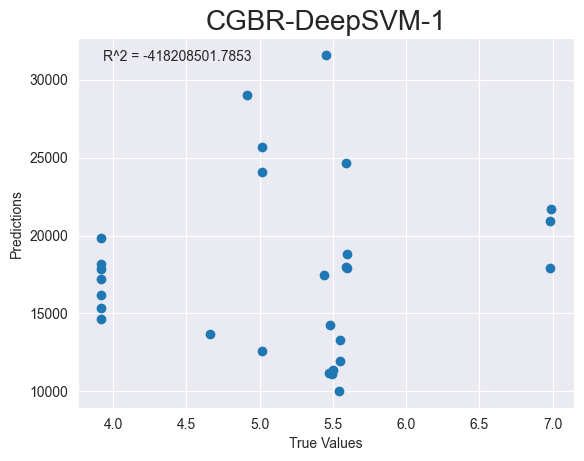

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_110"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_326 (Dense)           (None, 128)               384       
                                                                 
 dense_327 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


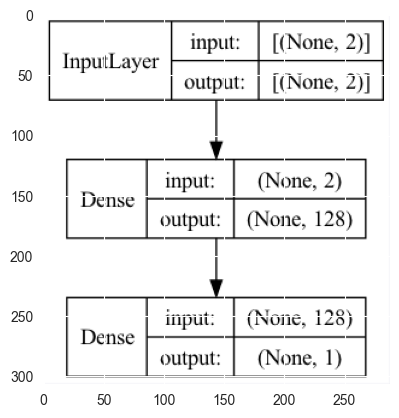

CGBR-DeepSVM-4
Epoch 1/4


2023-05-02 10:14:21.602387: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 209ms/step - loss: 635225920.0000 - mse: 635225920.0000 - mae: 24290.7871 - root_mean_squared_error: 25203.6895 - val_loss: 333567072.0000 - val_mse: 333567072.0000 - val_mae: 17584.3828 - val_root_mean_squared_error: 18263.8184
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 341650336.0000 - mse: 341650336.0000 - mae: 17749.3945 - root_mean_squared_error: 18483.7852

2023-05-02 10:14:22.237199: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 41ms/step - loss: 259014432.0000 - mse: 259014432.0000 - mae: 15367.5264 - root_mean_squared_error: 16093.9258 - val_loss: 126700920.0000 - val_mse: 126700920.0000 - val_mae: 10837.2354 - val_root_mean_squared_error: 11256.1504
Epoch 3/4
3/3 [==============================] - 0s 46ms/step - loss: 96256192.0000 - mse: 96256192.0000 - mae: 9419.2305 - root_mean_squared_error: 9811.0244 - val_loss: 48768992.0000 - val_mse: 48768992.0000 - val_mae: 6723.4155 - val_root_mean_squared_error: 6983.4800
Epoch 4/4
1/1 [==============================] - 0s 47ms/step - loss: 19656900.0000 - mse: 19656900.0000 - mae: 4217.6870 - root_mean_squared_error: 4433.6104
Test loss: [19656900.0, 19656900.0, 4217.68701171875, 4433.6103515625]
['loss', 'mse', 'mae', 'root_mean_squared_error']


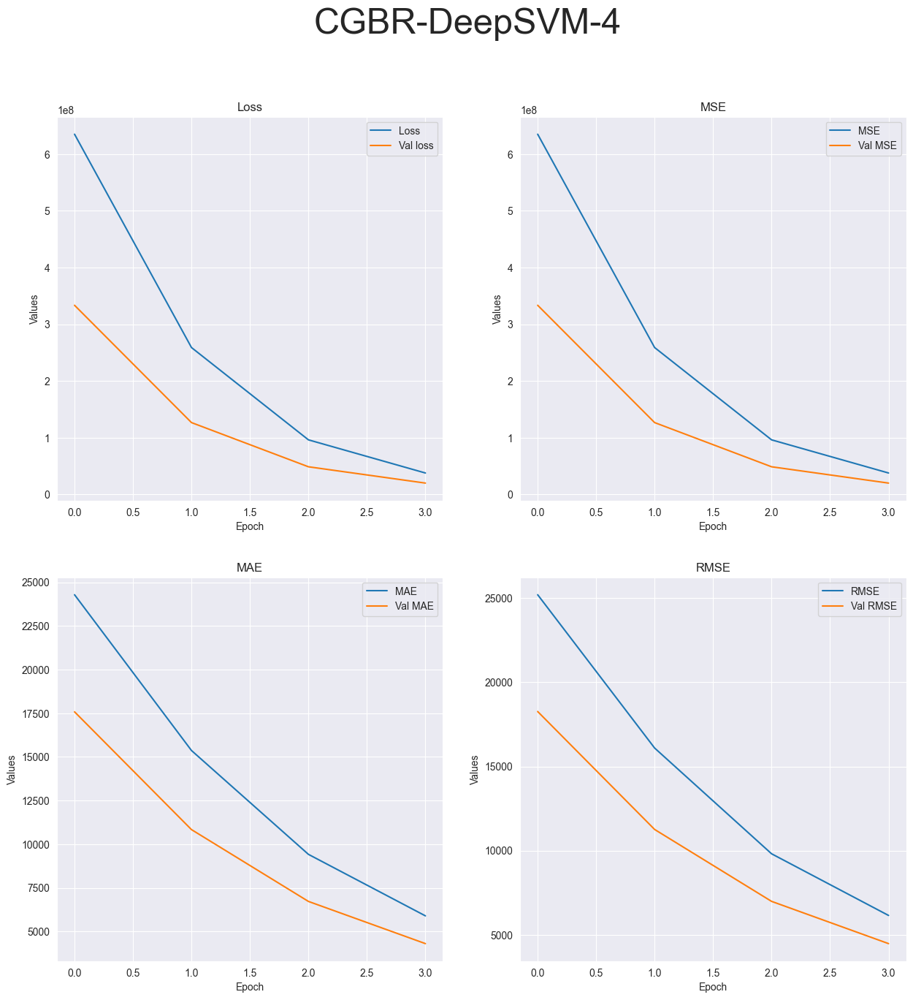

R-squared value: -62441129.7023


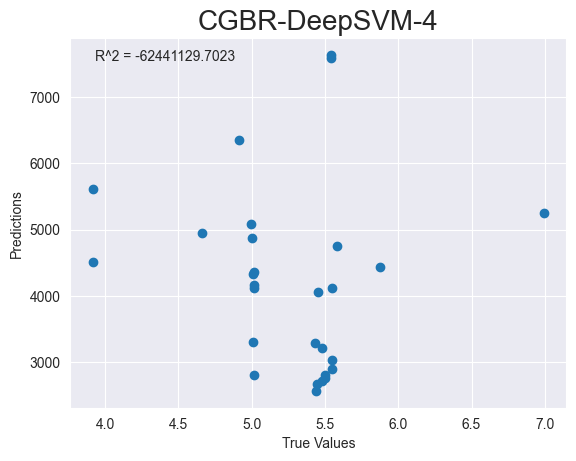

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_111"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_328 (Dense)           (None, 128)               384       
                                                                 
 dense_329 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


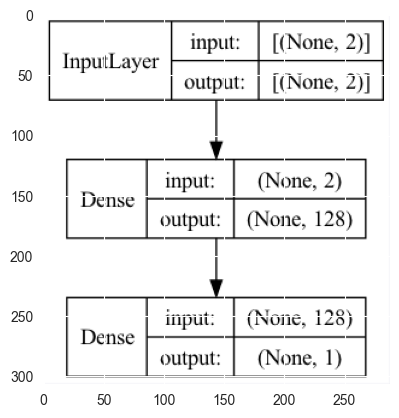

CGBR-DeepSVM-10
Epoch 1/10


2023-05-02 10:14:24.074577: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 153ms/step - loss: 652701760.0000 - mse: 652701760.0000 - mae: 24441.7637 - root_mean_squared_error: 25548.0293 - val_loss: 342012512.0000 - val_mse: 342012512.0000 - val_mae: 17967.2969 - val_root_mean_squared_error: 18493.5801
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 347420480.0000 - mse: 347420480.0000 - mae: 17670.9727 - root_mean_squared_error: 18639.2188

2023-05-02 10:14:24.530709: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 43ms/step - loss: 266695392.0000 - mse: 266695392.0000 - mae: 15508.0576 - root_mean_squared_error: 16330.8115 - val_loss: 130994320.0000 - val_mse: 130994320.0000 - val_mae: 11119.4297 - val_root_mean_squared_error: 11445.2754
Epoch 3/10
3/3 [==============================] - 0s 33ms/step - loss: 100132648.0000 - mse: 100132648.0000 - mae: 9553.6602 - root_mean_squared_error: 10006.6299 - val_loss: 50799800.0000 - val_mse: 50799800.0000 - val_mae: 6924.3501 - val_root_mean_squared_error: 7127.3979
Epoch 4/10
3/3 [==============================] - 0s 18ms/step - loss: 40202672.0000 - mse: 40202672.0000 - mae: 6023.3945 - root_mean_squared_error: 6340.5576 - val_loss: 20907364.0000 - val_mse: 20907364.0000 - val_mae: 4442.0776 - val_root_mean_squared_error: 4572.4570
Epoch 5/10
3/3 [==============================] - 0s 23ms/step - loss: 17280392.0000 - mse: 17280392.0000 - mae: 3928.6790 - root_mean_squared_error: 4156.9692 - val_loss: 9657933.0

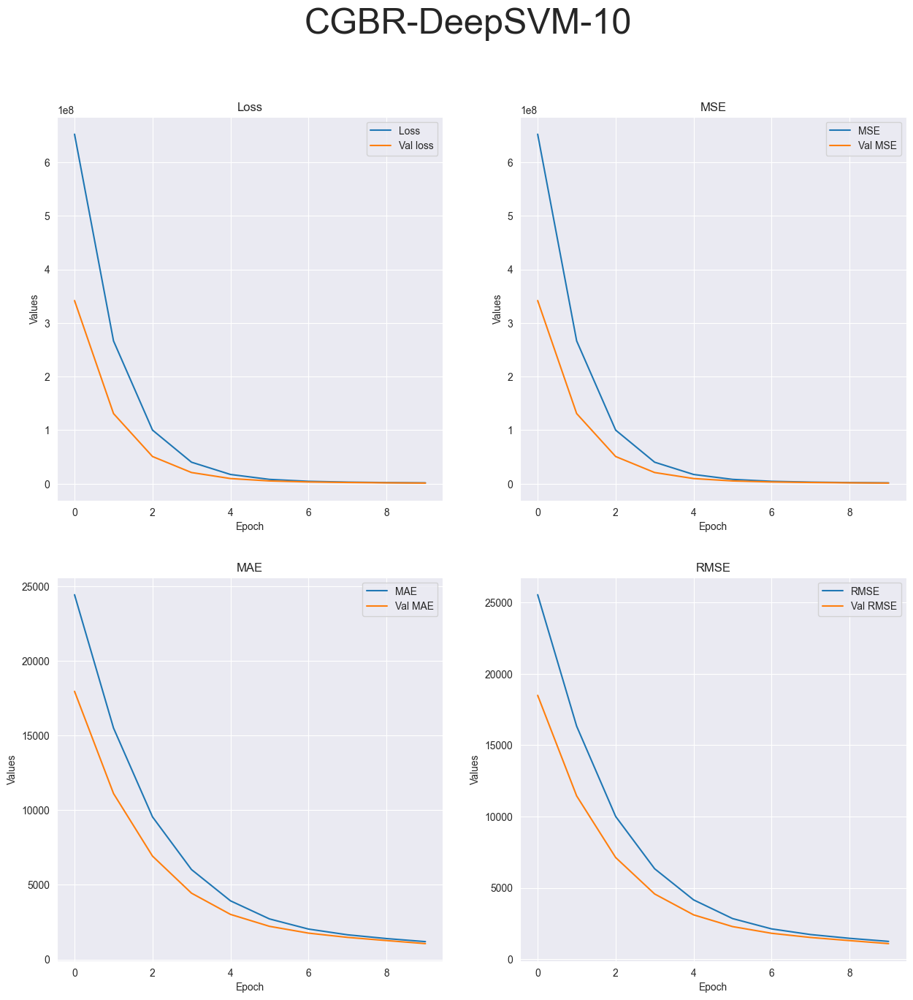

R-squared value: -2598875.6519


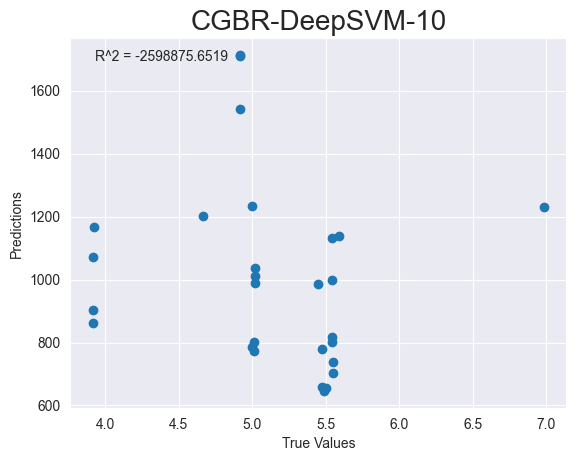

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_112"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_330 (Dense)           (None, 128)               384       
                                                                 
 dense_331 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


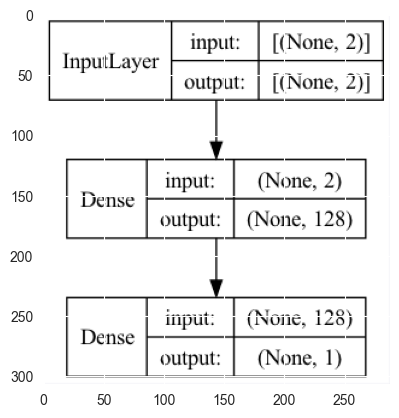

CGBR-DeepSVM-20
Epoch 1/20


2023-05-02 10:14:26.739552: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 194ms/step - loss: 639099712.0000 - mse: 639099712.0000 - mae: 24079.6426 - root_mean_squared_error: 25280.4219 - val_loss: 339436000.0000 - val_mse: 339436000.0000 - val_mae: 17909.3828 - val_root_mean_squared_error: 18423.7891
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 338121760.0000 - mse: 338121760.0000 - mae: 17792.8203 - root_mean_squared_error: 18388.0879

2023-05-02 10:14:27.326920: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 21ms/step - loss: 258347312.0000 - mse: 258347312.0000 - mae: 15322.3613 - root_mean_squared_error: 16073.1865 - val_loss: 132754496.0000 - val_mse: 132754496.0000 - val_mae: 11200.0908 - val_root_mean_squared_error: 11521.9141
Epoch 3/20
3/3 [==============================] - 0s 42ms/step - loss: 100334072.0000 - mse: 100334072.0000 - mae: 9547.2832 - root_mean_squared_error: 10016.6895 - val_loss: 52032256.0000 - val_mse: 52032256.0000 - val_mae: 7011.7451 - val_root_mean_squared_error: 7213.3389
Epoch 4/20
3/3 [==============================] - 0s 27ms/step - loss: 40190504.0000 - mse: 40190504.0000 - mae: 6033.7832 - root_mean_squared_error: 6339.5981 - val_loss: 21578740.0000 - val_mse: 21578740.0000 - val_mae: 4515.3647 - val_root_mean_squared_error: 4645.2925
Epoch 5/20
3/3 [==============================] - 0s 28ms/step - loss: 16723177.0000 - mse: 16723177.0000 - mae: 3921.4568 - root_mean_squared_error: 4089.3982 - val_loss: 10014250.

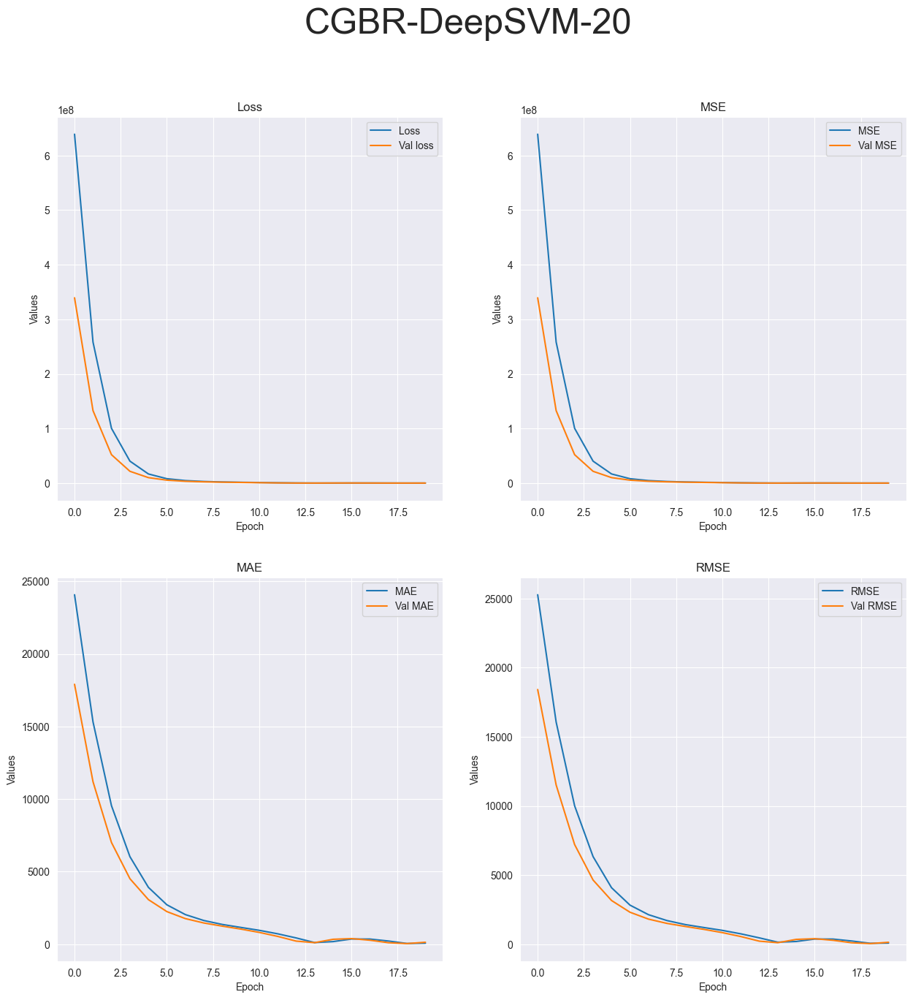

R-squared value: -64949.5615


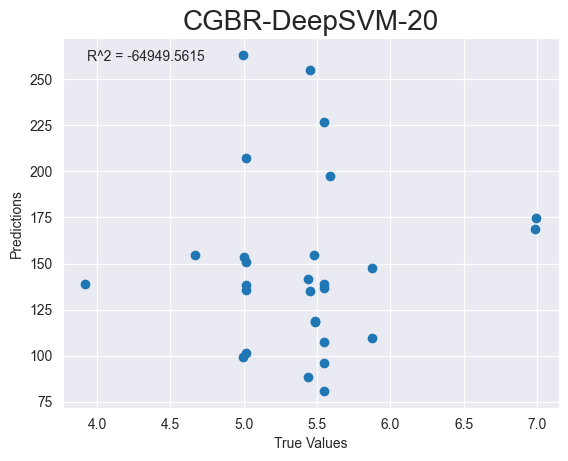

Running tests on FBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_113"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_332 (Dense)           (None, 64)                512       
                                                                 
 dropout_74 (Dropout)        (None, 64)                0         
                                                                 
 dense_333 (Dense)           (None, 32)                2080      
                                                                 
 dropout_75 (Dropout)        (None, 32)           

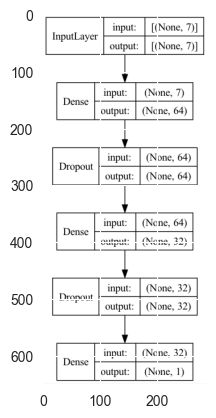

FBR-MLP-1


2023-05-02 10:14:29.885525: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 244ms/step - loss: 32.0309 - mse: 32.0309 - mae: 4.2104 - root_mean_squared_error: 5.6596 - val_loss: 4.9254 - val_mse: 4.9254 - val_mae: 2.0531 - val_root_mean_squared_error: 2.2193


2023-05-02 10:14:30.673354: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 112ms/step - loss: 5.2438 - mse: 5.2438 - mae: 2.0209 - root_mean_squared_error: 2.2899
Test loss: [5.243805885314941, 5.243805885314941, 2.0209381580352783, 2.289935827255249]
['loss', 'mse', 'mae', 'root_mean_squared_error']


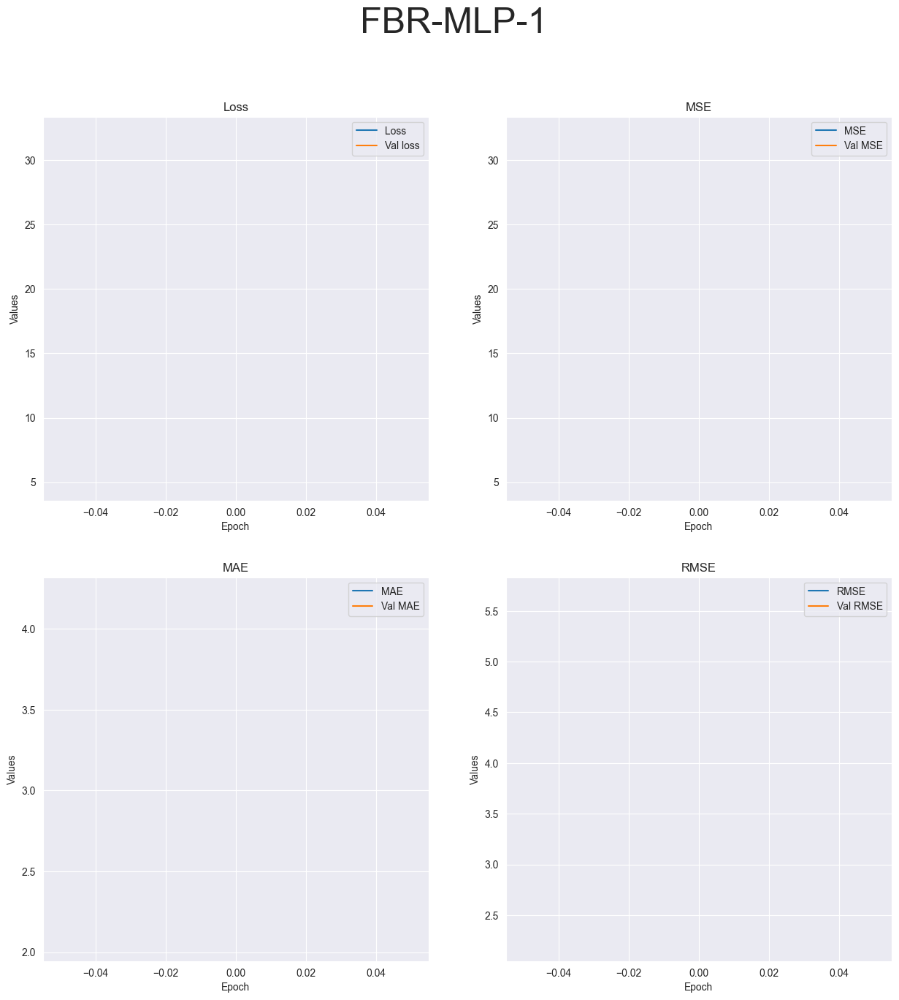

R-squared value: -9.1571


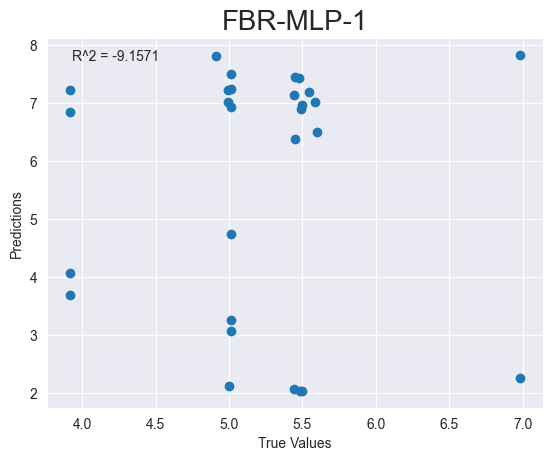

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_114"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_335 (Dense)           (None, 64)                512       
                                                                 
 dropout_76 (Dropout)        (None, 64)                0         
                                                                 
 dense_336 (Dense)           (None, 32)                2080      
                                                                 
 dropout_77 (Dropout)        (None, 32)                0         
                                               

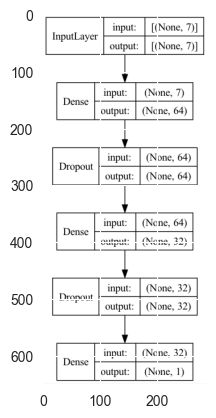

FBR-MLP-4
Epoch 1/4


2023-05-02 10:14:32.872409: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 255ms/step - loss: 21.5323 - mse: 21.5323 - mae: 3.7365 - root_mean_squared_error: 4.6403 - val_loss: 3.7175 - val_mse: 3.7175 - val_mae: 1.5622 - val_root_mean_squared_error: 1.9281
Epoch 2/4


2023-05-02 10:14:33.965234: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 33ms/step - loss: 12.2608 - mse: 12.2608 - mae: 2.8379 - root_mean_squared_error: 3.5015 - val_loss: 4.0169 - val_mse: 4.0169 - val_mae: 1.8556 - val_root_mean_squared_error: 2.0042
Epoch 3/4
3/3 [==============================] - 0s 33ms/step - loss: 5.3789 - mse: 5.3789 - mae: 1.8792 - root_mean_squared_error: 2.3192 - val_loss: 2.0763 - val_mse: 2.0763 - val_mae: 1.0990 - val_root_mean_squared_error: 1.4409
Epoch 4/4
1/1 [==============================] - 0s 73ms/step - loss: 1.3583 - mse: 1.3583 - mae: 0.9417 - root_mean_squared_error: 1.1655
Test loss: [1.35833740234375, 1.35833740234375, 0.9417212605476379, 1.1654772758483887]
['loss', 'mse', 'mae', 'root_mean_squared_error']


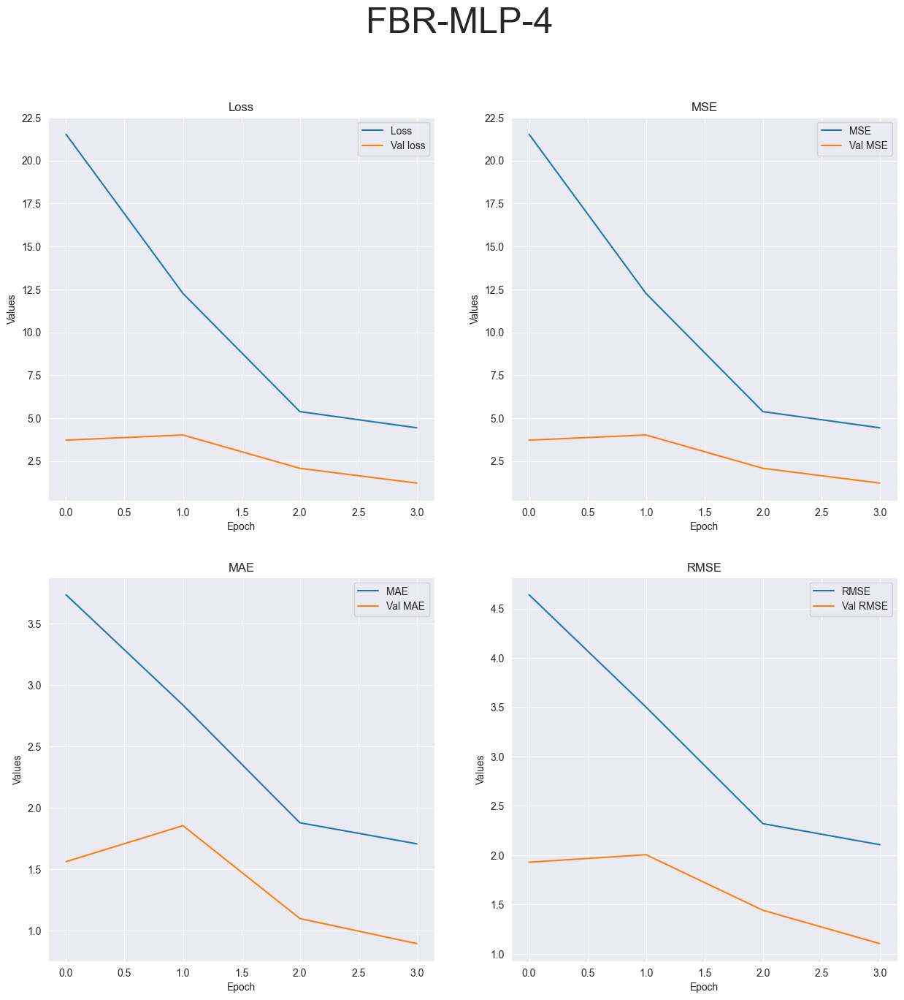

R-squared value: -2.2126


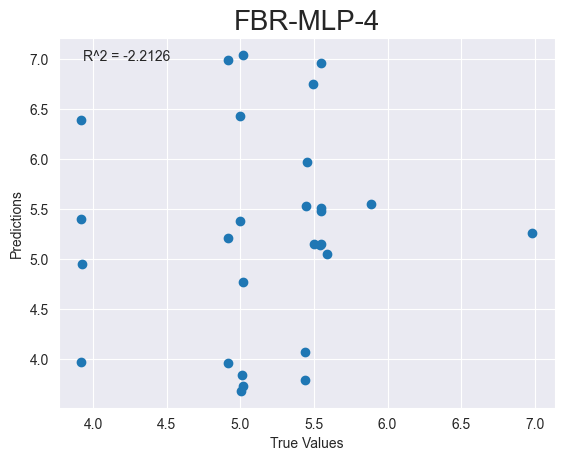

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_115"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_338 (Dense)           (None, 64)                512       
                                                                 
 dropout_78 (Dropout)        (None, 64)                0         
                                                                 
 dense_339 (Dense)           (None, 32)                2080      
                                                                 
 dropout_79 (Dropout)        (None, 32)                0         
                                              

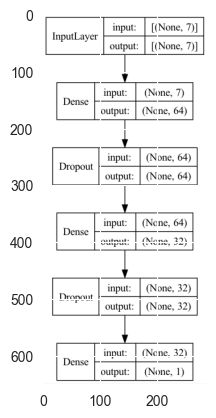

FBR-MLP-10
Epoch 1/10


2023-05-02 10:14:35.705836: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 298ms/step - loss: 24.8167 - mse: 24.8167 - mae: 4.1503 - root_mean_squared_error: 4.9816 - val_loss: 9.6615 - val_mse: 9.6615 - val_mae: 2.7035 - val_root_mean_squared_error: 3.1083
Epoch 2/10


2023-05-02 10:14:36.650037: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 44ms/step - loss: 12.9072 - mse: 12.9072 - mae: 2.8458 - root_mean_squared_error: 3.5927 - val_loss: 1.1824 - val_mse: 1.1824 - val_mae: 0.8311 - val_root_mean_squared_error: 1.0874
Epoch 3/10
3/3 [==============================] - 0s 34ms/step - loss: 5.1126 - mse: 5.1126 - mae: 1.8448 - root_mean_squared_error: 2.2611 - val_loss: 2.3613 - val_mse: 2.3613 - val_mae: 1.3282 - val_root_mean_squared_error: 1.5366
Epoch 4/10
3/3 [==============================] - 0s 27ms/step - loss: 4.0556 - mse: 4.0556 - mae: 1.6842 - root_mean_squared_error: 2.0139 - val_loss: 1.3349 - val_mse: 1.3349 - val_mae: 0.9993 - val_root_mean_squared_error: 1.1554
Epoch 5/10
3/3 [==============================] - 0s 19ms/step - loss: 3.1254 - mse: 3.1254 - mae: 1.3900 - root_mean_squared_error: 1.7679 - val_loss: 0.9880 - val_mse: 0.9880 - val_mae: 0.8853 - val_root_mean_squared_error: 0.9940
Epoch 6/10
3/3 [==============================] - 0s 22ms/step - loss: 2.4728

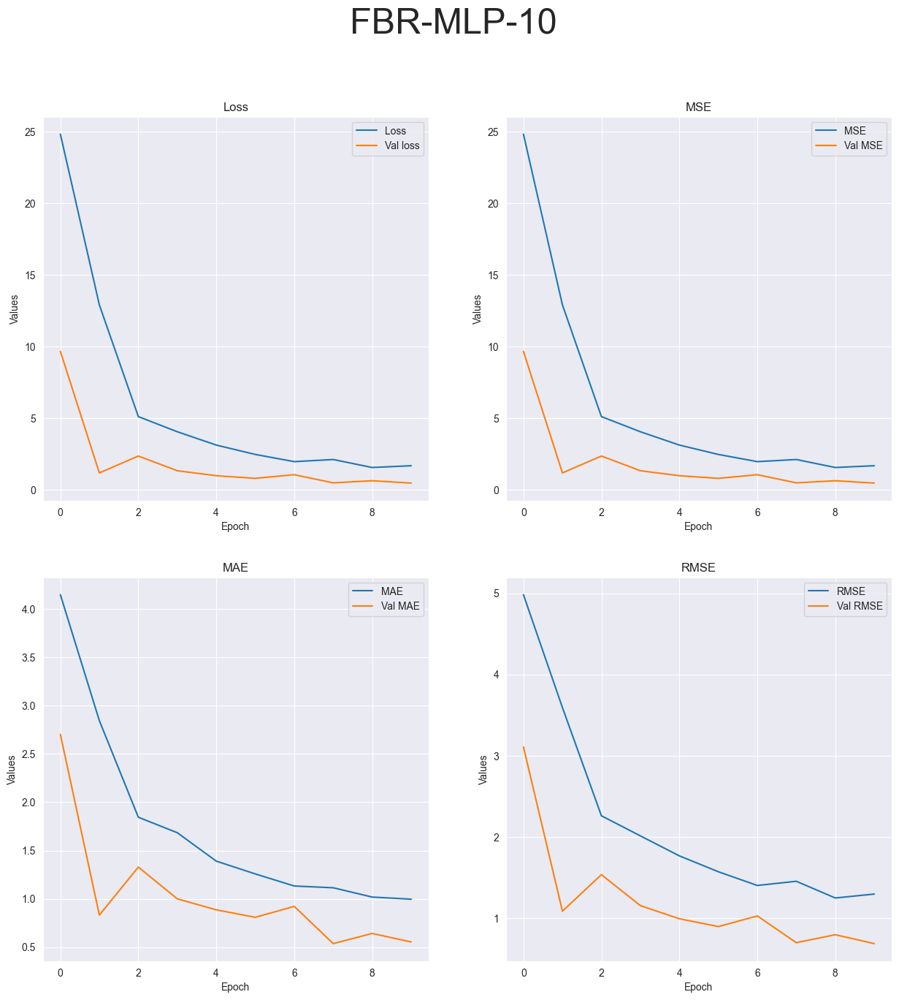

R-squared value: -1.0710


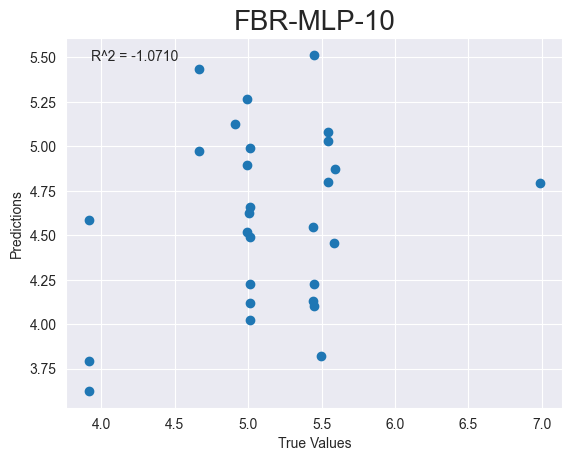

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_116"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_341 (Dense)           (None, 64)                512       
                                                                 
 dropout_80 (Dropout)        (None, 64)                0         
                                                                 
 dense_342 (Dense)           (None, 32)                2080      
                                                                 
 dropout_81 (Dropout)        (None, 32)                0         
                                              

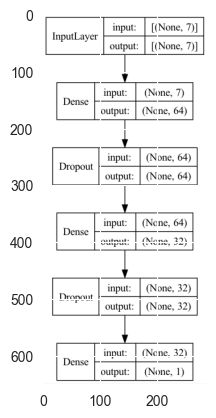

FBR-MLP-20
Epoch 1/20


2023-05-02 10:14:38.690727: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 226ms/step - loss: 22.6884 - mse: 22.6884 - mae: 3.6988 - root_mean_squared_error: 4.7632 - val_loss: 7.5359 - val_mse: 7.5359 - val_mae: 2.5560 - val_root_mean_squared_error: 2.7452
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 11.8493 - mse: 11.8493 - mae: 2.7677 - root_mean_squared_error: 3.4423

2023-05-02 10:14:39.515707: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 81ms/step - loss: 11.0443 - mse: 11.0443 - mae: 2.7611 - root_mean_squared_error: 3.3233 - val_loss: 2.2410 - val_mse: 2.2410 - val_mae: 1.0822 - val_root_mean_squared_error: 1.4970
Epoch 3/20
3/3 [==============================] - 0s 33ms/step - loss: 6.6899 - mse: 6.6899 - mae: 2.1364 - root_mean_squared_error: 2.5865 - val_loss: 3.0585 - val_mse: 3.0585 - val_mae: 1.6357 - val_root_mean_squared_error: 1.7489
Epoch 4/20
3/3 [==============================] - 0s 43ms/step - loss: 4.2040 - mse: 4.2040 - mae: 1.6353 - root_mean_squared_error: 2.0504 - val_loss: 1.0980 - val_mse: 1.0980 - val_mae: 0.9592 - val_root_mean_squared_error: 1.0479
Epoch 5/20
3/3 [==============================] - 0s 40ms/step - loss: 3.8028 - mse: 3.8028 - mae: 1.5530 - root_mean_squared_error: 1.9501 - val_loss: 0.9863 - val_mse: 0.9863 - val_mae: 0.7696 - val_root_mean_squared_error: 0.9931
Epoch 6/20
3/3 [==============================] - 0s 18ms/step - loss: 2.9836

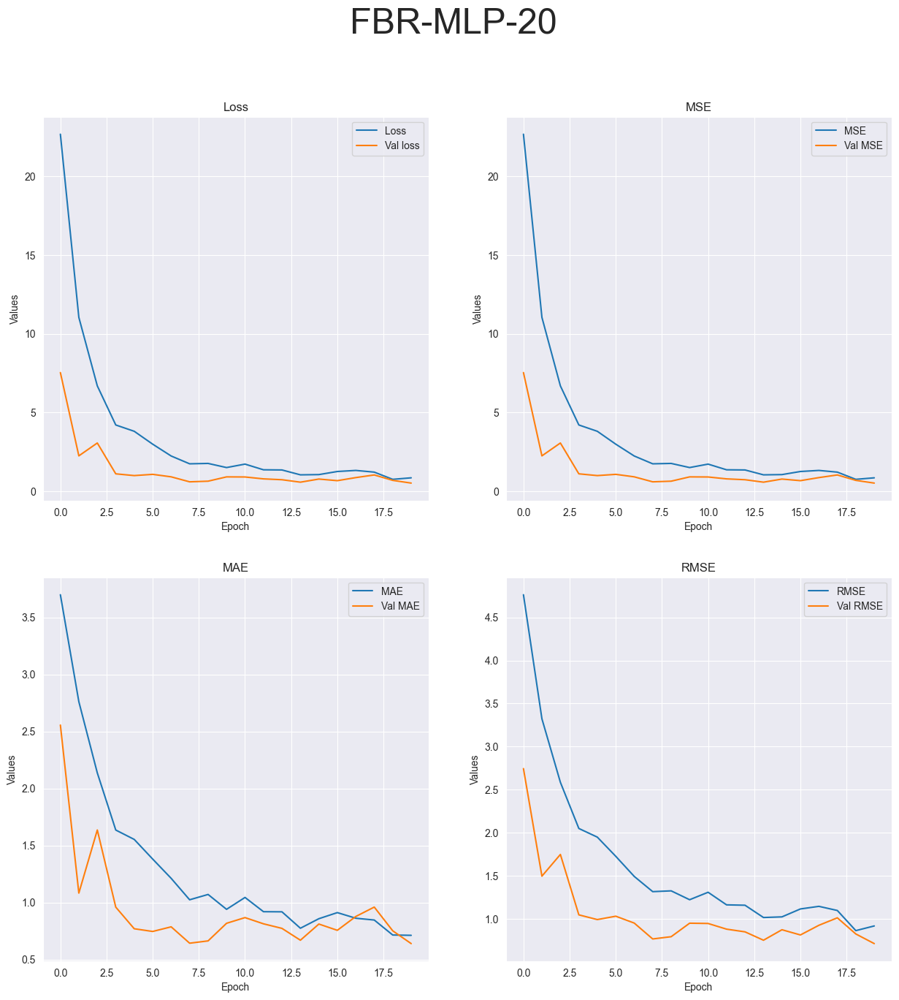

R-squared value: -0.7856


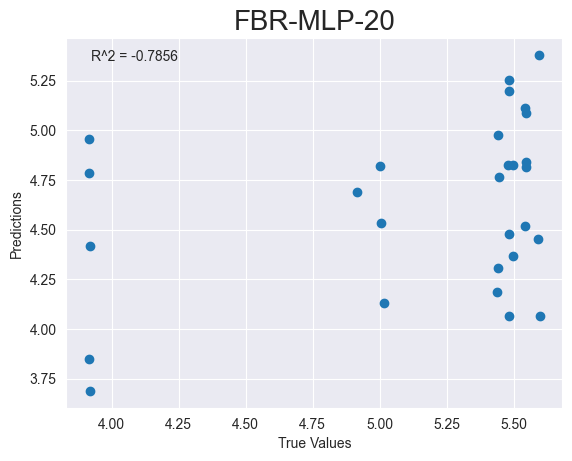

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_117"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_344 (Dense)           (None, 64)                512       
                                                                 
 dense_345 (Dense)           (None, 32)                2080      
                                                                 
 dense_346 (Dense)           (None, 16)                528       
                                                                 
 dense_347 (Dense)           (None, 1)                 17        
                   

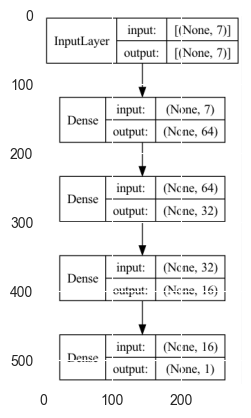

FBR-FCNN-1


2023-05-02 10:14:42.335499: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 236ms/step - loss: 28.5961 - mse: 28.5961 - mae: 4.7138 - root_mean_squared_error: 5.3475 - val_loss: 2.0503 - val_mse: 2.0503 - val_mae: 1.0778 - val_root_mean_squared_error: 1.4319


2023-05-02 10:14:43.114159: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 63ms/step - loss: 3.6836 - mse: 3.6836 - mae: 1.6908 - root_mean_squared_error: 1.9193
Test loss: [3.683612823486328, 3.683612823486328, 1.6908342838287354, 1.919274091720581]
['loss', 'mse', 'mae', 'root_mean_squared_error']


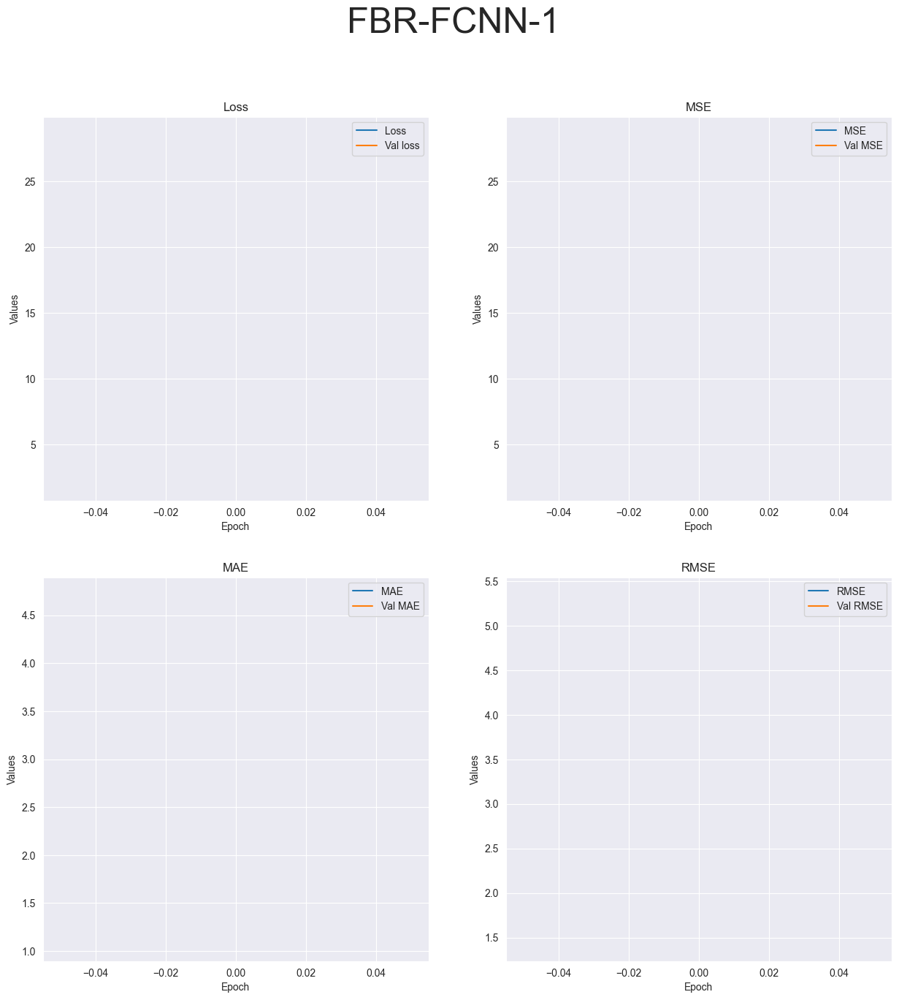

R-squared value: -6.7780


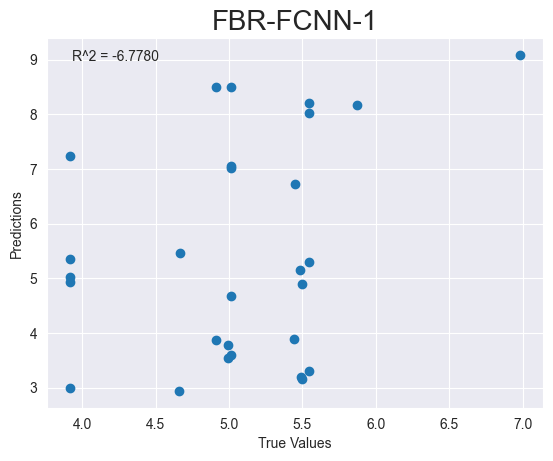

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_118"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_348 (Dense)           (None, 64)                512       
                                                                 
 dense_349 (Dense)           (None, 32)                2080      
                                                                 
 dense_350 (Dense)           (None, 16)                528       
                                                                 
 dense_351 (Dense)           (None, 1)                 17        
                                               

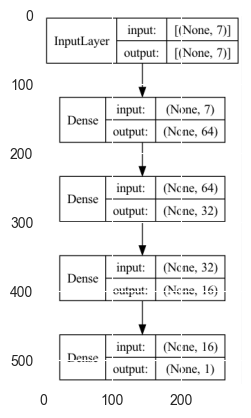

FBR-FCNN-4
Epoch 1/4


2023-05-02 10:14:45.305379: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 230ms/step - loss: 32.1392 - mse: 32.1392 - mae: 4.8628 - root_mean_squared_error: 5.6691 - val_loss: 1.9927 - val_mse: 1.9927 - val_mae: 1.1531 - val_root_mean_squared_error: 1.4116
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 2.7897 - mse: 2.7897 - mae: 1.3901 - root_mean_squared_error: 1.6702

2023-05-02 10:14:46.044043: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 37ms/step - loss: 5.6133 - mse: 5.6133 - mae: 2.0771 - root_mean_squared_error: 2.3692 - val_loss: 7.1326 - val_mse: 7.1326 - val_mae: 2.1708 - val_root_mean_squared_error: 2.6707
Epoch 3/4
3/3 [==============================] - 0s 64ms/step - loss: 5.8842 - mse: 5.8842 - mae: 2.0508 - root_mean_squared_error: 2.4257 - val_loss: 2.6699 - val_mse: 2.6699 - val_mae: 1.3062 - val_root_mean_squared_error: 1.6340
Epoch 4/4
1/1 [==============================] - 0s 88ms/step - loss: 1.5042 - mse: 1.5042 - mae: 1.0185 - root_mean_squared_error: 1.2265
Test loss: [1.504243016242981, 1.504243016242981, 1.0184556245803833, 1.2264758348464966]
['loss', 'mse', 'mae', 'root_mean_squared_error']


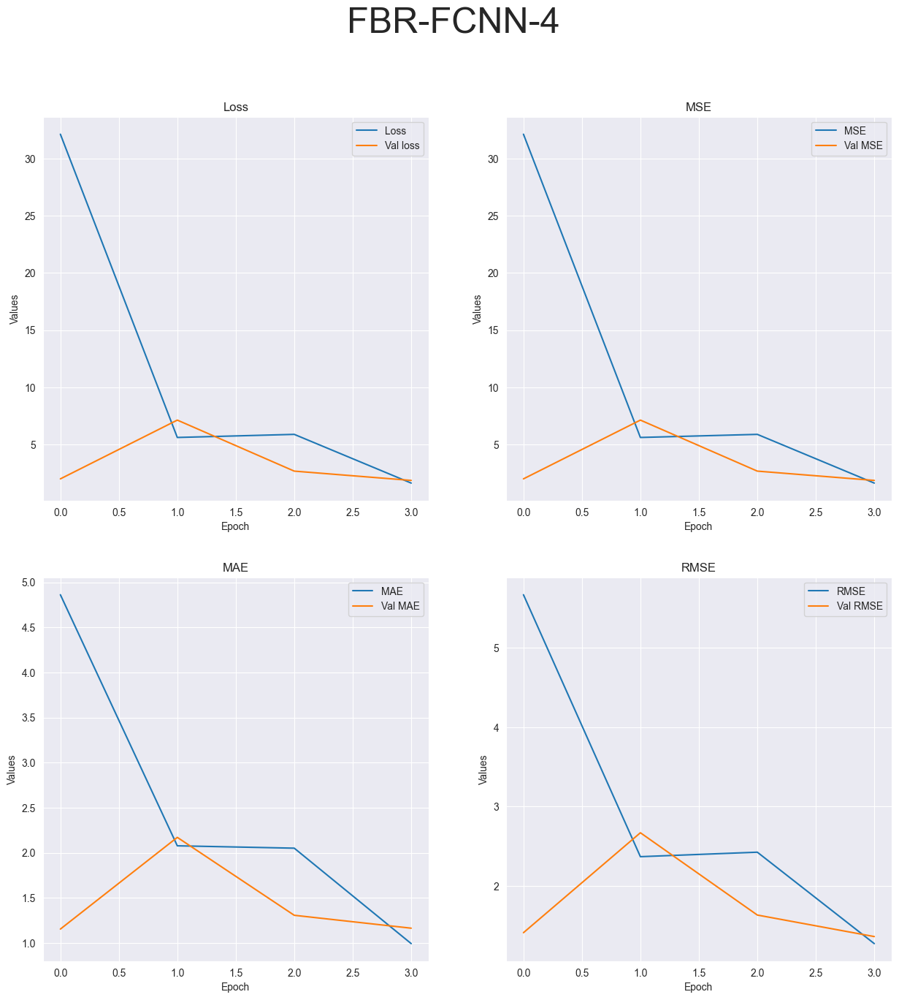

R-squared value: -2.5663


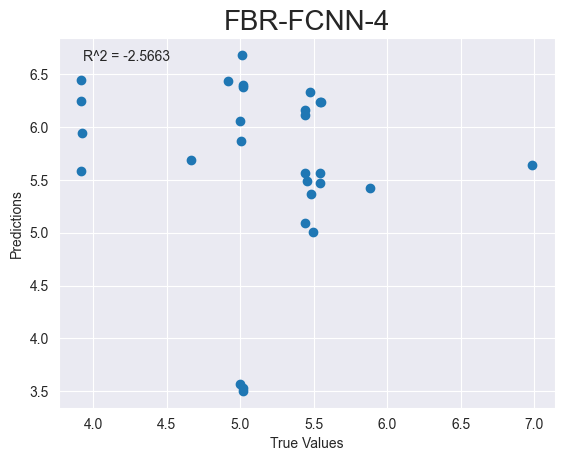

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_119"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_352 (Dense)           (None, 64)                512       
                                                                 
 dense_353 (Dense)           (None, 32)                2080      
                                                                 
 dense_354 (Dense)           (None, 16)                528       
                                                                 
 dense_355 (Dense)           (None, 1)                 17        
                                              

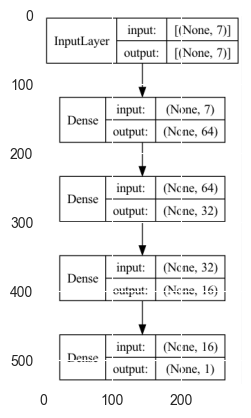

FBR-FCNN-10
Epoch 1/10


2023-05-02 10:14:47.879045: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 204ms/step - loss: 29.5243 - mse: 29.5243 - mae: 4.6581 - root_mean_squared_error: 5.4336 - val_loss: 3.7443 - val_mse: 3.7443 - val_mae: 1.3006 - val_root_mean_squared_error: 1.9350
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 3.4871 - mse: 3.4871 - mae: 1.1986 - root_mean_squared_error: 1.8674

2023-05-02 10:14:48.557882: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 59ms/step - loss: 5.0584 - mse: 5.0584 - mae: 1.8289 - root_mean_squared_error: 2.2491 - val_loss: 6.6012 - val_mse: 6.6012 - val_mae: 2.3732 - val_root_mean_squared_error: 2.5693
Epoch 3/10
3/3 [==============================] - 0s 20ms/step - loss: 6.1536 - mse: 6.1536 - mae: 2.2193 - root_mean_squared_error: 2.4806 - val_loss: 2.1227 - val_mse: 2.1227 - val_mae: 1.1758 - val_root_mean_squared_error: 1.4570
Epoch 4/10
3/3 [==============================] - 0s 31ms/step - loss: 1.9991 - mse: 1.9991 - mae: 1.0761 - root_mean_squared_error: 1.4139 - val_loss: 3.1343 - val_mse: 3.1343 - val_mae: 1.3647 - val_root_mean_squared_error: 1.7704
Epoch 5/10
3/3 [==============================] - 0s 27ms/step - loss: 1.6979 - mse: 1.6979 - mae: 1.0156 - root_mean_squared_error: 1.3030 - val_loss: 1.1539 - val_mse: 1.1539 - val_mae: 0.8649 - val_root_mean_squared_error: 1.0742
Epoch 6/10
3/3 [==============================] - 0s 27ms/step - loss: 0.7796 -

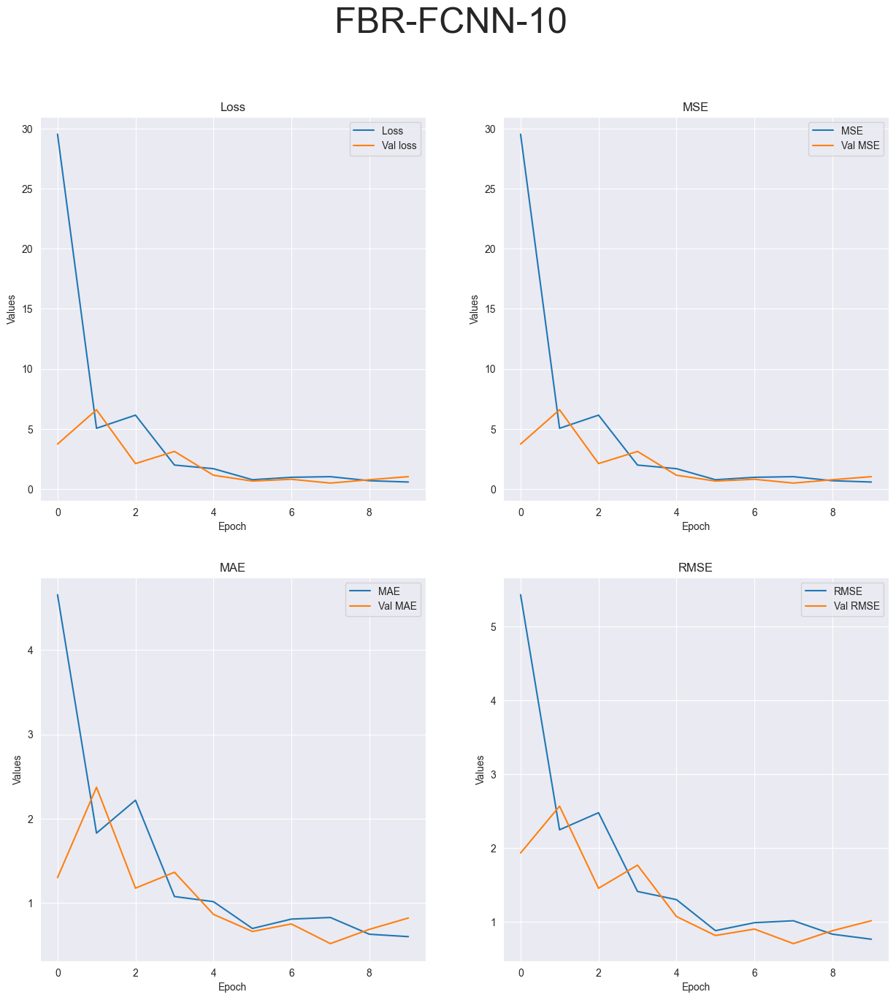

R-squared value: -0.4716


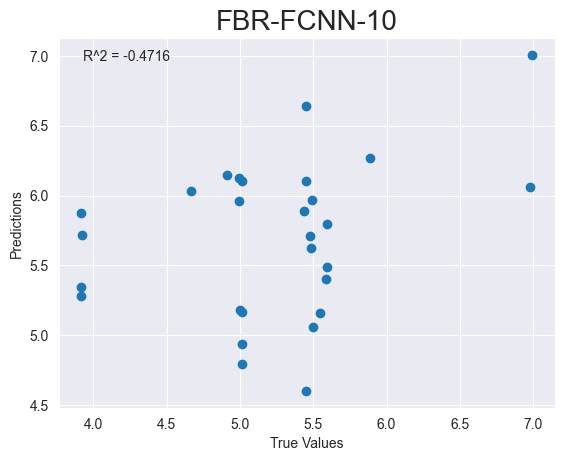

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_120"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_356 (Dense)           (None, 64)                512       
                                                                 
 dense_357 (Dense)           (None, 32)                2080      
                                                                 
 dense_358 (Dense)           (None, 16)                528       
                                                                 
 dense_359 (Dense)           (None, 1)                 17        
                                              

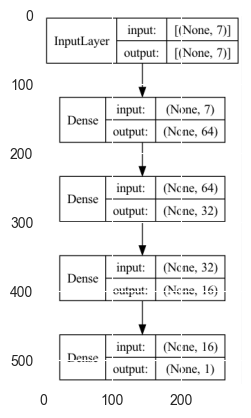

FBR-FCNN-20
Epoch 1/20


2023-05-02 10:14:50.720945: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 212ms/step - loss: 33.4494 - mse: 33.4494 - mae: 5.0333 - root_mean_squared_error: 5.7835 - val_loss: 1.1166 - val_mse: 1.1166 - val_mae: 0.9555 - val_root_mean_squared_error: 1.0567
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 1.1296 - mse: 1.1296 - mae: 0.9536 - root_mean_squared_error: 1.0628

2023-05-02 10:14:51.509408: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 105ms/step - loss: 5.2586 - mse: 5.2586 - mae: 1.8986 - root_mean_squared_error: 2.2932 - val_loss: 6.8082 - val_mse: 6.8082 - val_mae: 2.2607 - val_root_mean_squared_error: 2.6093
Epoch 3/20
3/3 [==============================] - 0s 46ms/step - loss: 5.7254 - mse: 5.7254 - mae: 1.9969 - root_mean_squared_error: 2.3928 - val_loss: 1.2990 - val_mse: 1.2990 - val_mae: 0.9316 - val_root_mean_squared_error: 1.1397
Epoch 4/20
3/3 [==============================] - 0s 33ms/step - loss: 1.3192 - mse: 1.3192 - mae: 0.9187 - root_mean_squared_error: 1.1486 - val_loss: 1.1243 - val_mse: 1.1243 - val_mae: 0.8733 - val_root_mean_squared_error: 1.0603
Epoch 5/20
3/3 [==============================] - 0s 32ms/step - loss: 1.5224 - mse: 1.5224 - mae: 1.0729 - root_mean_squared_error: 1.2339 - val_loss: 0.7127 - val_mse: 0.7127 - val_mae: 0.6690 - val_root_mean_squared_error: 0.8442
Epoch 6/20
3/3 [==============================] - 0s 27ms/step - loss: 0.9632 

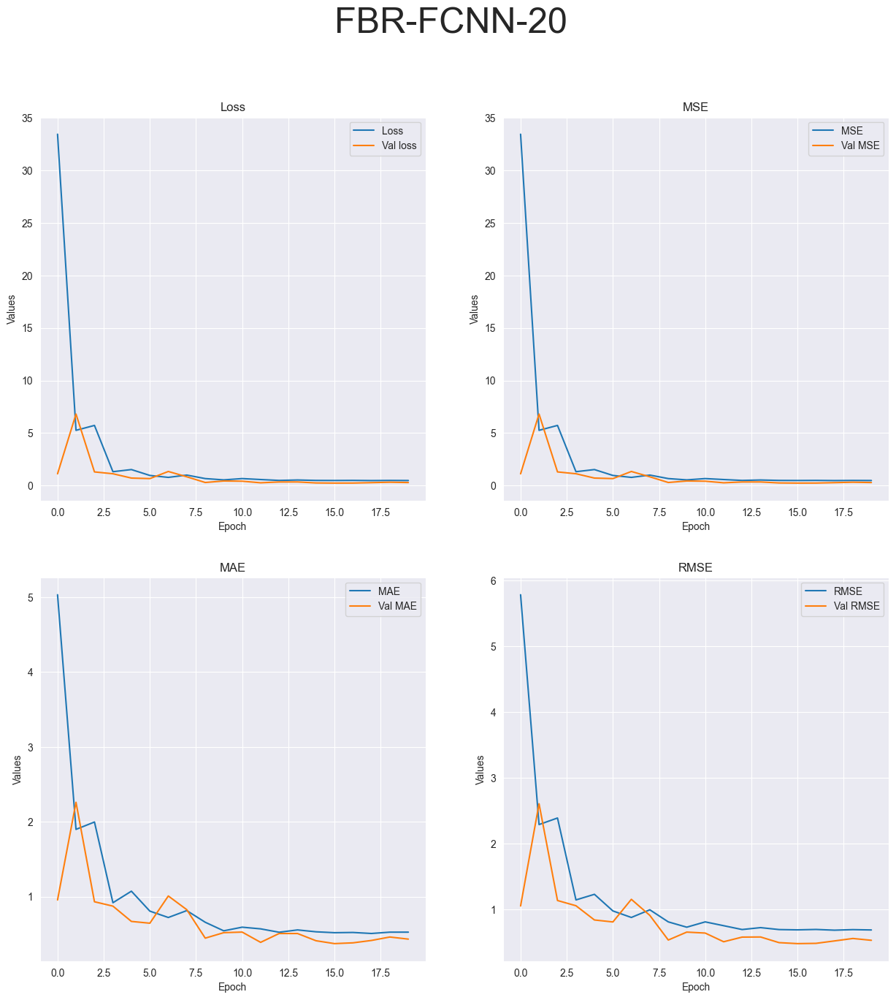

R-squared value: 0.1041


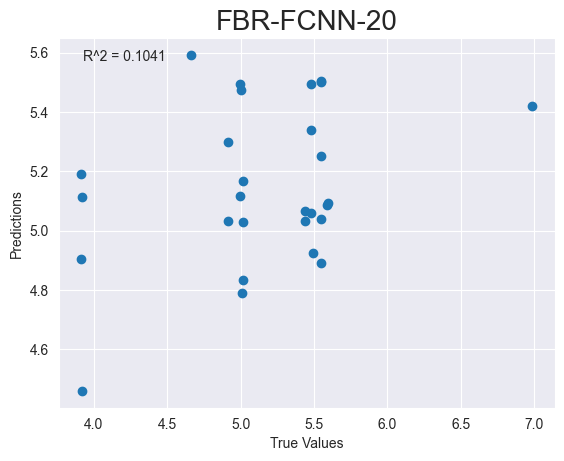

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_121"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_360 (Dense)           (None, 128)               1024      
                                                                 
 dense_361 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


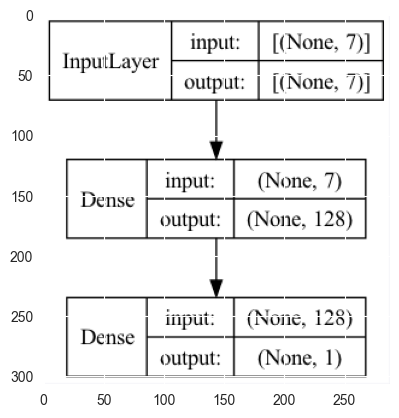

FBR-DeepSVM-1


2023-05-02 10:14:54.338063: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 225ms/step - loss: 20.6242 - mse: 20.4889 - mae: 3.7274 - root_mean_squared_error: 4.5265 - val_loss: 4.7996 - val_mse: 4.6659 - val_mae: 1.8354 - val_root_mean_squared_error: 2.1601


2023-05-02 10:14:55.077111: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 87ms/step - loss: 5.3515 - mse: 5.2178 - mae: 1.9827 - root_mean_squared_error: 2.2843
Test loss: [5.351540565490723, 5.217797756195068, 1.982715368270874, 2.284250020980835]
['loss', 'mse', 'mae', 'root_mean_squared_error']


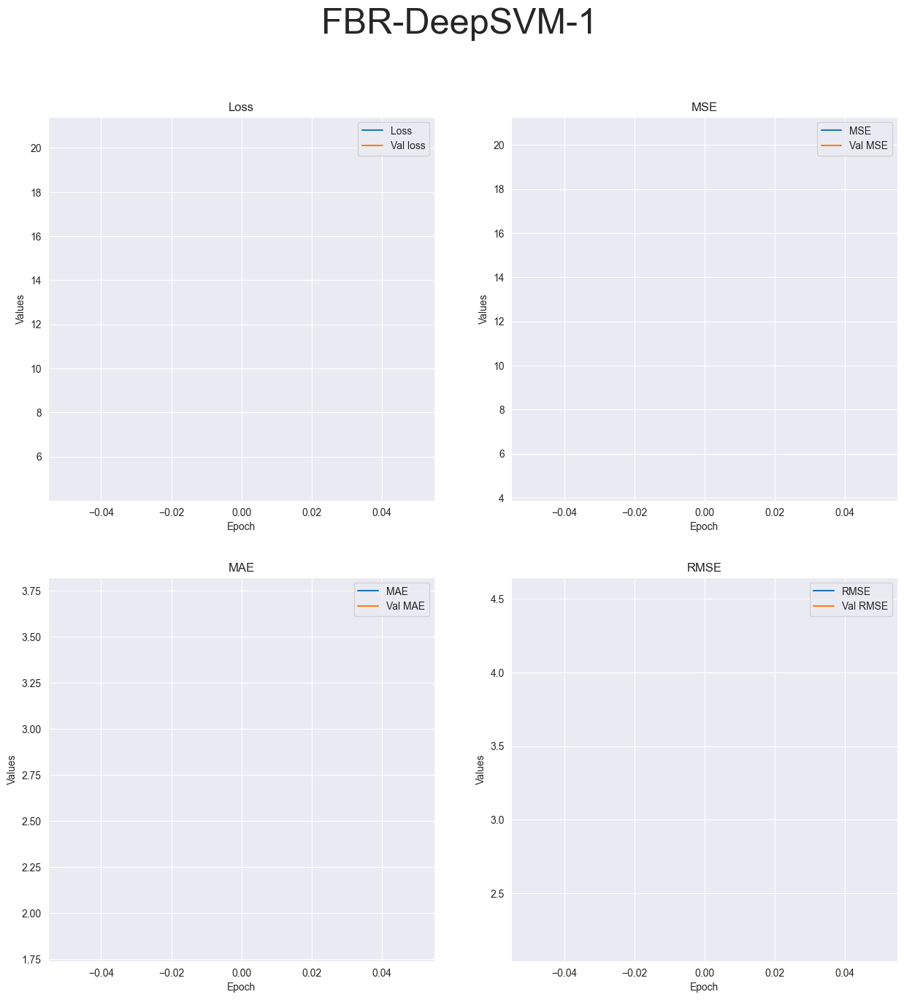

R-squared value: -7.0711


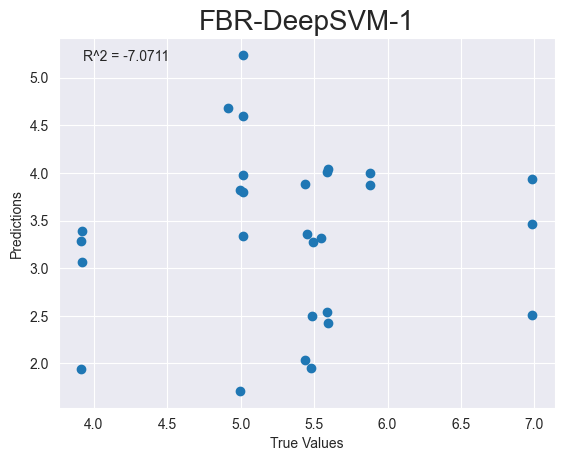

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_122"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_362 (Dense)           (None, 128)               1024      
                                                                 
 dense_363 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


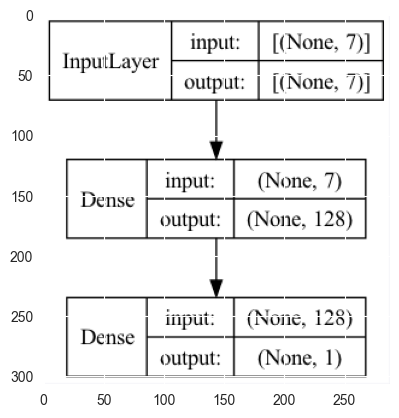

FBR-DeepSVM-4
Epoch 1/4


2023-05-02 10:14:57.324110: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 230ms/step - loss: 22.3093 - mse: 22.1737 - mae: 4.0545 - root_mean_squared_error: 4.7089 - val_loss: 7.4561 - val_mse: 7.3211 - val_mae: 2.2335 - val_root_mean_squared_error: 2.7058
Epoch 2/4


2023-05-02 10:14:58.304056: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 77ms/step - loss: 9.8224 - mse: 9.6885 - mae: 2.4759 - root_mean_squared_error: 3.1126 - val_loss: 18.6034 - val_mse: 18.4709 - val_mae: 3.7913 - val_root_mean_squared_error: 4.2978
Epoch 3/4
3/3 [==============================] - 0s 29ms/step - loss: 8.4048 - mse: 8.2723 - mae: 2.1322 - root_mean_squared_error: 2.8762 - val_loss: 7.1144 - val_mse: 6.9813 - val_mae: 2.3600 - val_root_mean_squared_error: 2.6422
Epoch 4/4
1/1 [==============================] - 0s 67ms/step - loss: 5.2448 - mse: 5.1128 - mae: 1.9283 - root_mean_squared_error: 2.2612
Test loss: [5.244844913482666, 5.112817287445068, 1.9282782077789307, 2.2611539363861084]
['loss', 'mse', 'mae', 'root_mean_squared_error']


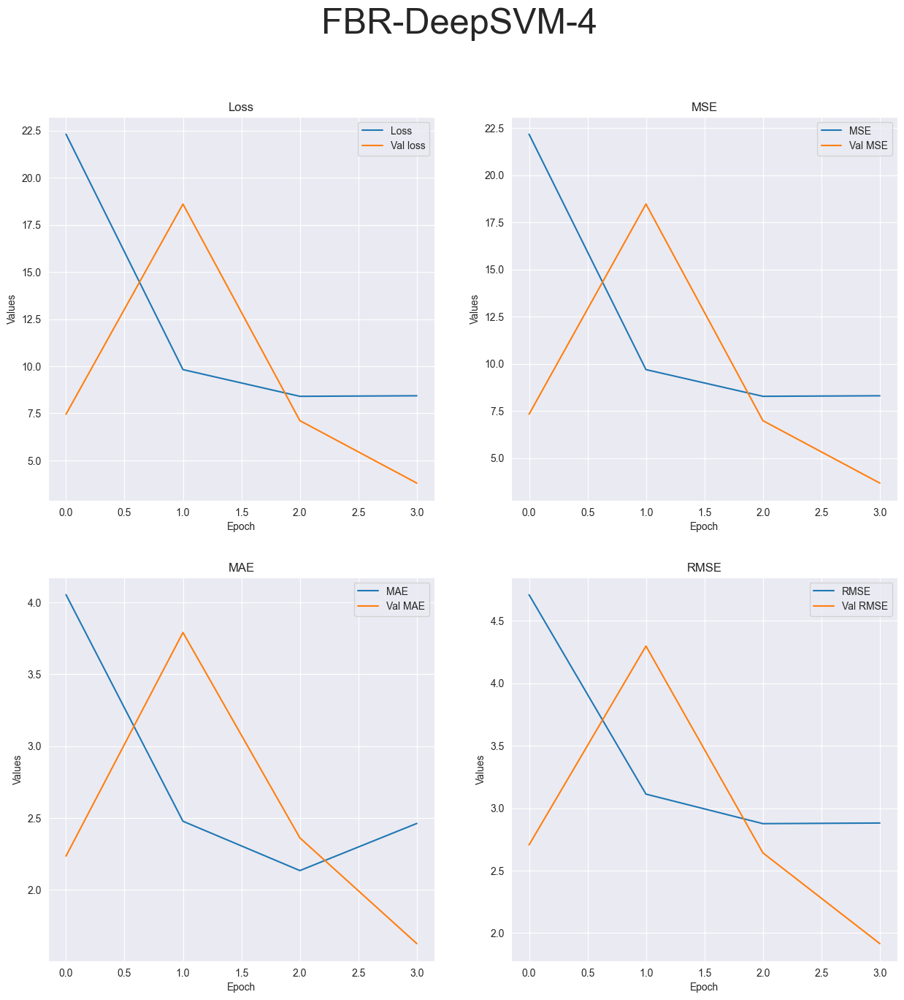

R-squared value: -6.1884


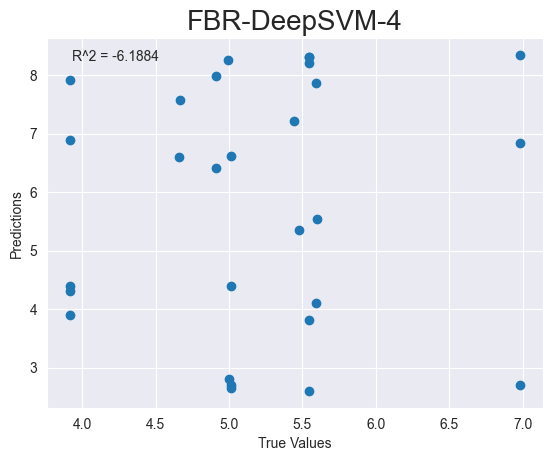

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_123"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_364 (Dense)           (None, 128)               1024      
                                                                 
 dense_365 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


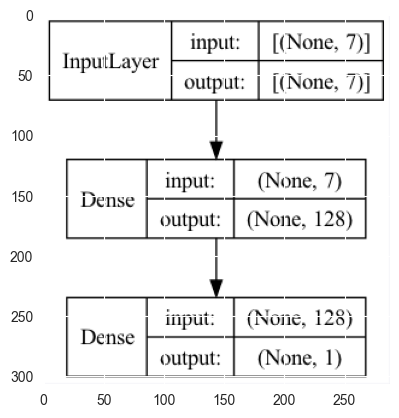

FBR-DeepSVM-10
Epoch 1/10


2023-05-02 10:15:00.158529: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 221ms/step - loss: 26.0199 - mse: 25.8843 - mae: 4.3210 - root_mean_squared_error: 5.0877 - val_loss: 14.4097 - val_mse: 14.2745 - val_mae: 3.5357 - val_root_mean_squared_error: 3.7782
Epoch 2/10


2023-05-02 10:15:00.785093: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 36ms/step - loss: 7.8753 - mse: 7.7412 - mae: 2.2532 - root_mean_squared_error: 2.7823 - val_loss: 20.8989 - val_mse: 20.7663 - val_mae: 3.9341 - val_root_mean_squared_error: 4.5570
Epoch 3/10
3/3 [==============================] - 0s 19ms/step - loss: 12.1172 - mse: 11.9846 - mae: 2.7405 - root_mean_squared_error: 3.4619 - val_loss: 1.3642 - val_mse: 1.2312 - val_mae: 0.8868 - val_root_mean_squared_error: 1.1096
Epoch 4/10
3/3 [==============================] - 0s 25ms/step - loss: 5.7825 - mse: 5.6494 - mae: 1.8255 - root_mean_squared_error: 2.3768 - val_loss: 10.3697 - val_mse: 10.2370 - val_mae: 2.8550 - val_root_mean_squared_error: 3.1995
Epoch 5/10
3/3 [==============================] - 0s 36ms/step - loss: 5.1152 - mse: 4.9832 - mae: 1.8020 - root_mean_squared_error: 2.2323 - val_loss: 1.4033 - val_mse: 1.2725 - val_mae: 1.0077 - val_root_mean_squared_error: 1.1280
Epoch 6/10
3/3 [==============================] - 0s 35ms/step - loss: 3.

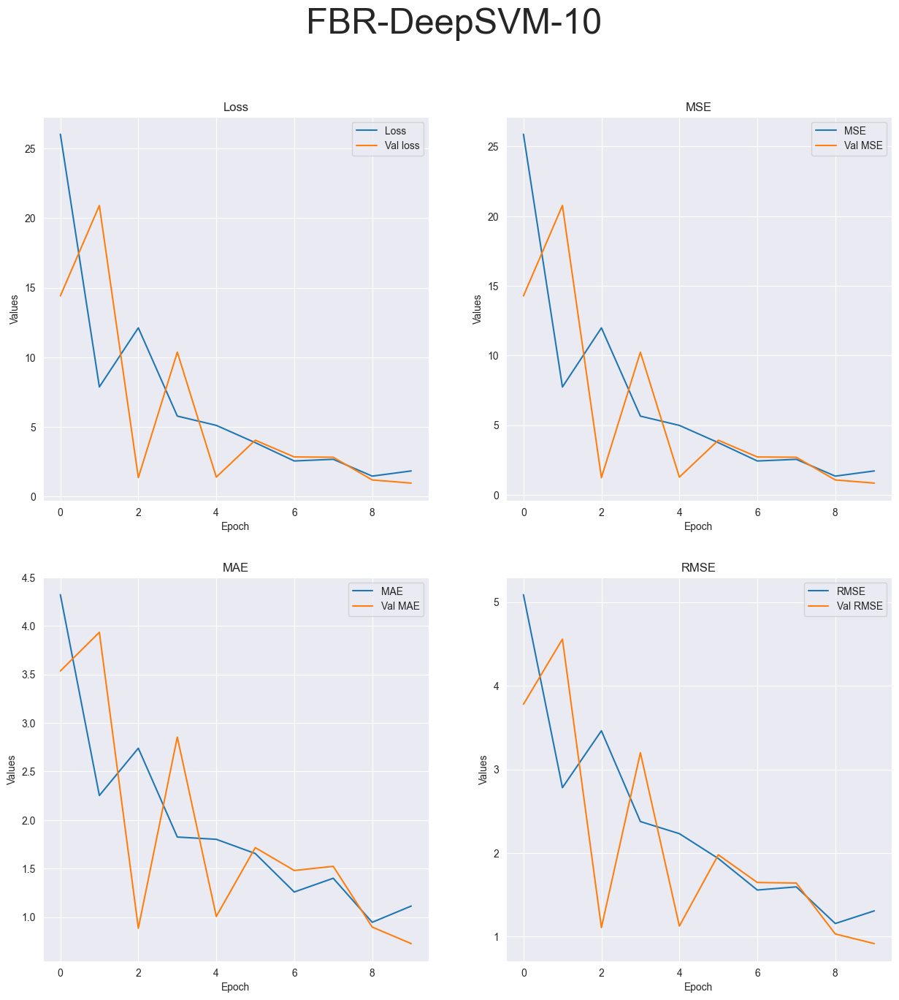

R-squared value: -1.6059


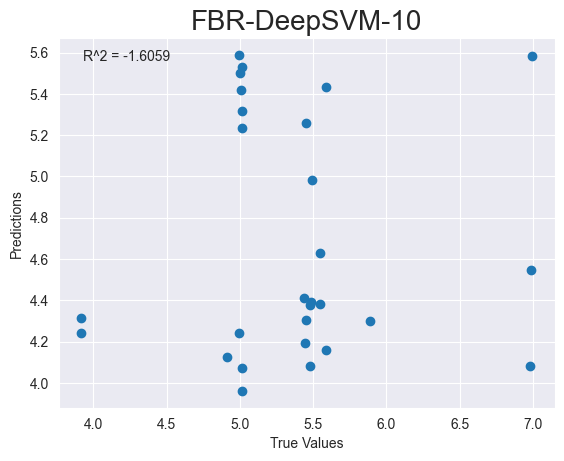

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_124"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_366 (Dense)           (None, 128)               1024      
                                                                 
 dense_367 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


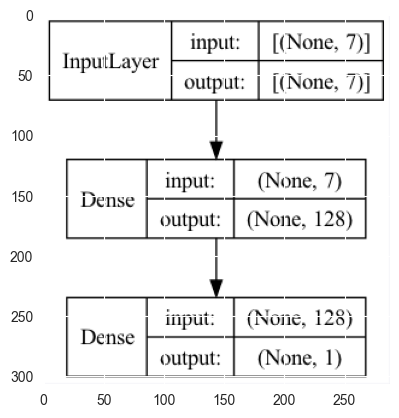

FBR-DeepSVM-20
Epoch 1/20


2023-05-02 10:15:02.823821: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 205ms/step - loss: 20.0001 - mse: 19.8646 - mae: 3.6293 - root_mean_squared_error: 4.4570 - val_loss: 4.6036 - val_mse: 4.4693 - val_mae: 1.8545 - val_root_mean_squared_error: 2.1141
Epoch 2/20


2023-05-02 10:15:03.526383: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 72ms/step - loss: 11.2396 - mse: 11.1059 - mae: 2.6535 - root_mean_squared_error: 3.3326 - val_loss: 1.4421 - val_mse: 1.3090 - val_mae: 1.0326 - val_root_mean_squared_error: 1.1441
Epoch 3/20
3/3 [==============================] - 0s 46ms/step - loss: 4.1160 - mse: 3.9827 - mae: 1.4945 - root_mean_squared_error: 1.9957 - val_loss: 4.9911 - val_mse: 4.8580 - val_mae: 1.7877 - val_root_mean_squared_error: 2.2041
Epoch 4/20
3/3 [==============================] - 0s 19ms/step - loss: 4.0945 - mse: 3.9619 - mae: 1.5049 - root_mean_squared_error: 1.9905 - val_loss: 3.6095 - val_mse: 3.4779 - val_mae: 1.6051 - val_root_mean_squared_error: 1.8649
Epoch 5/20
3/3 [==============================] - 0s 25ms/step - loss: 4.0152 - mse: 3.8837 - mae: 1.6425 - root_mean_squared_error: 1.9707 - val_loss: 2.9200 - val_mse: 2.7883 - val_mae: 1.4779 - val_root_mean_squared_error: 1.6698
Epoch 6/20
3/3 [==============================] - 0s 19ms/step - loss: 1.4186

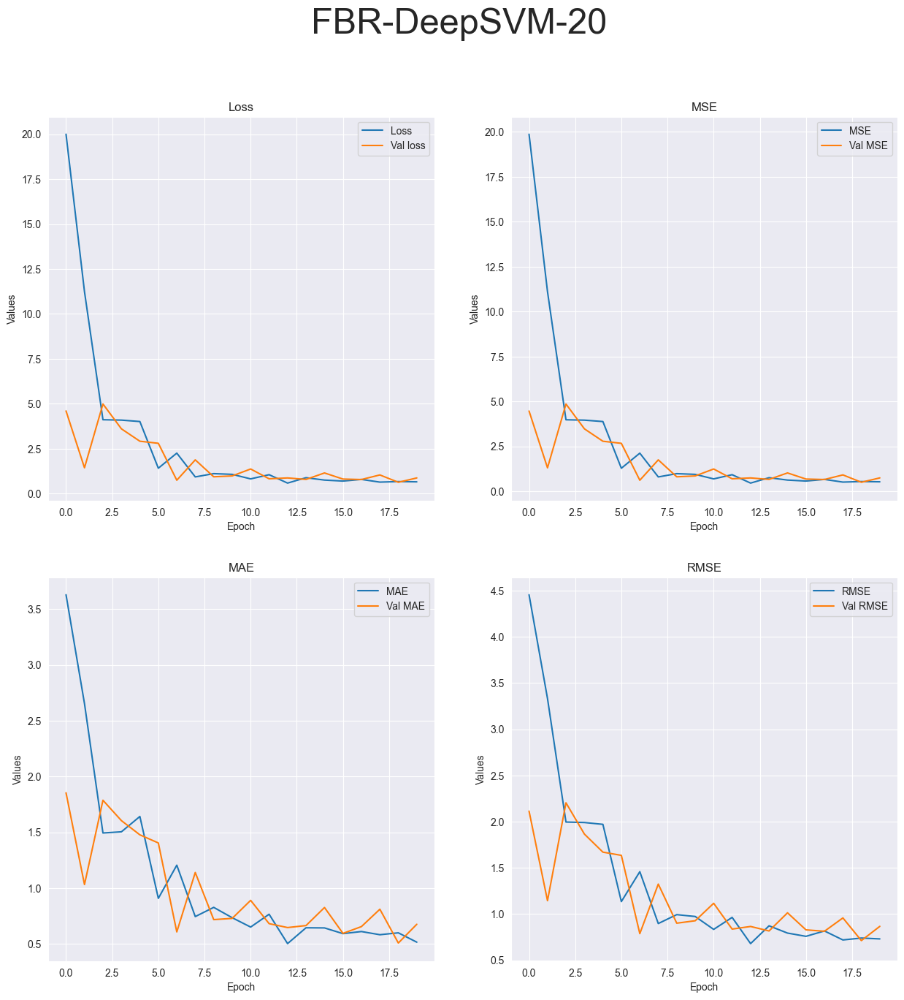

R-squared value: -0.0875


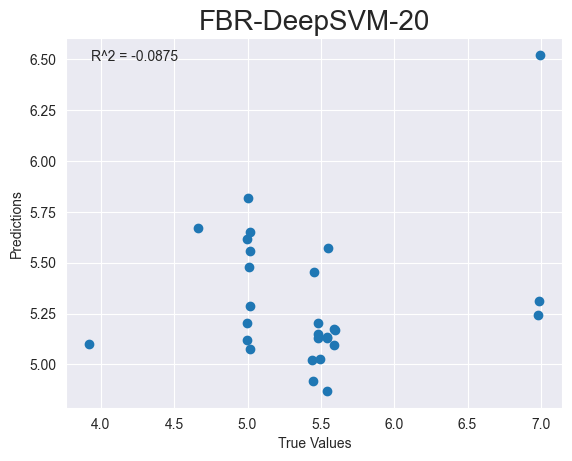

Running tests on CBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_125"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_368 (Dense)           (None, 64)                256       
                                                                 
 dropout_82 (Dropout)        (None, 64)                0         
                                                                 
 dense_369 (Dense)           (None, 32)                2080      
                                                                 
 dropout_83 (Dropout)        (None, 32)                0         
                                                                 
 dense_370 (Dense)           (None, 1)                 33

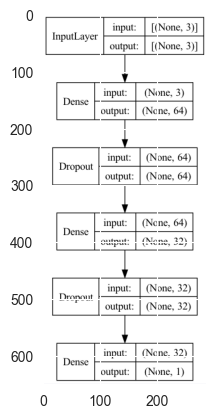

CBR-MLP-1


2023-05-02 10:15:06.623183: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 337ms/step - loss: 126.6481 - mse: 126.6481 - mae: 8.9681 - root_mean_squared_error: 11.2538 - val_loss: 0.5738 - val_mse: 0.5738 - val_mae: 0.6720 - val_root_mean_squared_error: 0.7575


2023-05-02 10:15:07.616565: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 100ms/step - loss: 0.6915 - mse: 0.6915 - mae: 0.6921 - root_mean_squared_error: 0.8316
Test loss: [0.6914793252944946, 0.6914793252944946, 0.6920588612556458, 0.8315523862838745]
['loss', 'mse', 'mae', 'root_mean_squared_error']


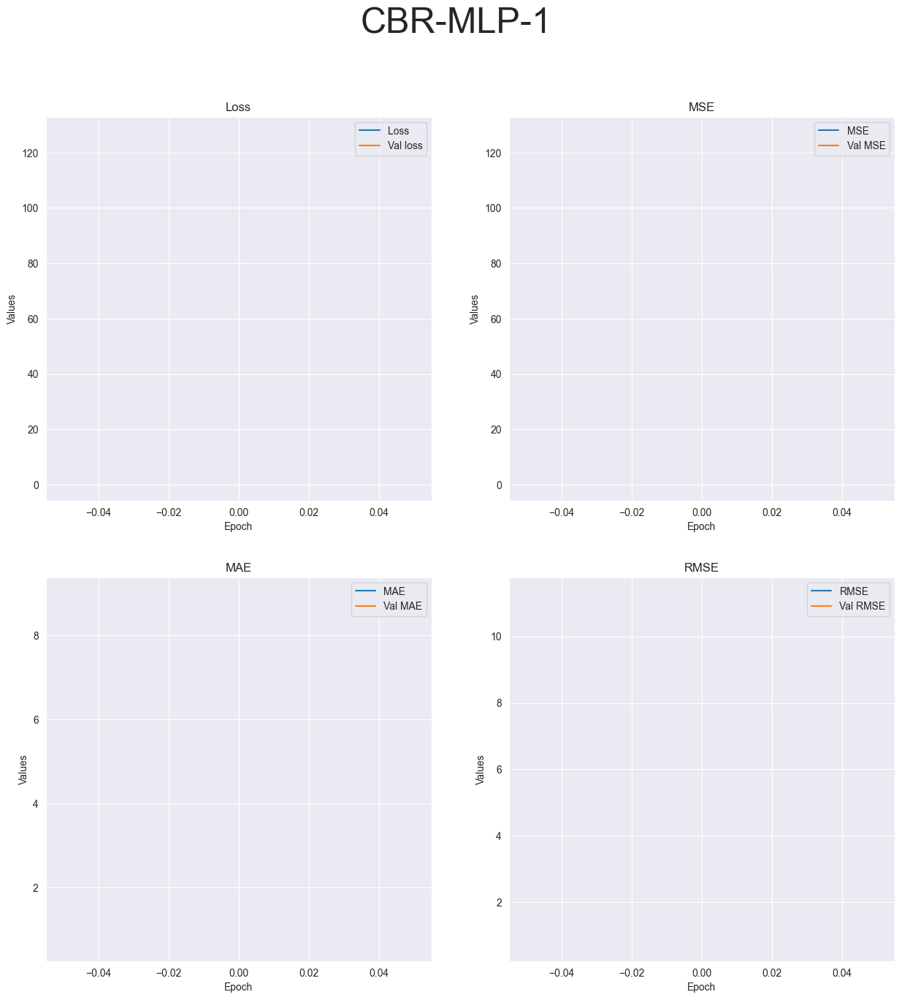

R-squared value: -0.4649


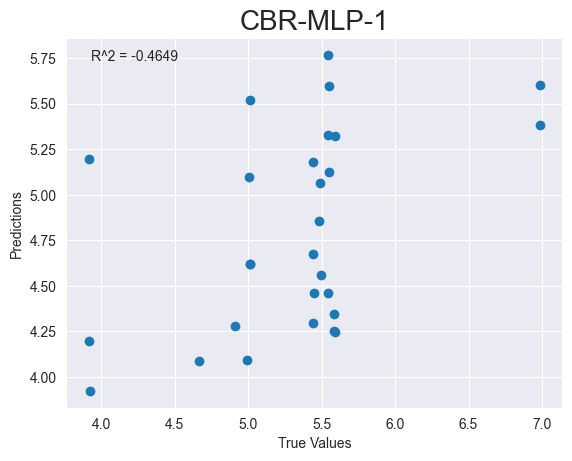

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_126"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_371 (Dense)           (None, 64)                256       
                                                                 
 dropout_84 (Dropout)        (None, 64)                0         
                                                                 
 dense_372 (Dense)           (None, 32)                2080      
                                                                 
 dropout_85 (Dropout)        (None, 32)                0         
                                                                 
 dense_373 (Dense)           (None, 1)                 33        
                                                      

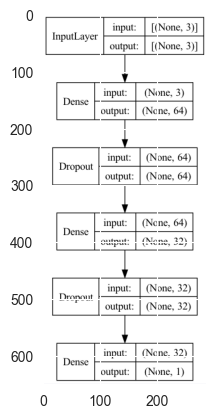

CBR-MLP-4
Epoch 1/4


2023-05-02 10:15:09.831893: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 313ms/step - loss: 101.2844 - mse: 101.2844 - mae: 8.3735 - root_mean_squared_error: 10.0640 - val_loss: 6.5552 - val_mse: 6.5552 - val_mae: 2.3554 - val_root_mean_squared_error: 2.5603
Epoch 2/4


2023-05-02 10:15:11.163028: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 87ms/step - loss: 25.4389 - mse: 25.4389 - mae: 3.9139 - root_mean_squared_error: 5.0437 - val_loss: 4.0227 - val_mse: 4.0227 - val_mae: 1.9102 - val_root_mean_squared_error: 2.0057
Epoch 3/4
3/3 [==============================] - 0s 65ms/step - loss: 13.6987 - mse: 13.6987 - mae: 2.9021 - root_mean_squared_error: 3.7012 - val_loss: 0.6364 - val_mse: 0.6364 - val_mae: 0.6263 - val_root_mean_squared_error: 0.7978
Epoch 4/4
1/1 [==============================] - 0s 80ms/step - loss: 12.1008 - mse: 12.1008 - mae: 1.3482 - root_mean_squared_error: 3.4786
Test loss: [12.10079288482666, 12.10079288482666, 1.3482025861740112, 3.478619337081909]
['loss', 'mse', 'mae', 'root_mean_squared_error']


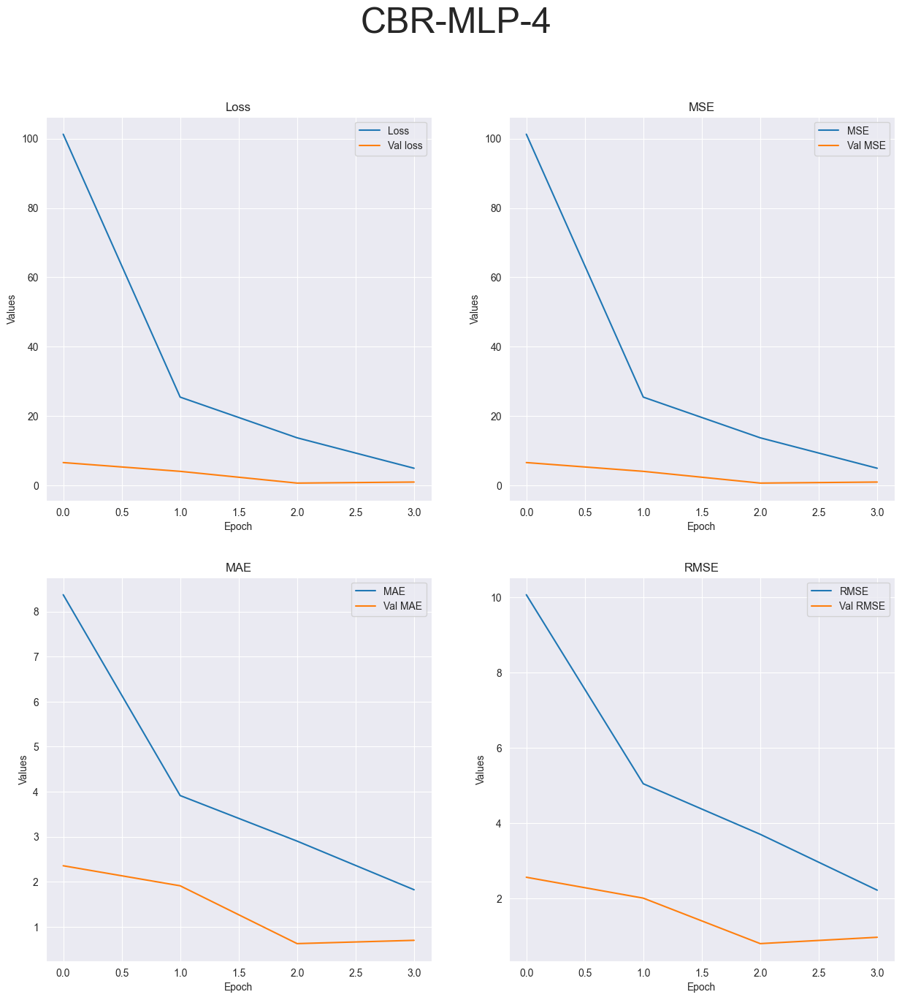

R-squared value: -18.4792


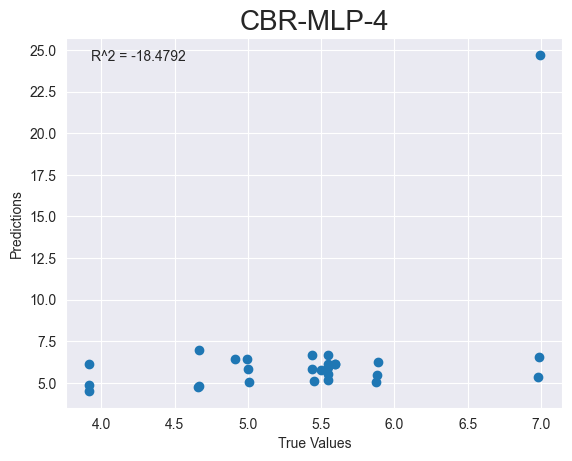

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_127"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_374 (Dense)           (None, 64)                256       
                                                                 
 dropout_86 (Dropout)        (None, 64)                0         
                                                                 
 dense_375 (Dense)           (None, 32)                2080      
                                                                 
 dropout_87 (Dropout)        (None, 32)                0         
                                                                 
 dense_376 (Dense)           (None, 1)                 33        
                                                     

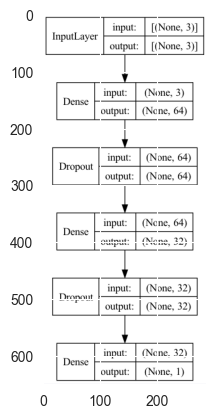

CBR-MLP-10
Epoch 1/10


2023-05-02 10:15:13.105617: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 304ms/step - loss: 84.7448 - mse: 84.7448 - mae: 7.2300 - root_mean_squared_error: 9.2057 - val_loss: 4.4000 - val_mse: 4.4000 - val_mae: 1.9315 - val_root_mean_squared_error: 2.0976
Epoch 2/10


2023-05-02 10:15:14.085403: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 52ms/step - loss: 26.3299 - mse: 26.3299 - mae: 3.9629 - root_mean_squared_error: 5.1313 - val_loss: 0.9299 - val_mse: 0.9299 - val_mae: 0.7091 - val_root_mean_squared_error: 0.9643
Epoch 3/10
3/3 [==============================] - 0s 52ms/step - loss: 6.8510 - mse: 6.8510 - mae: 2.1095 - root_mean_squared_error: 2.6174 - val_loss: 0.7861 - val_mse: 0.7861 - val_mae: 0.6525 - val_root_mean_squared_error: 0.8866
Epoch 4/10
3/3 [==============================] - 0s 48ms/step - loss: 3.8183 - mse: 3.8183 - mae: 1.5890 - root_mean_squared_error: 1.9540 - val_loss: 3.2285 - val_mse: 3.2285 - val_mae: 1.6251 - val_root_mean_squared_error: 1.7968
Epoch 5/10
3/3 [==============================] - 0s 26ms/step - loss: 2.6794 - mse: 2.6794 - mae: 1.3155 - root_mean_squared_error: 1.6369 - val_loss: 4.2106 - val_mse: 4.2106 - val_mae: 1.8852 - val_root_mean_squared_error: 2.0520
Epoch 6/10
3/3 [==============================] - 0s 35ms/step - loss: 2.0913

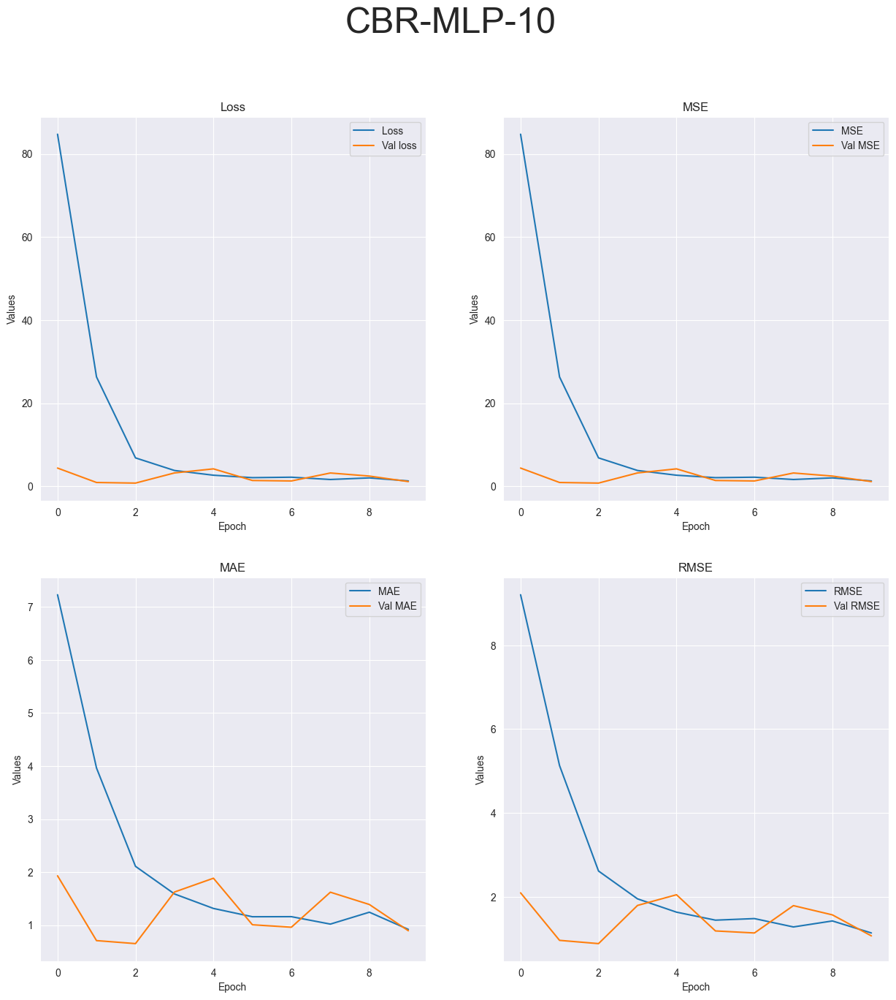

R-squared value: -15.2369


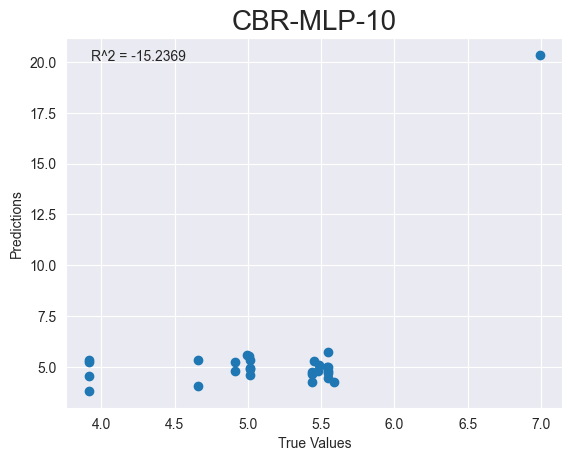

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_128"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_377 (Dense)           (None, 64)                256       
                                                                 
 dropout_88 (Dropout)        (None, 64)                0         
                                                                 
 dense_378 (Dense)           (None, 32)                2080      
                                                                 
 dropout_89 (Dropout)        (None, 32)                0         
                                                                 
 dense_379 (Dense)           (None, 1)                 33        
                                                     

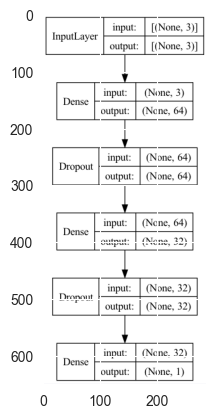

CBR-MLP-20
Epoch 1/20


2023-05-02 10:15:16.399957: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 292ms/step - loss: 81.7751 - mse: 81.7751 - mae: 7.3970 - root_mean_squared_error: 9.0430 - val_loss: 0.3627 - val_mse: 0.3627 - val_mae: 0.5039 - val_root_mean_squared_error: 0.6023
Epoch 2/20


2023-05-02 10:15:17.397946: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 70ms/step - loss: 27.2962 - mse: 27.2962 - mae: 4.0246 - root_mean_squared_error: 5.2246 - val_loss: 0.5659 - val_mse: 0.5659 - val_mae: 0.6608 - val_root_mean_squared_error: 0.7523
Epoch 3/20
3/3 [==============================] - 0s 27ms/step - loss: 9.4102 - mse: 9.4102 - mae: 2.3717 - root_mean_squared_error: 3.0676 - val_loss: 1.2529 - val_mse: 1.2529 - val_mae: 0.9030 - val_root_mean_squared_error: 1.1193
Epoch 4/20
3/3 [==============================] - 0s 50ms/step - loss: 4.7046 - mse: 4.7046 - mae: 1.7061 - root_mean_squared_error: 2.1690 - val_loss: 0.6125 - val_mse: 0.6125 - val_mae: 0.6889 - val_root_mean_squared_error: 0.7826
Epoch 5/20
3/3 [==============================] - 0s 26ms/step - loss: 3.5561 - mse: 3.5561 - mae: 1.4834 - root_mean_squared_error: 1.8858 - val_loss: 3.6169 - val_mse: 3.6169 - val_mae: 1.8168 - val_root_mean_squared_error: 1.9018
Epoch 6/20
3/3 [==============================] - 0s 26ms/step - loss: 3.0170

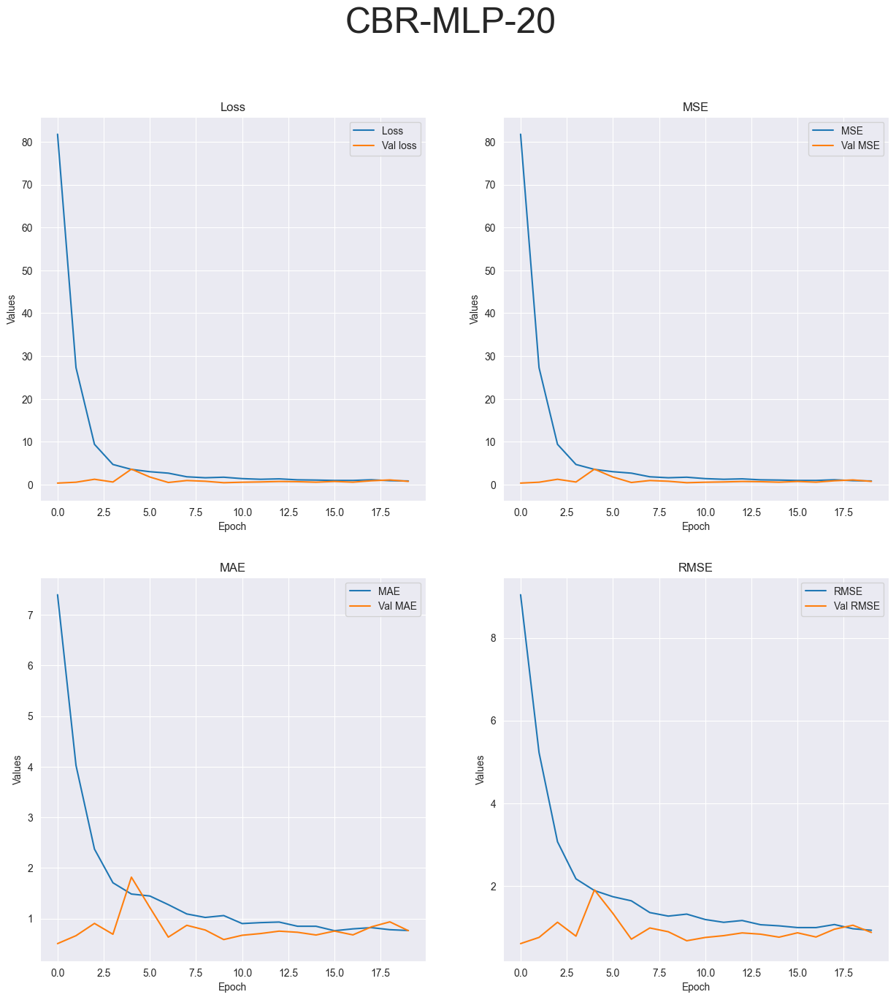

R-squared value: -8.5218


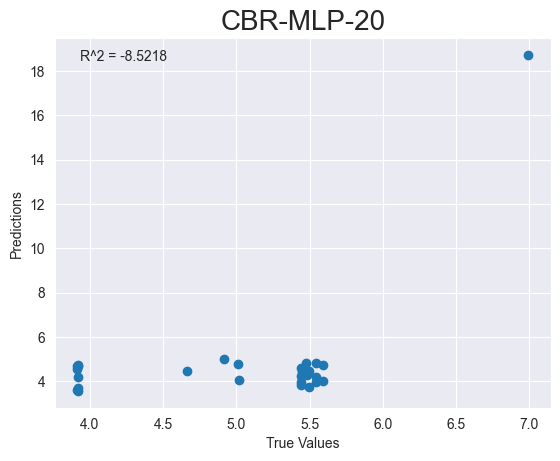

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_129"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_380 (Dense)           (None, 64)                256       
                                                                 
 dense_381 (Dense)           (None, 32)                2080      
                                                                 
 dense_382 (Dense)           (None, 16)                528       
                                                                 
 dense_383 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
________________________

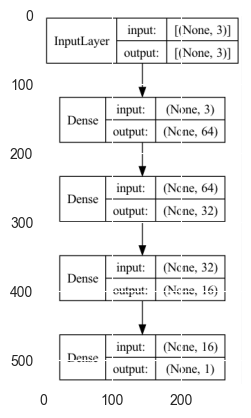

CBR-FCNN-1


2023-05-02 10:15:20.213180: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 242ms/step - loss: 165.5068 - mse: 165.5068 - mae: 10.2151 - root_mean_squared_error: 12.8649 - val_loss: 63.2382 - val_mse: 63.2382 - val_mae: 7.9327 - val_root_mean_squared_error: 7.9522


2023-05-02 10:15:21.015657: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 105ms/step - loss: 59.4678 - mse: 59.4678 - mae: 7.6558 - root_mean_squared_error: 7.7115
Test loss: [59.46782684326172, 59.46782684326172, 7.655766010284424, 7.711538314819336]
['loss', 'mse', 'mae', 'root_mean_squared_error']


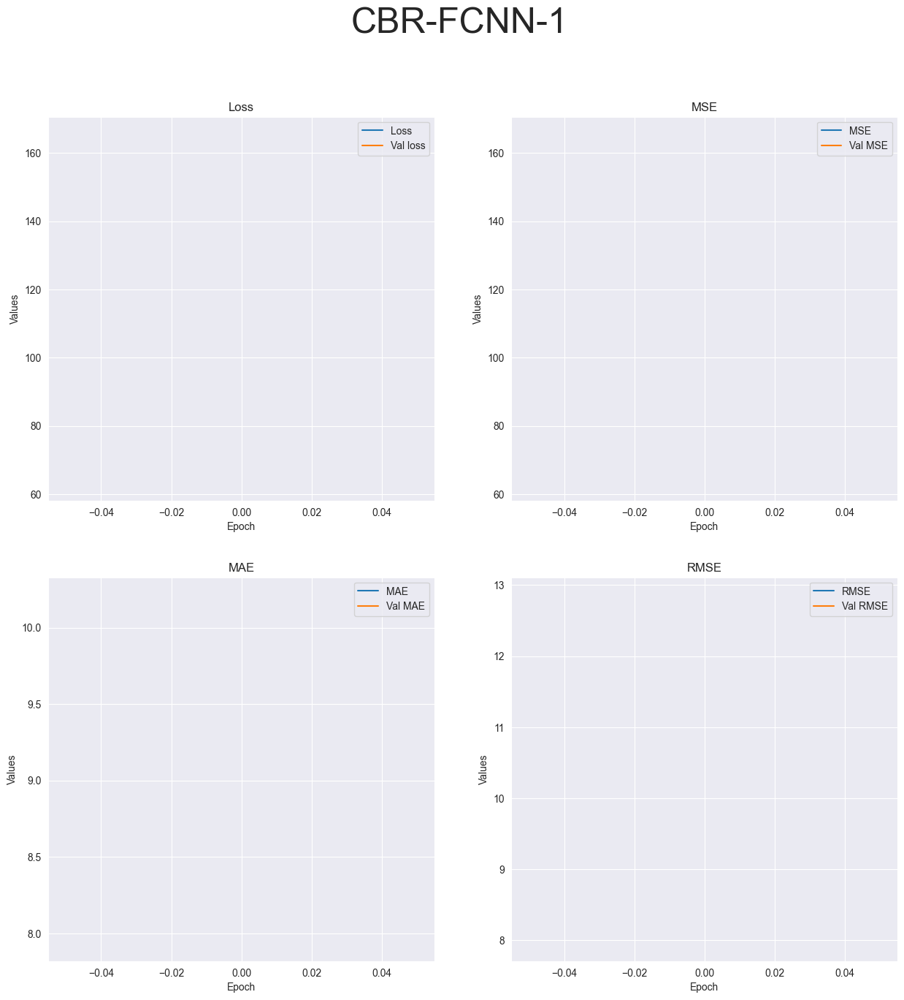

R-squared value: -101.0737


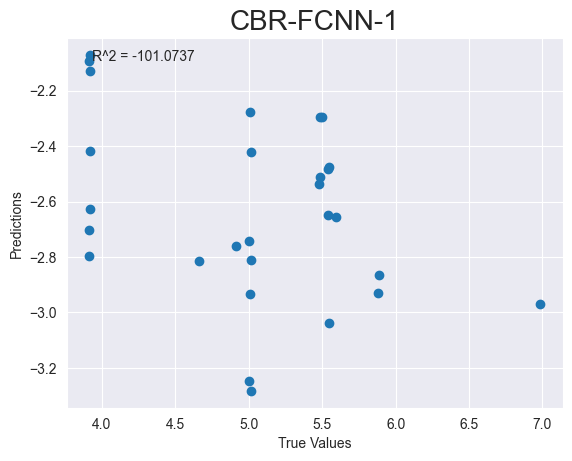

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_130"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_384 (Dense)           (None, 64)                256       
                                                                 
 dense_385 (Dense)           (None, 32)                2080      
                                                                 
 dense_386 (Dense)           (None, 16)                528       
                                                                 
 dense_387 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
____________________________________________________

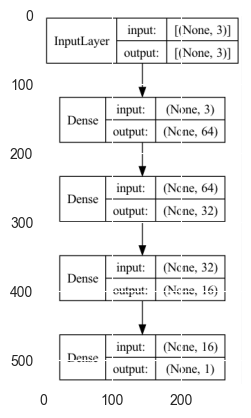

CBR-FCNN-4
Epoch 1/4


2023-05-02 10:15:23.319465: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 259ms/step - loss: 147.7229 - mse: 147.7229 - mae: 9.8476 - root_mean_squared_error: 12.1541 - val_loss: 33.8551 - val_mse: 33.8551 - val_mae: 5.7627 - val_root_mean_squared_error: 5.8185
Epoch 2/4


2023-05-02 10:15:24.288229: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 77ms/step - loss: 79.6035 - mse: 79.6035 - mae: 8.3617 - root_mean_squared_error: 8.9221 - val_loss: 36.6885 - val_mse: 36.6885 - val_mae: 6.0018 - val_root_mean_squared_error: 6.0571
Epoch 3/4
3/3 [==============================] - 0s 44ms/step - loss: 14.6505 - mse: 14.6505 - mae: 3.0607 - root_mean_squared_error: 3.8276 - val_loss: 10.0959 - val_mse: 10.0959 - val_mae: 3.0361 - val_root_mean_squared_error: 3.1774
Epoch 4/4
1/1 [==============================] - 0s 94ms/step - loss: 5.2734 - mse: 5.2734 - mae: 2.1533 - root_mean_squared_error: 2.2964
Test loss: [5.273404598236084, 5.273404598236084, 2.1533331871032715, 2.296389579772949]
['loss', 'mse', 'mae', 'root_mean_squared_error']


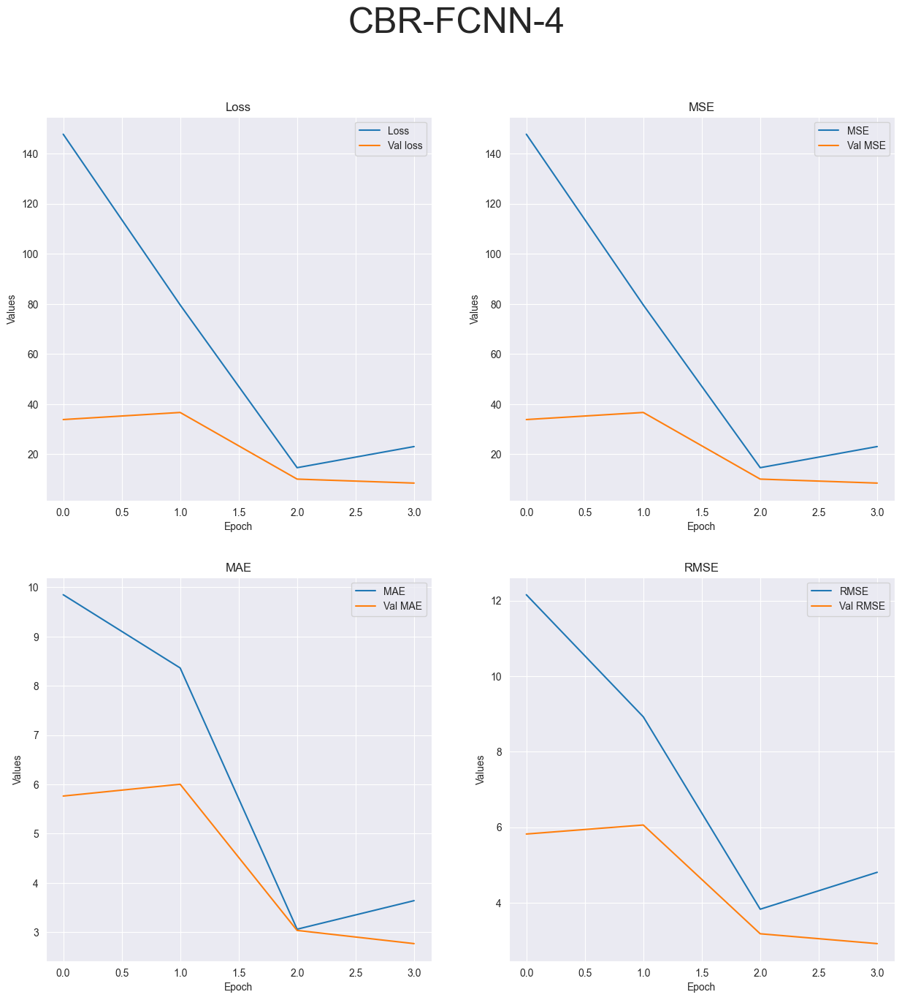

R-squared value: -23.8754


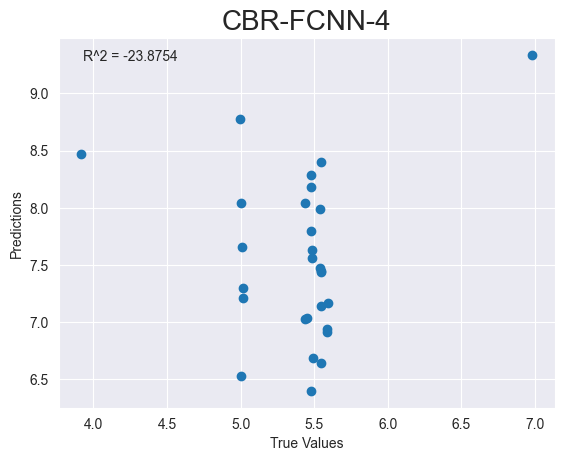

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_131"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_388 (Dense)           (None, 64)                256       
                                                                 
 dense_389 (Dense)           (None, 32)                2080      
                                                                 
 dense_390 (Dense)           (None, 16)                528       
                                                                 
 dense_391 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
___________________________________________________

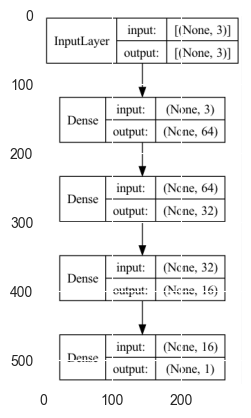

CBR-FCNN-10
Epoch 1/10


2023-05-02 10:15:26.235663: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 253ms/step - loss: 249.4460 - mse: 249.4460 - mae: 10.4944 - root_mean_squared_error: 15.7939 - val_loss: 44.9696 - val_mse: 44.9696 - val_mae: 6.6666 - val_root_mean_squared_error: 6.7059
Epoch 2/10


2023-05-02 10:15:27.152436: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 86ms/step - loss: 123.8067 - mse: 123.8067 - mae: 10.4240 - root_mean_squared_error: 11.1268 - val_loss: 81.7575 - val_mse: 81.7575 - val_mae: 8.9971 - val_root_mean_squared_error: 9.0420
Epoch 3/10
3/3 [==============================] - 0s 44ms/step - loss: 47.6422 - mse: 47.6422 - mae: 5.9843 - root_mean_squared_error: 6.9023 - val_loss: 1.6170 - val_mse: 1.6170 - val_mae: 1.0223 - val_root_mean_squared_error: 1.2716
Epoch 4/10
3/3 [==============================] - 0s 19ms/step - loss: 15.1329 - mse: 15.1329 - mae: 2.3042 - root_mean_squared_error: 3.8901 - val_loss: 12.6308 - val_mse: 12.6308 - val_mae: 3.3917 - val_root_mean_squared_error: 3.5540
Epoch 5/10
3/3 [==============================] - 0s 42ms/step - loss: 17.5145 - mse: 17.5145 - mae: 2.9789 - root_mean_squared_error: 4.1850 - val_loss: 3.7920 - val_mse: 3.7920 - val_mae: 1.7236 - val_root_mean_squared_error: 1.9473
Epoch 6/10
3/3 [==============================] - 0s 22ms/step 

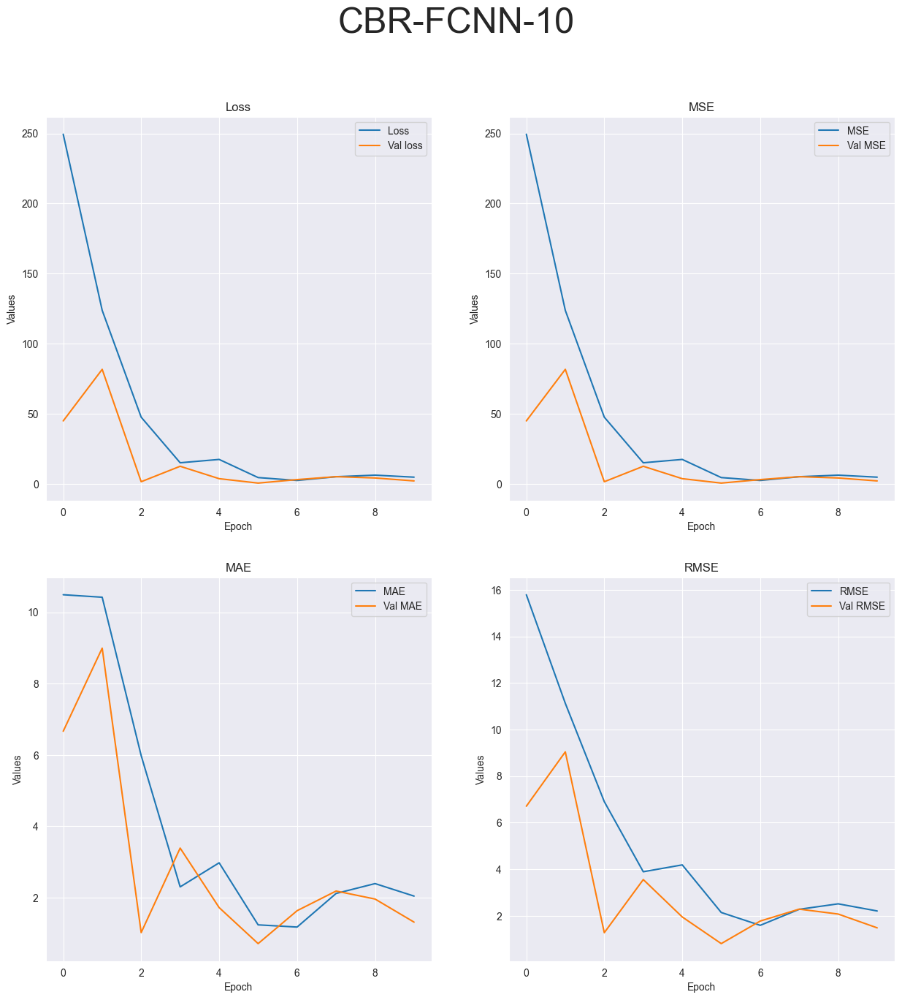

R-squared value: -7.0417


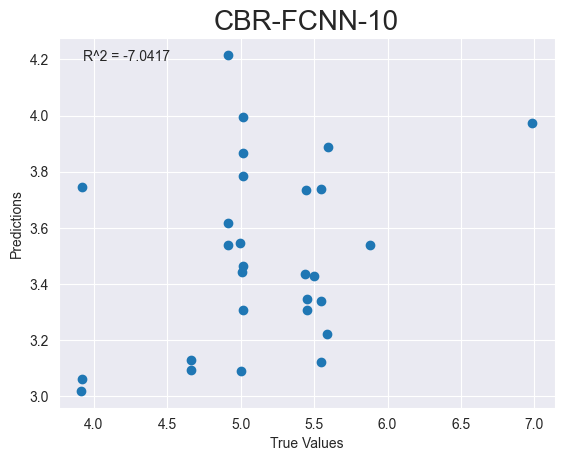

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_132"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_392 (Dense)           (None, 64)                256       
                                                                 
 dense_393 (Dense)           (None, 32)                2080      
                                                                 
 dense_394 (Dense)           (None, 16)                528       
                                                                 
 dense_395 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
___________________________________________________

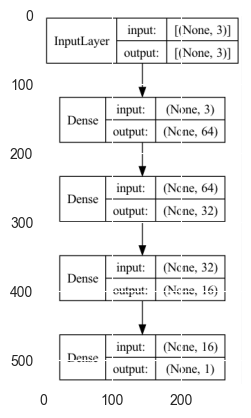

CBR-FCNN-20
Epoch 1/20


2023-05-02 10:15:29.340626: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 231ms/step - loss: 149.7744 - mse: 149.7744 - mae: 9.9618 - root_mean_squared_error: 12.2382 - val_loss: 29.5000 - val_mse: 29.5000 - val_mae: 5.3928 - val_root_mean_squared_error: 5.4314
Epoch 2/20


2023-05-02 10:15:30.208081: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 68ms/step - loss: 68.8996 - mse: 68.8996 - mae: 8.0486 - root_mean_squared_error: 8.3006 - val_loss: 41.3070 - val_mse: 41.3070 - val_mae: 6.3929 - val_root_mean_squared_error: 6.4271
Epoch 3/20
3/3 [==============================] - 0s 51ms/step - loss: 19.6761 - mse: 19.6761 - mae: 3.5804 - root_mean_squared_error: 4.4358 - val_loss: 5.8723 - val_mse: 5.8723 - val_mae: 2.2722 - val_root_mean_squared_error: 2.4233
Epoch 4/20
3/3 [==============================] - 0s 33ms/step - loss: 20.6946 - mse: 20.6946 - mae: 3.3122 - root_mean_squared_error: 4.5491 - val_loss: 4.3520 - val_mse: 4.3520 - val_mae: 1.9292 - val_root_mean_squared_error: 2.0862
Epoch 5/20
3/3 [==============================] - 0s 33ms/step - loss: 10.7263 - mse: 10.7263 - mae: 1.7059 - root_mean_squared_error: 3.2751 - val_loss: 2.1537 - val_mse: 2.1537 - val_mae: 1.3029 - val_root_mean_squared_error: 1.4675
Epoch 6/20
3/3 [==============================] - 0s 25ms/step - loss

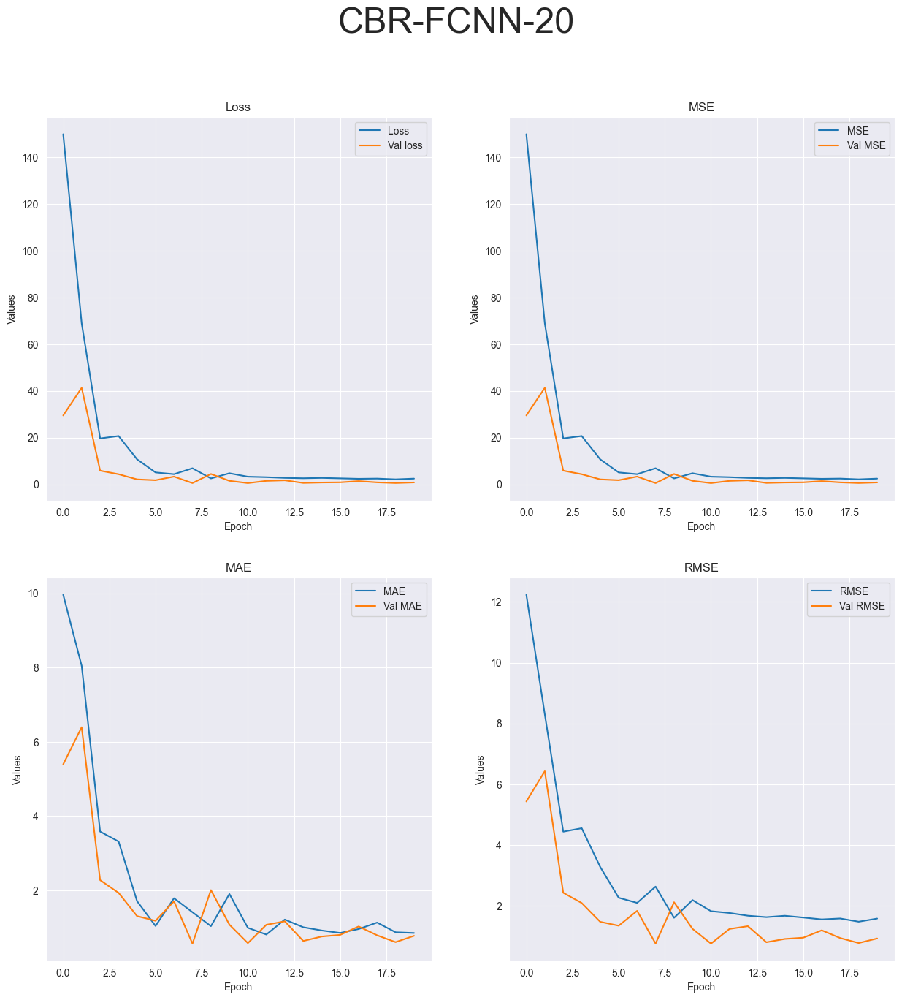

R-squared value: -0.8402


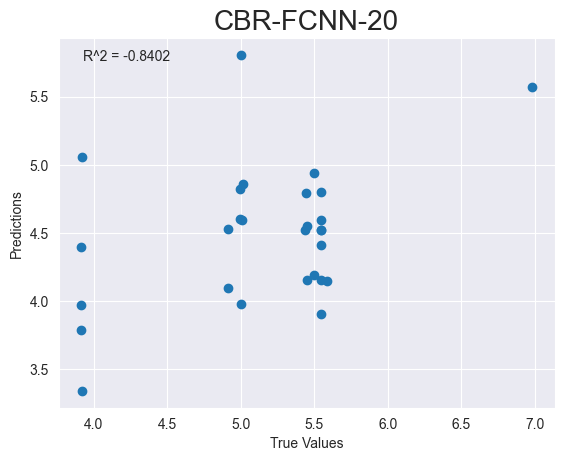

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_133"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_396 (Dense)           (None, 128)               512       
                                                                 
 dense_397 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


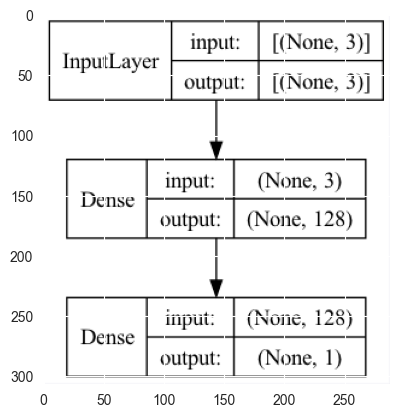

CBR-DeepSVM-1


2023-05-02 10:15:33.033163: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 227ms/step - loss: 3884.7043 - mse: 3884.6489 - mae: 55.6956 - root_mean_squared_error: 62.3270 - val_loss: 29.9943 - val_mse: 29.9405 - val_mae: 4.3511 - val_root_mean_squared_error: 5.4718


2023-05-02 10:15:33.782557: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 74ms/step - loss: 23.6924 - mse: 23.6386 - mae: 4.2725 - root_mean_squared_error: 4.8620
Test loss: [23.69243049621582, 23.63859748840332, 4.272491455078125, 4.861954212188721]
['loss', 'mse', 'mae', 'root_mean_squared_error']


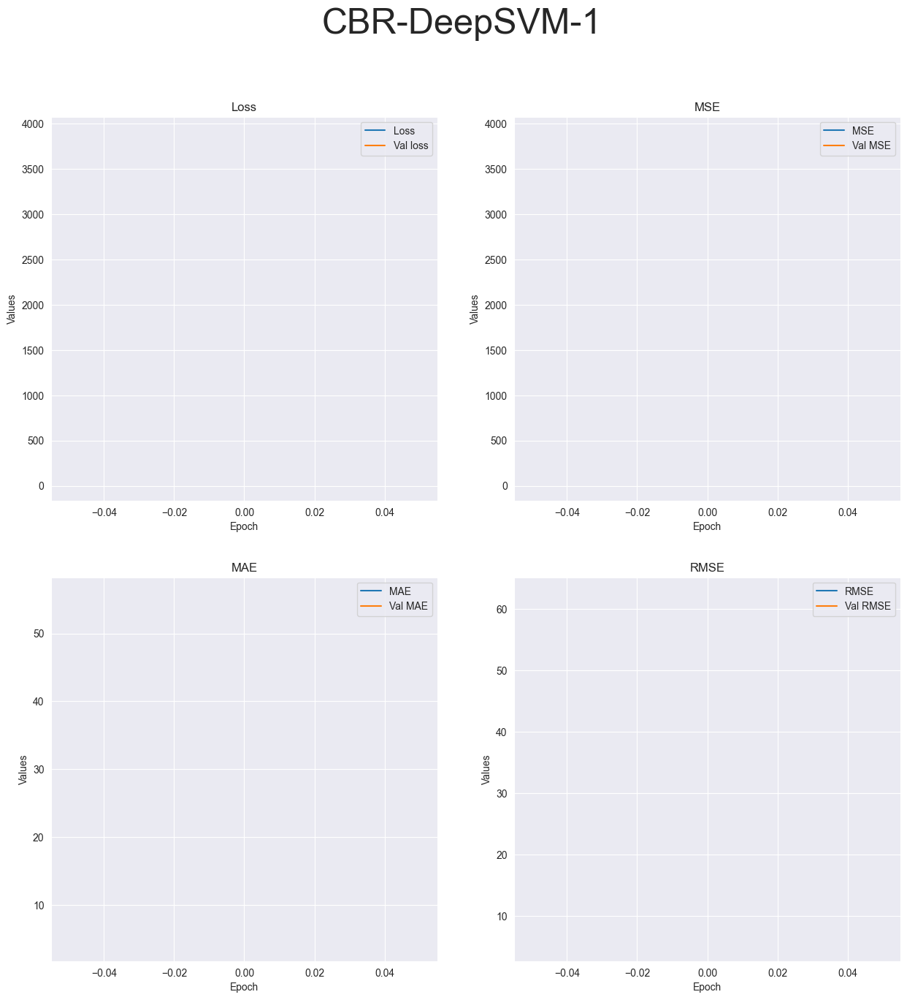

R-squared value: -53.1137


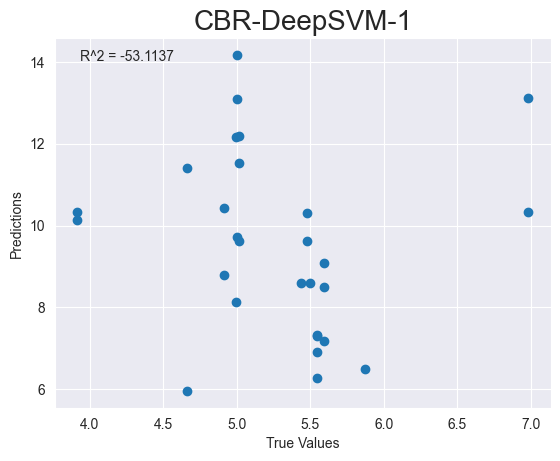

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_134"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_398 (Dense)           (None, 128)               512       
                                                                 
 dense_399 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


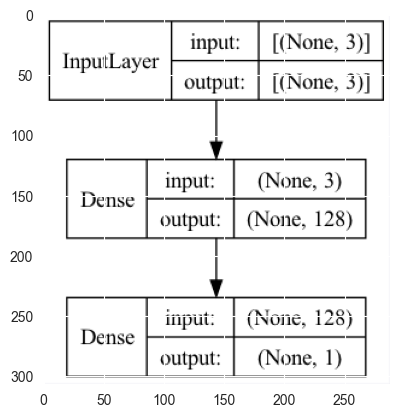

CBR-DeepSVM-4
Epoch 1/4


2023-05-02 10:15:36.005213: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 250ms/step - loss: 4757.4282 - mse: 4757.3730 - mae: 58.0742 - root_mean_squared_error: 68.9737 - val_loss: 62.2536 - val_mse: 62.1996 - val_mae: 7.3037 - val_root_mean_squared_error: 7.8867
Epoch 2/4


2023-05-02 10:15:37.184928: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 57ms/step - loss: 218.3471 - mse: 218.2928 - mae: 12.9186 - root_mean_squared_error: 14.7747 - val_loss: 909.4910 - val_mse: 909.4363 - val_mae: 30.0902 - val_root_mean_squared_error: 30.1569
Epoch 3/4
3/3 [==============================] - 0s 49ms/step - loss: 1250.6490 - mse: 1250.5946 - mae: 33.1632 - root_mean_squared_error: 35.3637 - val_loss: 798.0588 - val_mse: 798.0056 - val_mae: 28.1871 - val_root_mean_squared_error: 28.2490
Epoch 4/4
1/1 [==============================] - 0s 69ms/step - loss: 97.5919 - mse: 97.5408 - mae: 9.8014 - root_mean_squared_error: 9.8763
Test loss: [97.5919189453125, 97.54084777832031, 9.801376342773438, 9.876276969909668]
['loss', 'mse', 'mae', 'root_mean_squared_error']


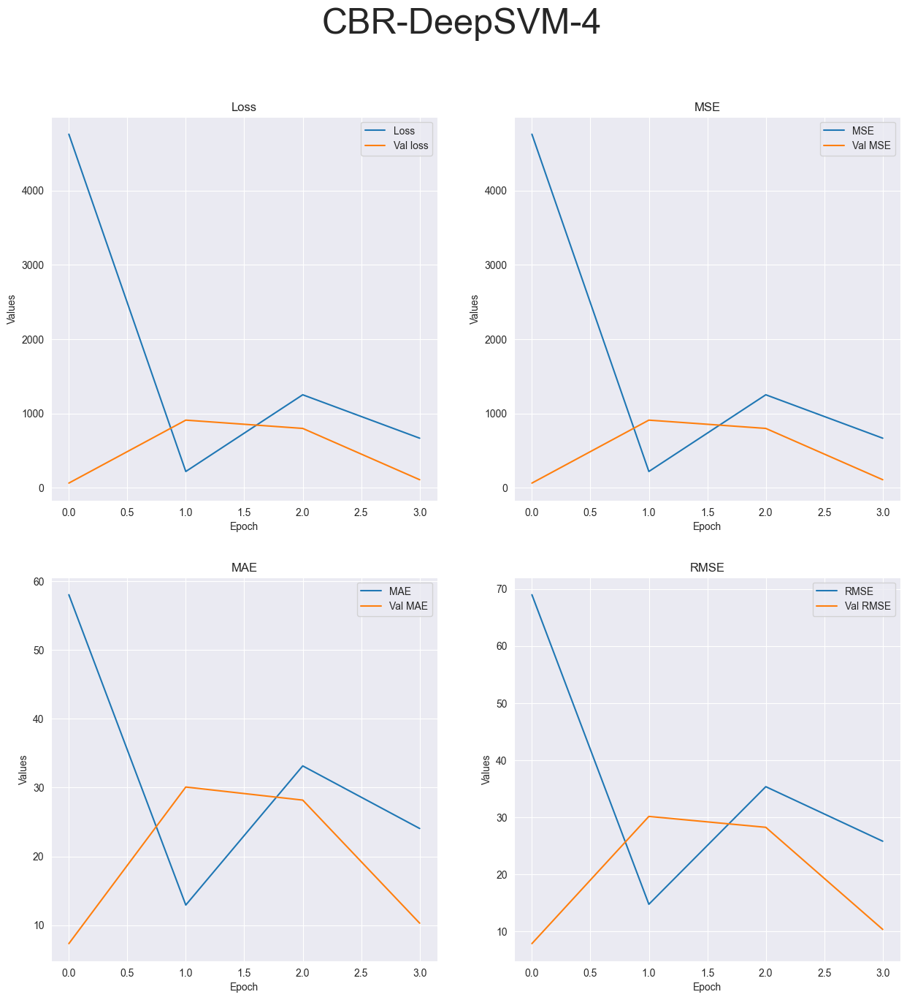

R-squared value: -170.4916


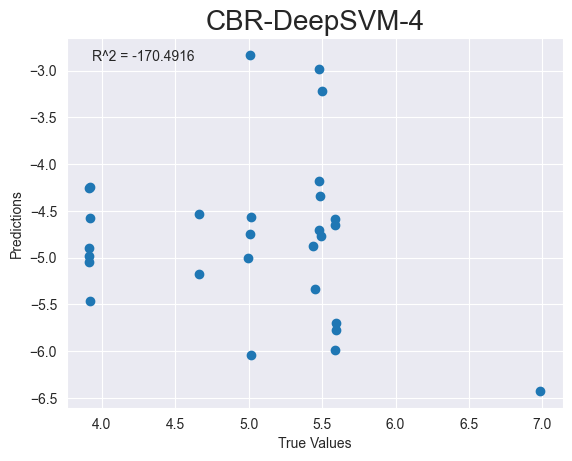

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_135"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_400 (Dense)           (None, 128)               512       
                                                                 
 dense_401 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


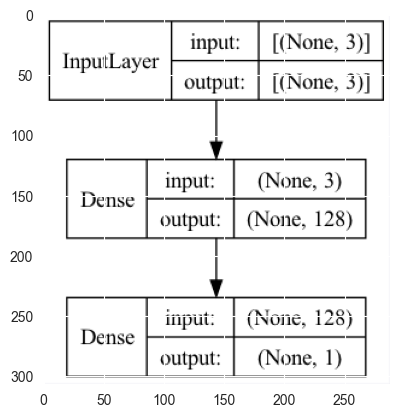

CBR-DeepSVM-10
Epoch 1/10


2023-05-02 10:15:38.984528: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 241ms/step - loss: 3472.2075 - mse: 3472.1516 - mae: 54.6162 - root_mean_squared_error: 58.9250 - val_loss: 44.4575 - val_mse: 44.4035 - val_mae: 5.5932 - val_root_mean_squared_error: 6.6636


2023-05-02 10:15:39.713848: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 2/10
3/3 [==============================] - 0s 52ms/step - loss: 278.5905 - mse: 278.5362 - mae: 13.8085 - root_mean_squared_error: 16.6894 - val_loss: 1908.7225 - val_mse: 1908.6678 - val_mae: 37.2730 - val_root_mean_squared_error: 43.6883
Epoch 3/10
3/3 [==============================] - 0s 31ms/step - loss: 1091.2365 - mse: 1091.1824 - mae: 32.9248 - root_mean_squared_error: 33.0331 - val_loss: 1171.3112 - val_mse: 1171.2584 - val_mae: 29.3112 - val_root_mean_squared_error: 34.2237
Epoch 4/10
3/3 [==============================] - 0s 25ms/step - loss: 429.3842 - mse: 429.3321 - mae: 19.9640 - root_mean_squared_error: 20.7203 - val_loss: 48.9994 - val_mse: 48.9486 - val_mae: 6.0911 - val_root_mean_squared_error: 6.9963
Epoch 5/10
3/3 [==============================] - 0s 33ms/step - loss: 25.2302 - mse: 25.1798 - mae: 4.2736 - root_mean_squared_error: 5.0179 - val_loss: 227.2653 - val_mse: 227.2153 - val_mae: 12.4605 - val_root_mean_squared_error: 15.0737
Epoch 6/10
3/3 [======

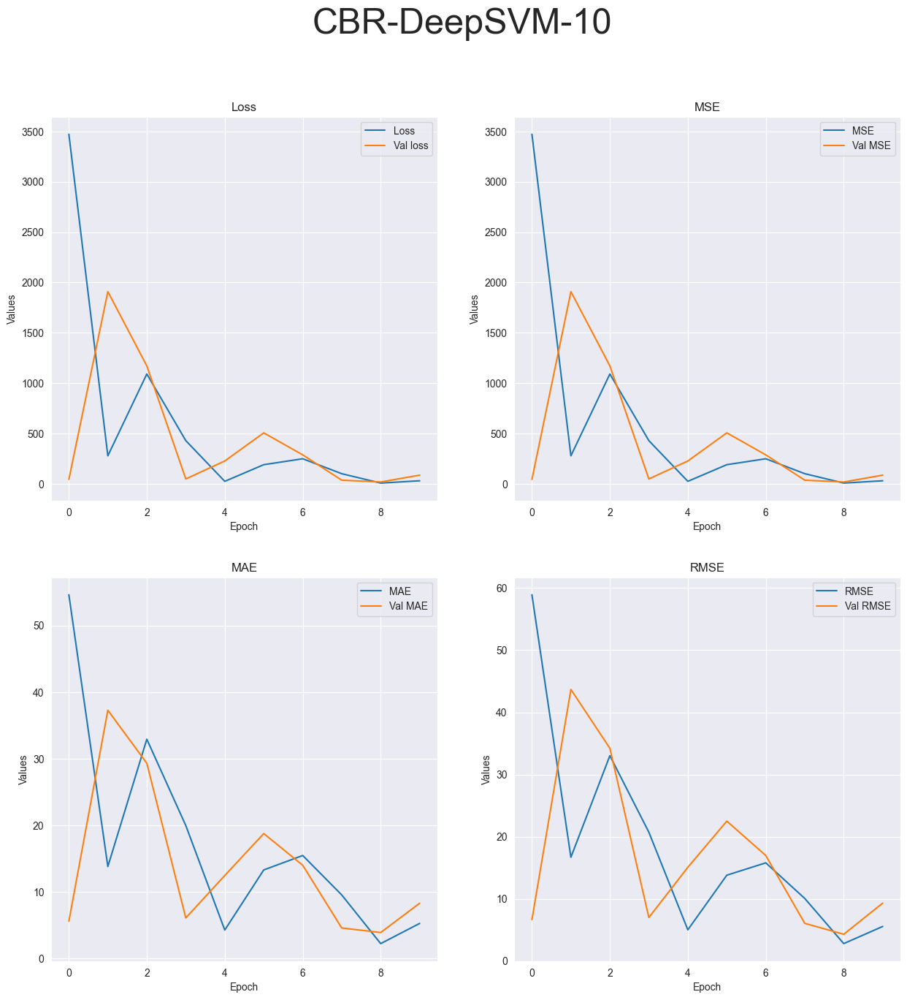

R-squared value: -108.5671


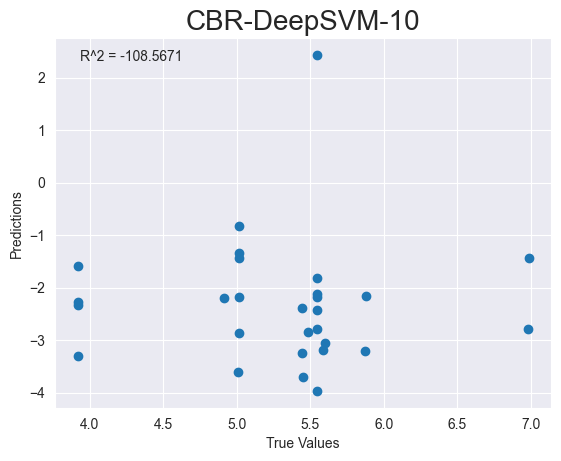

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_136"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_402 (Dense)           (None, 128)               512       
                                                                 
 dense_403 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


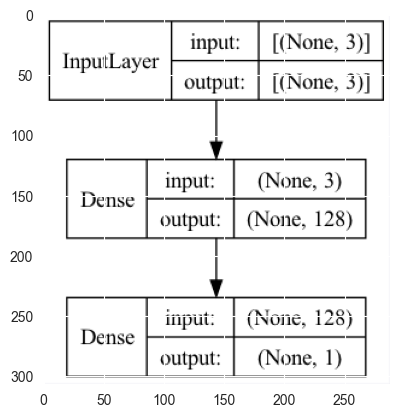

CBR-DeepSVM-20
Epoch 1/20


2023-05-02 10:15:41.958807: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 252ms/step - loss: 3998.0186 - mse: 3997.9631 - mae: 56.3959 - root_mean_squared_error: 63.2295 - val_loss: 19.7188 - val_mse: 19.6650 - val_mae: 3.7105 - val_root_mean_squared_error: 4.4345
Epoch 2/20


2023-05-02 10:15:42.756426: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 61ms/step - loss: 327.9505 - mse: 327.8964 - mae: 14.8338 - root_mean_squared_error: 18.1079 - val_loss: 1024.2471 - val_mse: 1024.1927 - val_mae: 31.9045 - val_root_mean_squared_error: 32.0030
Epoch 3/20
3/3 [==============================] - 0s 30ms/step - loss: 1322.6562 - mse: 1322.6023 - mae: 34.4856 - root_mean_squared_error: 36.3676 - val_loss: 695.7592 - val_mse: 695.7065 - val_mae: 26.2968 - val_root_mean_squared_error: 26.3762
Epoch 4/20
3/3 [==============================] - 0s 43ms/step - loss: 487.3185 - mse: 487.2665 - mae: 21.1159 - root_mean_squared_error: 22.0741 - val_loss: 36.6997 - val_mse: 36.6489 - val_mae: 5.8832 - val_root_mean_squared_error: 6.0538
Epoch 5/20
3/3 [==============================] - 0s 23ms/step - loss: 36.3566 - mse: 36.3060 - mae: 4.9552 - root_mean_squared_error: 6.0255 - val_loss: 137.6275 - val_mse: 137.5774 - val_mae: 11.4052 - val_root_mean_squared_error: 11.7293
Epoch 6/20
3/3 [===================

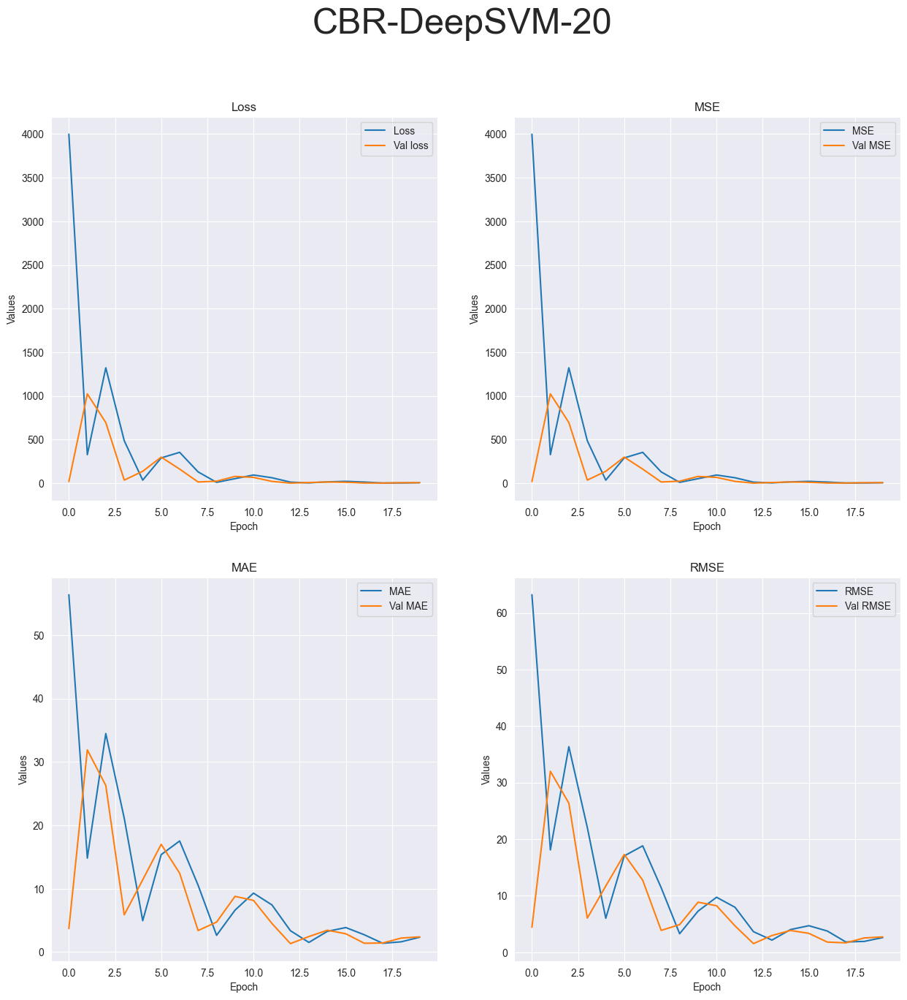

R-squared value: -16.4021


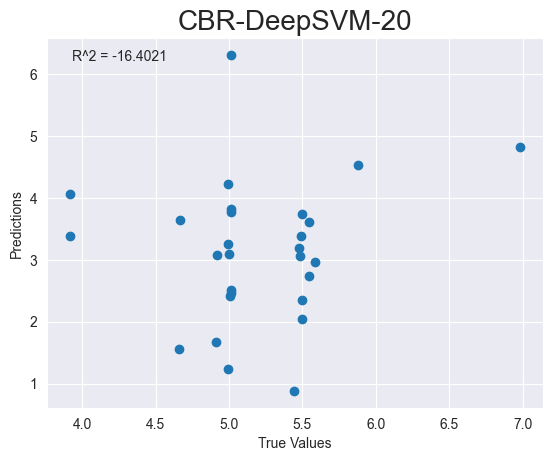

Running tests on ABR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_137"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_404 (Dense)           (None, 64)                832       
                                                                 
 dropout_90 (Dropout)        (None, 64)                0         
                            

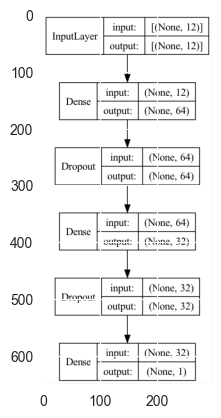

ABR-MLP-1


2023-05-02 10:15:45.558964: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 297ms/step - loss: 2203661.0000 - mse: 2203661.0000 - mae: 1118.9017 - root_mean_squared_error: 1484.4733 - val_loss: 49449.8203 - val_mse: 49449.8203 - val_mae: 216.5686 - val_root_mean_squared_error: 222.3732


2023-05-02 10:15:46.668792: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 133ms/step - loss: 61691.4805 - mse: 61691.4805 - mae: 238.2089 - root_mean_squared_error: 248.3777
Test loss: [61691.48046875, 61691.48046875, 238.2089385986328, 248.37770080566406]
['loss', 'mse', 'mae', 'root_mean_squared_error']


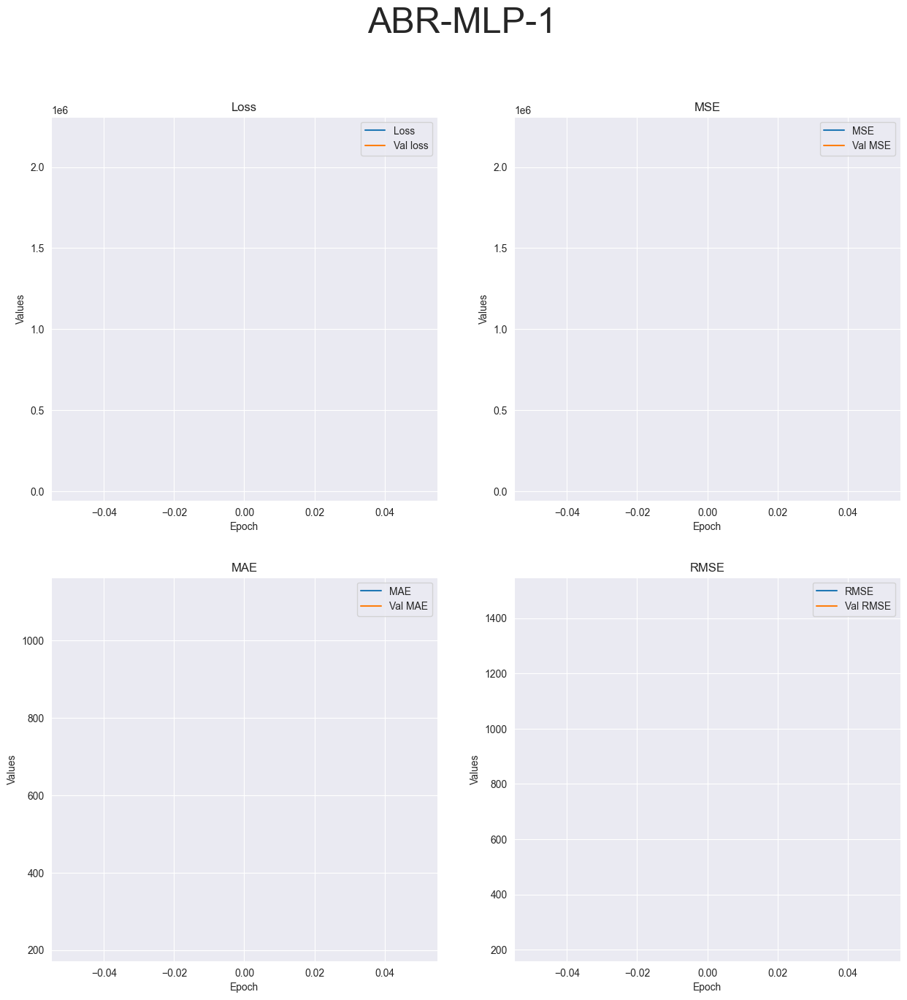

R-squared value: -114960.3807


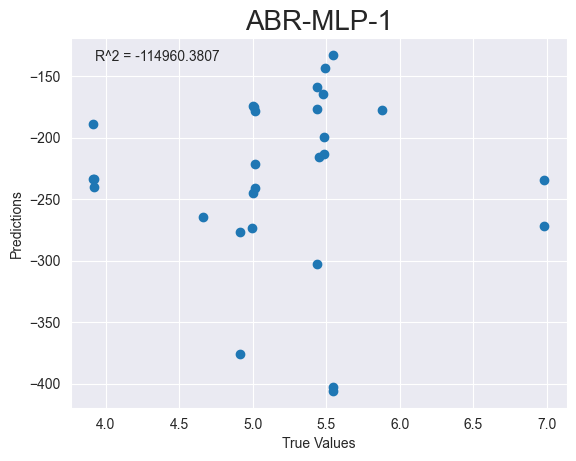

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_138"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_407 (Dense)           (None, 64)                832       
                                                                 
 dropout_92 (Dropout)        (None, 64)                0         
                                                                 
 dense_408 (Dense)       

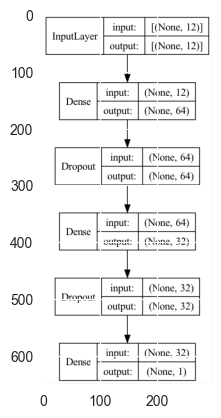

ABR-MLP-4
Epoch 1/4


2023-05-02 10:15:49.006758: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 300ms/step - loss: 2089149.2500 - mse: 2089149.2500 - mae: 1139.0323 - root_mean_squared_error: 1445.3889 - val_loss: 79358.4922 - val_mse: 79358.4922 - val_mae: 273.7279 - val_root_mean_squared_error: 281.7064
Epoch 2/4


2023-05-02 10:15:50.307400: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 92ms/step - loss: 398098.1562 - mse: 398098.1562 - mae: 502.3143 - root_mean_squared_error: 630.9502 - val_loss: 61433.9492 - val_mse: 61433.9492 - val_mae: 240.8612 - val_root_mean_squared_error: 247.8587
Epoch 3/4
3/3 [==============================] - 0s 40ms/step - loss: 199858.9844 - mse: 199858.9844 - mae: 341.0748 - root_mean_squared_error: 447.0559 - val_loss: 23395.7129 - val_mse: 23395.7129 - val_mae: 148.1154 - val_root_mean_squared_error: 152.9566
Epoch 4/4
1/1 [==============================] - 0s 59ms/step - loss: 23084.4512 - mse: 23084.4512 - mae: 142.9732 - root_mean_squared_error: 151.9357
Test loss: [23084.451171875, 23084.451171875, 142.97317504882812, 151.93568420410156]
['loss', 'mse', 'mae', 'root_mean_squared_error']


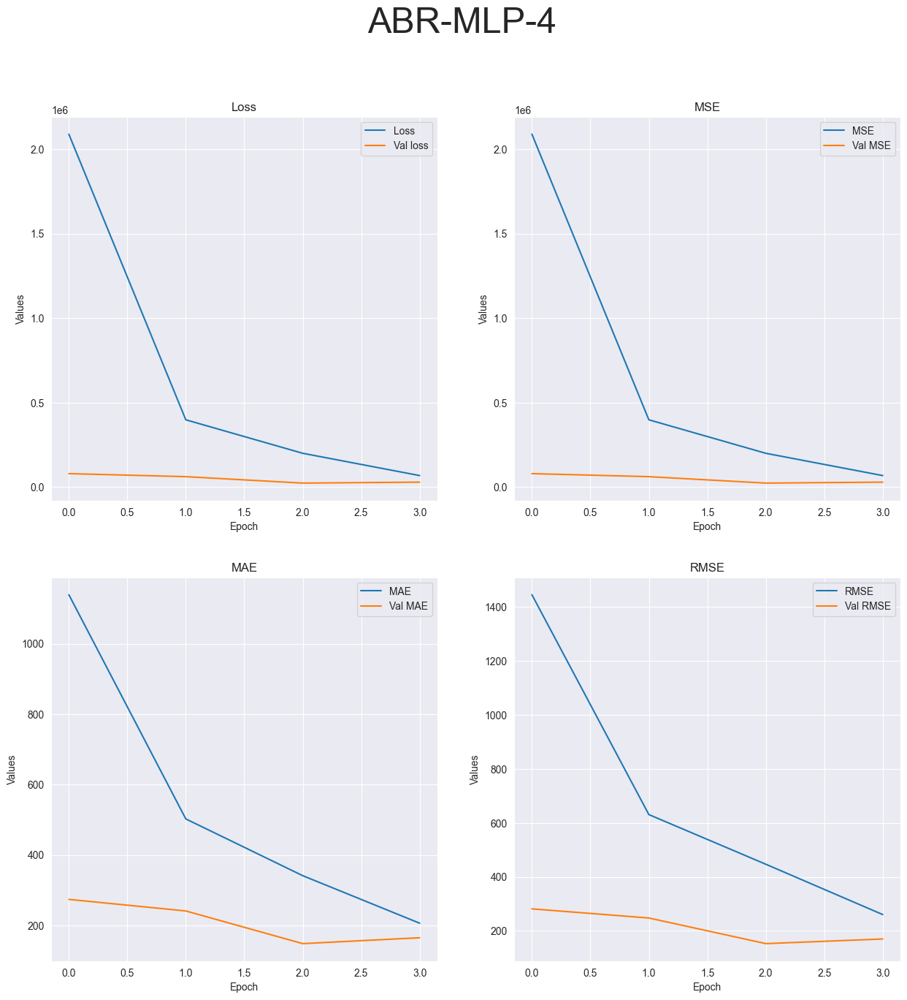

R-squared value: -66322.0838


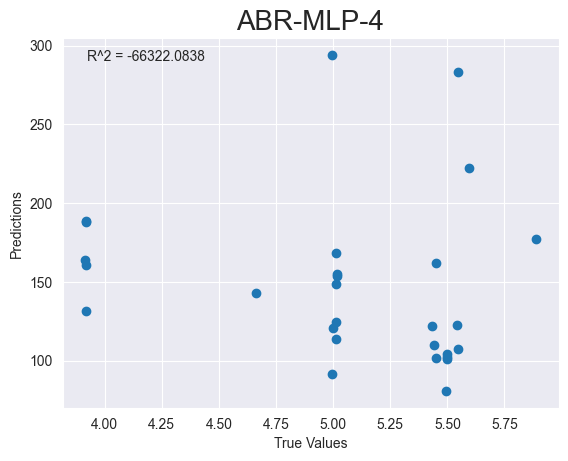

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_139"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_410 (Dense)           (None, 64)                832       
                                                                 
 dropout_94 (Dropout)        (None, 64)                0         
                                                                 
 dense_411 (Dense)      

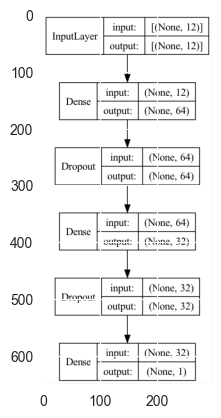

ABR-MLP-10
Epoch 1/10


2023-05-02 10:15:52.386554: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 293ms/step - loss: 2038272.0000 - mse: 2038272.0000 - mae: 1124.4602 - root_mean_squared_error: 1427.6807 - val_loss: 379.6456 - val_mse: 379.6456 - val_mae: 19.0960 - val_root_mean_squared_error: 19.4845
Epoch 2/10


2023-05-02 10:15:53.462976: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 98ms/step - loss: 418643.7812 - mse: 418643.7812 - mae: 478.0808 - root_mean_squared_error: 647.0269 - val_loss: 129453.9141 - val_mse: 129453.9141 - val_mae: 343.7494 - val_root_mean_squared_error: 359.7971
Epoch 3/10
3/3 [==============================] - 0s 34ms/step - loss: 246446.1406 - mse: 246446.1406 - mae: 391.4757 - root_mean_squared_error: 496.4334 - val_loss: 20.5560 - val_mse: 20.5560 - val_mae: 4.0006 - val_root_mean_squared_error: 4.5339
Epoch 4/10
3/3 [==============================] - 0s 21ms/step - loss: 79099.9922 - mse: 79099.9922 - mae: 216.0839 - root_mean_squared_error: 281.2472 - val_loss: 37879.1914 - val_mse: 37879.1914 - val_mae: 185.1470 - val_root_mean_squared_error: 194.6258
Epoch 5/10
3/3 [==============================] - 0s 67ms/step - loss: 65872.3516 - mse: 65872.3516 - mae: 205.5810 - root_mean_squared_error: 256.6561 - val_loss: 34491.3086 - val_mse: 34491.3086 - val_mae: 176.6465 - val_root_mean_squared_err

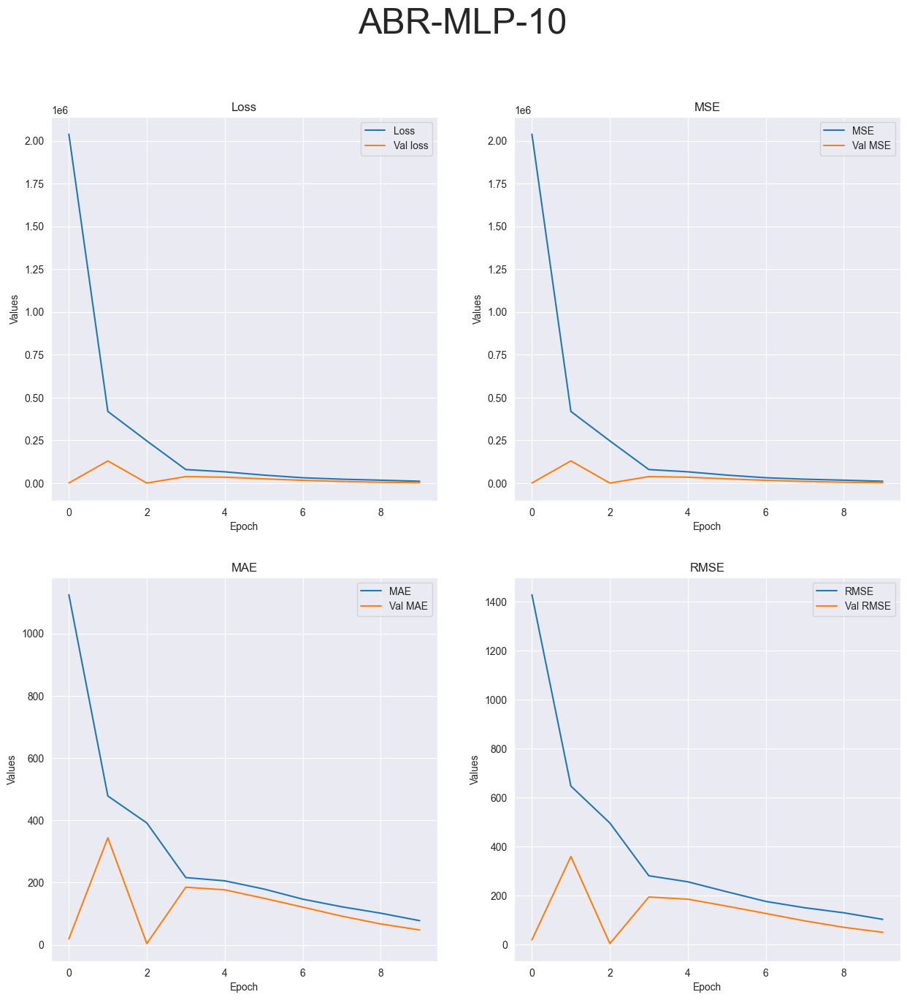

R-squared value: -3436.4455


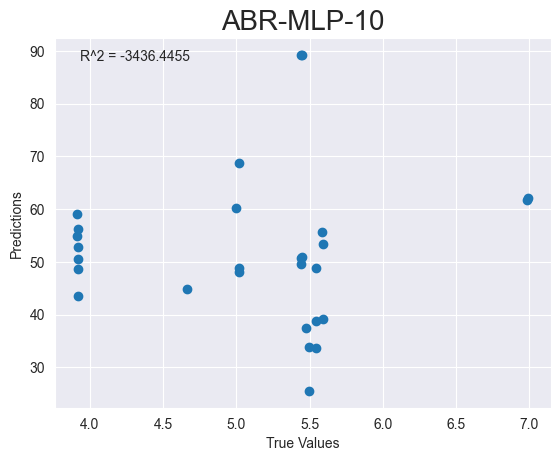

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_140"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_413 (Dense)           (None, 64)                832       
                                                                 
 dropout_96 (Dropout)        (None, 64)                0         
                                                                 
 dense_414 (Dense)      

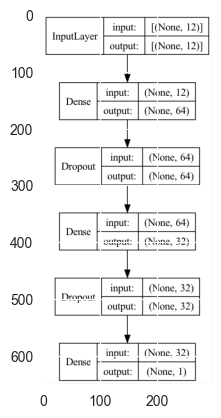

ABR-MLP-20
Epoch 1/20


2023-05-02 10:15:56.415452: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 286ms/step - loss: 2466501.7500 - mse: 2466501.7500 - mae: 1195.1296 - root_mean_squared_error: 1570.5100 - val_loss: 45436.5547 - val_mse: 45436.5547 - val_mae: 206.6342 - val_root_mean_squared_error: 213.1585
Epoch 2/20


2023-05-02 10:15:57.499835: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 89ms/step - loss: 356214.3750 - mse: 356214.3750 - mae: 464.3078 - root_mean_squared_error: 596.8370 - val_loss: 80972.5547 - val_mse: 80972.5547 - val_mae: 275.8381 - val_root_mean_squared_error: 284.5568
Epoch 3/20
3/3 [==============================] - 0s 47ms/step - loss: 211535.6250 - mse: 211535.6250 - mae: 360.9854 - root_mean_squared_error: 459.9300 - val_loss: 944.3644 - val_mse: 944.3644 - val_mae: 29.5713 - val_root_mean_squared_error: 30.7305
Epoch 4/20
3/3 [==============================] - 0s 41ms/step - loss: 53021.2930 - mse: 53021.2930 - mae: 164.2165 - root_mean_squared_error: 230.2635 - val_loss: 14266.3613 - val_mse: 14266.3613 - val_mae: 115.2213 - val_root_mean_squared_error: 119.4419
Epoch 5/20
3/3 [==============================] - 0s 20ms/step - loss: 42381.8320 - mse: 42381.8320 - mae: 160.0607 - root_mean_squared_error: 205.8685 - val_loss: 13604.6689 - val_mse: 13604.6689 - val_mae: 112.5140 - val_root_mean_squared_e

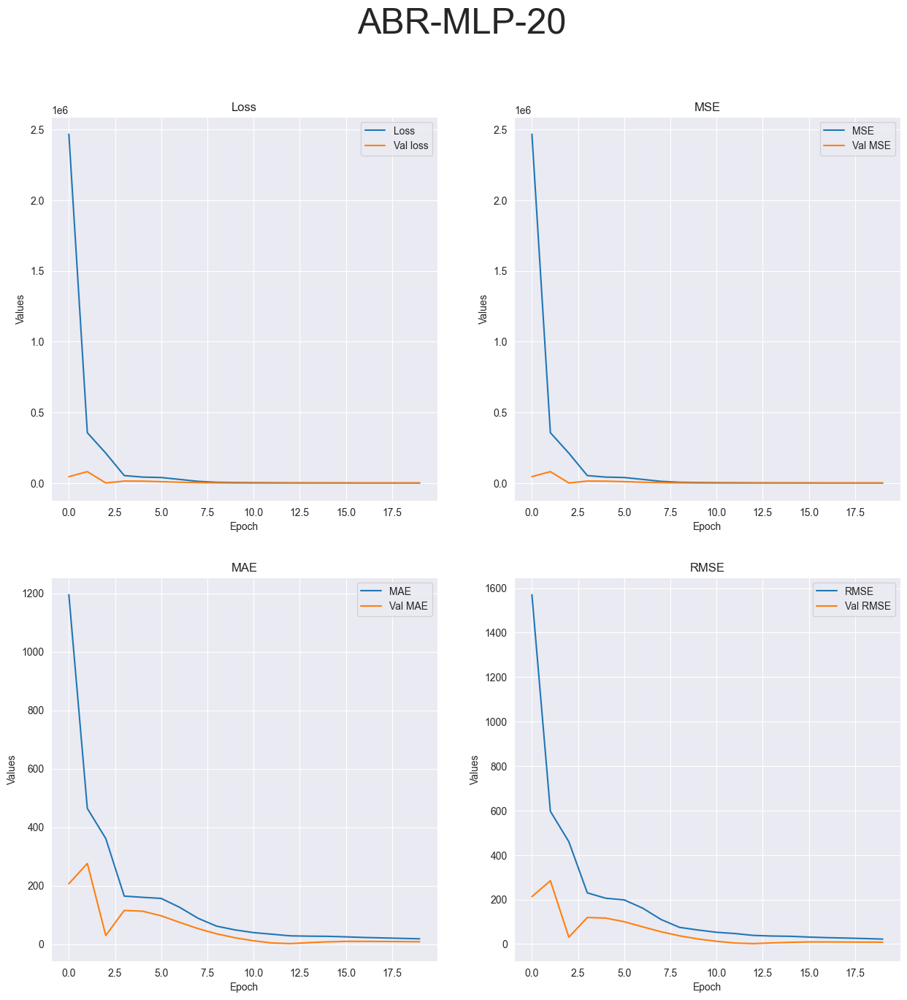

R-squared value: -232.6745


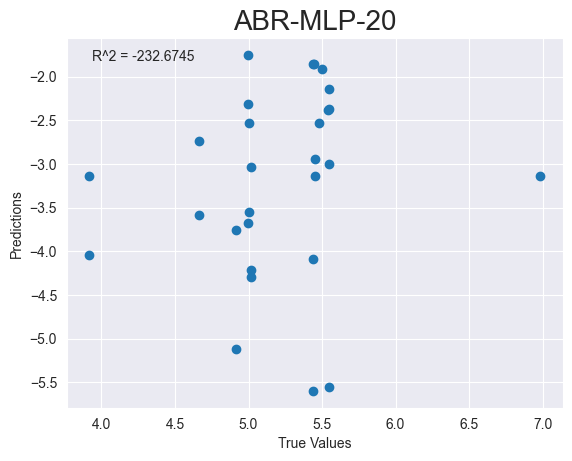

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_141"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_416 (Dense)           (None, 64)                832       
                                                                 
 dense_417 (Dense)           (None, 32)                2080      
                                                               

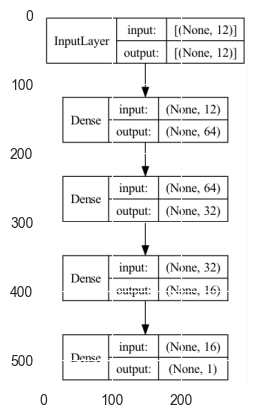

ABR-FCNN-1


2023-05-02 10:16:00.540341: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 283ms/step - loss: 4984483.5000 - mse: 4984483.5000 - mae: 1703.2030 - root_mean_squared_error: 2232.5957 - val_loss: 180086.9844 - val_mse: 180086.9844 - val_mae: 409.9193 - val_root_mean_squared_error: 424.3666


2023-05-02 10:16:01.475328: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 82ms/step - loss: 189018.5156 - mse: 189018.5156 - mae: 423.5589 - root_mean_squared_error: 434.7626
Test loss: [189018.515625, 189018.515625, 423.5589294433594, 434.7626037597656]
['loss', 'mse', 'mae', 'root_mean_squared_error']


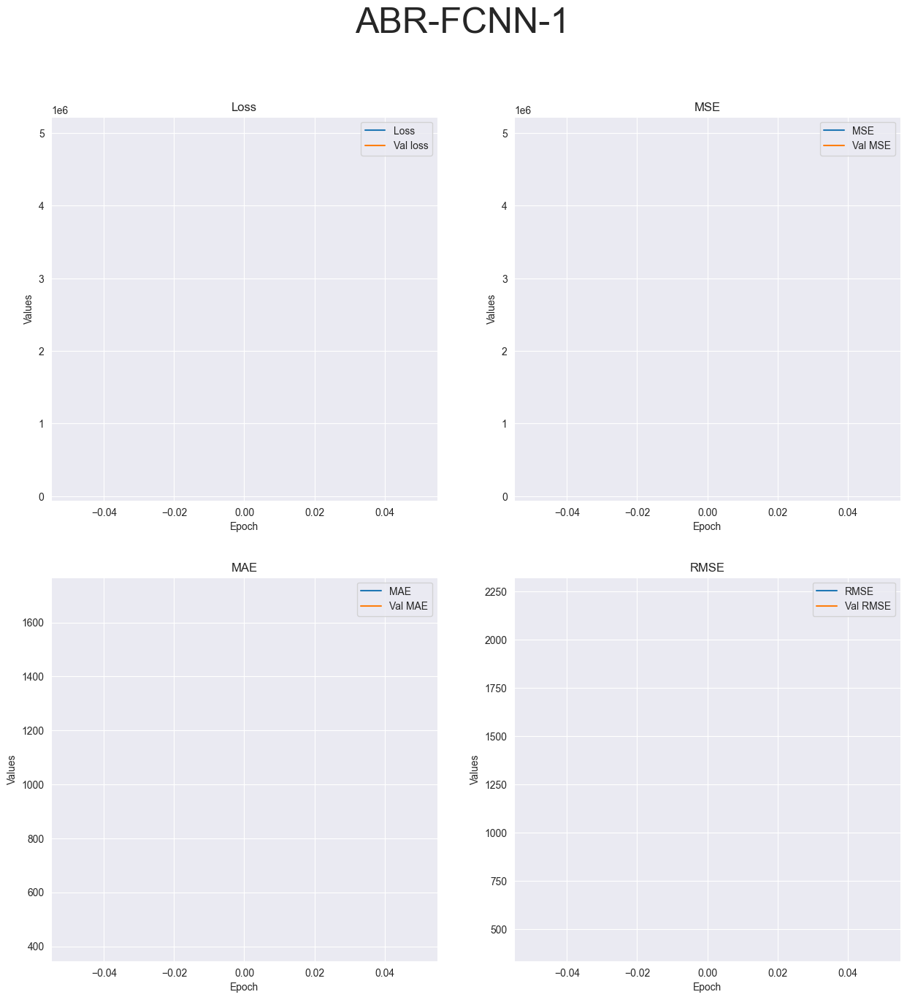

R-squared value: -288872.5313


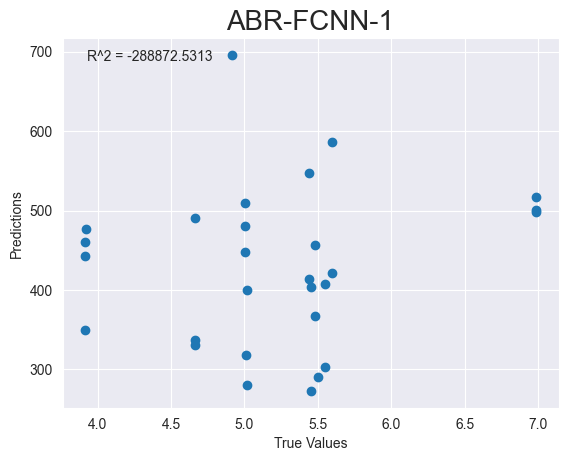

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_142"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_420 (Dense)           (None, 64)                832       
                                                                 
 dense_421 (Dense)           (None, 32)                2080      
                                                                 
 dense_422 (Dense)       

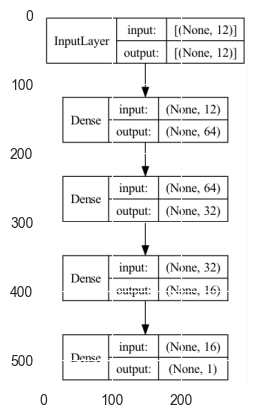

ABR-FCNN-4
Epoch 1/4


2023-05-02 10:16:03.069763: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 262ms/step - loss: 5906438.0000 - mse: 5906438.0000 - mae: 1766.9270 - root_mean_squared_error: 2430.3164 - val_loss: 141723.8750 - val_mse: 141723.8750 - val_mae: 363.6295 - val_root_mean_squared_error: 376.4623
Epoch 2/4


2023-05-02 10:16:03.913680: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 89ms/step - loss: 1352509.2500 - mse: 1352509.3750 - mae: 1000.1171 - root_mean_squared_error: 1162.9744 - val_loss: 1766285.2500 - val_mse: 1766285.2500 - val_mae: 1285.0798 - val_root_mean_squared_error: 1329.0166
Epoch 3/4
3/3 [==============================] - 0s 37ms/step - loss: 1173438.8750 - mse: 1173438.8750 - mae: 957.6831 - root_mean_squared_error: 1083.2538 - val_loss: 16.9059 - val_mse: 16.9059 - val_mae: 3.5104 - val_root_mean_squared_error: 4.1117
Epoch 4/4
1/1 [==============================] - 0s 101ms/step - loss: 469540.4062 - mse: 469540.4062 - mae: 675.1917 - root_mean_squared_error: 685.2302
Test loss: [469540.40625, 469540.40625, 675.1917114257812, 685.2301635742188]
['loss', 'mse', 'mae', 'root_mean_squared_error']


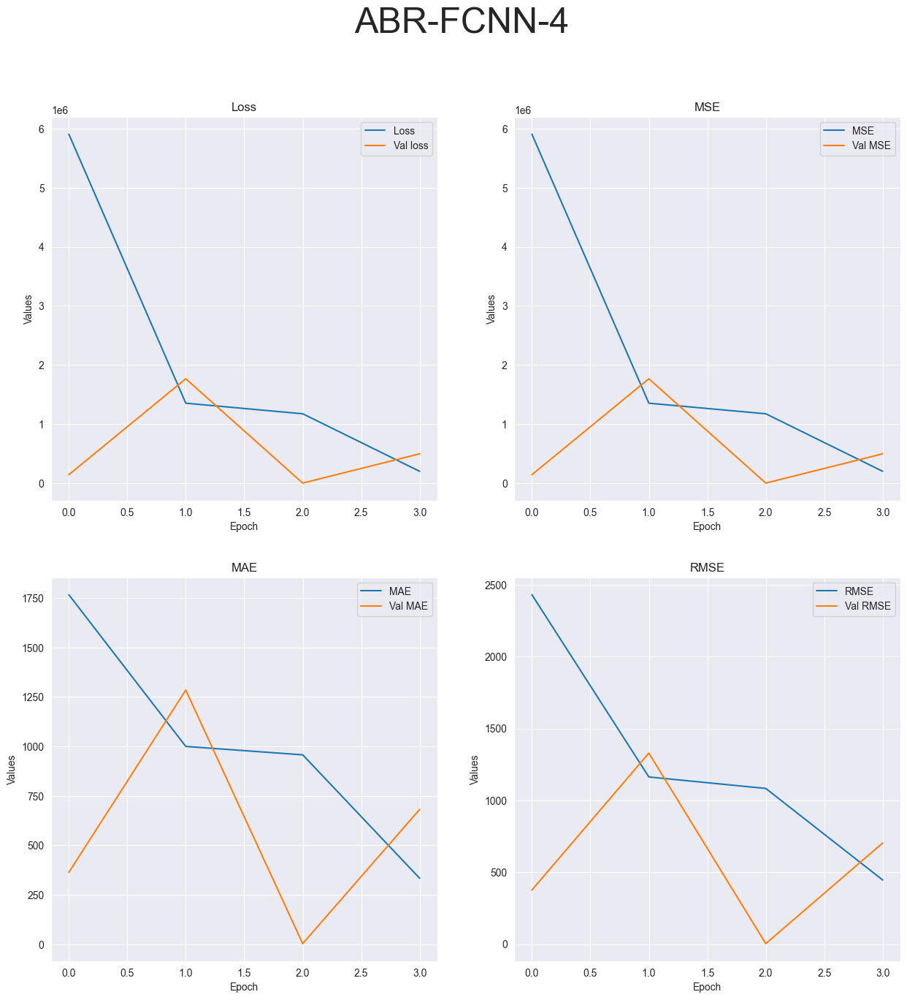

R-squared value: -677675.9041


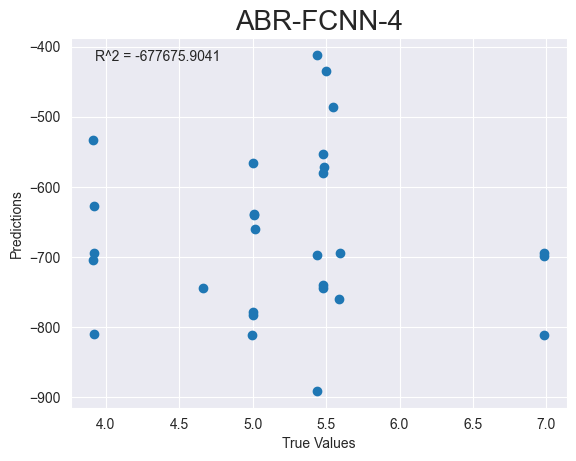

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_143"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_424 (Dense)           (None, 64)                832       
                                                                 
 dense_425 (Dense)           (None, 32)                2080      
                                                                 
 dense_426 (Dense)      

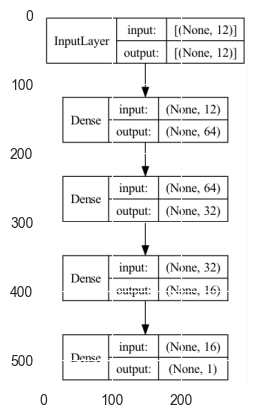

ABR-FCNN-10
Epoch 1/10


2023-05-02 10:16:06.808157: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 282ms/step - loss: 6642050.0000 - mse: 6642050.0000 - mae: 1863.1306 - root_mean_squared_error: 2577.2175 - val_loss: 186765.5625 - val_mse: 186765.5625 - val_mae: 410.1829 - val_root_mean_squared_error: 432.1638
Epoch 2/10


2023-05-02 10:16:07.804510: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 73ms/step - loss: 1451948.2500 - mse: 1451948.2500 - mae: 1041.8683 - root_mean_squared_error: 1204.9681 - val_loss: 2335517.5000 - val_mse: 2335517.5000 - val_mae: 1450.3640 - val_root_mean_squared_error: 1528.2400
Epoch 3/10
3/3 [==============================] - 0s 43ms/step - loss: 1356977.1250 - mse: 1356977.1250 - mae: 1069.6499 - root_mean_squared_error: 1164.8936 - val_loss: 20615.8223 - val_mse: 20615.8223 - val_mae: 135.5124 - val_root_mean_squared_error: 143.5821
Epoch 4/10
3/3 [==============================] - 0s 32ms/step - loss: 140300.3750 - mse: 140300.3750 - mae: 319.3690 - root_mean_squared_error: 374.5669 - val_loss: 627710.9375 - val_mse: 627710.9375 - val_mae: 753.1076 - val_root_mean_squared_error: 792.2821
Epoch 5/10
3/3 [==============================] - 0s 28ms/step - loss: 572388.5625 - mse: 572388.5625 - mae: 726.6367 - root_mean_squared_error: 756.5637 - val_loss: 317635.5938 - val_mse: 317635.5938 - val_mae: 535.97

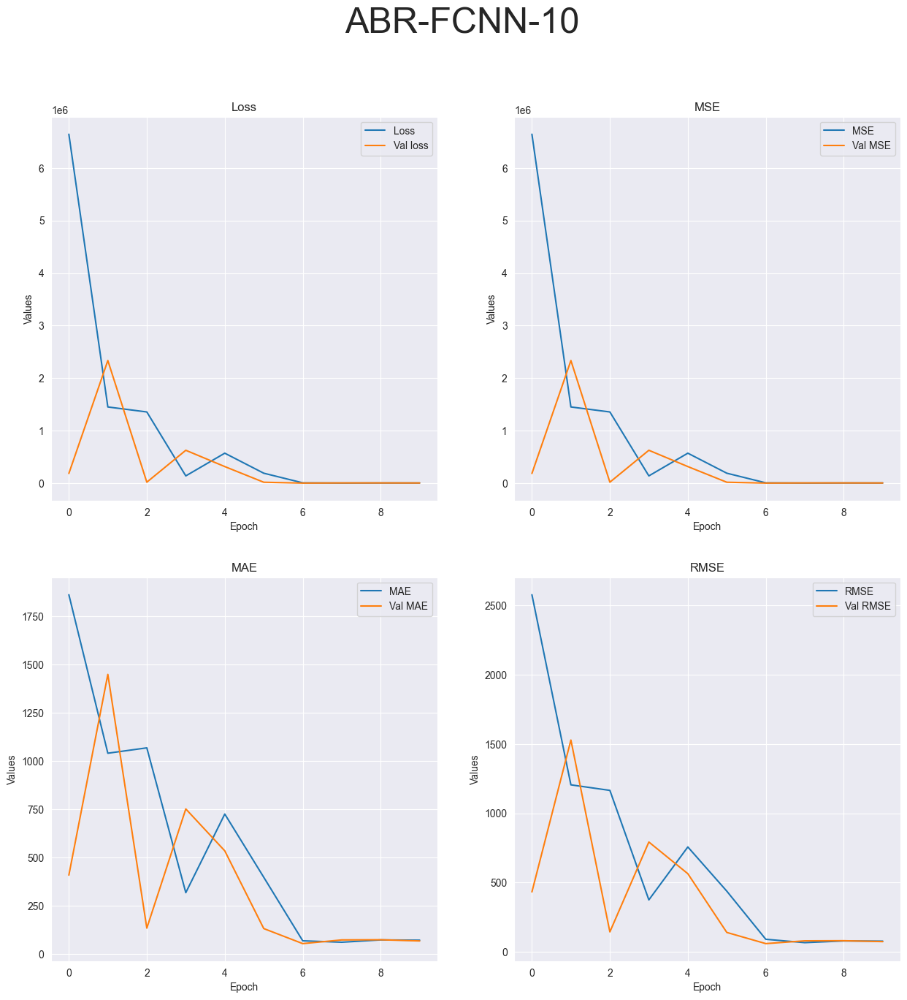

R-squared value: -7778.8296


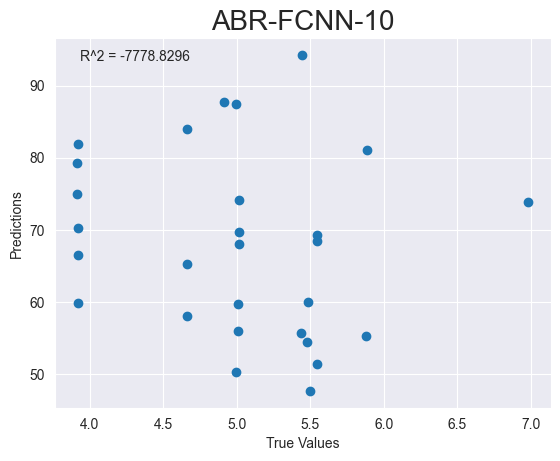

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_144"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_428 (Dense)           (None, 64)                832       
                                                                 
 dense_429 (Dense)           (None, 32)                2080      
                                                                 
 dense_430 (Dense)      

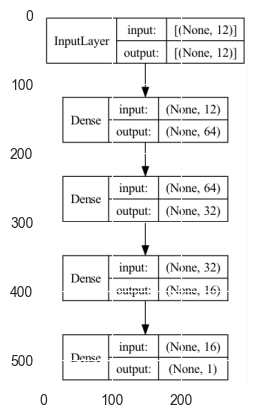

ABR-FCNN-20
Epoch 1/20


2023-05-02 10:16:10.098468: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 259ms/step - loss: 5837579.0000 - mse: 5837579.0000 - mae: 1765.1699 - root_mean_squared_error: 2416.1082 - val_loss: 205537.0000 - val_mse: 205537.0000 - val_mae: 435.3431 - val_root_mean_squared_error: 453.3619
Epoch 2/20


2023-05-02 10:16:10.921814: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 58ms/step - loss: 1408565.6250 - mse: 1408565.6250 - mae: 1032.7714 - root_mean_squared_error: 1186.8301 - val_loss: 2308353.0000 - val_mse: 2308353.0000 - val_mae: 1459.3356 - val_root_mean_squared_error: 1519.3265
Epoch 3/20
3/3 [==============================] - 0s 33ms/step - loss: 1186743.7500 - mse: 1186743.7500 - mae: 1002.6860 - root_mean_squared_error: 1089.3777 - val_loss: 18244.3809 - val_mse: 18244.3809 - val_mae: 129.0162 - val_root_mean_squared_error: 135.0718
Epoch 4/20
3/3 [==============================] - 0s 35ms/step - loss: 147982.0000 - mse: 147982.0000 - mae: 313.7894 - root_mean_squared_error: 384.6843 - val_loss: 587789.9375 - val_mse: 587789.9375 - val_mae: 737.4594 - val_root_mean_squared_error: 766.6746
Epoch 5/20
3/3 [==============================] - 0s 30ms/step - loss: 480321.1562 - mse: 480321.1562 - mae: 667.1310 - root_mean_squared_error: 693.0521 - val_loss: 277613.0000 - val_mse: 277613.0000 - val_mae: 507.03

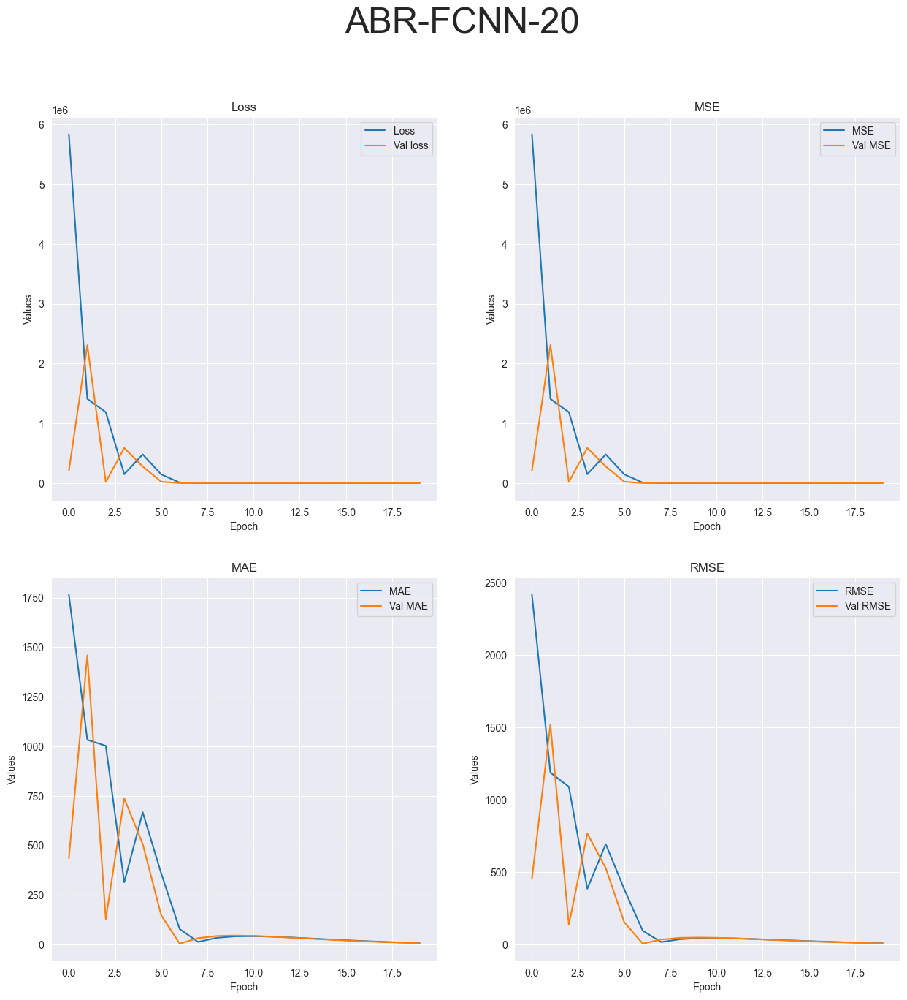

R-squared value: -137.6386


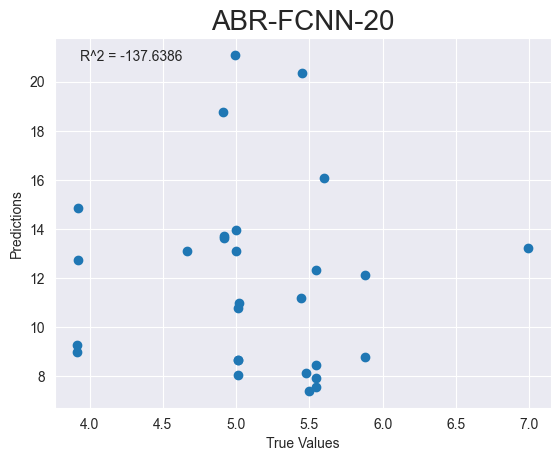

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_145"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_432 (Dense)           (None, 128)               1664      
                                                                 
 dense_433 (Dense)           (None, 1)                 129       
                                                            

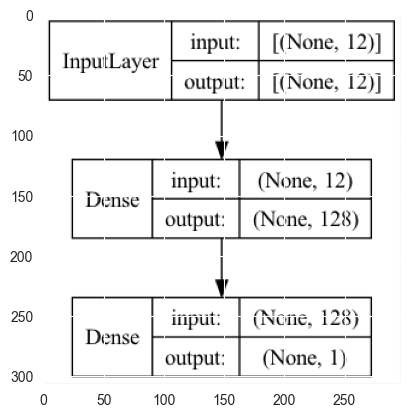

ABR-DeepSVM-1


2023-05-02 10:16:13.848714: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 238ms/step - loss: 588123776.0000 - mse: 588123776.0000 - mae: 23172.6582 - root_mean_squared_error: 24251.2637 - val_loss: 291107776.0000 - val_mse: 291107776.0000 - val_mae: 16633.5352 - val_root_mean_squared_error: 17061.8809


2023-05-02 10:16:14.681197: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 86ms/step - loss: 334054752.0000 - mse: 334054752.0000 - mae: 17336.0605 - root_mean_squared_error: 18277.1641
Test loss: [334054752.0, 334054752.0, 17336.060546875, 18277.1640625]
['loss', 'mse', 'mae', 'root_mean_squared_error']


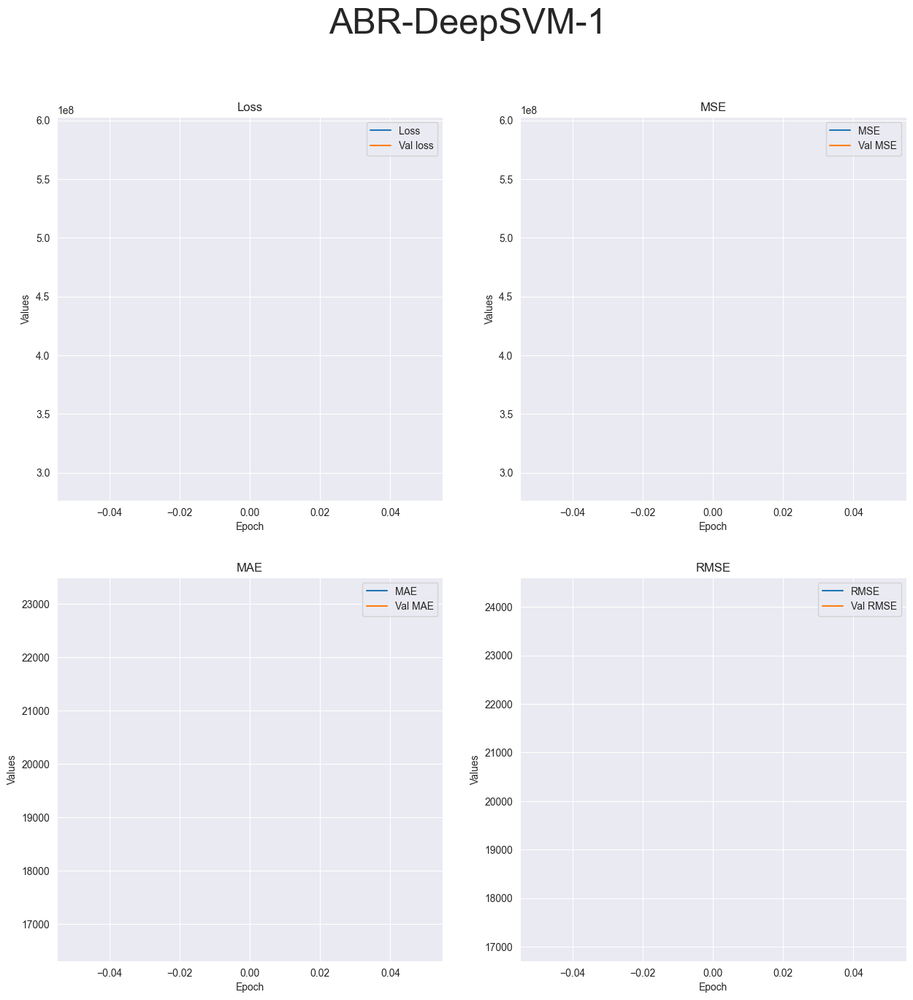

R-squared value: -940235628.6118


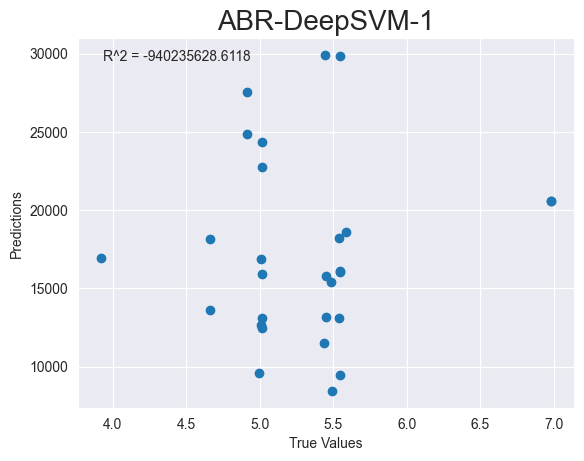

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_146"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_434 (Dense)           (None, 128)               1664      
                                                                 
 dense_435 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Train

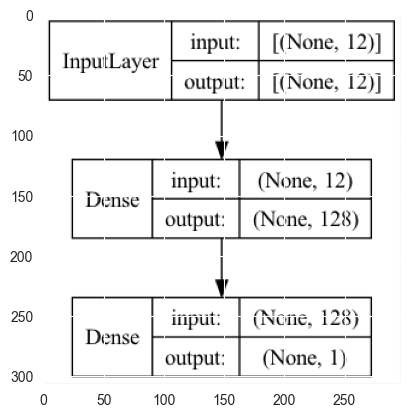

ABR-DeepSVM-4
Epoch 1/4


2023-05-02 10:16:16.288581: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 221ms/step - loss: 565566208.0000 - mse: 565566208.0000 - mae: 22883.9863 - root_mean_squared_error: 23781.6367 - val_loss: 330653824.0000 - val_mse: 330653824.0000 - val_mae: 17350.5586 - val_root_mean_squared_error: 18183.8887
Epoch 2/4


2023-05-02 10:16:16.959100: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 83ms/step - loss: 220031184.0000 - mse: 220031184.0000 - mae: 14270.5508 - root_mean_squared_error: 14833.4482 - val_loss: 123969224.0000 - val_mse: 123969224.0000 - val_mae: 10619.8984 - val_root_mean_squared_error: 11134.1465
Epoch 3/4
3/3 [==============================] - 0s 36ms/step - loss: 84642520.0000 - mse: 84642520.0000 - mae: 8759.4463 - root_mean_squared_error: 9200.1367 - val_loss: 45048204.0000 - val_mse: 45048204.0000 - val_mae: 6398.8765 - val_root_mean_squared_error: 6711.7959
Epoch 4/4
1/1 [==============================] - 0s 97ms/step - loss: 16199115.0000 - mse: 16199115.0000 - mae: 3808.3008 - root_mean_squared_error: 4024.8125
Test loss: [16199115.0, 16199115.0, 3808.30078125, 4024.8125]
['loss', 'mse', 'mae', 'root_mean_squared_error']


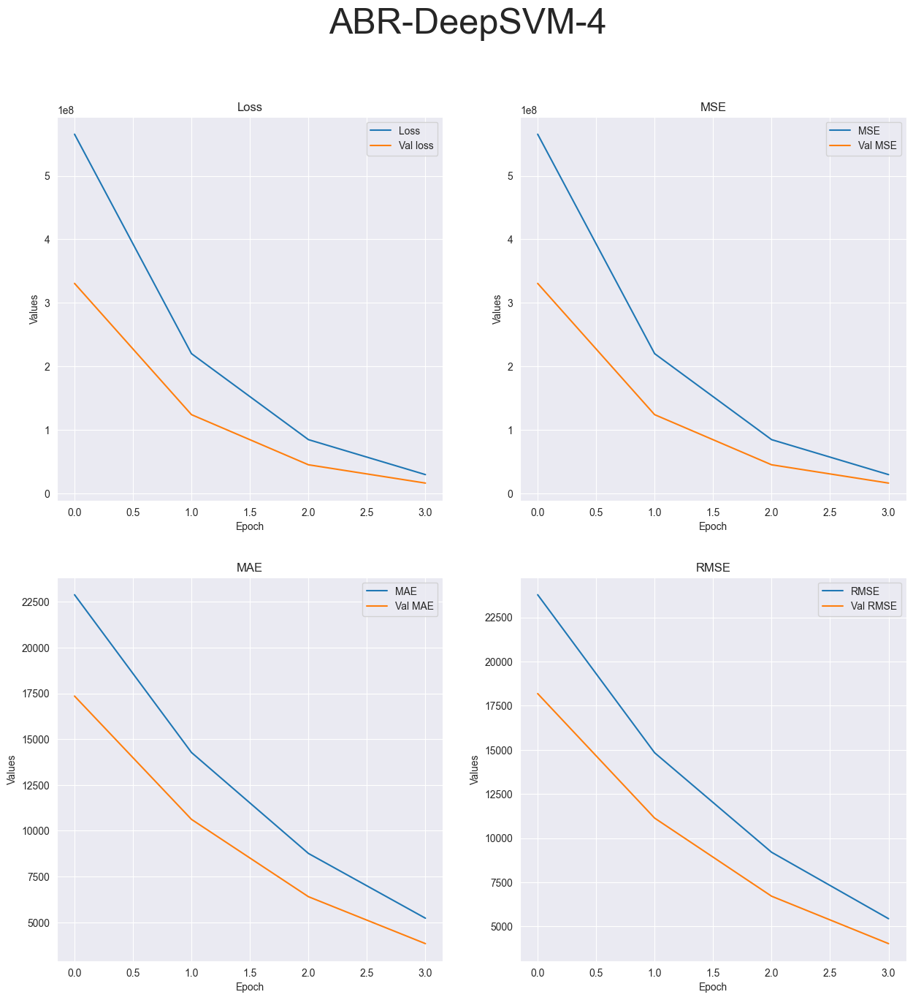

R-squared value: -64532544.1417


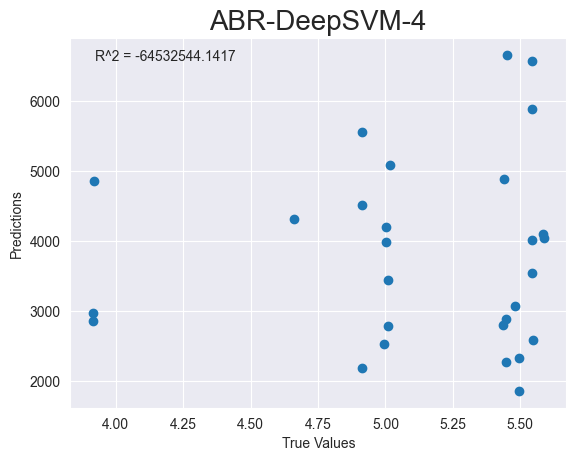

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_147"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_436 (Dense)           (None, 128)               1664      
                                                                 
 dense_437 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Trai

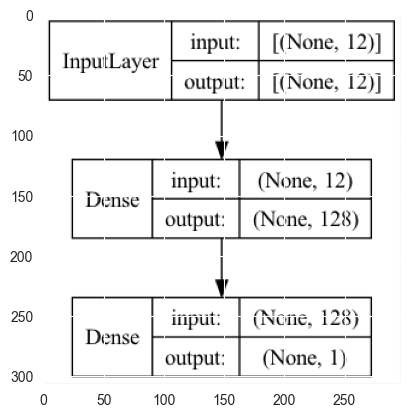

ABR-DeepSVM-10
Epoch 1/10


2023-05-02 10:16:19.820183: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 240ms/step - loss: 606229696.0000 - mse: 606229696.0000 - mae: 23572.6406 - root_mean_squared_error: 24621.7324 - val_loss: 319439680.0000 - val_mse: 319439680.0000 - val_mae: 17293.5898 - val_root_mean_squared_error: 17872.8750
Epoch 2/10


2023-05-02 10:16:20.687124: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 113ms/step - loss: 239935584.0000 - mse: 239935584.0000 - mae: 14718.5479 - root_mean_squared_error: 15489.8545 - val_loss: 118890216.0000 - val_mse: 118890216.0000 - val_mae: 10547.6865 - val_root_mean_squared_error: 10903.6787
Epoch 3/10
3/3 [==============================] - 0s 40ms/step - loss: 88417520.0000 - mse: 88417520.0000 - mae: 8945.1758 - root_mean_squared_error: 9403.0586 - val_loss: 43405496.0000 - val_mse: 43405496.0000 - val_mae: 6371.2866 - val_root_mean_squared_error: 6588.2847
Epoch 4/10
3/3 [==============================] - 0s 28ms/step - loss: 32350634.0000 - mse: 32350634.0000 - mae: 5400.4131 - root_mean_squared_error: 5687.7617 - val_loss: 15564435.0000 - val_mse: 15564435.0000 - val_mae: 3813.7805 - val_root_mean_squared_error: 3945.1787
Epoch 5/10
3/3 [==============================] - 0s 21ms/step - loss: 11737284.0000 - mse: 11737284.0000 - mae: 3223.7603 - root_mean_squared_error: 3425.9719 - val_loss: 5029107.000

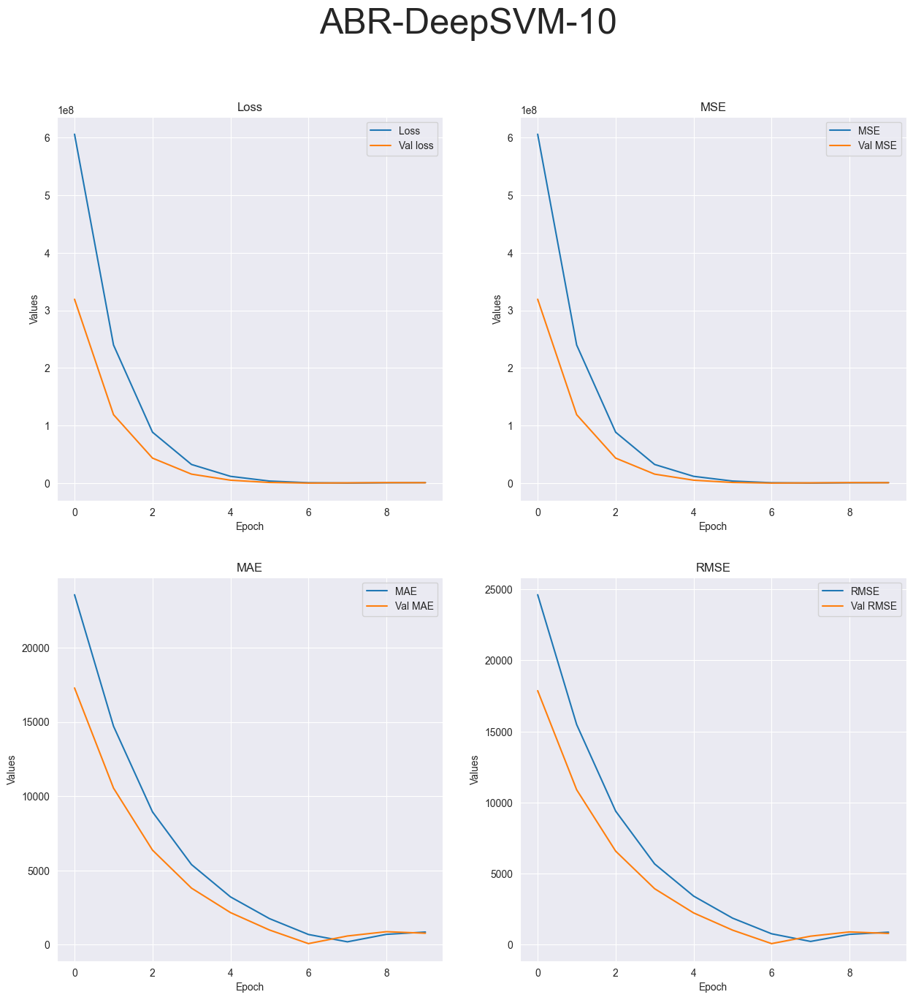

R-squared value: -1223863.1347


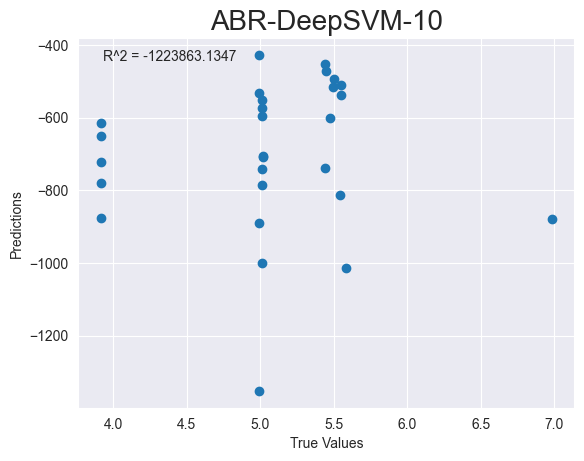

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_148"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_438 (Dense)           (None, 128)               1664      
                                                                 
 dense_439 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Trai

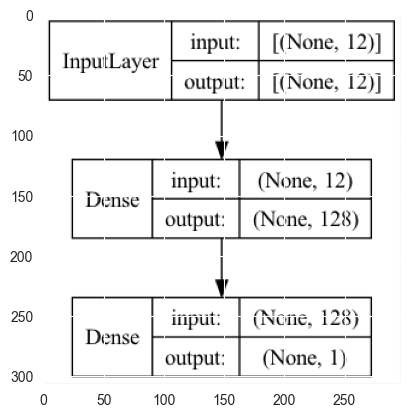

ABR-DeepSVM-20
Epoch 1/20


2023-05-02 10:16:23.328399: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 249ms/step - loss: 570789312.0000 - mse: 570789312.0000 - mae: 22938.3574 - root_mean_squared_error: 23891.1973 - val_loss: 282859648.0000 - val_mse: 282859648.0000 - val_mae: 16221.9346 - val_root_mean_squared_error: 16818.4316
Epoch 2/20


2023-05-02 10:16:24.041309: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 35ms/step - loss: 225871440.0000 - mse: 225871440.0000 - mae: 14295.2979 - root_mean_squared_error: 15029.0195 - val_loss: 105078120.0000 - val_mse: 105078120.0000 - val_mae: 9883.9043 - val_root_mean_squared_error: 10250.7617
Epoch 3/20
3/3 [==============================] - 0s 28ms/step - loss: 83318672.0000 - mse: 83318672.0000 - mae: 8695.4678 - root_mean_squared_error: 9127.9062 - val_loss: 38262752.0000 - val_mse: 38262752.0000 - val_mae: 5961.8721 - val_root_mean_squared_error: 6185.6895
Epoch 4/20
3/3 [==============================] - 0s 34ms/step - loss: 30236848.0000 - mse: 30236848.0000 - mae: 5234.1509 - root_mean_squared_error: 5498.8042 - val_loss: 13698020.0000 - val_mse: 13698020.0000 - val_mae: 3565.2954 - val_root_mean_squared_error: 3701.0837
Epoch 5/20
3/3 [==============================] - 0s 25ms/step - loss: 10682936.0000 - mse: 10682936.0000 - mae: 3106.0552 - root_mean_squared_error: 3268.4761 - val_loss: 4403153.0000 

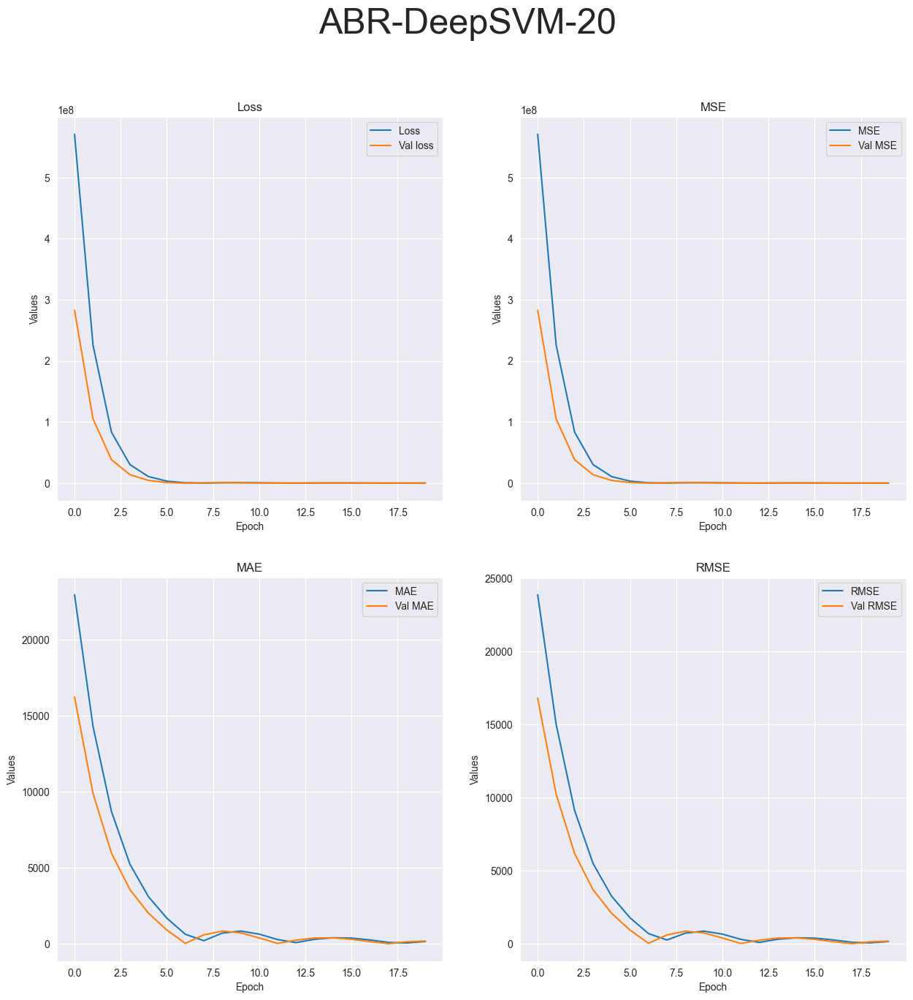

R-squared value: -88383.9283


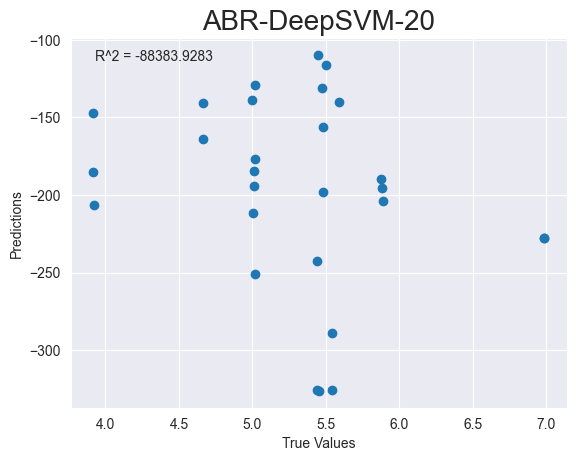

Running MachineLearning tests...
Running tests on CGBR.csv dataset...
Running Linear model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
CGBR-Linear-1
Running SVR model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
CGBR-SVR
plotting linear


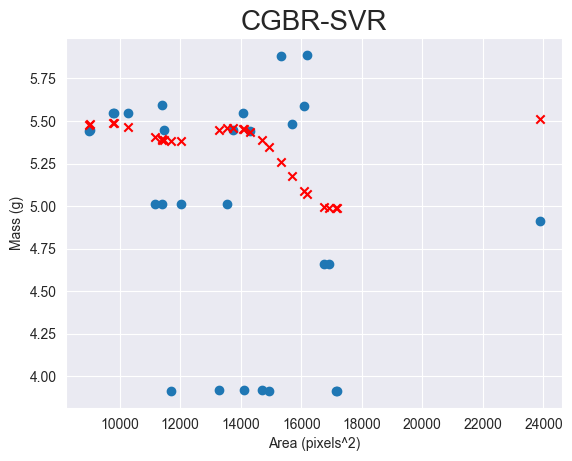

R-squared value: -0.2219


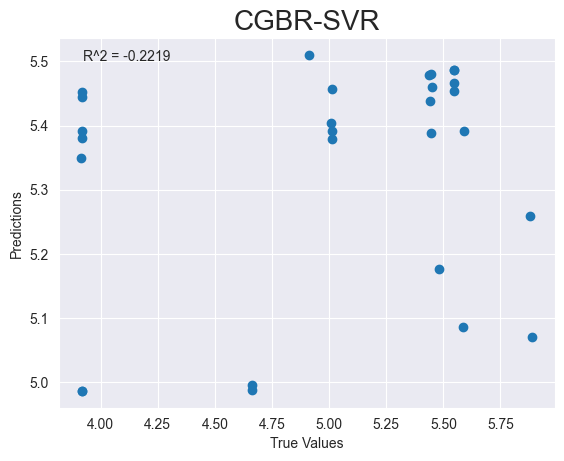

Running Images tests...
Running tests on CIBR.pkl dataset...
Running CNN model tests...
Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_149"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 69, 69, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_13 (Conv2D)          (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 33, 33,

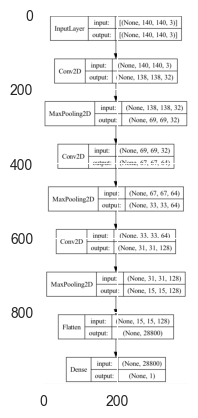

CIBR-CNN-2
Epoch 1/2


2023-05-02 10:16:28.857767: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2880.9048 - mse: 2880.9048 - mae: 32.5872 - root_mean_squared_error: 53.6741

2023-05-02 10:16:30.953547: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 714ms/step - loss: 2880.9048 - mse: 2880.9048 - mae: 32.5872 - root_mean_squared_error: 53.6741 - val_loss: 26.3567 - val_mse: 26.3567 - val_mae: 5.0999 - val_root_mean_squared_error: 5.1339
Epoch 2/2
1/1 [==============================] - 2s 2s/step - loss: 2.2656 - mse: 2.2656 - mae: 1.3285 - root_mean_squared_error: 1.5052
Test loss: [2.2655551433563232, 2.2655551433563232, 1.328501582145691, 1.505176067352295]
['loss', 'mse', 'mae', 'root_mean_squared_error']


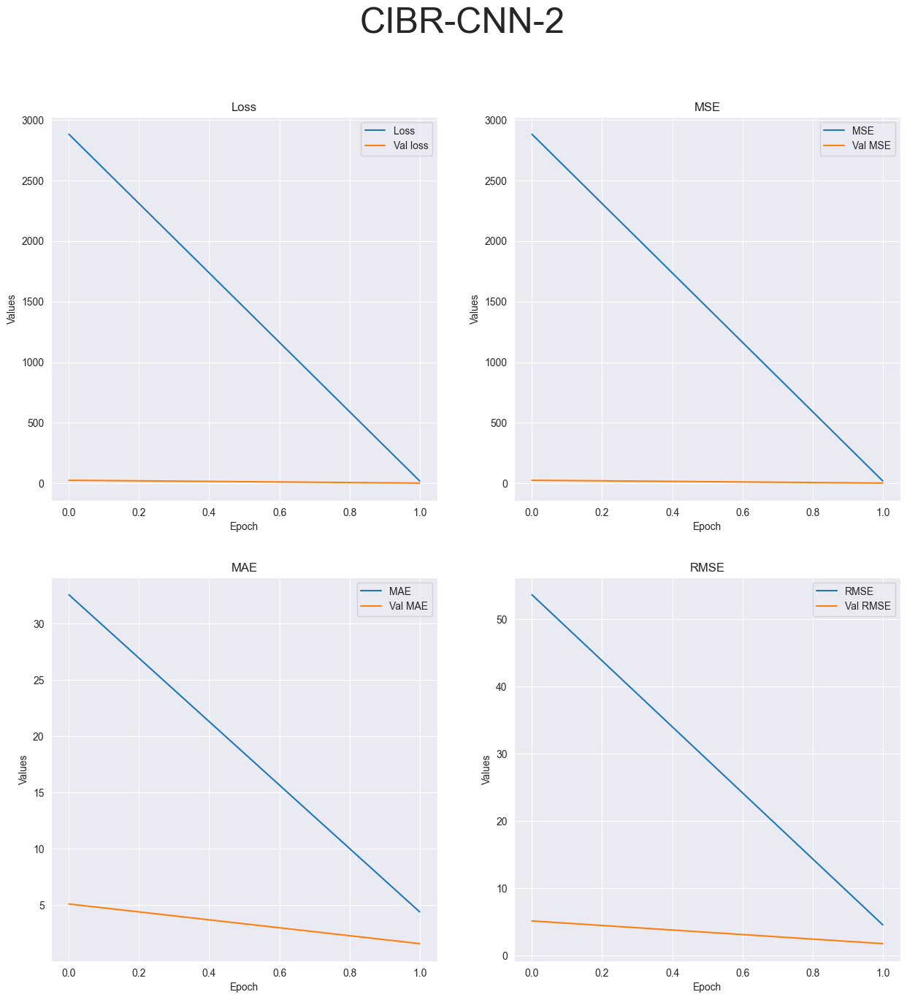

R-squared value: -3.4812


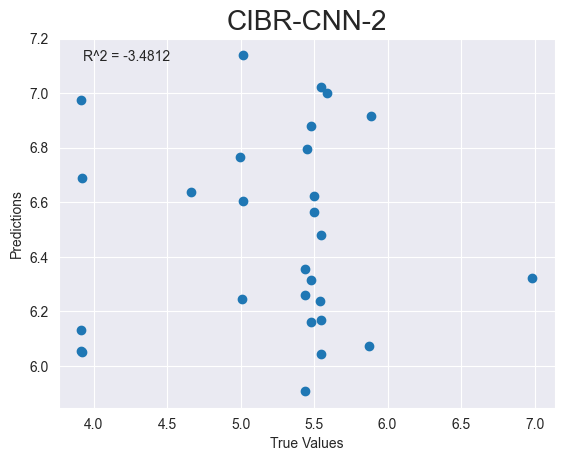

Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_150"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_15 (Conv2D)          (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_15 (MaxPoolin  (None, 69, 69, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_16 (Conv2D)          (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_16 (MaxPoolin  (None, 33, 33, 64)       0         
 g2D)                                                            


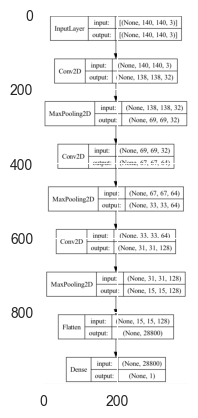

CIBR-CNN-2
Epoch 1/2


2023-05-02 10:16:37.447853: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2804.2085 - mse: 2804.2085 - mae: 31.9640 - root_mean_squared_error: 52.9548

2023-05-02 10:16:40.289807: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 4s 1s/step - loss: 2804.2085 - mse: 2804.2085 - mae: 31.9640 - root_mean_squared_error: 52.9548 - val_loss: 32.1273 - val_mse: 32.1273 - val_mae: 5.6418 - val_root_mean_squared_error: 5.6681
Epoch 2/2
1/1 [==============================] - 0s 226ms/step - loss: 9.7261 - mse: 9.7261 - mae: 3.0519 - root_mean_squared_error: 3.1187
Test loss: [9.726109504699707, 9.726109504699707, 3.051875352859497, 3.118671178817749]
['loss', 'mse', 'mae', 'root_mean_squared_error']


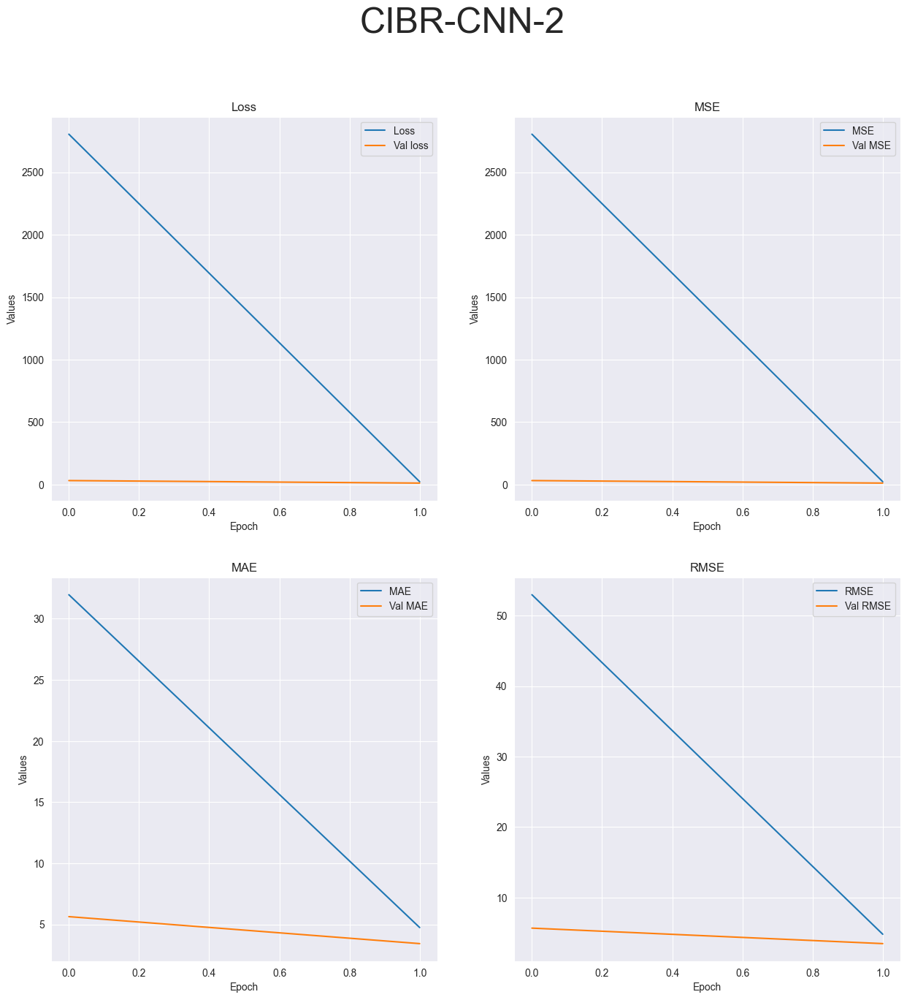

R-squared value: -19.9187


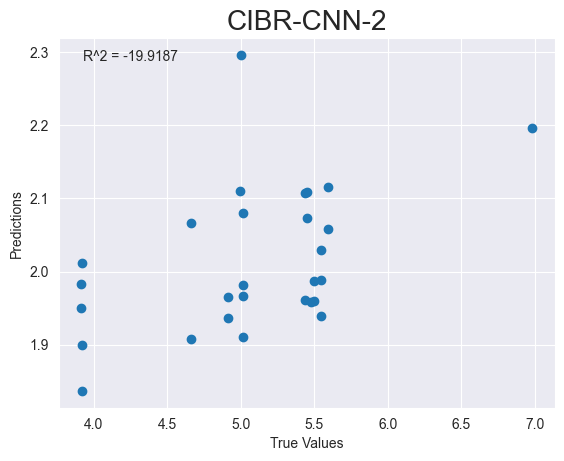

Running tests with 1 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_151"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_18 (MaxPoolin  (None, 69, 69, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_19 (Conv2D)          (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_19 (MaxPoolin  (None, 33, 33, 64)       0         
 g2D)                                                            


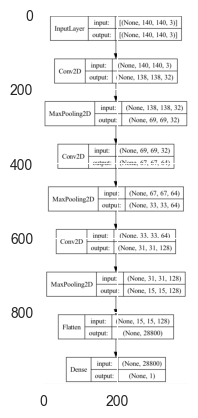

CIBR-CNN-1


2023-05-02 10:16:44.331028: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2888.8225 - mse: 2888.8225 - mae: 32.5586 - root_mean_squared_error: 53.7478

2023-05-02 10:16:45.589908: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 228ms/step - loss: 32.2065 - mse: 32.2065 - mae: 5.6447 - root_mean_squared_error: 5.6751
Test loss: [32.206459045410156, 32.206459045410156, 5.644664287567139, 5.675073623657227]
['loss', 'mse', 'mae', 'root_mean_squared_error']


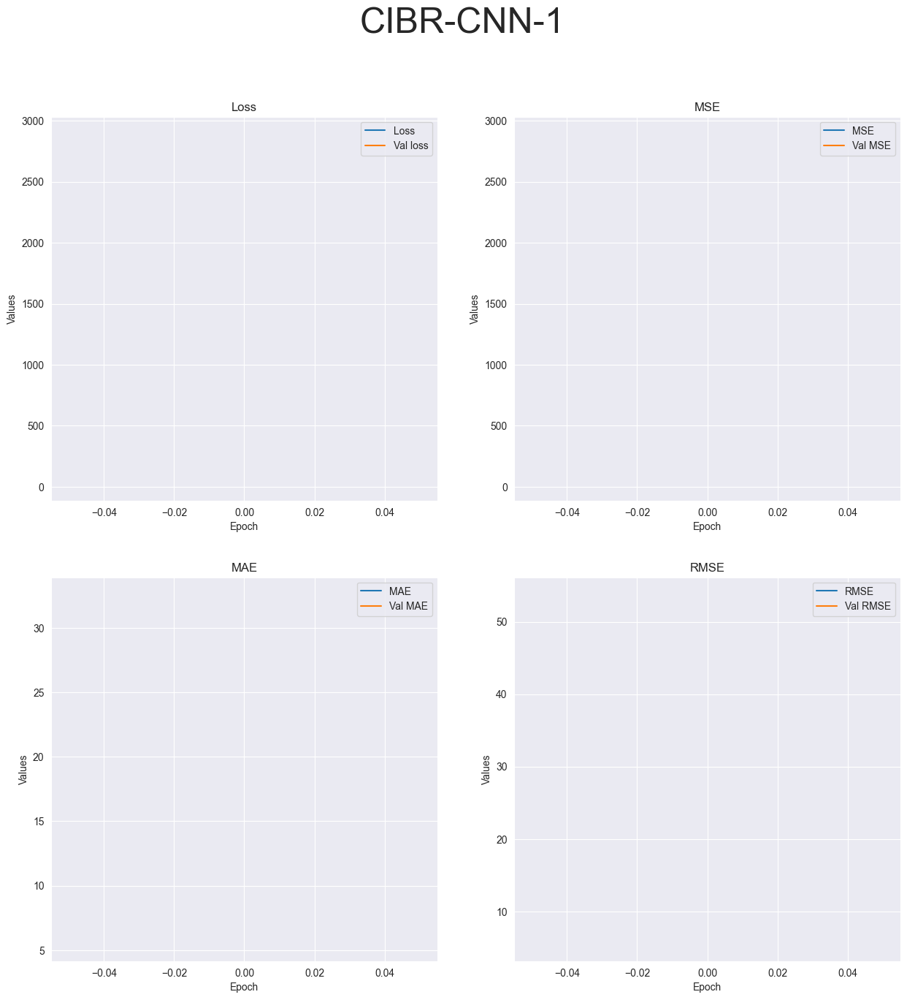

R-squared value: -98.8921


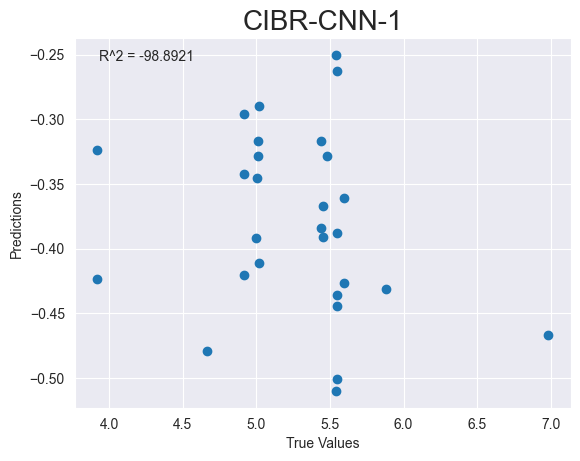

Running tests with 4 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_152"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_21 (Conv2D)          (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_21 (MaxPoolin  (None, 69, 69, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_22 (Conv2D)          (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_22 (MaxPoolin  (None, 33, 33, 64)       0         
 g2D)                                                            


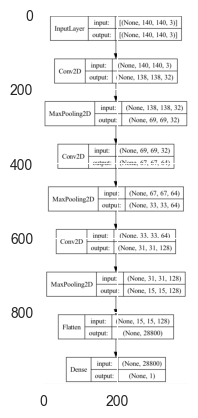

CIBR-CNN-4
Epoch 1/4


2023-05-02 10:16:48.829951: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 1876.6498 - mse: 1876.6498 - mae: 28.7492 - root_mean_squared_error: 43.3203

2023-05-02 10:16:49.971937: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 394ms/step - loss: 1876.6498 - mse: 1876.6498 - mae: 28.7492 - root_mean_squared_error: 43.3203 - val_loss: 32.6012 - val_mse: 32.6012 - val_mae: 5.6549 - val_root_mean_squared_error: 5.7097
Epoch 2/4
3/3 [==============================] - 0s 136ms/step - loss: 28.2030 - mse: 28.2030 - mae: 5.2608 - root_mean_squared_error: 5.3106 - val_loss: 16.5220 - val_mse: 16.5220 - val_mae: 4.0171 - val_root_mean_squared_error: 4.0647
Epoch 3/4
3/3 [==============================] - 0s 99ms/step - loss: 8.6688 - mse: 8.6688 - mae: 2.5160 - root_mean_squared_error: 2.9443 - val_loss: 11.6433 - val_mse: 11.6433 - val_mae: 3.3587 - val_root_mean_squared_error: 3.4122
Epoch 4/4
1/1 [==============================] - 0s 178ms/step - loss: 1.3824 - mse: 1.3824 - mae: 0.9653 - root_mean_squared_error: 1.1757
Test loss: [1.3823765516281128, 1.3823765516281128, 0.9653481245040894, 1.1757451295852661]
['loss', 'mse', 'mae', 'root_mean_squared_error']


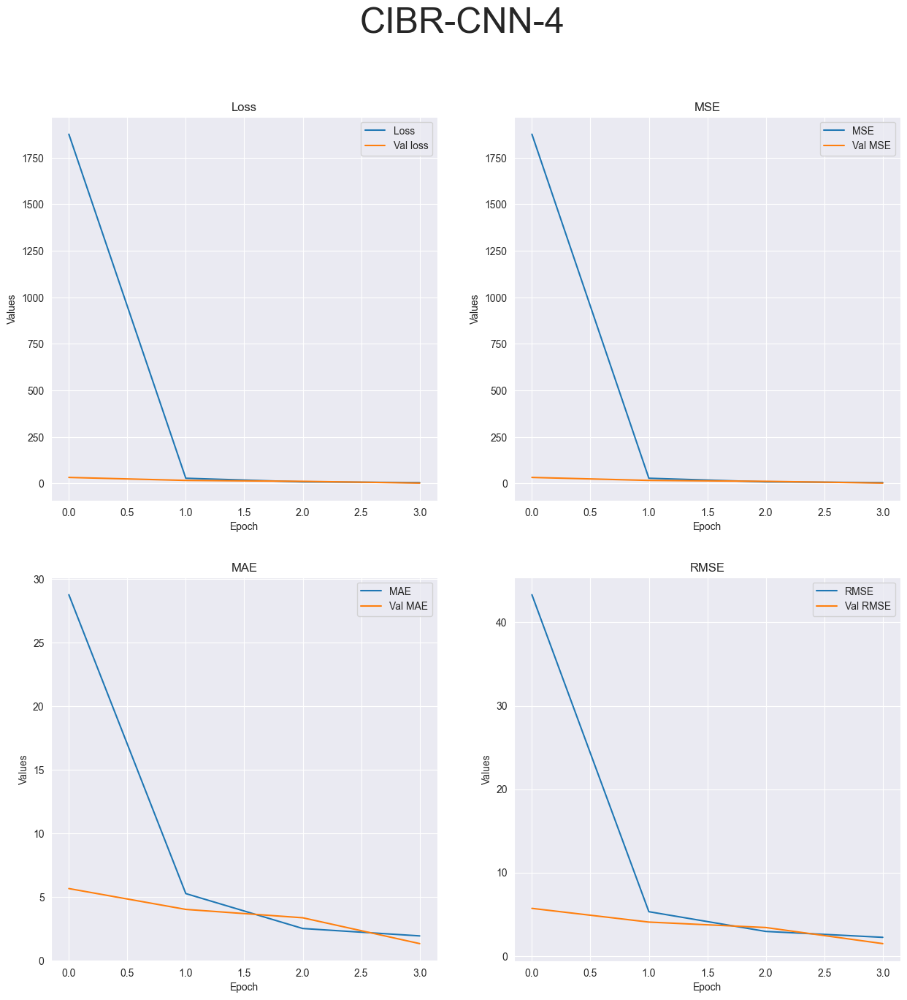

R-squared value: -1.8824


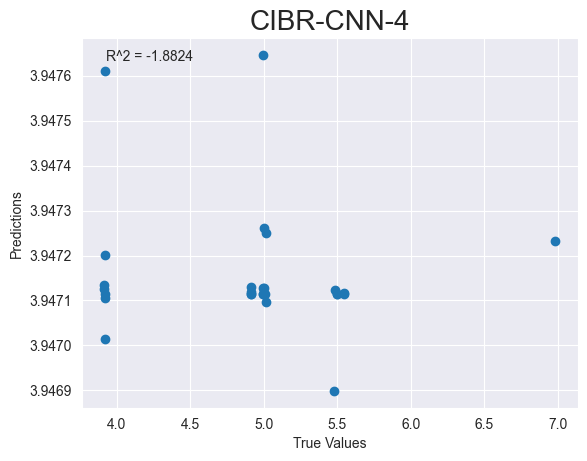

Running RestNet model tests...
Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
CIBR-RestNet-2
Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
CIBR-RestNet-2
Running tests with 1 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
CIBR-RestNet-1
Running tests with 4 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86,

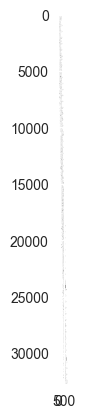

CIBR-DenseNet-2


ValueError: Failed to convert a NumPy array to a Tensor (Unsupported object type numpy.ndarray).

In [56]:
for experiment_name, experiment_data in RawExperiments.items():
    print(f"Running experiments for {experiment_name}...")
    for test_name, test_data in experiment_data["Tests"].items():
        print(f"Running {test_name} tests...")
        for dataset in test_data["Datasets"]:
            print(f"Running tests on {dataset + test_data['Extention']} dataset...")
            for model in test_data["Models"]:
                print(f"Running {model} model tests...")
                if "Epochs" in test_data:
                    for epochs in test_data["Epochs"]:
                        print(f"Running tests with {epochs} epochs...")

                        # Call the function that runs the test with the given dataset, model, and epoch

                        dataframe = None
                        if(test_data["Extention"] == '.pkl'):
                            dataframe = pd.read_pickle(dataset + test_data['Extention'])
                        else:
                            dataframe = pd.read_csv(dataset + test_data['Extention'])
                        test = AutomaticLearning(dataframe, dataset + "-" + model, model)
                        test.buildData()
                        test.buildModel()
                        test.train(epochs)
                        test.plot(experiment_name +'-'+)


In [4]:
import os
import pandas as pd



# Define the function for running a single experiment


def run_experiment(berry_type, experiment_name, dataset_name, data_ext, test_name, model_name, epoch):
    print(f"Running experiment {experiment_name}, dataset {dataset_name}, test {test_name}, model {model_name}, epoch {epoch}")

    #print(dataset_name)
 
    #print("EXTENTION",data_ext)
    dataframe = None
    if(data_ext == '.pkl'):
        dataframe = pd.read_pickle(dataset_name + data_ext)
    else:
        dataframe = pd.read_csv(dataset_name + data_ext)
    test = AutomaticLearning(dataframe, dataset_name + "-" + model_name, model_name)
    #print("no ha tronado")
    test.buildData()
    test.buildModel()
    test.train(epoch)
    test.plot(berry_type + '-' + experiment_name, save = True, show = False)
    result = test.gather_data()
    return result


def run_all_experiments(experiments, results_dict):
    for experiment_name, experiment in experiments.items():
        #print(f"Running experiment: {experiment_name}")
        for berry_type, berry_experiment in experiment.items():
            #print(f"Berry Type: {berry_type}")
            for test_name, test in berry_experiment['Tests'].items():
                #print(f"Test Name: {test_name}")
                for dataset_name in test['Datasets']:
                    #data_ext = test["Extention"]
                    #data_path = os.path.join('data', berry_type, dataset_name + data_ext)
                    #print(f"Dataset Name: {dataset_name}")
                    for model_name in test['Models']:
                        #print(f"Model Name: {model_name}")
                        for epoch in test['Epochs']:
                            #print(f"Epoch: {epoch}")
                            # Run the experiment
                            #folder = "./{berry_type}-{experiment_name}"
                            result = run_experiment(berry_type, experiment_name, dataset_name, test['Extention'], test_name, model_name, epoch)
                            # Store the result
                            if experiment_name not in results_dict:
                                results_dict[experiment_name] = {}
                            if test_name not in results_dict[experiment_name]:
                                results_dict[experiment_name][test_name] = {}
                            if dataset_name not in results_dict[experiment_name][test_name]:
                                results_dict[experiment_name][test_name][dataset_name] = {}
                            if model_name not in results_dict[experiment_name][test_name][dataset_name]:
                                results_dict[experiment_name][test_name][dataset_name][model_name] = {}
                            if epoch not in results_dict[experiment_name][test_name][dataset_name][model_name]:
                                results_dict[experiment_name][test_name][dataset_name][model_name][epoch] = {}
                            results_dict[experiment_name][test_name][dataset_name][model_name][epoch] = result
    return results_dict

    # Save the results





In [9]:
results_machinelearning = run_all_experiments(experimentsMachineLearning, {})
with open("resultsMachineLearning.json", 'w') as f:
    json.dump(results_machinelearning, f)

<Figure size 640x480 with 0 Axes>

In [5]:
experimentsDeepLearningA = {
    "Raw" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBR", "FBR", "CBR", "ABR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRR", "FRR", "CRR", "ARR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGSR", "FSR", "CSR", "ASR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        }
    }
}


experimentsDeepLearningB = {
        "YOLO" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBY", "FBY", "CBY", "ABY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRY", "FRY", "CRY", "ARY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGSY", "FSY", "CSY", "ASY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        }
    }
}


experimentsDeepLearningC = {
    "Detectron2" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBD", "FBD", "CBD", "ABD"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRD", "FRD", "CRD", "ARD"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGSD", "FSD", "CSD", "ASD"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        }
    }
}

In [6]:
results_dict_DL = {}

In [7]:
results_dict_DL = run_all_experiments(experimentsDeepLearningA, results_dict_DL)
with open("resultsDeepLearningA.json", 'w') as f:
    json.dump(results_dict_DL, f)

Running experiment Raw, dataset CGBR, test DeepLearning, model MLP, epoch 100


2023-05-03 10:26:28.696702: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-05-03 10:26:28.697896: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-05-03 10:26:28.986047: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-05-03 10:26:29.266160: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:26:29.707236: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 88ms/step - loss: 18.5496 - mse: 18.5496 - mae: 4.2672 - root_mean_squared_error: 4.3069


2023-05-03 10:26:34.148052: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CGBR, test DeepLearning, model MLP, epoch 500


2023-05-03 10:26:36.068084: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:26:36.529968: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 78ms/step - loss: 85.4472 - mse: 85.4472 - mae: 9.2053 - root_mean_squared_error: 9.2438


2023-05-03 10:26:56.113207: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CGBR, test DeepLearning, model FCNN, epoch 100


2023-05-03 10:26:57.816109: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:26:58.102867: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 82ms/step - loss: 2.5764 - mse: 2.5764 - mae: 1.3141 - root_mean_squared_error: 1.6051


2023-05-03 10:27:01.912359: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CGBR, test DeepLearning, model FCNN, epoch 500


2023-05-03 10:27:03.615020: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:27:03.877594: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 81ms/step - loss: 2.7025 - mse: 2.7025 - mae: 1.3576 - root_mean_squared_error: 1.6439


2023-05-03 10:27:22.472739: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CGBR, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 10:27:24.315175: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:27:24.560209: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 80ms/step - loss: 2.6975 - mse: 2.6626 - mae: 1.2837 - root_mean_squared_error: 1.6317


2023-05-03 10:27:28.188051: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CGBR, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 10:27:29.876533: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:27:30.096297: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 81ms/step - loss: 23.5169 - mse: 23.4815 - mae: 4.8216 - root_mean_squared_error: 4.8458


2023-05-03 10:27:47.178396: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset FBR, test DeepLearning, model MLP, epoch 100


2023-05-03 10:27:48.886923: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:27:49.204573: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 97ms/step - loss: 1.2066 - mse: 1.2066 - mae: 0.9250 - root_mean_squared_error: 1.0985


2023-05-03 10:27:53.811546: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset FBR, test DeepLearning, model MLP, epoch 500


2023-05-03 10:27:56.342129: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:27:56.761549: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 260: early stopping
1/1 [==============================] - 0s 80ms/step - loss: 1.5875 - mse: 1.5875 - mae: 1.1022 - root_mean_squared_error: 1.2600
IM SAVING


2023-05-03 10:28:06.611646: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Running experiment Raw, dataset FBR, test DeepLearning, model FCNN, epoch 100


2023-05-03 10:28:08.253775: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:28:08.607128: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 83ms/step - loss: 0.5587 - mse: 0.5587 - mae: 0.6396 - root_mean_squared_error: 0.7475


2023-05-03 10:28:12.477410: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset FBR, test DeepLearning, model FCNN, epoch 500


2023-05-03 10:28:14.080878: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:28:14.466158: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 83ms/step - loss: 0.5793 - mse: 0.5793 - mae: 0.5658 - root_mean_squared_error: 0.7611


2023-05-03 10:28:32.264552: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset FBR, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 10:28:33.979397: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:28:34.217602: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 87ms/step - loss: 0.6019 - mse: 0.4898 - mae: 0.5412 - root_mean_squared_error: 0.6999


2023-05-03 10:28:38.424009: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset FBR, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 10:28:40.001714: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:28:40.237758: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 89ms/step - loss: 0.4492 - mse: 0.4146 - mae: 0.4271 - root_mean_squared_error: 0.6439


2023-05-03 10:28:57.241354: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CBR, test DeepLearning, model MLP, epoch 100


2023-05-03 10:28:59.289563: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:28:59.678558: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 88ms/step - loss: 4.7455 - mse: 4.7455 - mae: 1.5612 - root_mean_squared_error: 2.1784


2023-05-03 10:29:04.232342: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CBR, test DeepLearning, model MLP, epoch 500


2023-05-03 10:29:05.996188: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:29:06.314063: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 90ms/step - loss: 1.0841 - mse: 1.0841 - mae: 0.9069 - root_mean_squared_error: 1.0412


2023-05-03 10:29:26.292275: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CBR, test DeepLearning, model FCNN, epoch 100


2023-05-03 10:29:28.015563: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:29:28.298083: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 90ms/step - loss: 0.9130 - mse: 0.9130 - mae: 0.7881 - root_mean_squared_error: 0.9555


2023-05-03 10:29:32.179423: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CBR, test DeepLearning, model FCNN, epoch 500


2023-05-03 10:29:33.879626: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:29:34.392892: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 466: early stopping
1/1 [==============================] - 0s 102ms/step - loss: 0.3488 - mse: 0.3488 - mae: 0.4759 - root_mean_squared_error: 0.5906
IM SAVING


2023-05-03 10:29:51.581866: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Running experiment Raw, dataset CBR, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 10:29:53.317280: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:29:53.558075: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 86ms/step - loss: 0.8648 - mse: 0.8097 - mae: 0.6738 - root_mean_squared_error: 0.8998


2023-05-03 10:29:57.164279: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CBR, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 10:29:58.788934: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:29:59.049122: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 105ms/step - loss: 0.6994 - mse: 0.6537 - mae: 0.7598 - root_mean_squared_error: 0.8085


2023-05-03 10:30:16.578280: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset ABR, test DeepLearning, model MLP, epoch 100


2023-05-03 10:30:18.827577: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:30:19.204374: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 90ms/step - loss: 11.0007 - mse: 11.0007 - mae: 3.2024 - root_mean_squared_error: 3.3167


2023-05-03 10:30:23.258909: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset ABR, test DeepLearning, model MLP, epoch 500


2023-05-03 10:30:25.023331: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:30:25.375567: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 259: early stopping
1/1 [==============================] - 0s 99ms/step - loss: 27.3075 - mse: 27.3075 - mae: 5.1935 - root_mean_squared_error: 5.2257


2023-05-03 10:30:35.406790: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset ABR, test DeepLearning, model FCNN, epoch 100


2023-05-03 10:30:37.090847: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:30:37.420871: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 92ms/step - loss: 3.0455 - mse: 3.0455 - mae: 1.4807 - root_mean_squared_error: 1.7451


2023-05-03 10:30:41.323233: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
/var/folders/mk/t6y50d7s2ds93t8l2lw18p_00000gn/T/ipykernel_25246/1183580264.py:151: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows = 2, ncols = 2, figsize = (15,15))


IM SAVING
Running experiment Raw, dataset ABR, test DeepLearning, model FCNN, epoch 500


2023-05-03 10:30:43.336093: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:30:43.704769: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 95ms/step - loss: 1.5974 - mse: 1.5974 - mae: 1.1330 - root_mean_squared_error: 1.2639


2023-05-03 10:31:02.405220: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset ABR, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 10:31:04.069731: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:31:04.398024: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 107ms/step - loss: 2.1718 - mse: 1.9510 - mae: 1.1381 - root_mean_squared_error: 1.3968


2023-05-03 10:31:08.258384: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset ABR, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 10:31:10.113318: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:31:10.389796: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 118ms/step - loss: 1.0187 - mse: 0.7876 - mae: 0.7439 - root_mean_squared_error: 0.8874


2023-05-03 10:31:28.038591: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CGRR, test DeepLearning, model MLP, epoch 100


2023-05-03 10:31:30.025583: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:31:30.551400: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 17ms/step - loss: 4.7122 - mse: 4.7122 - mae: 2.0816 - root_mean_squared_error: 2.1708


2023-05-03 10:31:44.621021: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CGRR, test DeepLearning, model MLP, epoch 500


2023-05-03 10:31:46.534932: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:31:47.055120: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 252: early stopping
5/5 [==============================] - 0s 12ms/step - loss: 3032.4636 - mse: 3032.4636 - mae: 54.4012 - root_mean_squared_error: 55.0678


2023-05-03 10:32:17.875150: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CGRR, test DeepLearning, model FCNN, epoch 100


2023-05-03 10:32:19.874304: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:32:20.318342: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 19ms/step - loss: 0.3572 - mse: 0.3572 - mae: 0.4790 - root_mean_squared_error: 0.5976


2023-05-03 10:32:32.614708: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CGRR, test DeepLearning, model FCNN, epoch 500


2023-05-03 10:32:34.499495: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:32:34.931061: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 18ms/step - loss: 0.4985 - mse: 0.4985 - mae: 0.5367 - root_mean_squared_error: 0.7061


2023-05-03 10:33:34.544165: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CGRR, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 10:33:36.382737: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:33:36.767689: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 16ms/step - loss: 0.3675 - mse: 0.3331 - mae: 0.4380 - root_mean_squared_error: 0.5771


2023-05-03 10:33:47.201559: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CGRR, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 10:33:49.185539: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:33:49.592220: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 15ms/step - loss: 1.9140 - mse: 1.8958 - mae: 1.2500 - root_mean_squared_error: 1.3769


2023-05-03 10:34:41.678474: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset FRR, test DeepLearning, model MLP, epoch 100


2023-05-03 10:34:43.660523: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:34:44.182171: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 16ms/step - loss: 0.6650 - mse: 0.6650 - mae: 0.6901 - root_mean_squared_error: 0.8155


2023-05-03 10:34:56.731350: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset FRR, test DeepLearning, model MLP, epoch 500


2023-05-03 10:34:58.588198: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:34:59.066925: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 15ms/step - loss: 0.6638 - mse: 0.6638 - mae: 0.6476 - root_mean_squared_error: 0.8147


2023-05-03 10:36:02.434034: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset FRR, test DeepLearning, model FCNN, epoch 100


2023-05-03 10:36:04.572512: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:36:05.018086: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 17ms/step - loss: 0.6302 - mse: 0.6302 - mae: 0.6247 - root_mean_squared_error: 0.7938


2023-05-03 10:36:17.055060: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset FRR, test DeepLearning, model FCNN, epoch 500


2023-05-03 10:36:18.928138: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:36:19.462492: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 491: early stopping
1/5 [=====>........................] - ETA: 0s - loss: 1.2089 - mse: 1.2089 - mae: 0.9875 - root_mean_squared_error: 1.0995

2023-05-03 10:37:18.035459: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 16ms/step - loss: 0.7301 - mse: 0.7301 - mae: 0.6686 - root_mean_squared_error: 0.8544
IM SAVING
Running experiment Raw, dataset FRR, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 10:37:19.939359: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:37:20.353136: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 17ms/step - loss: 0.7975 - mse: 0.7602 - mae: 0.7250 - root_mean_squared_error: 0.8719


2023-05-03 10:37:31.088418: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset FRR, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 10:37:33.134717: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:37:33.557822: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 19ms/step - loss: 0.7681 - mse: 0.7649 - mae: 0.7257 - root_mean_squared_error: 0.8746


2023-05-03 10:38:27.231290: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CRR, test DeepLearning, model MLP, epoch 100


2023-05-03 10:38:29.286447: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:38:30.040928: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 18ms/step - loss: 3.5390 - mse: 3.5390 - mae: 1.6650 - root_mean_squared_error: 1.8812


2023-05-03 10:38:43.375960: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CRR, test DeepLearning, model MLP, epoch 500


2023-05-03 10:38:45.242945: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:38:45.952874: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 19ms/step - loss: 0.5480 - mse: 0.5480 - mae: 0.5889 - root_mean_squared_error: 0.7403


2023-05-03 10:39:47.418199: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CRR, test DeepLearning, model FCNN, epoch 100


2023-05-03 10:39:49.297024: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:39:49.772584: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 1.0921 - mse: 1.0921 - mae: 0.8723 - root_mean_squared_error: 1.0450

2023-05-03 10:40:01.922787: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 26ms/step - loss: 0.8815 - mse: 0.8815 - mae: 0.7619 - root_mean_squared_error: 0.9389
IM SAVING
Running experiment Raw, dataset CRR, test DeepLearning, model FCNN, epoch 500


2023-05-03 10:40:03.939895: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:40:04.441543: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 0.7982 - mse: 0.7982 - mae: 0.7380 - root_mean_squared_error: 0.8934

2023-05-03 10:41:07.589136: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 21ms/step - loss: 0.6378 - mse: 0.6378 - mae: 0.6532 - root_mean_squared_error: 0.7986
IM SAVING
Running experiment Raw, dataset CRR, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 10:41:09.588754: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:41:10.317847: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 15ms/step - loss: 0.7235 - mse: 0.6722 - mae: 0.6607 - root_mean_squared_error: 0.8199


2023-05-03 10:41:22.103389: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CRR, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 10:41:24.084938: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:41:24.505520: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 0.8430 - mse: 0.8272 - mae: 0.7376 - root_mean_squared_error: 0.9095

2023-05-03 10:42:15.906308: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 19ms/step - loss: 0.7149 - mse: 0.6991 - mae: 0.6582 - root_mean_squared_error: 0.8361
IM SAVING
Running experiment Raw, dataset ARR, test DeepLearning, model MLP, epoch 100


2023-05-03 10:42:17.988106: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:42:18.715878: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 20ms/step - loss: 3.2674 - mse: 3.2674 - mae: 1.7094 - root_mean_squared_error: 1.8076


2023-05-03 10:42:31.507044: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset ARR, test DeepLearning, model MLP, epoch 500


2023-05-03 10:42:33.678241: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:42:34.345711: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 316: early stopping
1/5 [=====>........................] - ETA: 0s - loss: 1.9352 - mse: 1.9352 - mae: 1.2234 - root_mean_squared_error: 1.3911

2023-05-03 10:43:15.434072: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 21ms/step - loss: 1.7273 - mse: 1.7273 - mae: 1.1640 - root_mean_squared_error: 1.3143
IM SAVING
Running experiment Raw, dataset ARR, test DeepLearning, model FCNN, epoch 100


2023-05-03 10:43:17.477127: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:43:18.088583: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 21ms/step - loss: 0.3764 - mse: 0.3764 - mae: 0.5042 - root_mean_squared_error: 0.6135


2023-05-03 10:43:30.159894: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset ARR, test DeepLearning, model FCNN, epoch 500


2023-05-03 10:43:32.110875: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:43:32.643143: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 0.3354 - mse: 0.3354 - mae: 0.5215 - root_mean_squared_error: 0.5791

2023-05-03 10:44:31.810790: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 26ms/step - loss: 0.3367 - mse: 0.3367 - mae: 0.5260 - root_mean_squared_error: 0.5803
IM SAVING
Running experiment Raw, dataset ARR, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 10:44:33.954043: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:44:34.420989: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 1.8658 - mse: 1.6456 - mae: 1.1003 - root_mean_squared_error: 1.2828

2023-05-03 10:44:45.114614: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 18ms/step - loss: 2.2010 - mse: 1.9808 - mae: 1.2341 - root_mean_squared_error: 1.4074
IM SAVING
Running experiment Raw, dataset ARR, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 10:44:47.009081: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:44:47.452115: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 103.3201 - mse: 103.0711 - mae: 10.0074 - root_mean_squared_error: 10.1524

2023-05-03 10:45:41.090504: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 15ms/step - loss: 111.4573 - mse: 111.2082 - mae: 10.4124 - root_mean_squared_error: 10.5455
IM SAVING
Running experiment Raw, dataset CGSR, test DeepLearning, model MLP, epoch 100


2023-05-03 10:45:43.178659: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:45:43.891303: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 88.6545 - mse: 88.6545 - mae: 8.4160 - root_mean_squared_error: 9.4157

2023-05-03 10:45:55.026885: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 26ms/step - loss: 72.3125 - mse: 72.3125 - mae: 7.6460 - root_mean_squared_error: 8.5037
IM SAVING
Running experiment Raw, dataset CGSR, test DeepLearning, model MLP, epoch 500


2023-05-03 10:45:57.246442: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:45:57.851233: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 259: early stopping
1/4 [======>.......................] - ETA: 0s - loss: 65.6810 - mse: 65.6810 - mae: 7.1378 - root_mean_squared_error: 8.1044

2023-05-03 10:46:22.329381: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 23ms/step - loss: 62.1515 - mse: 62.1515 - mae: 6.8703 - root_mean_squared_error: 7.8836
IM SAVING
Running experiment Raw, dataset CGSR, test DeepLearning, model FCNN, epoch 100


2023-05-03 10:46:24.391775: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:46:24.955882: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 4.1875 - mse: 4.1875 - mae: 1.5865 - root_mean_squared_error: 2.0463

2023-05-03 10:46:34.377399: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 42ms/step - loss: 3.4952 - mse: 3.4952 - mae: 1.4766 - root_mean_squared_error: 1.8695
IM SAVING
Running experiment Raw, dataset CGSR, test DeepLearning, model FCNN, epoch 500


2023-05-03 10:46:36.626545: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:46:37.481871: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 461.0219 - mse: 461.0219 - mae: 20.7874 - root_mean_squared_error: 21.4714

2023-05-03 10:47:21.617436: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 27ms/step - loss: 447.4339 - mse: 447.4339 - mae: 20.6263 - root_mean_squared_error: 21.1526
IM SAVING
Running experiment Raw, dataset CGSR, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 10:47:23.701667: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:47:24.211167: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 24ms/step - loss: 369.4060 - mse: 369.3686 - mae: 17.8113 - root_mean_squared_error: 19.2190


2023-05-03 10:47:32.355942: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Raw, dataset CGSR, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 10:47:34.259505: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:47:34.735879: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 47.4310 - mse: 47.4024 - mae: 5.5585 - root_mean_squared_error: 6.8849

2023-05-03 10:48:13.603934: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 30ms/step - loss: 41.6716 - mse: 41.6431 - mae: 5.5351 - root_mean_squared_error: 6.4531
IM SAVING
Running experiment Raw, dataset FSR, test DeepLearning, model MLP, epoch 100


2023-05-03 10:48:15.600490: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:48:16.219551: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 109.7134 - mse: 109.7134 - mae: 8.3453 - root_mean_squared_error: 10.4744

2023-05-03 10:48:25.825931: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 28ms/step - loss: 85.5766 - mse: 85.5766 - mae: 7.3594 - root_mean_squared_error: 9.2508
IM SAVING
Running experiment Raw, dataset FSR, test DeepLearning, model MLP, epoch 500


2023-05-03 10:48:27.943263: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:48:28.583979: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 253: early stopping
1/4 [======>.......................] - ETA: 0s - loss: 87.5968 - mse: 87.5968 - mae: 7.2750 - root_mean_squared_error: 9.3593

2023-05-03 10:48:51.925205: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 24ms/step - loss: 91.8480 - mse: 91.8480 - mae: 7.1169 - root_mean_squared_error: 9.5837
IM SAVING
Running experiment Raw, dataset FSR, test DeepLearning, model FCNN, epoch 100


2023-05-03 10:48:54.039604: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:48:54.564361: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 91.4357 - mse: 91.4357 - mae: 7.5983 - root_mean_squared_error: 9.5622

2023-05-03 10:49:04.010134: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 30ms/step - loss: 65.2679 - mse: 65.2679 - mae: 6.3684 - root_mean_squared_error: 8.0789
IM SAVING
Running experiment Raw, dataset FSR, test DeepLearning, model FCNN, epoch 500


2023-05-03 10:49:06.053565: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:49:06.614146: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 54.1700 - mse: 54.1700 - mae: 5.3303 - root_mean_squared_error: 7.3600

2023-05-03 10:49:51.423751: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 32ms/step - loss: 83.6032 - mse: 83.6032 - mae: 6.5813 - root_mean_squared_error: 9.1435
IM SAVING
Running experiment Raw, dataset FSR, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 10:49:53.528157: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:49:53.970521: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 43.6998 - mse: 43.4201 - mae: 4.7360 - root_mean_squared_error: 6.5894

2023-05-03 10:50:02.187325: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 29ms/step - loss: 60.8132 - mse: 60.5336 - mae: 6.0817 - root_mean_squared_error: 7.7803
IM SAVING
Running experiment Raw, dataset FSR, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 10:50:04.264198: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:50:04.788119: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 483: early stopping


2023-05-03 10:50:42.883228: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 25ms/step - loss: 87.7593 - mse: 87.4259 - mae: 7.5291 - root_mean_squared_error: 9.3502
IM SAVING
Running experiment Raw, dataset CSR, test DeepLearning, model MLP, epoch 100


2023-05-03 10:50:45.057799: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:50:46.250336: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 124.9546 - mse: 124.9546 - mae: 8.1671 - root_mean_squared_error: 11.1783

2023-05-03 10:50:57.299505: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 26ms/step - loss: 92.9348 - mse: 92.9348 - mae: 6.9522 - root_mean_squared_error: 9.6403
IM SAVING
Running experiment Raw, dataset CSR, test DeepLearning, model MLP, epoch 500


2023-05-03 10:50:59.521733: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:51:00.162509: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 91.9271 - mse: 91.9271 - mae: 6.5846 - root_mean_squared_error: 9.5879

2023-05-03 10:51:46.282816: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 31ms/step - loss: 80.9722 - mse: 80.9722 - mae: 6.1895 - root_mean_squared_error: 8.9985
IM SAVING
Running experiment Raw, dataset CSR, test DeepLearning, model FCNN, epoch 100


2023-05-03 10:51:48.491234: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:51:49.074208: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 62.2133 - mse: 62.2133 - mae: 6.6395 - root_mean_squared_error: 7.8875

2023-05-03 10:51:58.831156: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 33ms/step - loss: 88.1469 - mse: 88.1469 - mae: 7.3151 - root_mean_squared_error: 9.3887
IM SAVING
Running experiment Raw, dataset CSR, test DeepLearning, model FCNN, epoch 500


2023-05-03 10:52:00.942627: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:52:01.499310: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 492: early stopping
1/4 [======>.......................] - ETA: 0s - loss: 57.4794 - mse: 57.4794 - mae: 5.6991 - root_mean_squared_error: 7.5815

2023-05-03 10:52:45.706968: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 30ms/step - loss: 66.1868 - mse: 66.1868 - mae: 6.2219 - root_mean_squared_error: 8.1355
IM SAVING
Running experiment Raw, dataset CSR, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 10:52:47.974731: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:52:48.455777: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 111.6618 - mse: 111.5850 - mae: 8.2033 - root_mean_squared_error: 10.5634

2023-05-03 10:52:56.545561: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 38ms/step - loss: 87.5038 - mse: 87.4271 - mae: 6.9436 - root_mean_squared_error: 9.3502
IM SAVING
Running experiment Raw, dataset CSR, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 10:52:58.585425: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:52:59.088903: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 74.4634 - mse: 74.4319 - mae: 7.0334 - root_mean_squared_error: 8.6274

2023-05-03 10:53:39.167934: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 35ms/step - loss: 72.8008 - mse: 72.7694 - mae: 6.6874 - root_mean_squared_error: 8.5305
IM SAVING
Running experiment Raw, dataset ASR, test DeepLearning, model MLP, epoch 100


2023-05-03 10:53:41.292219: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:53:42.070420: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 273.3683 - mse: 273.3683 - mae: 15.7427 - root_mean_squared_error: 16.5339

2023-05-03 10:53:52.767123: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 32ms/step - loss: 273.2352 - mse: 273.2352 - mae: 15.7870 - root_mean_squared_error: 16.5298
IM SAVING
Running experiment Raw, dataset ASR, test DeepLearning, model MLP, epoch 500


2023-05-03 10:53:54.987643: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:53:55.651606: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 258: early stopping
1/4 [======>.......................] - ETA: 0s - loss: 173.5942 - mse: 173.5942 - mae: 12.2664 - root_mean_squared_error: 13.1755

2023-05-03 10:54:19.591043: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 27ms/step - loss: 181.4677 - mse: 181.4677 - mae: 12.4280 - root_mean_squared_error: 13.4710
IM SAVING
Running experiment Raw, dataset ASR, test DeepLearning, model FCNN, epoch 100


2023-05-03 10:54:21.736236: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:54:22.300674: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 2.9465 - mse: 2.9465 - mae: 1.3023 - root_mean_squared_error: 1.7165

2023-05-03 10:54:31.626807: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 47ms/step - loss: 3.8460 - mse: 3.8460 - mae: 1.4929 - root_mean_squared_error: 1.9611
IM SAVING
Running experiment Raw, dataset ASR, test DeepLearning, model FCNN, epoch 500


2023-05-03 10:54:33.723633: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:54:34.523650: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:55:20.020774: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 63ms/step - loss: 78.1383 - mse: 78.1383 - mae: 6.9092 - root_mean_squared_error: 8.8396
IM SAVING
Running experiment Raw, dataset ASR, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 10:55:22.826151: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:55:23.436785: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 64.1961 - mse: 63.9716 - mae: 7.4700 - root_mean_squared_error: 7.9982

2023-05-03 10:55:32.905295: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 36ms/step - loss: 79.4488 - mse: 79.2243 - mae: 8.2346 - root_mean_squared_error: 8.9008
IM SAVING
Running experiment Raw, dataset ASR, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 10:55:35.531980: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 10:55:36.060590: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 17.8868 - mse: 17.5698 - mae: 3.1428 - root_mean_squared_error: 4.1916

2023-05-03 10:56:20.000053: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 24ms/step - loss: 13.6605 - mse: 13.3434 - mae: 2.6603 - root_mean_squared_error: 3.6529
IM SAVING


<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

In [6]:
#PROVISIONAL

results_dict_DL = {}
with open('resultsDeepLearningA.json') as json_file:
    results_dict_DL = json.load(json_file)

print(results_dict_DL)

{'Raw': {'DeepLearning': {'CGBR': {'MLP': {'100': {'r2': -64.701839859492, 'loss': 18.549575805664062, 'mse': 18.549575805664062, 'mae': 4.2672224044799805, 'rmse': 4.30692195892334}, '500': {'r2': -119.53302798603754, 'loss': 85.44715881347656, 'mse': 85.44715881347656, 'mae': 9.205338478088379, 'rmse': 9.243762969970703}}, 'FCNN': {'100': {'r2': -5.38604791020252, 'loss': 2.576350450515747, 'mse': 2.576350450515747, 'mae': 1.3141248226165771, 'rmse': 1.6051013469696045}, '500': {'r2': -4.810571955260061, 'loss': 2.7025272846221924, 'mse': 2.7025272846221924, 'mae': 1.357565999031067, 'rmse': 1.6439365148544312}}, 'DeepSVM': {'100': {'r2': -4.055664748611606, 'loss': 2.6975085735321045, 'mse': 2.6625924110412598, 'mae': 1.2837483882904053, 'rmse': 1.6317452192306519}, '500': {'r2': -66.04184856391224, 'loss': 23.51694679260254, 'mse': 23.481536865234375, 'mae': 4.821601867675781, 'rmse': 4.845775127410889}}}, 'FBR': {'MLP': {'100': {'r2': -1.893789621843018, 'loss': 1.2066375017166138

In [7]:
results_dict_DLB = results_dict_DL.copy()

In [8]:
results_dict_DLB = run_all_experiments(experimentsDeepLearningB, results_dict_DLB)
with open("resultsDeepLearningB.json", 'w') as f:
    json.dump(results_dict_DLB, f)
with open("resultsDeepLearningAB.json", 'w') as f:
    json.dump(results_dict_DLB, f)

Running experiment YOLO, dataset CGBY, test DeepLearning, model MLP, epoch 100


2023-05-03 12:34:29.344545: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-05-03 12:34:29.344692: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-05-03 12:34:29.549341: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-05-03 12:34:29.813518: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:34:30.250754: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 92ms/step - loss: 39.4755 - mse: 39.4755 - mae: 6.2799 - root_mean_squared_error: 6.2830


2023-05-03 12:34:34.426285: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CGBY, test DeepLearning, model MLP, epoch 500


2023-05-03 12:34:36.564929: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:34:36.911041: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 95ms/step - loss: 73.8817 - mse: 73.8817 - mae: 8.5788 - root_mean_squared_error: 8.5954


2023-05-03 12:34:55.986857: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CGBY, test DeepLearning, model FCNN, epoch 100


2023-05-03 12:34:58.117973: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:34:58.434289: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 86ms/step - loss: 3.2324 - mse: 3.2324 - mae: 1.4415 - root_mean_squared_error: 1.7979


2023-05-03 12:35:02.870004: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CGBY, test DeepLearning, model FCNN, epoch 500


2023-05-03 12:35:04.705903: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:35:05.014740: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 88ms/step - loss: 2.5923 - mse: 2.5923 - mae: 1.3348 - root_mean_squared_error: 1.6100


2023-05-03 12:35:25.037230: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CGBY, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 12:35:27.081966: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:35:27.363830: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 139ms/step - loss: 3.1184 - mse: 3.0801 - mae: 1.4388 - root_mean_squared_error: 1.7550


2023-05-03 12:35:32.387488: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CGBY, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 12:35:34.390867: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:35:34.752902: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 80ms/step - loss: 149.2048 - mse: 149.1653 - mae: 12.1163 - root_mean_squared_error: 12.2133


2023-05-03 12:35:51.915547: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset FBY, test DeepLearning, model MLP, epoch 100


2023-05-03 12:35:53.780335: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:35:54.104184: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 84ms/step - loss: 4.7006 - mse: 4.7006 - mae: 1.8328 - root_mean_squared_error: 2.1681


2023-05-03 12:35:58.182786: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset FBY, test DeepLearning, model MLP, epoch 500


2023-05-03 12:36:00.135860: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:36:00.529275: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 285: early stopping
1/1 [==============================] - 0s 137ms/step - loss: 1.0336 - mse: 1.0336 - mae: 0.7483 - root_mean_squared_error: 1.0167


2023-05-03 12:36:12.045310: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset FBY, test DeepLearning, model FCNN, epoch 100


2023-05-03 12:36:13.903343: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:36:14.186608: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 96ms/step - loss: 1.3038 - mse: 1.3038 - mae: 0.8323 - root_mean_squared_error: 1.1418


2023-05-03 12:36:18.241729: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset FBY, test DeepLearning, model FCNN, epoch 500


2023-05-03 12:36:20.288262: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:36:20.674474: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 261: early stopping
1/1 [==============================] - 0s 101ms/step - loss: 1.1080 - mse: 1.1080 - mae: 0.9005 - root_mean_squared_error: 1.0526
IM SAVING


2023-05-03 12:36:30.660121: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Running experiment YOLO, dataset FBY, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 12:36:32.509496: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:36:32.798589: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 89ms/step - loss: 1.2397 - mse: 1.1307 - mae: 0.7992 - root_mean_squared_error: 1.0633


2023-05-03 12:36:36.598377: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset FBY, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 12:36:38.612092: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:36:38.931033: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 93ms/step - loss: 0.7232 - mse: 0.6563 - mae: 0.6463 - root_mean_squared_error: 0.8102


2023-05-03 12:36:57.058005: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CBY, test DeepLearning, model MLP, epoch 100


2023-05-03 12:36:59.043740: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:36:59.399230: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 88ms/step - loss: 2.3883 - mse: 2.3883 - mae: 1.2773 - root_mean_squared_error: 1.5454


2023-05-03 12:37:03.493404: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CBY, test DeepLearning, model MLP, epoch 500


2023-05-03 12:37:05.338619: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:37:05.691506: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 87ms/step - loss: 4.2286 - mse: 4.2286 - mae: 1.8975 - root_mean_squared_error: 2.0564


2023-05-03 12:37:24.932635: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CBY, test DeepLearning, model FCNN, epoch 100


2023-05-03 12:37:26.993297: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:37:27.307685: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 92ms/step - loss: 1.3970 - mse: 1.3970 - mae: 0.9752 - root_mean_squared_error: 1.1819


2023-05-03 12:37:31.405930: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CBY, test DeepLearning, model FCNN, epoch 500


2023-05-03 12:37:33.403026: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:37:33.750771: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 94ms/step - loss: 8.2332 - mse: 8.2332 - mae: 0.9980 - root_mean_squared_error: 2.8694


2023-05-03 12:37:52.318004: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CBY, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 12:37:54.028198: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:37:54.309314: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 91ms/step - loss: 33.5883 - mse: 33.5372 - mae: 2.2284 - root_mean_squared_error: 5.7911


2023-05-03 12:37:58.129436: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CBY, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 12:38:00.196393: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:38:00.470133: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 90ms/step - loss: 1.1964 - mse: 1.1538 - mae: 0.9688 - root_mean_squared_error: 1.0741


2023-05-03 12:38:17.862590: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset ABY, test DeepLearning, model MLP, epoch 100


2023-05-03 12:38:19.694476: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:38:20.045710: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 93ms/step - loss: 244.9176 - mse: 244.9176 - mae: 15.5129 - root_mean_squared_error: 15.6498


2023-05-03 12:38:24.216688: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset ABY, test DeepLearning, model MLP, epoch 500


2023-05-03 12:38:26.133389: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:38:26.554611: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 251: early stopping
1/1 [==============================] - 0s 114ms/step - loss: 2172.5544 - mse: 2172.5544 - mae: 44.4391 - root_mean_squared_error: 46.6107


2023-05-03 12:38:36.725833: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset ABY, test DeepLearning, model FCNN, epoch 100


2023-05-03 12:38:38.738767: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:38:39.051812: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 120ms/step - loss: 3.4393 - mse: 3.4393 - mae: 1.5571 - root_mean_squared_error: 1.8545


2023-05-03 12:38:43.154225: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
/var/folders/mk/t6y50d7s2ds93t8l2lw18p_00000gn/T/ipykernel_27243/1183580264.py:151: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows = 2, ncols = 2, figsize = (15,15))


IM SAVING
Running experiment YOLO, dataset ABY, test DeepLearning, model FCNN, epoch 500


2023-05-03 12:38:45.283696: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:38:45.695519: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 100ms/step - loss: 2.7643 - mse: 2.7643 - mae: 1.4498 - root_mean_squared_error: 1.6626


2023-05-03 12:39:04.806696: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset ABY, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 12:39:06.673950: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:39:06.958393: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 104ms/step - loss: 5.0162 - mse: 4.7792 - mae: 1.7560 - root_mean_squared_error: 2.1861


2023-05-03 12:39:10.844225: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset ABY, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 12:39:12.852765: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:39:13.149015: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 99ms/step - loss: 1.2870 - mse: 1.0534 - mae: 0.8461 - root_mean_squared_error: 1.0264


2023-05-03 12:39:30.372510: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CGRY, test DeepLearning, model MLP, epoch 100


2023-05-03 12:39:32.105489: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:39:32.647550: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 15ms/step - loss: 21.6047 - mse: 21.6047 - mae: 4.5690 - root_mean_squared_error: 4.6481


2023-05-03 12:39:45.353601: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CGRY, test DeepLearning, model MLP, epoch 500


2023-05-03 12:39:47.361719: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:39:47.837079: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 253: early stopping
5/5 [==============================] - 0s 16ms/step - loss: 8.9850 - mse: 8.9850 - mae: 2.9021 - root_mean_squared_error: 2.9975


2023-05-03 12:40:19.918017: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CGRY, test DeepLearning, model FCNN, epoch 100


2023-05-03 12:40:21.806736: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:40:22.264076: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 18ms/step - loss: 0.3195 - mse: 0.3195 - mae: 0.4556 - root_mean_squared_error: 0.5652


2023-05-03 12:40:35.401872: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CGRY, test DeepLearning, model FCNN, epoch 500


2023-05-03 12:40:37.482797: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:40:38.007901: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 20ms/step - loss: 0.2904 - mse: 0.2904 - mae: 0.4142 - root_mean_squared_error: 0.5389


2023-05-03 12:41:37.582535: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CGRY, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 12:41:39.764967: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:41:40.184131: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 16ms/step - loss: 0.3802 - mse: 0.3459 - mae: 0.5358 - root_mean_squared_error: 0.5881


2023-05-03 12:41:51.116028: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CGRY, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 12:41:53.013383: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:41:53.412106: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 19ms/step - loss: 16.5965 - mse: 16.5775 - mae: 3.9668 - root_mean_squared_error: 4.0716


2023-05-03 12:42:46.359765: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset FRY, test DeepLearning, model MLP, epoch 100


2023-05-03 12:42:48.210777: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:42:48.765084: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 20ms/step - loss: 0.8542 - mse: 0.8542 - mae: 0.7541 - root_mean_squared_error: 0.9242


2023-05-03 12:43:01.793036: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset FRY, test DeepLearning, model MLP, epoch 500


2023-05-03 12:43:03.953452: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:43:04.537584: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 23ms/step - loss: 0.6462 - mse: 0.6462 - mae: 0.6372 - root_mean_squared_error: 0.8039


2023-05-03 12:44:10.074778: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset FRY, test DeepLearning, model FCNN, epoch 100


2023-05-03 12:44:12.068221: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:44:13.083374: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 19ms/step - loss: 0.6024 - mse: 0.6024 - mae: 0.5993 - root_mean_squared_error: 0.7761


2023-05-03 12:44:25.912645: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset FRY, test DeepLearning, model FCNN, epoch 500


2023-05-03 12:44:27.778382: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:44:28.227335: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 352: early stopping
5/5 [==============================] - 0s 15ms/step - loss: 0.6706 - mse: 0.6706 - mae: 0.6581 - root_mean_squared_error: 0.8189


2023-05-03 12:45:10.034301: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset FRY, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 12:45:12.678499: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:45:13.775138: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 0.9596 - mse: 0.9192 - mae: 0.7603 - root_mean_squared_error: 0.9587

2023-05-03 12:45:27.793292: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 20ms/step - loss: 0.8160 - mse: 0.7755 - mae: 0.7092 - root_mean_squared_error: 0.8806
IM SAVING
Running experiment YOLO, dataset FRY, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 12:45:29.927778: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:45:30.358318: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 16ms/step - loss: 0.6253 - mse: 0.6213 - mae: 0.6355 - root_mean_squared_error: 0.7882


2023-05-03 12:46:23.959856: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CRY, test DeepLearning, model MLP, epoch 100


2023-05-03 12:46:25.741322: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:46:26.254041: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 15ms/step - loss: 0.7893 - mse: 0.7893 - mae: 0.7493 - root_mean_squared_error: 0.8884


2023-05-03 12:46:38.793782: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CRY, test DeepLearning, model MLP, epoch 500


2023-05-03 12:46:40.870955: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:46:41.371219: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 252: early stopping
5/5 [==============================] - 0s 13ms/step - loss: 1.1410 - mse: 1.1410 - mae: 0.9288 - root_mean_squared_error: 1.0682


2023-05-03 12:47:11.981858: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CRY, test DeepLearning, model FCNN, epoch 100


2023-05-03 12:47:13.766764: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:47:14.197145: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 15ms/step - loss: 0.7794 - mse: 0.7794 - mae: 0.7612 - root_mean_squared_error: 0.8828


2023-05-03 12:47:26.040648: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CRY, test DeepLearning, model FCNN, epoch 500


2023-05-03 12:47:28.002411: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:47:28.443659: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 474: early stopping
1/5 [=====>........................] - ETA: 0s - loss: 0.5252 - mse: 0.5252 - mae: 0.5631 - root_mean_squared_error: 0.7247

2023-05-03 12:48:29.069544: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 14ms/step - loss: 0.7545 - mse: 0.7545 - mae: 0.7080 - root_mean_squared_error: 0.8686
IM SAVING
Running experiment YOLO, dataset CRY, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 12:48:30.911595: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:48:31.346311: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 16ms/step - loss: 0.8906 - mse: 0.8427 - mae: 0.7531 - root_mean_squared_error: 0.9180


2023-05-03 12:48:47.250129: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CRY, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 12:48:49.567966: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:48:50.053641: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 18ms/step - loss: 0.7495 - mse: 0.7365 - mae: 0.6598 - root_mean_squared_error: 0.8582


2023-05-03 12:49:49.135008: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset ARY, test DeepLearning, model MLP, epoch 100


2023-05-03 12:49:51.456223: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:49:52.158121: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 24.7989 - mse: 24.7989 - mae: 4.9291 - root_mean_squared_error: 4.9799

2023-05-03 12:50:06.756425: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 19ms/step - loss: 24.3425 - mse: 24.3425 - mae: 4.8901 - root_mean_squared_error: 4.9338
IM SAVING
Running experiment YOLO, dataset ARY, test DeepLearning, model MLP, epoch 500


2023-05-03 12:50:08.744531: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:50:09.460422: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 313: early stopping
1/5 [=====>........................] - ETA: 0s - loss: 2.9513 - mse: 2.9513 - mae: 1.6113 - root_mean_squared_error: 1.7179

2023-05-03 12:50:52.421405: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 24ms/step - loss: 2.7738 - mse: 2.7738 - mae: 1.5701 - root_mean_squared_error: 1.6655
IM SAVING
Running experiment YOLO, dataset ARY, test DeepLearning, model FCNN, epoch 100


2023-05-03 12:50:54.524894: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:50:55.268828: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 6.8928 - mse: 6.8928 - mae: 2.5026 - root_mean_squared_error: 2.6254

2023-05-03 12:51:09.193391: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 31ms/step - loss: 6.8071 - mse: 6.8071 - mae: 2.4776 - root_mean_squared_error: 2.6090
IM SAVING
Running experiment YOLO, dataset ARY, test DeepLearning, model FCNN, epoch 500


2023-05-03 12:51:12.063126: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:51:12.728128: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 0.6018 - mse: 0.6018 - mae: 0.6493 - root_mean_squared_error: 0.7758

2023-05-03 12:52:20.362156: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 40ms/step - loss: 0.7820 - mse: 0.7820 - mae: 0.7326 - root_mean_squared_error: 0.8843
IM SAVING
Running experiment YOLO, dataset ARY, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 12:52:22.716258: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:52:23.510338: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 16ms/step - loss: 0.5789 - mse: 0.3469 - mae: 0.4498 - root_mean_squared_error: 0.5890


2023-05-03 12:52:35.942709: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset ARY, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 12:52:38.058176: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:52:38.637753: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 0.9055 - mse: 0.6611 - mae: 0.6937 - root_mean_squared_error: 0.8131

2023-05-03 12:53:36.489773: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 14ms/step - loss: 0.8431 - mse: 0.5987 - mae: 0.6684 - root_mean_squared_error: 0.7738
IM SAVING
Running experiment YOLO, dataset CGSY, test DeepLearning, model MLP, epoch 100


2023-05-03 12:53:38.921717: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:53:39.636341: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 656.6483 - mse: 656.6483 - mae: 24.5245 - root_mean_squared_error: 25.6251

2023-05-03 12:53:49.916079: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 26ms/step - loss: 764.1637 - mse: 764.1637 - mae: 26.0534 - root_mean_squared_error: 27.6435
IM SAVING
Running experiment YOLO, dataset CGSY, test DeepLearning, model MLP, epoch 500


2023-05-03 12:53:51.922242: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:53:52.598244: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:54:45.600357: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 32ms/step - loss: 25.1034 - mse: 25.1034 - mae: 4.0346 - root_mean_squared_error: 5.0103
IM SAVING
Running experiment YOLO, dataset CGSY, test DeepLearning, model FCNN, epoch 100


2023-05-03 12:54:48.361340: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:54:49.073917: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 3.0964 - mse: 3.0964 - mae: 1.3854 - root_mean_squared_error: 1.7597

2023-05-03 12:55:00.870129: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 36ms/step - loss: 5.3373 - mse: 5.3373 - mae: 1.6256 - root_mean_squared_error: 2.3103
IM SAVING
Running experiment YOLO, dataset CGSY, test DeepLearning, model FCNN, epoch 500


2023-05-03 12:55:03.435540: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:55:04.110205: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:56:01.483434: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 29ms/step - loss: 3.8719 - mse: 3.8719 - mae: 1.5470 - root_mean_squared_error: 1.9677
IM SAVING
Running experiment YOLO, dataset CGSY, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 12:56:04.113602: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:56:04.731334: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 31.0998 - mse: 31.0643 - mae: 5.1569 - root_mean_squared_error: 5.5735

2023-05-03 12:56:14.361394: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 37ms/step - loss: 26.6385 - mse: 26.6029 - mae: 4.7629 - root_mean_squared_error: 5.1578
IM SAVING
Running experiment YOLO, dataset CGSY, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 12:56:17.299859: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:56:17.884425: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 324: early stopping
4/4 [==============================] - 0s 19ms/step - loss: 75032.1719 - mse: 75032.1406 - mae: 263.5320 - root_mean_squared_error: 273.9200


2023-05-03 12:56:46.720516: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset FSY, test DeepLearning, model MLP, epoch 100


2023-05-03 12:56:49.186986: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:56:49.854525: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 23ms/step - loss: 75.0859 - mse: 75.0859 - mae: 7.0304 - root_mean_squared_error: 8.6652


2023-05-03 12:56:59.552383: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset FSY, test DeepLearning, model MLP, epoch 500


2023-05-03 12:57:02.009072: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:57:02.746993: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 16ms/step - loss: 90.9716 - mse: 90.9716 - mae: 7.5353 - root_mean_squared_error: 9.5379


2023-05-03 12:57:50.295980: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset FSY, test DeepLearning, model FCNN, epoch 100


2023-05-03 12:57:52.461291: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:57:53.368969: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 121.0151 - mse: 121.0151 - mae: 8.5284 - root_mean_squared_error: 11.0007

2023-05-03 12:58:03.315940: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 45ms/step - loss: 68.6333 - mse: 68.6333 - mae: 6.3223 - root_mean_squared_error: 8.2845
IM SAVING
Running experiment YOLO, dataset FSY, test DeepLearning, model FCNN, epoch 500


2023-05-03 12:58:11.391783: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:58:13.374179: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 62.3856 - mse: 62.3856 - mae: 6.3560 - root_mean_squared_error: 7.8985

2023-05-03 12:59:07.143071: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 26ms/step - loss: 72.6988 - mse: 72.6988 - mae: 6.7113 - root_mean_squared_error: 8.5264
IM SAVING
Running experiment YOLO, dataset FSY, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 12:59:09.286687: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:59:09.989164: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 95.3557 - mse: 95.1323 - mae: 7.4217 - root_mean_squared_error: 9.7536

2023-05-03 12:59:19.547870: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 24ms/step - loss: 68.1275 - mse: 67.9041 - mae: 6.2824 - root_mean_squared_error: 8.2404
IM SAVING
Running experiment YOLO, dataset FSY, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 12:59:21.623865: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 12:59:22.841913: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 52.9970 - mse: 52.6402 - mae: 5.9023 - root_mean_squared_error: 7.2554

2023-05-03 13:00:03.336299: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 29ms/step - loss: 57.0205 - mse: 56.6636 - mae: 5.9374 - root_mean_squared_error: 7.5275
IM SAVING
Running experiment YOLO, dataset CSY, test DeepLearning, model MLP, epoch 100


2023-05-03 13:00:05.402837: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:00:06.246819: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 193.3646 - mse: 193.3646 - mae: 10.5608 - root_mean_squared_error: 13.9056

2023-05-03 13:00:16.056742: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 28ms/step - loss: 113.0188 - mse: 113.0188 - mae: 8.1009 - root_mean_squared_error: 10.6310
IM SAVING
Running experiment YOLO, dataset CSY, test DeepLearning, model MLP, epoch 500


2023-05-03 13:00:17.965097: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:00:18.626292: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 58.4090 - mse: 58.4090 - mae: 5.2025 - root_mean_squared_error: 7.6426

2023-05-03 13:01:06.832314: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 24ms/step - loss: 53.6031 - mse: 53.6031 - mae: 5.5181 - root_mean_squared_error: 7.3214
IM SAVING
Running experiment YOLO, dataset CSY, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:01:09.178052: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:01:09.762632: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 100.3413 - mse: 100.3413 - mae: 7.4140 - root_mean_squared_error: 10.0170

2023-05-03 13:01:21.799145: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 35ms/step - loss: 87.3499 - mse: 87.3499 - mae: 6.9324 - root_mean_squared_error: 9.3461
IM SAVING
Running experiment YOLO, dataset CSY, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:01:24.900209: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:01:25.731738: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 82.8248 - mse: 82.8248 - mae: 7.6211 - root_mean_squared_error: 9.1008

2023-05-03 13:02:17.065794: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 47ms/step - loss: 87.0563 - mse: 87.0563 - mae: 7.7464 - root_mean_squared_error: 9.3304
IM SAVING
Running experiment YOLO, dataset CSY, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:02:19.497660: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:02:20.378231: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 117.8992 - mse: 117.8232 - mae: 8.1191 - root_mean_squared_error: 10.8546

2023-05-03 13:02:29.945407: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 21ms/step - loss: 81.4204 - mse: 81.3444 - mae: 6.6700 - root_mean_squared_error: 9.0191
IM SAVING
Running experiment YOLO, dataset CSY, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:02:32.106087: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:02:32.498065: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:03:12.057439: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 41ms/step - loss: 66.8576 - mse: 66.8268 - mae: 6.1548 - root_mean_squared_error: 8.1748
IM SAVING
Running experiment YOLO, dataset ASY, test DeepLearning, model MLP, epoch 100


2023-05-03 13:03:14.245993: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:03:15.046981: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 256.0859 - mse: 256.0859 - mae: 14.5541 - root_mean_squared_error: 16.0027

2023-05-03 13:03:24.818933: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 30ms/step - loss: 229.2259 - mse: 229.2259 - mae: 13.9190 - root_mean_squared_error: 15.1402
IM SAVING
Running experiment YOLO, dataset ASY, test DeepLearning, model MLP, epoch 500


2023-05-03 13:03:26.940426: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:03:27.571869: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 259: early stopping
1/4 [======>.......................] - ETA: 0s - loss: 2055.4717 - mse: 2055.4717 - mae: 43.7696 - root_mean_squared_error: 45.3373

2023-05-03 13:03:53.000294: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 27ms/step - loss: 1978.9557 - mse: 1978.9557 - mae: 43.1532 - root_mean_squared_error: 44.4855
IM SAVING
Running experiment YOLO, dataset ASY, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:03:55.466787: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:03:56.196798: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 623.9115 - mse: 623.9115 - mae: 22.8827 - root_mean_squared_error: 24.9782

2023-05-03 13:04:05.565860: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 30ms/step - loss: 527.9091 - mse: 527.9091 - mae: 21.0748 - root_mean_squared_error: 22.9763
IM SAVING
Running experiment YOLO, dataset ASY, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:04:07.463798: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:04:08.131731: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 8.8891 - mse: 8.8891 - mae: 2.2386 - root_mean_squared_error: 2.9815

2023-05-03 13:04:54.179611: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 30ms/step - loss: 7.1888 - mse: 7.1888 - mae: 2.0882 - root_mean_squared_error: 2.6812
IM SAVING
Running experiment YOLO, dataset ASY, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:04:56.330190: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:04:56.856061: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 32.4518 - mse: 32.2258 - mae: 4.8922 - root_mean_squared_error: 5.6768

2023-05-03 13:05:05.208636: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 26ms/step - loss: 21.2799 - mse: 21.0540 - mae: 3.7534 - root_mean_squared_error: 4.5885
IM SAVING
Running experiment YOLO, dataset ASY, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:05:07.482026: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:05:07.986748: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:05:47.358252: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 35ms/step - loss: 28.5849 - mse: 28.3019 - mae: 4.5822 - root_mean_squared_error: 5.3200
IM SAVING


<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

In [9]:
results_dict_DLC = results_dict_DLB.copy()
#print(results_dict_DLB)

{'Raw': {'DeepLearning': {'CGBR': {'MLP': {'100': {'r2': -64.701839859492, 'loss': 18.549575805664062, 'mse': 18.549575805664062, 'mae': 4.2672224044799805, 'rmse': 4.30692195892334}, '500': {'r2': -119.53302798603754, 'loss': 85.44715881347656, 'mse': 85.44715881347656, 'mae': 9.205338478088379, 'rmse': 9.243762969970703}}, 'FCNN': {'100': {'r2': -5.38604791020252, 'loss': 2.576350450515747, 'mse': 2.576350450515747, 'mae': 1.3141248226165771, 'rmse': 1.6051013469696045}, '500': {'r2': -4.810571955260061, 'loss': 2.7025272846221924, 'mse': 2.7025272846221924, 'mae': 1.357565999031067, 'rmse': 1.6439365148544312}}, 'DeepSVM': {'100': {'r2': -4.055664748611606, 'loss': 2.6975085735321045, 'mse': 2.6625924110412598, 'mae': 1.2837483882904053, 'rmse': 1.6317452192306519}, '500': {'r2': -66.04184856391224, 'loss': 23.51694679260254, 'mse': 23.481536865234375, 'mae': 4.821601867675781, 'rmse': 4.845775127410889}}}, 'FBR': {'MLP': {'100': {'r2': -1.893789621843018, 'loss': 1.2066375017166138

In [10]:
results_dict_DLC = run_all_experiments(experimentsDeepLearningC, results_dict_DLC)
with open("resultsDeepLearningC.json", 'w') as f:
    json.dump(results_dict_DLC, f)
with open("resultsDeepLearningABC.json", 'w') as f:
    json.dump(results_dict_DLC, f)

Running experiment Detectron2, dataset CGBD, test DeepLearning, model MLP, epoch 100


2023-05-03 13:10:22.663472: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:10:23.409477: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 165ms/step - loss: 2339.5300 - mse: 2339.5300 - mae: 46.1328 - root_mean_squared_error: 48.3687


2023-05-03 13:10:27.876067: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset CGBD, test DeepLearning, model MLP, epoch 500


2023-05-03 13:10:29.846901: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:10:30.865049: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 259: early stopping


2023-05-03 13:10:41.753555: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 244ms/step - loss: 91.1720 - mse: 91.1720 - mae: 9.5039 - root_mean_squared_error: 9.5484
IM SAVING
Running experiment Detectron2, dataset CGBD, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:10:43.775156: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:10:44.388454: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:10:49.230350: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 235ms/step - loss: 3.9714 - mse: 3.9714 - mae: 1.6812 - root_mean_squared_error: 1.9928
IM SAVING
Running experiment Detectron2, dataset CGBD, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:10:51.400297: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:10:52.119387: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 177ms/step - loss: 4.9906 - mse: 4.9906 - mae: 1.7764 - root_mean_squared_error: 2.2340


2023-05-03 13:11:12.974603: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset CGBD, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:11:15.001728: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:11:15.334974: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 159ms/step - loss: 3.6815 - mse: 3.6433 - mae: 1.5997 - root_mean_squared_error: 1.9087


2023-05-03 13:11:19.131826: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset CGBD, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:11:20.848495: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:11:21.190478: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 158ms/step - loss: 85.2632 - mse: 85.2268 - mae: 9.1961 - root_mean_squared_error: 9.2318


2023-05-03 13:11:40.481250: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset FBD, test DeepLearning, model MLP, epoch 100


2023-05-03 13:11:42.361621: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:11:43.006164: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 187ms/step - loss: 2.0794 - mse: 2.0794 - mae: 1.1515 - root_mean_squared_error: 1.4420


2023-05-03 13:11:47.733437: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset FBD, test DeepLearning, model MLP, epoch 500


2023-05-03 13:11:49.802173: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:11:50.478441: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 257: early stopping
1/1 [==============================] - 0s 134ms/step - loss: 2.3829 - mse: 2.3829 - mae: 1.3510 - root_mean_squared_error: 1.5437


2023-05-03 13:12:00.792358: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset FBD, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:12:02.643629: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:12:03.073979: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 136ms/step - loss: 0.8470 - mse: 0.8470 - mae: 0.6573 - root_mean_squared_error: 0.9203


2023-05-03 13:12:07.411561: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset FBD, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:12:09.293878: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:12:09.867074: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:12:30.025335: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 230ms/step - loss: 1.3085 - mse: 1.3085 - mae: 0.9575 - root_mean_squared_error: 1.1439
IM SAVING
Running experiment Detectron2, dataset FBD, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:12:32.157440: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:12:32.577279: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:12:36.632170: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 325ms/step - loss: 0.8081 - mse: 0.7100 - mae: 0.6842 - root_mean_squared_error: 0.8426
IM SAVING
Running experiment Detectron2, dataset FBD, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:12:38.713236: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:12:39.318124: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 201ms/step - loss: 1.2427 - mse: 1.1892 - mae: 0.8383 - root_mean_squared_error: 1.0905


2023-05-03 13:12:56.711351: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset CBD, test DeepLearning, model MLP, epoch 100


2023-05-03 13:12:58.673815: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:12:59.582108: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 197ms/step - loss: 31.4132 - mse: 31.4132 - mae: 2.4041 - root_mean_squared_error: 5.6047


2023-05-03 13:13:04.098906: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset CBD, test DeepLearning, model MLP, epoch 500


2023-05-03 13:13:06.074389: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:13:06.897724: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 253: early stopping
1/1 [==============================] - 0s 216ms/step - loss: 14.3400 - mse: 14.3400 - mae: 2.7226 - root_mean_squared_error: 3.7868


2023-05-03 13:13:17.166123: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset CBD, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:13:19.070477: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:13:19.690477: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 188ms/step - loss: 1.4820 - mse: 1.4820 - mae: 0.9255 - root_mean_squared_error: 1.2174


2023-05-03 13:13:24.099424: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset CBD, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:13:26.451152: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:13:27.040791: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 202ms/step - loss: 0.5982 - mse: 0.5982 - mae: 0.6543 - root_mean_squared_error: 0.7735


2023-05-03 13:13:46.247821: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset CBD, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:13:48.147021: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:13:48.586205: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:13:52.845990: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 240ms/step - loss: 1.3338 - mse: 1.2772 - mae: 0.8985 - root_mean_squared_error: 1.1301
IM SAVING
Running experiment Detectron2, dataset CBD, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:13:54.767426: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:13:55.300743: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:14:14.882919: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 421ms/step - loss: 3.6017 - mse: 3.5577 - mae: 1.6873 - root_mean_squared_error: 1.8862
IM SAVING
Running experiment Detectron2, dataset ABD, test DeepLearning, model MLP, epoch 100


2023-05-03 13:14:17.853989: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:14:18.727473: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:14:24.157623: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 360ms/step - loss: 94.9389 - mse: 94.9389 - mae: 9.7254 - root_mean_squared_error: 9.7437
IM SAVING
Running experiment Detectron2, dataset ABD, test DeepLearning, model MLP, epoch 500


2023-05-03 13:14:26.676165: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:14:27.581502: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 262: early stopping
1/1 [==============================] - 0s 215ms/step - loss: 44.2087 - mse: 44.2087 - mae: 6.6443 - root_mean_squared_error: 6.6490


2023-05-03 13:14:39.892271: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset ABD, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:14:41.846657: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:14:42.335224: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:14:48.050437: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 295ms/step - loss: 20.8301 - mse: 20.8301 - mae: 3.8449 - root_mean_squared_error: 4.5640
IM SAVING


/var/folders/mk/t6y50d7s2ds93t8l2lw18p_00000gn/T/ipykernel_27243/1183580264.py:151: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows = 2, ncols = 2, figsize = (15,15))


Running experiment Detectron2, dataset ABD, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:14:50.191033: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:14:50.997612: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:15:12.582750: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 224ms/step - loss: 1.0364 - mse: 1.0364 - mae: 0.8408 - root_mean_squared_error: 1.0180
IM SAVING
Running experiment Detectron2, dataset ABD, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:15:14.442588: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:15:15.006517: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:15:19.375155: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 497ms/step - loss: 3.6635 - mse: 3.4417 - mae: 1.4611 - root_mean_squared_error: 1.8552
IM SAVING
Running experiment Detectron2, dataset ABD, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:15:22.166450: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:15:22.630226: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:15:42.097117: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 246ms/step - loss: 1.2124 - mse: 0.9851 - mae: 0.8466 - root_mean_squared_error: 0.9925
IM SAVING
Running experiment Detectron2, dataset CGRD, test DeepLearning, model MLP, epoch 100


2023-05-03 13:15:44.169968: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:15:45.111163: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 2746.2446 - mse: 2746.2446 - mae: 51.8301 - root_mean_squared_error: 52.4046

2023-05-03 13:15:58.346381: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 38ms/step - loss: 2854.4753 - mse: 2854.4753 - mae: 52.7756 - root_mean_squared_error: 53.4273
IM SAVING
Running experiment Detectron2, dataset CGRD, test DeepLearning, model MLP, epoch 500


2023-05-03 13:16:00.528646: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:16:01.431302: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 324: early stopping


2023-05-03 13:16:42.585208: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 29ms/step - loss: 7.2405 - mse: 7.2405 - mae: 2.5569 - root_mean_squared_error: 2.6908
IM SAVING
Running experiment Detectron2, dataset CGRD, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:16:45.056138: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:16:45.861380: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 0.4416 - mse: 0.4416 - mae: 0.5372 - root_mean_squared_error: 0.6645

2023-05-03 13:16:58.529351: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 30ms/step - loss: 0.3431 - mse: 0.3431 - mae: 0.4884 - root_mean_squared_error: 0.5858
IM SAVING
Running experiment Detectron2, dataset CGRD, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:17:00.670478: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:17:01.411189: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:18:01.188442: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 33ms/step - loss: 2.5514 - mse: 2.5514 - mae: 1.4331 - root_mean_squared_error: 1.5973
IM SAVING
Running experiment Detectron2, dataset CGRD, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:18:03.376795: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:18:04.093971: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:18:16.280072: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 33ms/step - loss: 0.5888 - mse: 0.5524 - mae: 0.5464 - root_mean_squared_error: 0.7432
IM SAVING
Running experiment Detectron2, dataset CGRD, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:18:18.656024: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:18:19.597245: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:19:11.824147: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 52ms/step - loss: 76.7619 - mse: 76.7427 - mae: 8.6596 - root_mean_squared_error: 8.7603
IM SAVING
Running experiment Detectron2, dataset FRD, test DeepLearning, model MLP, epoch 100


2023-05-03 13:19:14.126631: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:19:15.122415: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 1.4493 - mse: 1.4493 - mae: 1.0270 - root_mean_squared_error: 1.2039

2023-05-03 13:19:28.544986: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 33ms/step - loss: 1.4800 - mse: 1.4800 - mae: 1.0511 - root_mean_squared_error: 1.2166
IM SAVING
Running experiment Detectron2, dataset FRD, test DeepLearning, model MLP, epoch 500


2023-05-03 13:19:30.674755: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:19:31.906970: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:20:35.047755: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 32ms/step - loss: 0.6844 - mse: 0.6844 - mae: 0.6749 - root_mean_squared_error: 0.8273
IM SAVING
Running experiment Detectron2, dataset FRD, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:20:37.271549: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:20:38.065207: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:20:51.124095: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 36ms/step - loss: 0.6161 - mse: 0.6161 - mae: 0.6009 - root_mean_squared_error: 0.7849
IM SAVING
Running experiment Detectron2, dataset FRD, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:20:53.355198: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:20:54.195770: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 418: early stopping


2023-05-03 13:21:44.946972: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 36ms/step - loss: 0.6540 - mse: 0.6540 - mae: 0.6410 - root_mean_squared_error: 0.8087
IM SAVING
Running experiment Detectron2, dataset FRD, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:21:47.080040: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:21:48.008220: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 0.7210 - mse: 0.6894 - mae: 0.6965 - root_mean_squared_error: 0.8303

2023-05-03 13:21:59.271036: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 37ms/step - loss: 0.6942 - mse: 0.6626 - mae: 0.6603 - root_mean_squared_error: 0.8140
IM SAVING
Running experiment Detectron2, dataset FRD, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:22:01.320355: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:22:01.970889: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:22:56.293257: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 38ms/step - loss: 0.7132 - mse: 0.7091 - mae: 0.6939 - root_mean_squared_error: 0.8421
IM SAVING
Running experiment Detectron2, dataset CRD, test DeepLearning, model MLP, epoch 100


2023-05-03 13:22:58.589607: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:22:59.704344: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 0.8130 - mse: 0.8130 - mae: 0.7185 - root_mean_squared_error: 0.9017

2023-05-03 13:23:13.337430: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 31ms/step - loss: 0.8254 - mse: 0.8254 - mae: 0.7251 - root_mean_squared_error: 0.9085
IM SAVING
Running experiment Detectron2, dataset CRD, test DeepLearning, model MLP, epoch 500


2023-05-03 13:23:15.476110: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:23:16.841503: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 478: early stopping


2023-05-03 13:24:17.577612: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 28ms/step - loss: 0.6441 - mse: 0.6441 - mae: 0.6459 - root_mean_squared_error: 0.8025
IM SAVING
Running experiment Detectron2, dataset CRD, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:24:19.858315: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:24:20.775648: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 0.8598 - mse: 0.8598 - mae: 0.7958 - root_mean_squared_error: 0.9273

2023-05-03 13:24:33.854618: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 38ms/step - loss: 0.8999 - mse: 0.8999 - mae: 0.7807 - root_mean_squared_error: 0.9486
IM SAVING
Running experiment Detectron2, dataset CRD, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:24:36.010411: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:24:36.726723: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:25:36.974407: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 37ms/step - loss: 0.5771 - mse: 0.5771 - mae: 0.6050 - root_mean_squared_error: 0.7596
IM SAVING
Running experiment Detectron2, dataset CRD, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:25:39.527007: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:25:40.305373: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/5 [=====>........................] - ETA: 0s - loss: 3.9096 - mse: 3.8595 - mae: 1.7339 - root_mean_squared_error: 1.9646

2023-05-03 13:25:51.481622: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 32ms/step - loss: 2.9444 - mse: 2.8944 - mae: 1.4846 - root_mean_squared_error: 1.7013
IM SAVING
Running experiment Detectron2, dataset CRD, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:25:53.552511: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:25:54.228152: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:26:48.317874: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 37ms/step - loss: 0.7542 - mse: 0.7391 - mae: 0.6711 - root_mean_squared_error: 0.8597
IM SAVING
Running experiment Detectron2, dataset ARD, test DeepLearning, model MLP, epoch 100


2023-05-03 13:26:50.557536: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:26:51.870063: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:27:05.724366: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 35ms/step - loss: 4.2827 - mse: 4.2827 - mae: 1.9928 - root_mean_squared_error: 2.0695
IM SAVING
Running experiment Detectron2, dataset ARD, test DeepLearning, model MLP, epoch 500


2023-05-03 13:27:08.124663: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:27:09.179708: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 255: early stopping


2023-05-03 13:27:41.905615: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 1s 39ms/step - loss: 997.7454 - mse: 997.7455 - mae: 31.1718 - root_mean_squared_error: 31.5871
IM SAVING
Running experiment Detectron2, dataset ARD, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:27:44.445500: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:27:45.447998: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:27:59.976605: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 28ms/step - loss: 0.3282 - mse: 0.3282 - mae: 0.4704 - root_mean_squared_error: 0.5729
IM SAVING
Running experiment Detectron2, dataset ARD, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:28:01.948879: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:28:02.904142: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:29:05.690428: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 31ms/step - loss: 0.3644 - mse: 0.3644 - mae: 0.5235 - root_mean_squared_error: 0.6037
IM SAVING
Running experiment Detectron2, dataset ARD, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:29:07.841103: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:29:08.618577: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:29:20.056440: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 50ms/step - loss: 2.8945 - mse: 2.6640 - mae: 1.4479 - root_mean_squared_error: 1.6322
IM SAVING
Running experiment Detectron2, dataset ARD, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:29:22.231171: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:29:22.945642: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:30:17.551316: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 26ms/step - loss: 0.7226 - mse: 0.4790 - mae: 0.5771 - root_mean_squared_error: 0.6921
IM SAVING
Running experiment Detectron2, dataset CGSD, test DeepLearning, model MLP, epoch 100


2023-05-03 13:30:20.014130: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:30:21.108941: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:30:31.592263: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 41ms/step - loss: 1964.4937 - mse: 1964.4937 - mae: 42.9518 - root_mean_squared_error: 44.3226
IM SAVING
Running experiment Detectron2, dataset CGSD, test DeepLearning, model MLP, epoch 500


2023-05-03 13:30:33.757631: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:30:34.819189: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:31:23.217775: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 136ms/step - loss: 80.4877 - mse: 80.4877 - mae: 7.5694 - root_mean_squared_error: 8.9715
IM SAVING
Running experiment Detectron2, dataset CGSD, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:31:25.849589: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:31:27.404164: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:31:37.639081: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 48ms/step - loss: 8.2720 - mse: 8.2720 - mae: 2.1056 - root_mean_squared_error: 2.8761
IM SAVING
Running experiment Detectron2, dataset CGSD, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:31:40.106754: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:31:41.042296: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:32:27.452516: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 48ms/step - loss: 715.8051 - mse: 715.8051 - mae: 25.2483 - root_mean_squared_error: 26.7545
IM SAVING
Running experiment Detectron2, dataset CGSD, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:32:29.761066: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:32:30.626998: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:32:39.201172: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 57ms/step - loss: 15.5230 - mse: 15.4873 - mae: 2.7348 - root_mean_squared_error: 3.9354
IM SAVING
Running experiment Detectron2, dataset CGSD, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:32:41.665412: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:32:42.397146: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 427: early stopping


2023-05-03 13:33:17.112026: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 36ms/step - loss: 466.0649 - mse: 466.0370 - mae: 20.9588 - root_mean_squared_error: 21.5879
IM SAVING
Running experiment Detectron2, dataset FSD, test DeepLearning, model MLP, epoch 100


2023-05-03 13:33:19.630660: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:33:20.803040: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:33:31.438769: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 49ms/step - loss: 89.6676 - mse: 89.6676 - mae: 6.8185 - root_mean_squared_error: 9.4693
IM SAVING
Running experiment Detectron2, dataset FSD, test DeepLearning, model MLP, epoch 500


2023-05-03 13:33:33.817488: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:33:35.229861: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:34:22.464565: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 60ms/step - loss: 63.7509 - mse: 63.7509 - mae: 6.2839 - root_mean_squared_error: 7.9844
IM SAVING
Running experiment Detectron2, dataset FSD, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:34:24.932926: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:34:26.048843: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:34:36.399530: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 52ms/step - loss: 85.1244 - mse: 85.1244 - mae: 7.2919 - root_mean_squared_error: 9.2263
IM SAVING
Running experiment Detectron2, dataset FSD, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:34:39.007677: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:34:40.014877: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:35:26.654623: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 52ms/step - loss: 86.4091 - mse: 86.4091 - mae: 7.3287 - root_mean_squared_error: 9.2957
IM SAVING
Running experiment Detectron2, dataset FSD, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:35:29.043838: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:35:29.776983: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:35:38.431890: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 43ms/step - loss: 78.0080 - mse: 77.7742 - mae: 6.7330 - root_mean_squared_error: 8.8190
IM SAVING
Running experiment Detectron2, dataset FSD, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:35:40.739682: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:35:41.607148: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:36:22.237788: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 44ms/step - loss: 76.9084 - mse: 76.5945 - mae: 6.8887 - root_mean_squared_error: 8.7518
IM SAVING
Running experiment Detectron2, dataset CSD, test DeepLearning, model MLP, epoch 100


2023-05-03 13:36:24.774515: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:36:26.039772: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:36:37.088605: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 42ms/step - loss: 59.7725 - mse: 59.7725 - mae: 5.8325 - root_mean_squared_error: 7.7313
IM SAVING
Running experiment Detectron2, dataset CSD, test DeepLearning, model MLP, epoch 500


2023-05-03 13:36:39.413921: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:36:40.722230: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:37:27.942769: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 51ms/step - loss: 75.9974 - mse: 75.9974 - mae: 6.6603 - root_mean_squared_error: 8.7176
IM SAVING
Running experiment Detectron2, dataset CSD, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:37:30.449803: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:37:31.634878: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:37:42.188694: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 45ms/step - loss: 85.2354 - mse: 85.2354 - mae: 7.0534 - root_mean_squared_error: 9.2323
IM SAVING
Running experiment Detectron2, dataset CSD, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:37:44.709576: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:37:45.792289: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:38:31.732873: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 102ms/step - loss: 61.3910 - mse: 61.3910 - mae: 5.8419 - root_mean_squared_error: 7.8352
IM SAVING
Running experiment Detectron2, dataset CSD, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:38:34.534494: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:38:35.494493: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:38:44.224930: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 53ms/step - loss: 86.6808 - mse: 86.6087 - mae: 6.7701 - root_mean_squared_error: 9.3064
IM SAVING
Running experiment Detectron2, dataset CSD, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:38:46.477049: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:38:47.341100: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:39:28.582806: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 39ms/step - loss: 72.0877 - mse: 72.0601 - mae: 6.2310 - root_mean_squared_error: 8.4888
IM SAVING
Running experiment Detectron2, dataset ASD, test DeepLearning, model MLP, epoch 100


2023-05-03 13:39:31.161842: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:39:32.327800: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/4 [======>.......................] - ETA: 0s - loss: 56.3250 - mse: 56.3250 - mae: 6.2454 - root_mean_squared_error: 7.5050

2023-05-03 13:39:42.778464: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 44ms/step - loss: 46.8148 - mse: 46.8148 - mae: 5.8018 - root_mean_squared_error: 6.8421
IM SAVING
Running experiment Detectron2, dataset ASD, test DeepLearning, model MLP, epoch 500


2023-05-03 13:39:44.918719: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:39:45.834163: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:40:32.809959: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 37ms/step - loss: 9.1407 - mse: 9.1407 - mae: 2.3637 - root_mean_squared_error: 3.0234
IM SAVING
Running experiment Detectron2, dataset ASD, test DeepLearning, model FCNN, epoch 100


2023-05-03 13:40:35.368466: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:40:36.449742: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:40:47.077682: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 33ms/step - loss: 6.4124 - mse: 6.4124 - mae: 1.6291 - root_mean_squared_error: 2.5323
IM SAVING
Running experiment Detectron2, dataset ASD, test DeepLearning, model FCNN, epoch 500


2023-05-03 13:40:49.199110: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:40:49.986429: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:41:38.789902: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 41ms/step - loss: 5.1387 - mse: 5.1387 - mae: 1.7421 - root_mean_squared_error: 2.2669
IM SAVING
Running experiment Detectron2, dataset ASD, test DeepLearning, model DeepSVM, epoch 100


2023-05-03 13:41:41.053109: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:41:41.760623: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:41:50.414519: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 59ms/step - loss: 14.5140 - mse: 14.2842 - mae: 3.2263 - root_mean_squared_error: 3.7795
IM SAVING
Running experiment Detectron2, dataset ASD, test DeepLearning, model DeepSVM, epoch 500


2023-05-03 13:41:52.976920: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:41:53.853494: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-05-03 13:42:33.937919: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 50ms/step - loss: 61.4098 - mse: 61.1307 - mae: 6.8817 - root_mean_squared_error: 7.8186
IM SAVING


<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

In [3]:
#RAW
experimentsCNNRawBlueberries = {
    "Raw" : {
        "Blueberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIBR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "DenseNet", "MobileNet"],
                                "Epochs" : [100, 300]
                        }
                }
        }
    }
}
experimentsCNNRawRaspberries = {
    "Raw" : {
        "Raspberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIRR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "DenseNet", "MobileNet"],
                                "Epochs" : [100, 300]
                        }
                }
        }
    }
}

experimentsCNNRawStrawberries = {
    "Raw" : {
        "Strawberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CISR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "DenseNet", "MobileNet"],
                                "Epochs" : [100, 300]
                        }
                }
        }
    }

}

experimentsCNNYoloBlueberries = {
    "YOLO" : {
        "Blueberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIBY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "DenseNet", "MobileNet"],
                                "Epochs" : [100, 300]
                        }
                }
        }
    }
}

experimentsCNNYoloRaspberries = {
    "YOLO" : {
        "Raspberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIRY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "DenseNet", "MobileNet"],
                                "Epochs" : [100, 300]
                        }
                }
        }
    }
}

experimentsCNNYoloStrawberries = {
    "YOLO" : {
        "Strawberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CISY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "DenseNet", "MobileNet"],
                                "Epochs" : [100, 300]
                        }
                }
        }
    }
}


experimentsCNNDetectronBlueberries = {
    "Detectron2" : {
        "Blueberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIBD"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "DenseNet", "MobileNet"],
                                "Epochs" : [100, 300]
                        }
                }
        }
    }
}

experimentsCNNDetectronRaspberries = {
    "Detectron2" : {
        "Raspberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIRD"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "DenseNet", "MobileNet"],
                                "Epochs" : [100, 300]
                        }
                }
        }
    }
}

experimentsCNNDetectronStrawberries = {
    "Detectron2" : {
        "Strawberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CISD"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "DenseNet", "MobileNet"],
                                "Epochs" : [100, 300]
                        }
                }
        }
    }
}



Running experiment Raw, dataset CIBR, test Images, model CNN, epoch 100
Epoch 1/100


2023-05-03 15:48:35.769990: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 3324.9502 - mse: 3324.9502 - mae: 34.6450 - root_mean_squared_error: 57.6624

2023-05-03 15:48:36.945820: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 404ms/step - loss: 3324.9502 - mse: 3324.9502 - mae: 34.6450 - root_mean_squared_error: 57.6624 - val_loss: 34.6290 - val_mse: 34.6290 - val_mae: 5.8231 - val_root_mean_squared_error: 5.8846
Epoch 2/100
3/3 [==============================] - 0s 123ms/step - loss: 25.3305 - mse: 25.3305 - mae: 4.9409 - root_mean_squared_error: 5.0329 - val_loss: 8.7205 - val_mse: 8.7205 - val_mae: 2.8327 - val_root_mean_squared_error: 2.9530
Epoch 3/100
3/3 [==============================] - 0s 138ms/step - loss: 5.9088 - mse: 5.9088 - mae: 2.0385 - root_mean_squared_error: 2.4308 - val_loss: 6.2714 - val_mse: 6.2714 - val_mae: 2.3622 - val_root_mean_squared_error: 2.5043
Epoch 4/100
3/3 [==============================] - 0s 83ms/step - loss: 2.9731 - mse: 2.9731 - mae: 1.4522 - root_mean_squared_error: 1.7243 - val_loss: 2.9388 - val_mse: 2.9388 - val_mae: 1.5008 - val_root_mean_squared_error: 1.7143
Epoch 5/100
3/3 [==============================] - 0s 82ms/st

2023-05-03 15:48:59.966345: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 331ms/step - loss: 0.4258 - mse: 0.4258 - mae: 0.4974 - root_mean_squared_error: 0.6525
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 69, 69, 32)       0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 33, 33, 64)       0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 31, 31, 128)       7

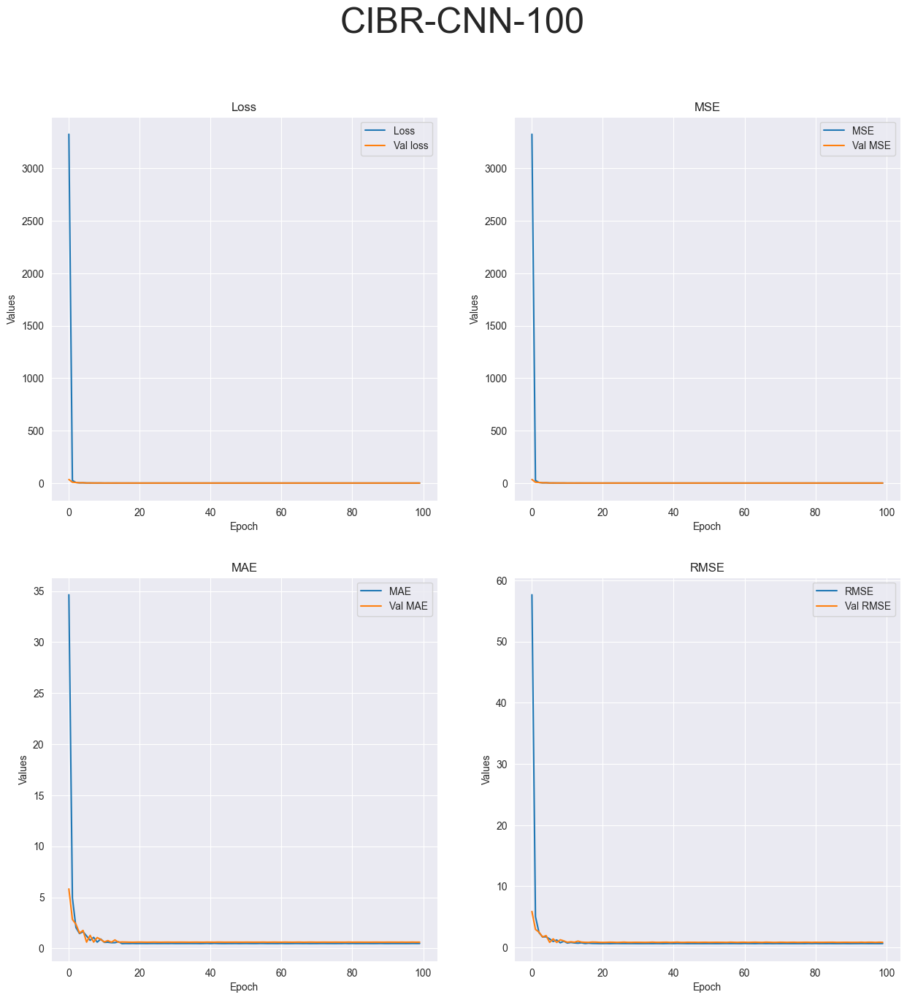

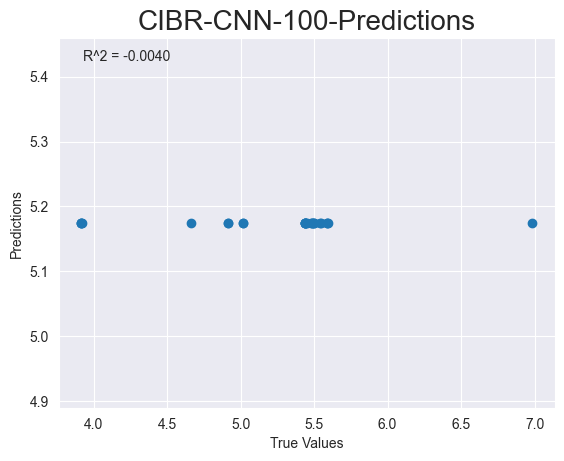


Running experiment Raw, dataset CIBR, test Images, model CNN, epoch 300
Epoch 1/300


2023-05-03 15:49:03.043073: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2538.4954 - mse: 2538.4954 - mae: 33.0081 - root_mean_squared_error: 50.3835

2023-05-03 15:49:04.220204: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 435ms/step - loss: 2538.4954 - mse: 2538.4954 - mae: 33.0081 - root_mean_squared_error: 50.3835 - val_loss: 27.2892 - val_mse: 27.2892 - val_mae: 5.1737 - val_root_mean_squared_error: 5.2239
Epoch 2/300
3/3 [==============================] - 0s 105ms/step - loss: 15.3310 - mse: 15.3310 - mae: 3.4221 - root_mean_squared_error: 3.9155 - val_loss: 15.4110 - val_mse: 15.4110 - val_mae: 3.7373 - val_root_mean_squared_error: 3.9257
Epoch 3/300
3/3 [==============================] - 0s 82ms/step - loss: 6.7857 - mse: 6.7857 - mae: 2.2186 - root_mean_squared_error: 2.6049 - val_loss: 5.7725 - val_mse: 5.7725 - val_mae: 2.2924 - val_root_mean_squared_error: 2.4026
Epoch 4/300
3/3 [==============================] - 0s 102ms/step - loss: 4.0367 - mse: 4.0367 - mae: 1.7999 - root_mean_squared_error: 2.0092 - val_loss: 2.7293 - val_mse: 2.7293 - val_mae: 1.5229 - val_root_mean_squared_error: 1.6521
Epoch 5/300
3/3 [==============================] - 0s 79ms/

2023-05-03 15:50:12.340163: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 225ms/step - loss: 0.3195 - mse: 0.3195 - mae: 0.4493 - root_mean_squared_error: 0.5653
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 69, 69, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 33, 33, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 31, 31, 128)       738

<Figure size 640x480 with 0 Axes>

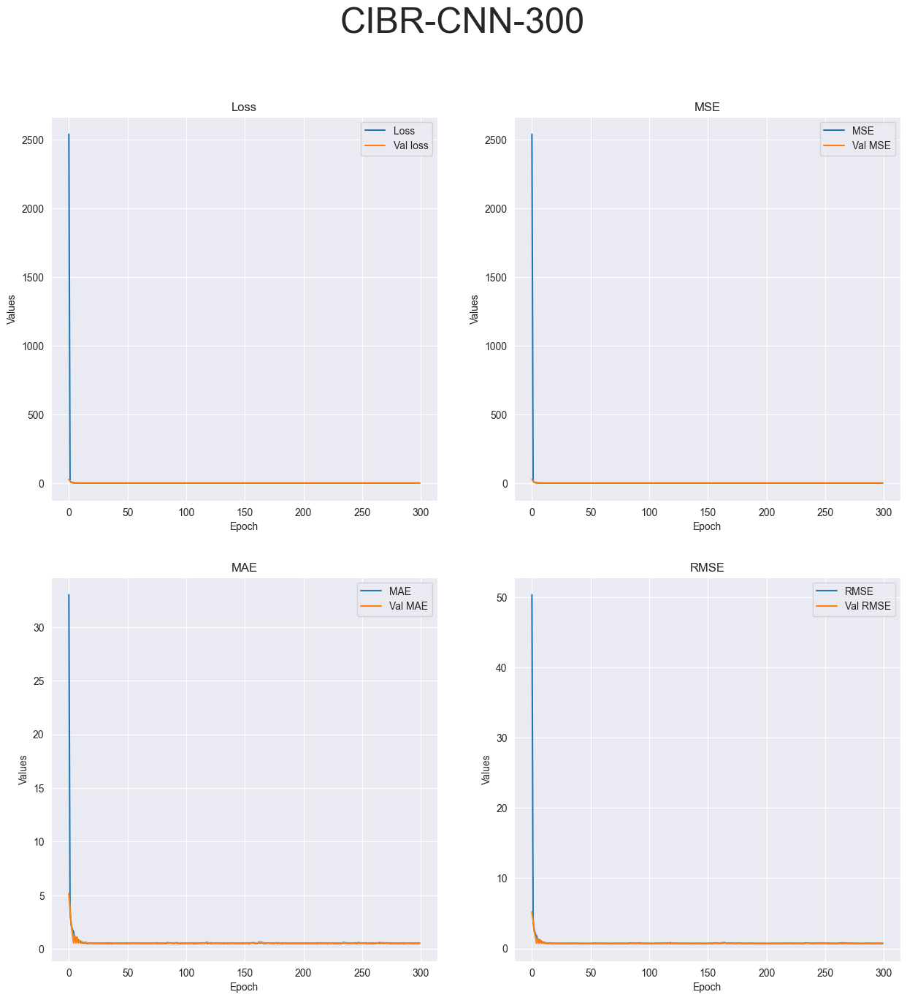

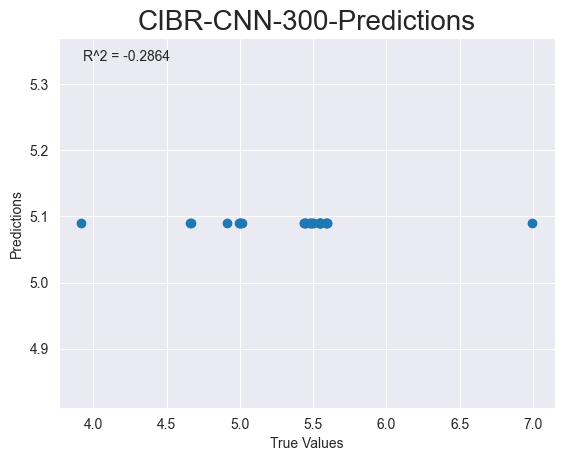


Running experiment Raw, dataset CIBR, test Images, model DenseNet, epoch 100
Epoch 1/100


2023-05-03 15:50:20.185538: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 12.9803 - mse: 12.9803 - mae: 3.0783 - root_mean_squared_error: 3.6028

2023-05-03 15:50:31.155237: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 18s 4s/step - loss: 12.9803 - mse: 12.9803 - mae: 3.0783 - root_mean_squared_error: 3.6028 - val_loss: 15.7217 - val_mse: 15.7217 - val_mae: 3.6693 - val_root_mean_squared_error: 3.9651
Epoch 2/100
3/3 [==============================] - 2s 492ms/step - loss: 5.8428 - mse: 5.8428 - mae: 1.9974 - root_mean_squared_error: 2.4172 - val_loss: 5.1178 - val_mse: 5.1178 - val_mae: 1.9243 - val_root_mean_squared_error: 2.2623
Epoch 3/100
3/3 [==============================] - 1s 437ms/step - loss: 6.4970 - mse: 6.4970 - mae: 2.3653 - root_mean_squared_error: 2.5489 - val_loss: 1.7775 - val_mse: 1.7775 - val_mae: 1.0216 - val_root_mean_squared_error: 1.3332
Epoch 4/100
3/3 [==============================] - 1s 369ms/step - loss: 1.4834 - mse: 1.4834 - mae: 1.0292 - root_mean_squared_error: 1.2179 - val_loss: 6.2987 - val_mse: 6.2987 - val_mae: 2.2625 - val_root_mean_squared_error: 2.5097
Epoch 5/100
3/3 [==============================] - 1s 423ms/step - los

2023-05-03 15:51:48.107817: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 3s 3s/step - loss: 1.0411 - mse: 1.0411 - mae: 0.8645 - root_mean_squared_error: 1.0204
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 140, 140, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 146, 146, 3)  0          ['input_1[0][0]']                
                                                                                                  
 conv1/conv (Conv2D)            (None, 70, 70, 64)   9408        ['zero_padding2d[0][0]']         
                                                                  

<Figure size 640x480 with 0 Axes>

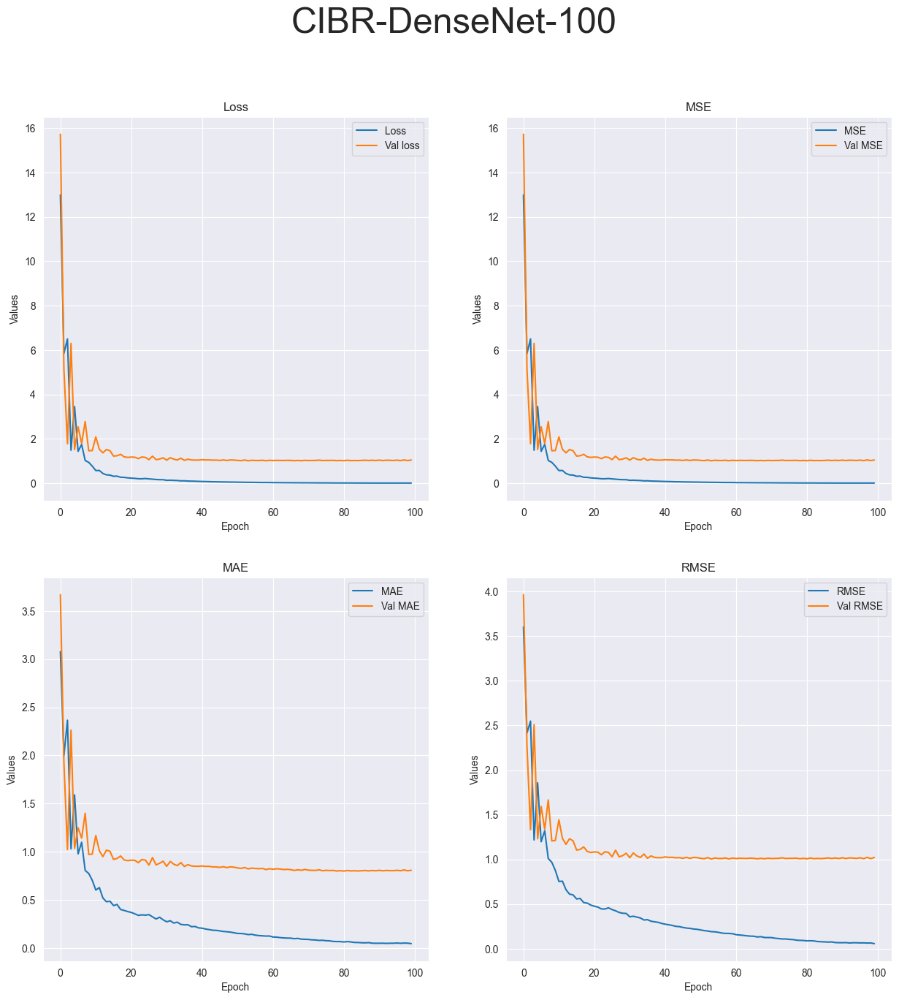

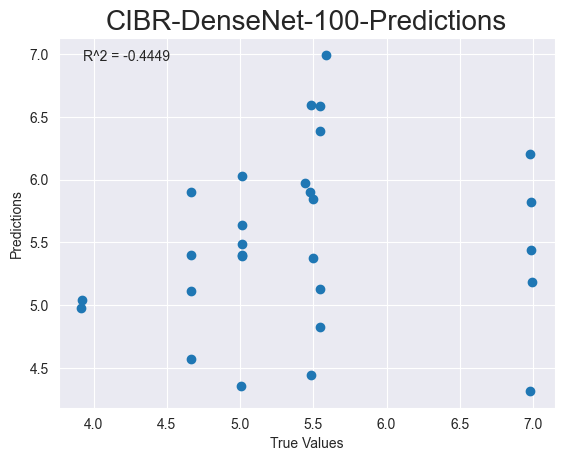


Running experiment Raw, dataset CIBR, test Images, model DenseNet, epoch 300
Epoch 1/300


2023-05-03 15:52:05.652139: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 10.9285 - mse: 10.9285 - mae: 2.8009 - root_mean_squared_error: 3.3058

2023-05-03 15:52:13.662538: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 14s 3s/step - loss: 10.9285 - mse: 10.9285 - mae: 2.8009 - root_mean_squared_error: 3.3058 - val_loss: 10.0552 - val_mse: 10.0552 - val_mae: 2.8126 - val_root_mean_squared_error: 3.1710
Epoch 2/300
3/3 [==============================] - 2s 569ms/step - loss: 5.1104 - mse: 5.1104 - mae: 1.7503 - root_mean_squared_error: 2.2606 - val_loss: 7.4573 - val_mse: 7.4573 - val_mae: 2.5065 - val_root_mean_squared_error: 2.7308
Epoch 3/300
3/3 [==============================] - 2s 840ms/step - loss: 6.6248 - mse: 6.6248 - mae: 2.3007 - root_mean_squared_error: 2.5739 - val_loss: 1.5281 - val_mse: 1.5281 - val_mae: 1.0459 - val_root_mean_squared_error: 1.2362
Epoch 4/300
3/3 [==============================] - 1s 250ms/step - loss: 2.7331 - mse: 2.7331 - mae: 1.3507 - root_mean_squared_error: 1.6532 - val_loss: 3.9581 - val_mse: 3.9581 - val_mae: 1.6713 - val_root_mean_squared_error: 1.9895
Epoch 5/300
3/3 [==============================] - 1s 254ms/step - los

2023-05-03 15:56:03.984115: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 8s 8s/step - loss: 0.9882 - mse: 0.9882 - mae: 0.7978 - root_mean_squared_error: 0.9941
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 140, 140, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 146, 146, 3)  0          ['input_1[0][0]']                
                                                                                                  
 conv1/conv (Conv2D)            (None, 70, 70, 64)   9408        ['zero_padding2d[0][0]']         
                                                                  

<Figure size 640x480 with 0 Axes>

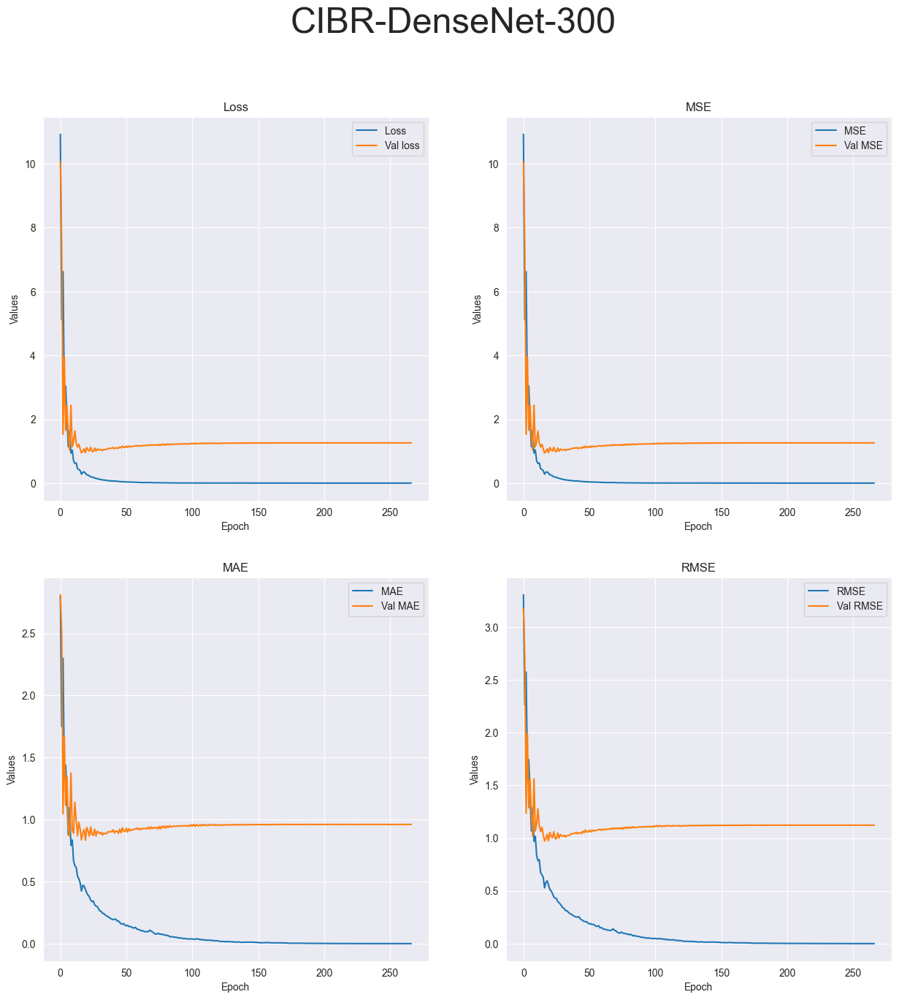

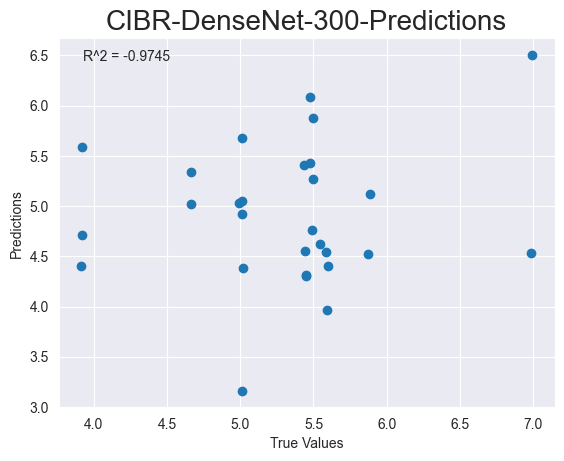


Running experiment Raw, dataset CIBR, test Images, model MobileNet, epoch 100
Epoch 1/100


2023-05-03 15:56:19.801596: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 18.4865 - mse: 18.4865 - mae: 3.9744 - root_mean_squared_error: 4.2996

2023-05-03 15:56:23.055510: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 5s 1s/step - loss: 18.4865 - mse: 18.4865 - mae: 3.9744 - root_mean_squared_error: 4.2996 - val_loss: 6.3605 - val_mse: 6.3605 - val_mae: 2.2271 - val_root_mean_squared_error: 2.5220
Epoch 2/100
3/3 [==============================] - 0s 121ms/step - loss: 6.7288 - mse: 6.7288 - mae: 2.2198 - root_mean_squared_error: 2.5940 - val_loss: 13.3360 - val_mse: 13.3360 - val_mae: 3.3988 - val_root_mean_squared_error: 3.6519
Epoch 3/100
3/3 [==============================] - 0s 160ms/step - loss: 6.4229 - mse: 6.4229 - mae: 2.1680 - root_mean_squared_error: 2.5343 - val_loss: 4.4550 - val_mse: 4.4550 - val_mae: 1.7096 - val_root_mean_squared_error: 2.1107
Epoch 4/100
3/3 [==============================] - 0s 80ms/step - loss: 5.7544 - mse: 5.7544 - mae: 2.1469 - root_mean_squared_error: 2.3988 - val_loss: 3.1883 - val_mse: 3.1883 - val_mae: 1.4018 - val_root_mean_squared_error: 1.7856
Epoch 5/100
3/3 [==============================] - 0s 66ms/step - loss: 

2023-05-03 15:56:48.937418: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 1s 1s/step - loss: 1.2790 - mse: 1.2790 - mae: 1.0104 - root_mean_squared_error: 1.1309
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 140, 140, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 70, 70, 32)        864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 70, 70, 32)       128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 70, 70, 32)        0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 70, 70, 32)       288       
                                                                 


<Figure size 640x480 with 0 Axes>

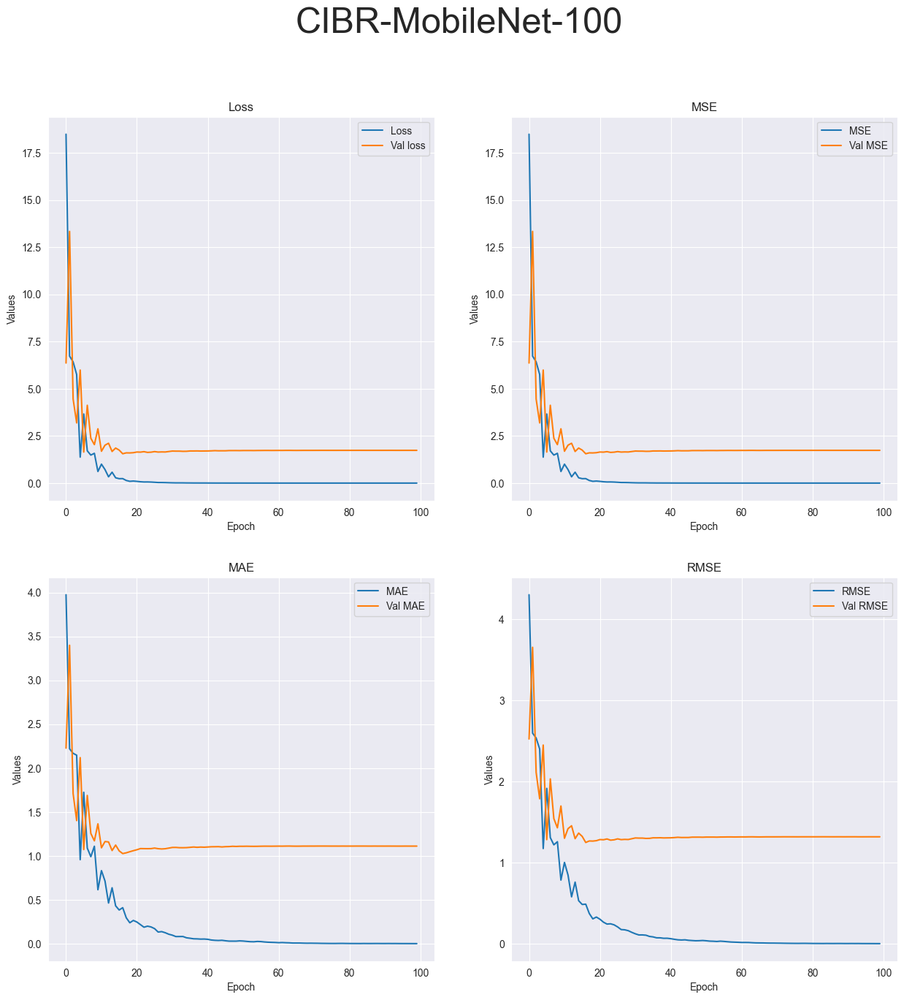

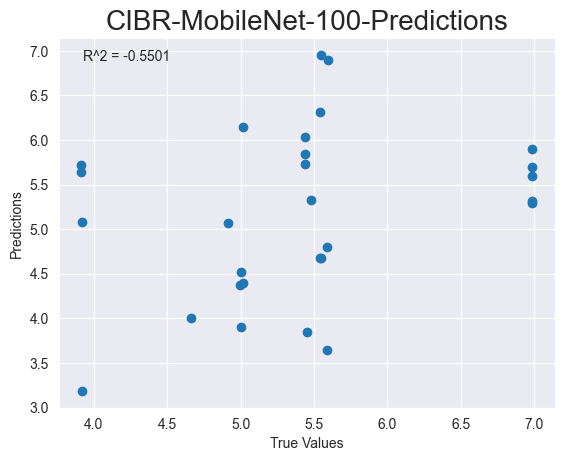


Running experiment Raw, dataset CIBR, test Images, model MobileNet, epoch 300
Epoch 1/300


2023-05-03 15:56:56.022770: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 17.3342 - mse: 17.3342 - mae: 3.8232 - root_mean_squared_error: 4.1634

2023-05-03 15:56:58.781915: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 5s 1s/step - loss: 17.3342 - mse: 17.3342 - mae: 3.8232 - root_mean_squared_error: 4.1634 - val_loss: 7.0619 - val_mse: 7.0619 - val_mae: 2.4112 - val_root_mean_squared_error: 2.6574
Epoch 2/300
3/3 [==============================] - 1s 205ms/step - loss: 5.4284 - mse: 5.4284 - mae: 1.9836 - root_mean_squared_error: 2.3299 - val_loss: 12.6334 - val_mse: 12.6334 - val_mae: 3.4331 - val_root_mean_squared_error: 3.5544
Epoch 3/300
3/3 [==============================] - 0s 79ms/step - loss: 6.8175 - mse: 6.8175 - mae: 2.2427 - root_mean_squared_error: 2.6110 - val_loss: 2.5741 - val_mse: 2.5741 - val_mae: 1.3362 - val_root_mean_squared_error: 1.6044
Epoch 4/300
3/3 [==============================] - 0s 110ms/step - loss: 5.5770 - mse: 5.5770 - mae: 2.0805 - root_mean_squared_error: 2.3616 - val_loss: 2.0870 - val_mse: 2.0870 - val_mae: 1.1305 - val_root_mean_squared_error: 1.4446
Epoch 5/300
3/3 [==============================] - 0s 67ms/step - loss: 

2023-05-03 15:58:05.846354: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 2s 2s/step - loss: 1.2887 - mse: 1.2887 - mae: 0.8523 - root_mean_squared_error: 1.1352
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 140, 140, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 70, 70, 32)        864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 70, 70, 32)       128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 70, 70, 32)        0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 70, 70, 32)       288       
                                                                 


<Figure size 640x480 with 0 Axes>

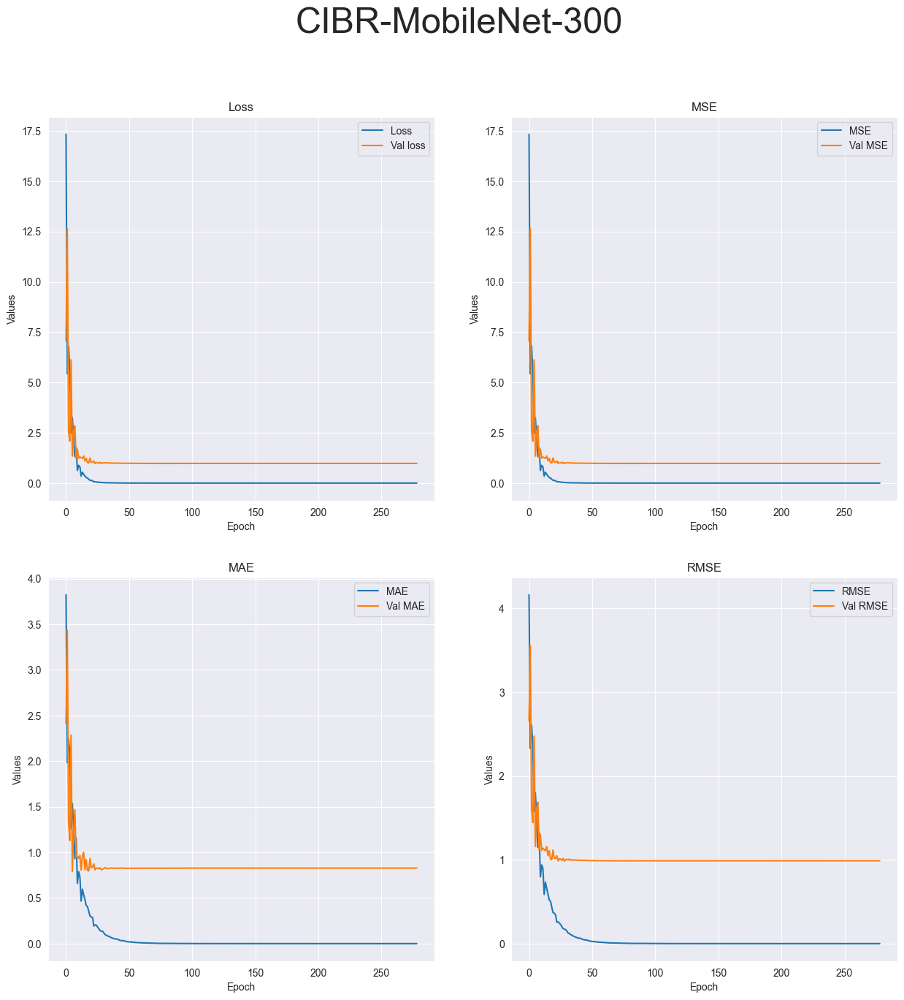

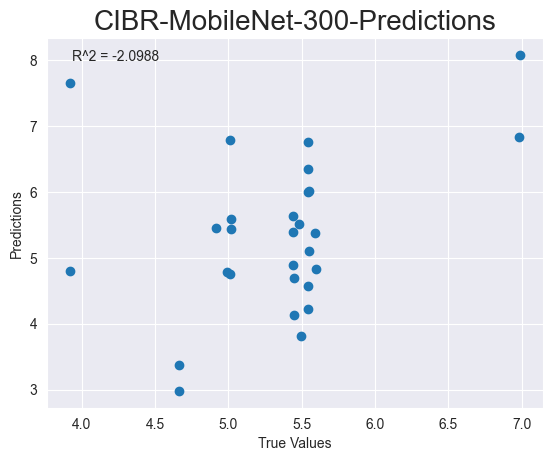

<Figure size 640x480 with 0 Axes>

In [16]:
results_dict_CNN1 = {}

results_dict_CNN1 = run_all_experiments(experimentsCNNRawBlueberries, results_dict_CNN1)
with open("resultsCNN1.json", 'w') as f:
    json.dump(results_dict_CNN1, f)
with open("resultsCNNAll.json", 'w') as f:
    json.dump(results_dict_CNN1, f)


Running experiment Raw, dataset CIRR, test Images, model CNN, epoch 100
Epoch 1/100


2023-05-03 15:58:17.768809: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 2162.3035 - mse: 2162.3035 - mae: 13.8763 - root_mean_squared_error: 46.5006

2023-05-03 15:58:21.282669: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 5s 189ms/step - loss: 2162.3035 - mse: 2162.3035 - mae: 13.8763 - root_mean_squared_error: 46.5006 - val_loss: 0.7125 - val_mse: 0.7125 - val_mae: 0.6830 - val_root_mean_squared_error: 0.8441
Epoch 2/100
16/16 [==============================] - 1s 89ms/step - loss: 1.0795 - mse: 1.0795 - mae: 0.8390 - root_mean_squared_error: 1.0390 - val_loss: 0.7810 - val_mse: 0.7810 - val_mae: 0.7456 - val_root_mean_squared_error: 0.8838
Epoch 3/100
16/16 [==============================] - 1s 78ms/step - loss: 0.9995 - mse: 0.9995 - mae: 0.8079 - root_mean_squared_error: 0.9997 - val_loss: 0.8478 - val_mse: 0.8478 - val_mae: 0.7887 - val_root_mean_squared_error: 0.9207
Epoch 4/100
16/16 [==============================] - 1s 86ms/step - loss: 0.8644 - mse: 0.8644 - mae: 0.7505 - root_mean_squared_error: 0.9297 - val_loss: 0.8518 - val_mse: 0.8518 - val_mae: 0.7925 - val_root_mean_squared_error: 0.9229
Epoch 5/100
16/16 [==============================] - 2s 115

2023-05-03 16:00:39.333650: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 1s 65ms/step - loss: 0.7151 - mse: 0.7151 - mae: 0.7098 - root_mean_squared_error: 0.8456
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 69, 69, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 33, 33, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 31, 31, 128)       7385

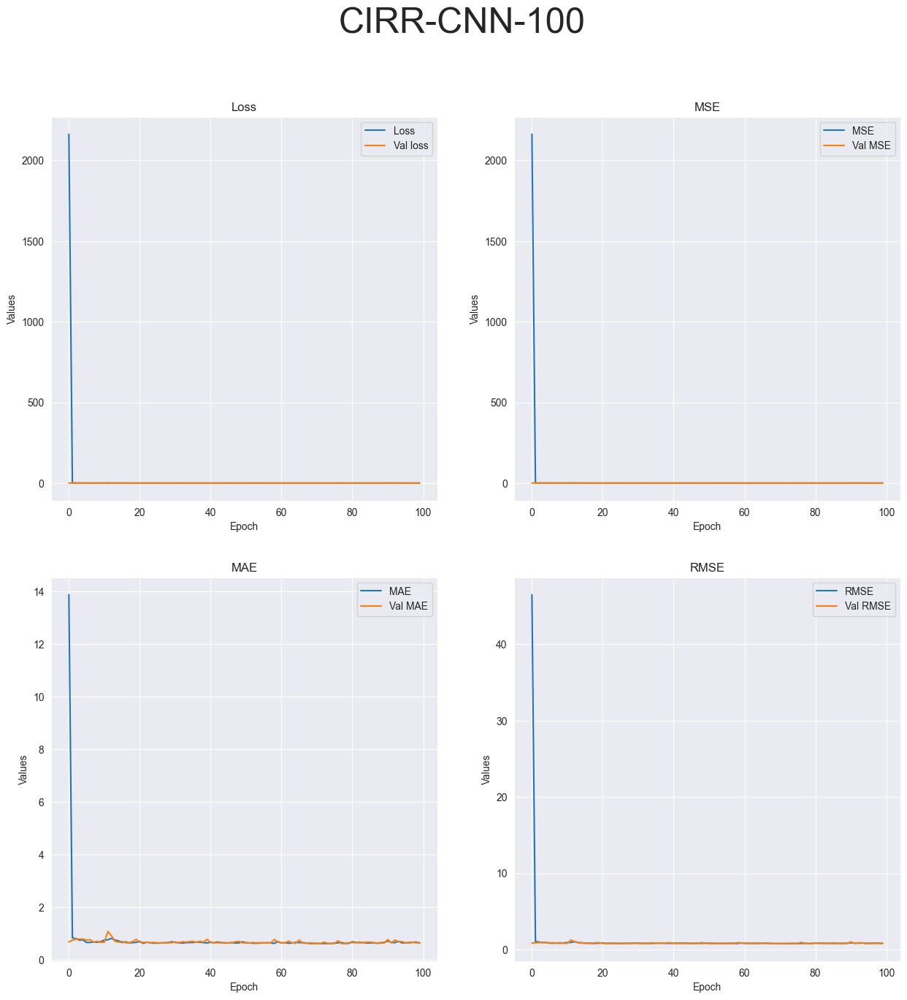

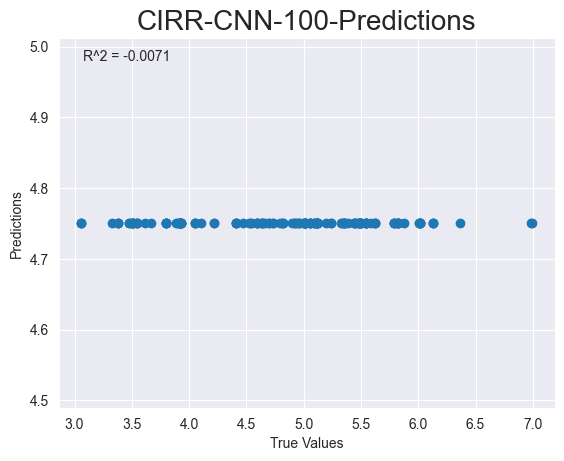


Running experiment Raw, dataset CIRR, test Images, model CNN, epoch 300
Epoch 1/300


2023-05-03 16:00:44.950836: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 2730.5046 - mse: 2730.5046 - mae: 14.7876 - root_mean_squared_error: 52.2542

2023-05-03 16:00:47.641070: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 4s 157ms/step - loss: 2730.5046 - mse: 2730.5046 - mae: 14.7876 - root_mean_squared_error: 52.2542 - val_loss: 0.7752 - val_mse: 0.7752 - val_mae: 0.7011 - val_root_mean_squared_error: 0.8804
Epoch 2/300
16/16 [==============================] - 1s 82ms/step - loss: 0.6920 - mse: 0.6920 - mae: 0.6613 - root_mean_squared_error: 0.8318 - val_loss: 0.7540 - val_mse: 0.7540 - val_mae: 0.6992 - val_root_mean_squared_error: 0.8683
Epoch 3/300
16/16 [==============================] - 1s 72ms/step - loss: 0.6844 - mse: 0.6844 - mae: 0.6677 - root_mean_squared_error: 0.8273 - val_loss: 0.6977 - val_mse: 0.6977 - val_mae: 0.6257 - val_root_mean_squared_error: 0.8353
Epoch 4/300
16/16 [==============================] - 1s 77ms/step - loss: 0.6945 - mse: 0.6945 - mae: 0.6668 - root_mean_squared_error: 0.8334 - val_loss: 0.8651 - val_mse: 0.8651 - val_mae: 0.7750 - val_root_mean_squared_error: 0.9301
Epoch 5/300
16/16 [==============================] - 1s 73m

2023-05-03 16:07:11.923124: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 1s 65ms/step - loss: 0.5970 - mse: 0.5970 - mae: 0.6445 - root_mean_squared_error: 0.7726
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 69, 69, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 33, 33, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 31, 31, 128)       7385

<Figure size 640x480 with 0 Axes>

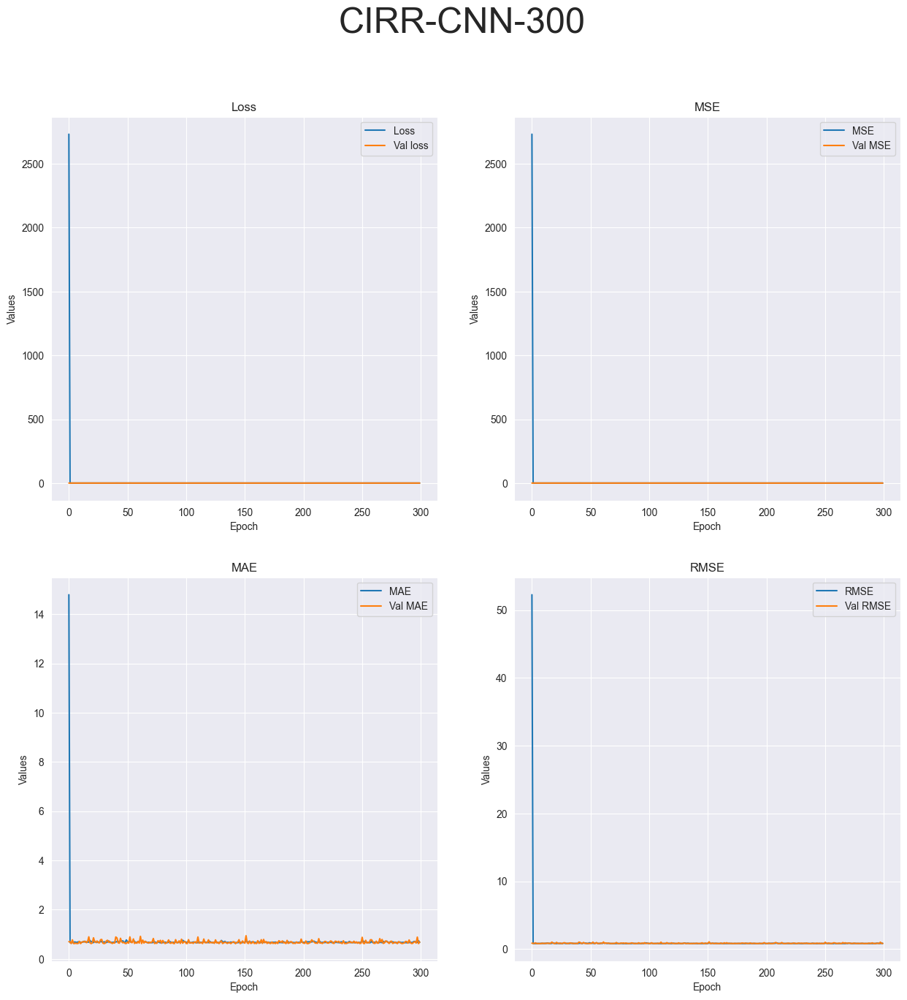

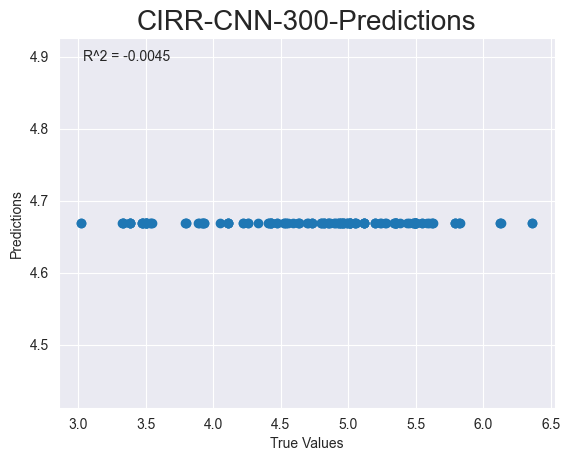


Running experiment Raw, dataset CIRR, test Images, model DenseNet, epoch 100
Epoch 1/100


2023-05-03 16:07:23.033101: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 6.4633 - mse: 6.4633 - mae: 2.0694 - root_mean_squared_error: 2.5423

2023-05-03 16:07:37.003686: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 26s 1s/step - loss: 6.4633 - mse: 6.4633 - mae: 2.0694 - root_mean_squared_error: 2.5423 - val_loss: 1.2177 - val_mse: 1.2177 - val_mae: 0.8745 - val_root_mean_squared_error: 1.1035
Epoch 2/100
16/16 [==============================] - 5s 297ms/step - loss: 1.6647 - mse: 1.6647 - mae: 1.0711 - root_mean_squared_error: 1.2902 - val_loss: 0.8526 - val_mse: 0.8526 - val_mae: 0.7441 - val_root_mean_squared_error: 0.9234
Epoch 3/100
16/16 [==============================] - 3s 211ms/step - loss: 0.8585 - mse: 0.8585 - mae: 0.7535 - root_mean_squared_error: 0.9266 - val_loss: 1.0434 - val_mse: 1.0434 - val_mae: 0.8048 - val_root_mean_squared_error: 1.0215
Epoch 4/100
16/16 [==============================] - 5s 333ms/step - loss: 0.7729 - mse: 0.7729 - mae: 0.7053 - root_mean_squared_error: 0.8791 - val_loss: 0.5688 - val_mse: 0.5688 - val_mae: 0.5787 - val_root_mean_squared_error: 0.7542
Epoch 5/100
16/16 [==============================] - 6s 375ms/step

2023-05-03 16:13:59.622335: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 9s 1s/step - loss: 0.7711 - mse: 0.7711 - mae: 0.6433 - root_mean_squared_error: 0.8781
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 140, 140, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 146, 146, 3)  0          ['input_1[0][0]']                
                                                                                                  
 conv1/conv (Conv2D)            (None, 70, 70, 64)   9408        ['zero_padding2d[0][0]']         
                                                                  

<Figure size 640x480 with 0 Axes>

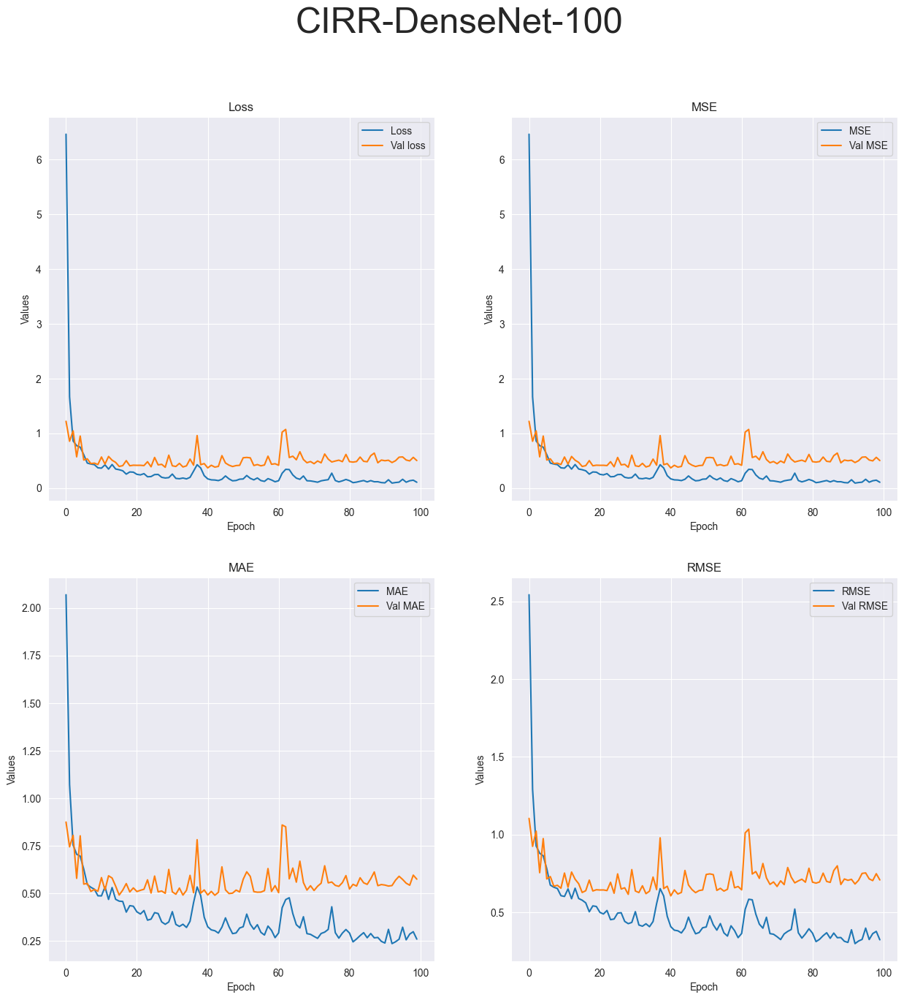

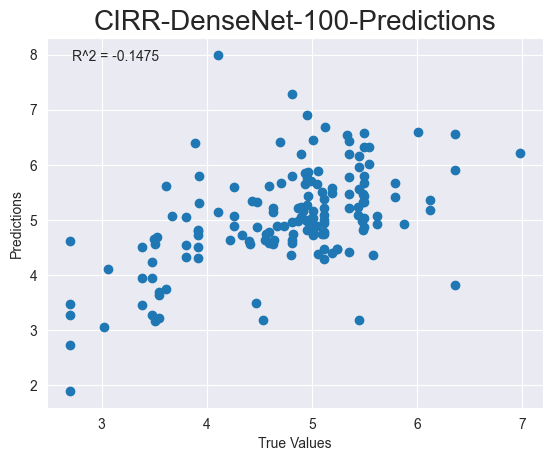


Running experiment Raw, dataset CIRR, test Images, model DenseNet, epoch 300
Epoch 1/300


2023-05-03 16:14:31.229404: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 6.0973 - mse: 6.0973 - mae: 1.9719 - root_mean_squared_error: 2.4693

2023-05-03 16:14:51.239501: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 33s 1s/step - loss: 6.0973 - mse: 6.0973 - mae: 1.9719 - root_mean_squared_error: 2.4693 - val_loss: 1.4019 - val_mse: 1.4019 - val_mae: 0.9379 - val_root_mean_squared_error: 1.1840
Epoch 2/300
16/16 [==============================] - 4s 258ms/step - loss: 1.7305 - mse: 1.7305 - mae: 1.0811 - root_mean_squared_error: 1.3155 - val_loss: 0.8315 - val_mse: 0.8315 - val_mae: 0.7431 - val_root_mean_squared_error: 0.9119
Epoch 3/300
16/16 [==============================] - 5s 311ms/step - loss: 0.9267 - mse: 0.9267 - mae: 0.7696 - root_mean_squared_error: 0.9627 - val_loss: 0.7846 - val_mse: 0.7846 - val_mae: 0.7033 - val_root_mean_squared_error: 0.8858
Epoch 4/300
16/16 [==============================] - 7s 464ms/step - loss: 0.6897 - mse: 0.6897 - mae: 0.6562 - root_mean_squared_error: 0.8305 - val_loss: 0.6884 - val_mse: 0.6884 - val_mae: 0.6467 - val_root_mean_squared_error: 0.8297
Epoch 5/300
16/16 [==============================] - 8s 507ms/step

2023-05-03 16:32:53.105818: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 13s 2s/step - loss: 0.9079 - mse: 0.9079 - mae: 0.7396 - root_mean_squared_error: 0.9528
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 140, 140, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 146, 146, 3)  0          ['input_1[0][0]']                
                                                                                                  
 conv1/conv (Conv2D)            (None, 70, 70, 64)   9408        ['zero_padding2d[0][0]']         
                                                                 

<Figure size 640x480 with 0 Axes>

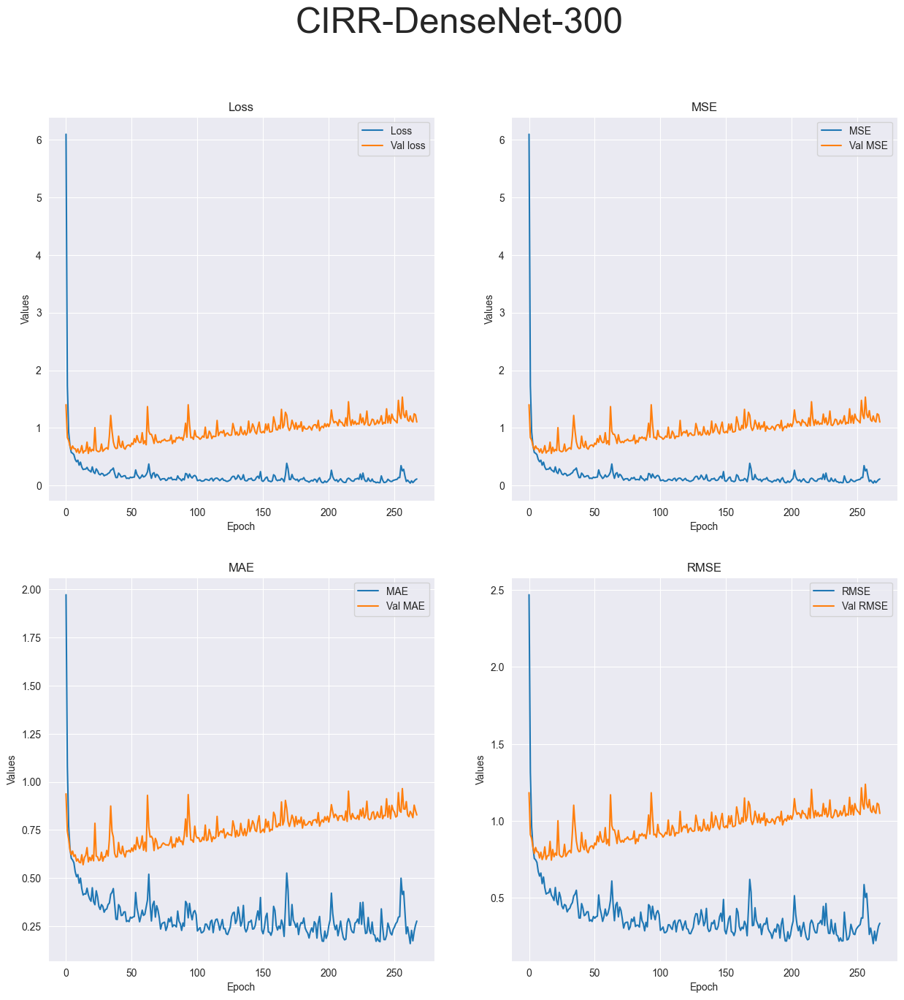

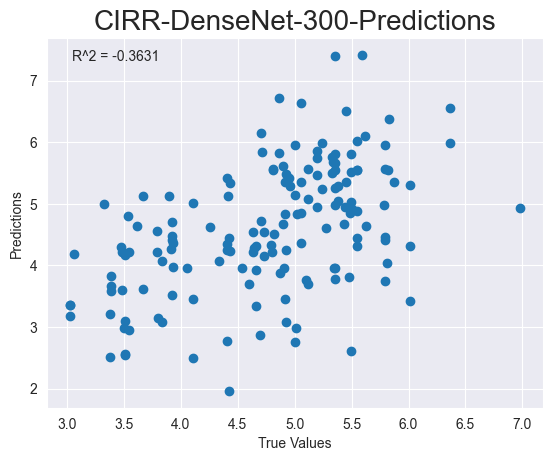


Running experiment Raw, dataset CIRR, test Images, model MobileNet, epoch 100
Epoch 1/100


2023-05-03 16:33:18.583781: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 5.0021 - mse: 5.0021 - mae: 1.8618 - root_mean_squared_error: 2.2365

2023-05-03 16:33:26.106635: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 12s 379ms/step - loss: 5.0021 - mse: 5.0021 - mae: 1.8618 - root_mean_squared_error: 2.2365 - val_loss: 1.6649 - val_mse: 1.6649 - val_mae: 1.0537 - val_root_mean_squared_error: 1.2903
Epoch 2/100
16/16 [==============================] - 4s 232ms/step - loss: 1.6212 - mse: 1.6212 - mae: 1.0309 - root_mean_squared_error: 1.2733 - val_loss: 1.0260 - val_mse: 1.0260 - val_mae: 0.7779 - val_root_mean_squared_error: 1.0129
Epoch 3/100
16/16 [==============================] - 1s 91ms/step - loss: 0.7185 - mse: 0.7185 - mae: 0.6837 - root_mean_squared_error: 0.8476 - val_loss: 1.2416 - val_mse: 1.2416 - val_mae: 0.8923 - val_root_mean_squared_error: 1.1142
Epoch 4/100
16/16 [==============================] - 1s 76ms/step - loss: 0.7187 - mse: 0.7187 - mae: 0.6868 - root_mean_squared_error: 0.8478 - val_loss: 0.6637 - val_mse: 0.6637 - val_mae: 0.6408 - val_root_mean_squared_error: 0.8147
Epoch 5/100
16/16 [==============================] - 1s 79ms/step

2023-05-03 16:36:02.980227: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 4s 423ms/step - loss: 1.0629 - mse: 1.0629 - mae: 0.8123 - root_mean_squared_error: 1.0310
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 140, 140, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 70, 70, 32)        864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 70, 70, 32)       128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 70, 70, 32)        0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 70, 70, 32)       288       
                                                               

<Figure size 640x480 with 0 Axes>

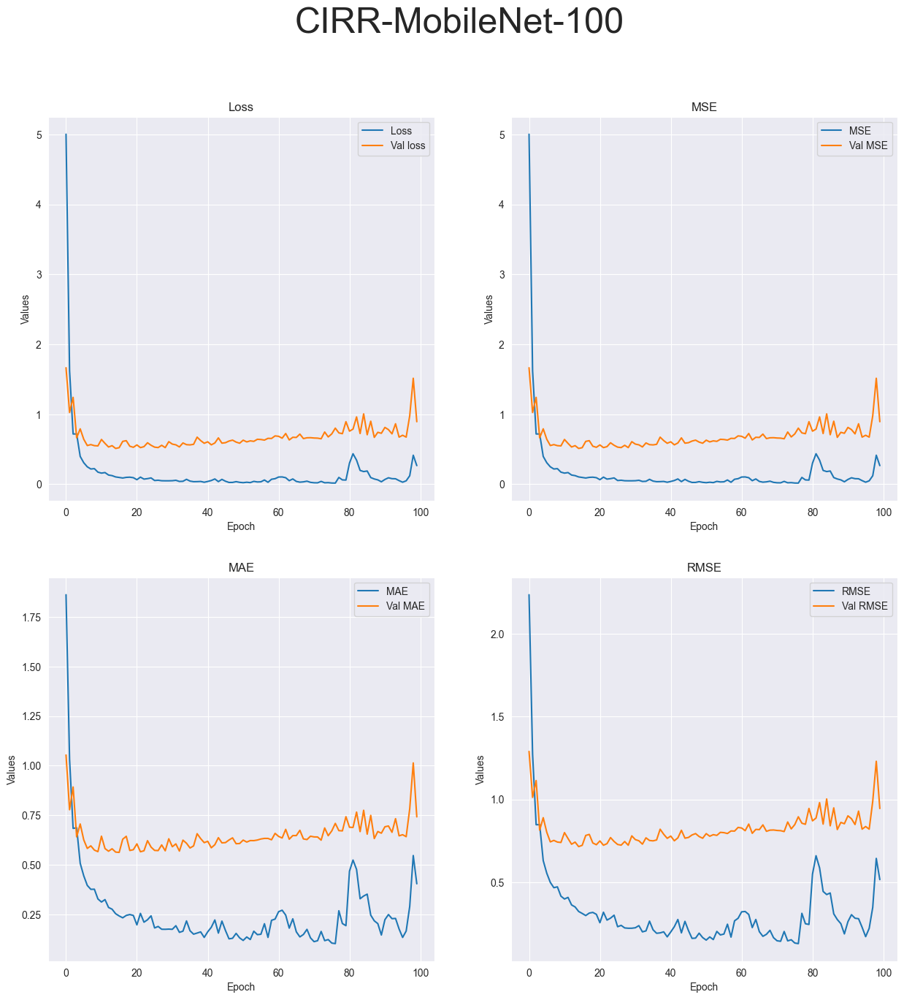

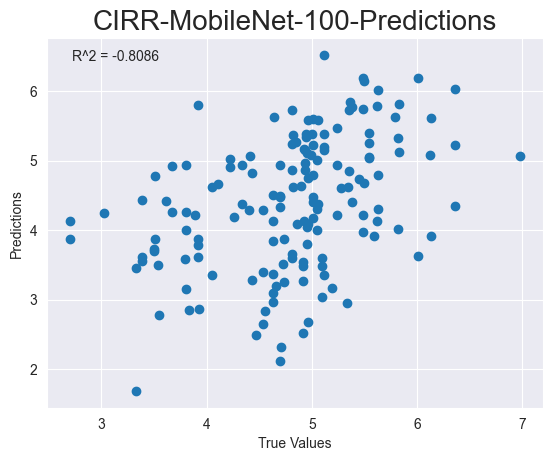


Running experiment Raw, dataset CIRR, test Images, model MobileNet, epoch 300
Epoch 1/300


2023-05-03 16:36:19.013555: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 4.7994 - mse: 4.7994 - mae: 1.7465 - root_mean_squared_error: 2.1908

2023-05-03 16:36:25.845253: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 12s 447ms/step - loss: 4.7994 - mse: 4.7994 - mae: 1.7465 - root_mean_squared_error: 2.1908 - val_loss: 0.9809 - val_mse: 0.9809 - val_mae: 0.7832 - val_root_mean_squared_error: 0.9904
Epoch 2/300
16/16 [==============================] - 2s 97ms/step - loss: 1.1155 - mse: 1.1155 - mae: 0.8448 - root_mean_squared_error: 1.0562 - val_loss: 1.4387 - val_mse: 1.4387 - val_mae: 0.9654 - val_root_mean_squared_error: 1.1995
Epoch 3/300
16/16 [==============================] - 2s 120ms/step - loss: 0.8019 - mse: 0.8019 - mae: 0.7070 - root_mean_squared_error: 0.8955 - val_loss: 1.1345 - val_mse: 1.1345 - val_mae: 0.8229 - val_root_mean_squared_error: 1.0651
Epoch 4/300
16/16 [==============================] - 1s 63ms/step - loss: 0.5422 - mse: 0.5422 - mae: 0.5865 - root_mean_squared_error: 0.7364 - val_loss: 0.6474 - val_mse: 0.6474 - val_mae: 0.5973 - val_root_mean_squared_error: 0.8046
Epoch 5/300
16/16 [==============================] - 1s 87ms/step

2023-05-03 16:42:20.922468: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 5s 550ms/step - loss: 0.7050 - mse: 0.7050 - mae: 0.6386 - root_mean_squared_error: 0.8397
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 140, 140, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 70, 70, 32)        864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 70, 70, 32)       128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 70, 70, 32)        0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 70, 70, 32)       288       
                                                               

<Figure size 640x480 with 0 Axes>

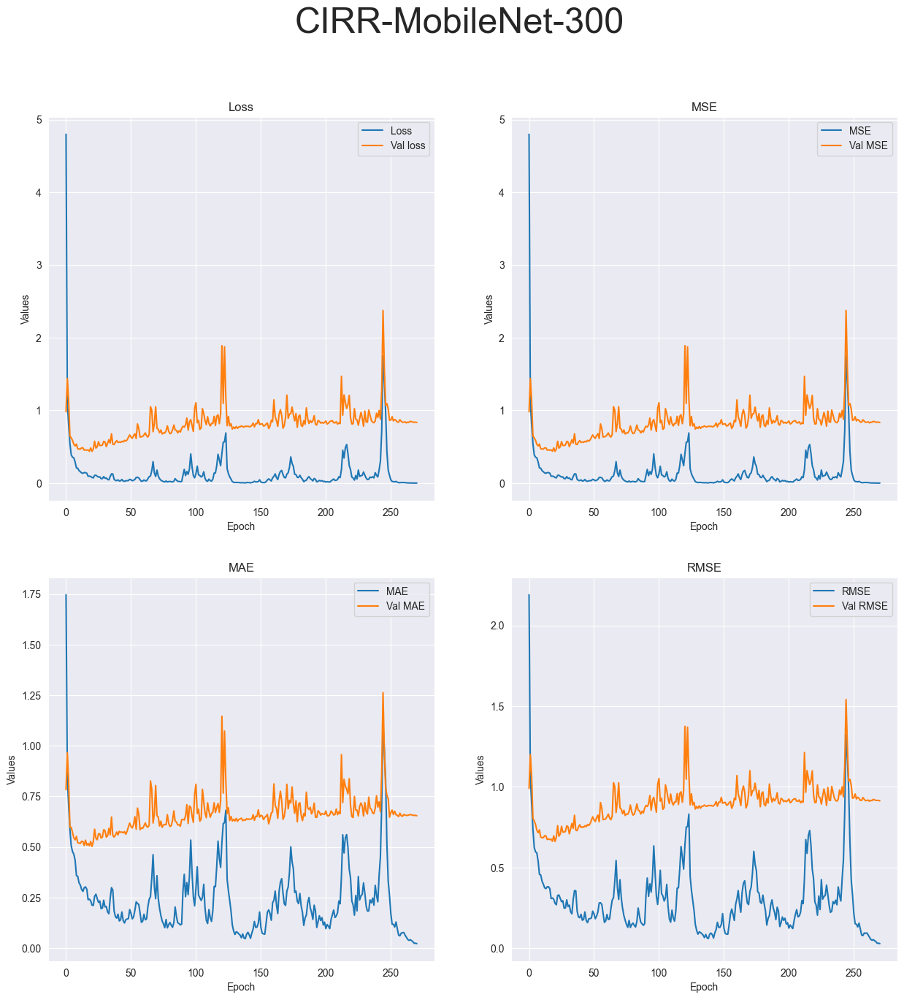

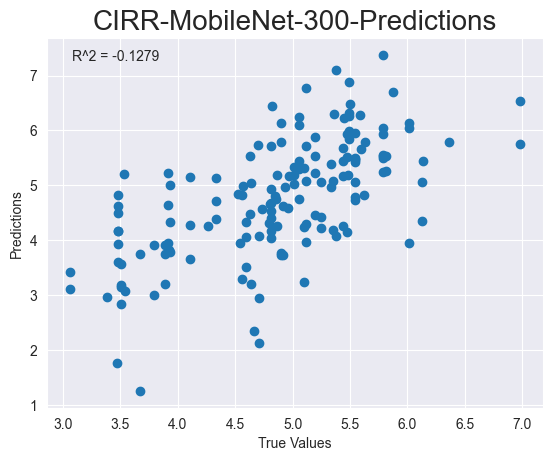

<Figure size 640x480 with 0 Axes>

In [17]:
results_dict_CNN2 = results_dict_CNN1.copy()

results_dict_CNN2 = run_all_experiments(experimentsCNNRawRaspberries, results_dict_CNN2)
with open("resultsCNN2.json", 'w') as f:
    json.dump(results_dict_CNN2, f)
with open("resultsCNNAll.json", 'w') as f:
    json.dump(results_dict_CNN2, f)

Running experiment Raw, dataset CISR, test Images, model CNN, epoch 100
Epoch 1/100


2023-05-03 16:43:44.519904: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 2936.3049 - mse: 2936.3049 - mae: 37.7508 - root_mean_squared_error: 54.1877

2023-05-03 16:43:50.566891: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 7s 362ms/step - loss: 2936.3049 - mse: 2936.3049 - mae: 37.7508 - root_mean_squared_error: 54.1877 - val_loss: 120.7029 - val_mse: 120.7029 - val_mae: 7.7233 - val_root_mean_squared_error: 10.9865
Epoch 2/100
11/11 [==============================] - 2s 103ms/step - loss: 131.6602 - mse: 131.6602 - mae: 8.7475 - root_mean_squared_error: 11.4743 - val_loss: 69.9854 - val_mse: 69.9854 - val_mae: 6.9763 - val_root_mean_squared_error: 8.3657
Epoch 3/100
11/11 [==============================] - 1s 93ms/step - loss: 84.1455 - mse: 84.1455 - mae: 7.2660 - root_mean_squared_error: 9.1731 - val_loss: 65.3137 - val_mse: 65.3137 - val_mae: 5.8868 - val_root_mean_squared_error: 8.0817
Epoch 4/100
11/11 [==============================] - 1s 93ms/step - loss: 81.6691 - mse: 81.6691 - mae: 6.9899 - root_mean_squared_error: 9.0371 - val_loss: 60.6837 - val_mse: 60.6837 - val_mae: 6.0260 - val_root_mean_squared_error: 7.7900
Epoch 5/100
11/11 [===================

2023-05-03 16:45:08.681457: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 130ms/step - loss: 94.8952 - mse: 94.8952 - mae: 8.3011 - root_mean_squared_error: 9.7414
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 69, 69, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 33, 33, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 31, 31, 128)       7

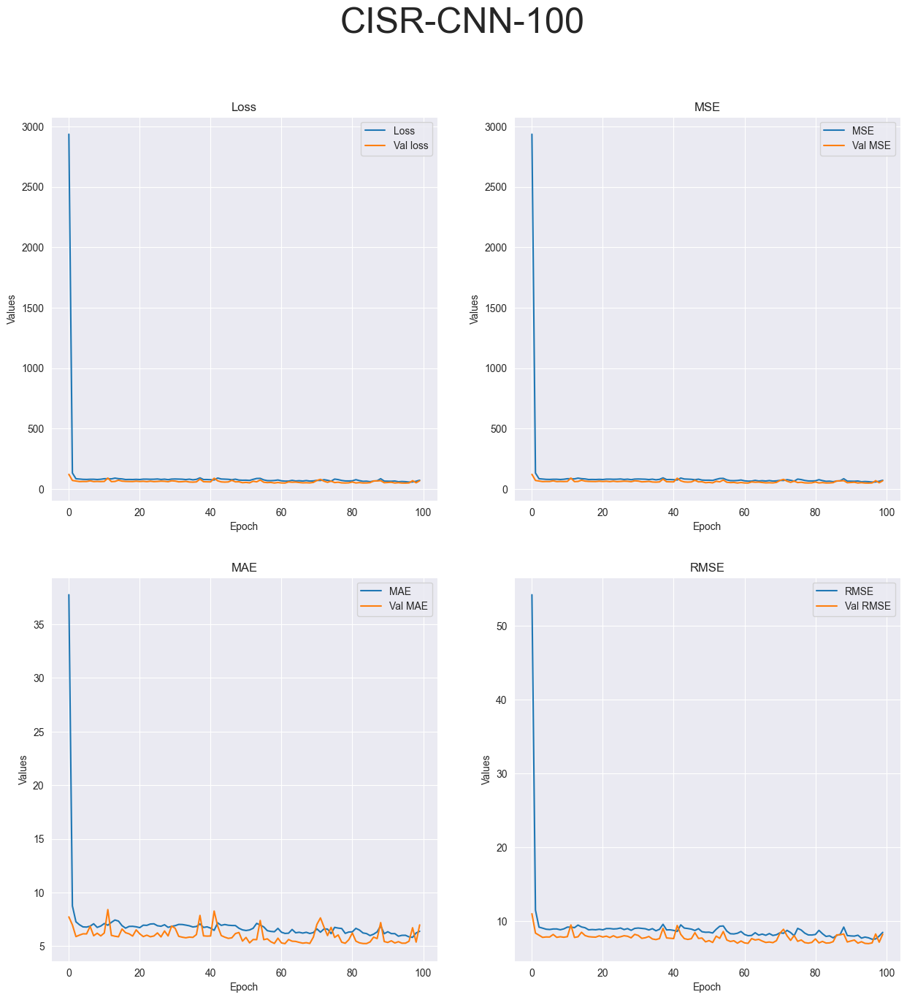

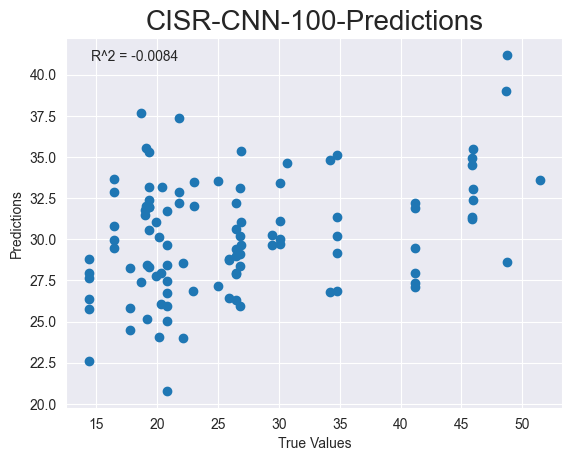


Running experiment Raw, dataset CISR, test Images, model CNN, epoch 300
Epoch 1/300


2023-05-03 16:45:13.976855: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 1483.7792 - mse: 1483.7792 - mae: 28.2719 - root_mean_squared_error: 38.5199

2023-05-03 16:45:17.628637: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 5s 305ms/step - loss: 1483.7792 - mse: 1483.7792 - mae: 28.2719 - root_mean_squared_error: 38.5199 - val_loss: 113.7067 - val_mse: 113.7067 - val_mae: 9.5812 - val_root_mean_squared_error: 10.6633
Epoch 2/300
11/11 [==============================] - 1s 102ms/step - loss: 90.9894 - mse: 90.9894 - mae: 7.2603 - root_mean_squared_error: 9.5388 - val_loss: 108.3166 - val_mse: 108.3166 - val_mae: 9.2842 - val_root_mean_squared_error: 10.4075
Epoch 3/300
11/11 [==============================] - 1s 82ms/step - loss: 86.3837 - mse: 86.3837 - mae: 7.1337 - root_mean_squared_error: 9.2943 - val_loss: 95.2400 - val_mse: 95.2400 - val_mae: 7.5504 - val_root_mean_squared_error: 9.7591
Epoch 4/300
11/11 [==============================] - 1s 78ms/step - loss: 77.7384 - mse: 77.7384 - mae: 6.9754 - root_mean_squared_error: 8.8169 - val_loss: 105.6746 - val_mse: 105.6746 - val_mae: 7.4315 - val_root_mean_squared_error: 10.2798
Epoch 5/300
11/11 [================

2023-05-03 16:49:48.294881: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 1s 137ms/step - loss: 93.7324 - mse: 93.7324 - mae: 7.4250 - root_mean_squared_error: 9.6816
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 69, 69, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 33, 33, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 31, 31, 128)       7

<Figure size 640x480 with 0 Axes>

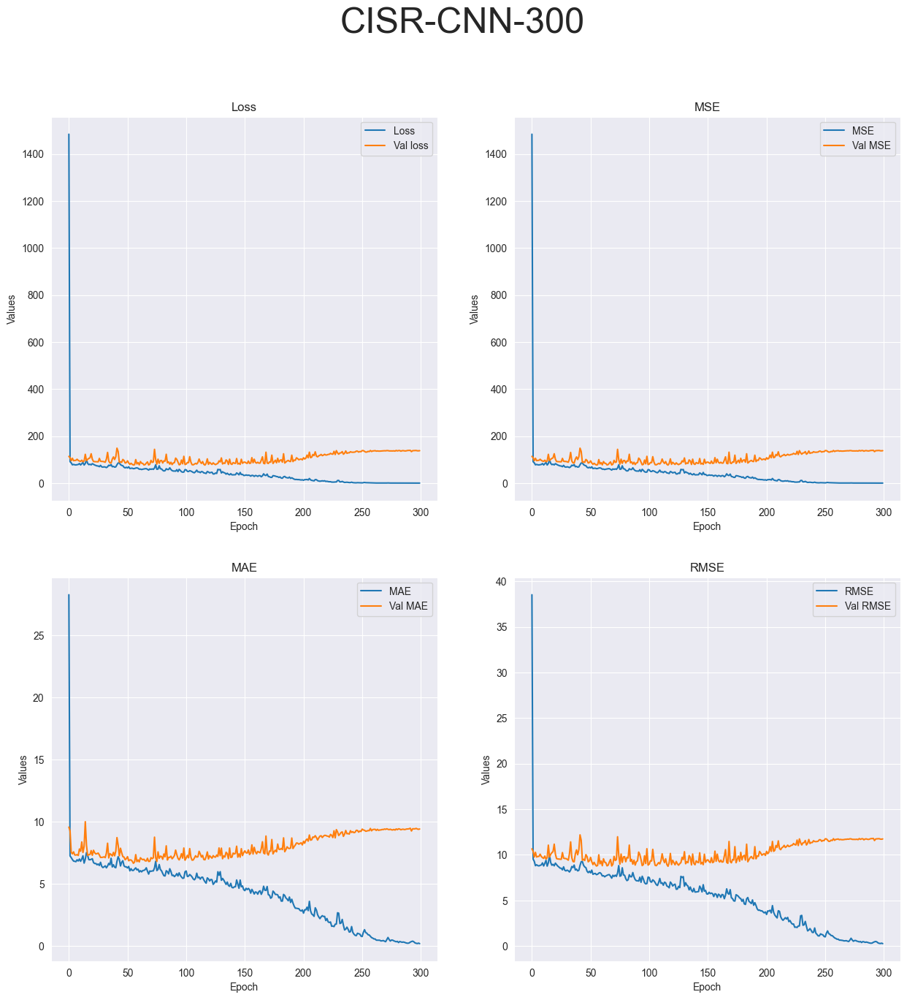

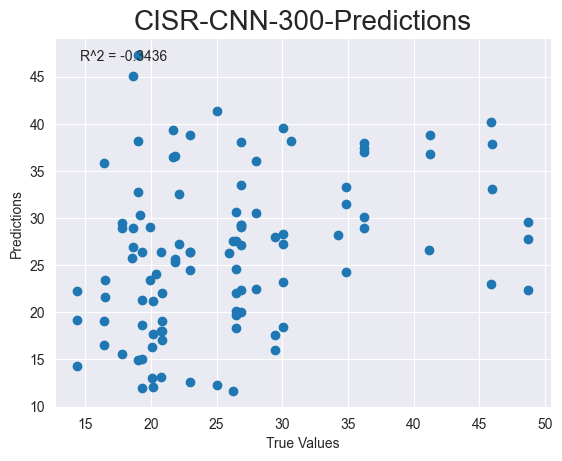


Running experiment Raw, dataset CISR, test Images, model DenseNet, epoch 100
Epoch 1/100


2023-05-03 16:49:58.358101: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 293.6921 - mse: 293.6921 - mae: 14.0184 - root_mean_squared_error: 17.1374

2023-05-03 16:50:16.030493: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 34s 2s/step - loss: 293.6921 - mse: 293.6921 - mae: 14.0184 - root_mean_squared_error: 17.1374 - val_loss: 186.1494 - val_mse: 186.1494 - val_mae: 12.2756 - val_root_mean_squared_error: 13.6437
Epoch 2/100
11/11 [==============================] - 5s 437ms/step - loss: 111.3555 - mse: 111.3555 - mae: 8.3591 - root_mean_squared_error: 10.5525 - val_loss: 95.2875 - val_mse: 95.2875 - val_mae: 6.8644 - val_root_mean_squared_error: 9.7615
Epoch 3/100
11/11 [==============================] - 7s 652ms/step - loss: 73.5243 - mse: 73.5243 - mae: 6.5873 - root_mean_squared_error: 8.5746 - val_loss: 68.0943 - val_mse: 68.0943 - val_mae: 7.0339 - val_root_mean_squared_error: 8.2519
Epoch 4/100
11/11 [==============================] - 4s 374ms/step - loss: 55.8418 - mse: 55.8418 - mae: 5.9742 - root_mean_squared_error: 7.4727 - val_loss: 55.8643 - val_mse: 55.8643 - val_mae: 5.5701 - val_root_mean_squared_error: 7.4742
Epoch 5/100
11/11 [====================

2023-05-03 16:55:00.851941: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 14s 2s/step - loss: 31.6071 - mse: 31.6071 - mae: 4.2176 - root_mean_squared_error: 5.6220
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 140, 140, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 146, 146, 3)  0          ['input_1[0][0]']                
                                                                                                  
 conv1/conv (Conv2D)            (None, 70, 70, 64)   9408        ['zero_padding2d[0][0]']         
                                                               

<Figure size 640x480 with 0 Axes>

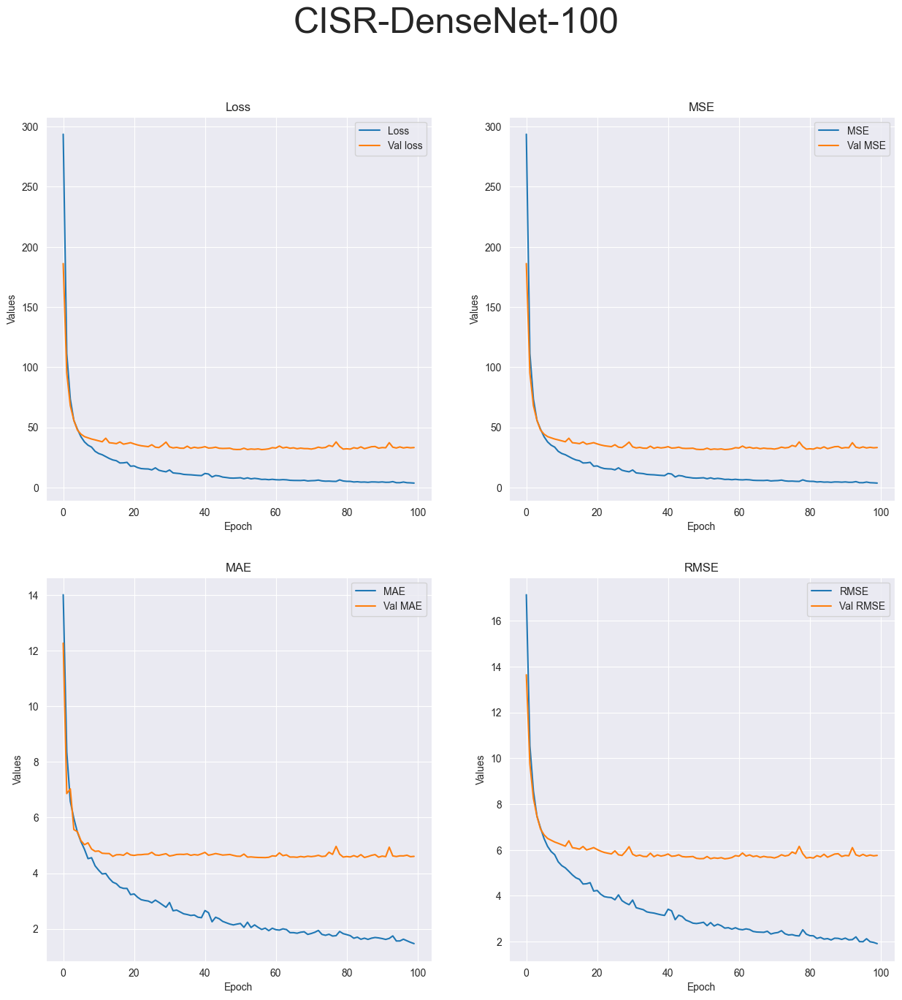

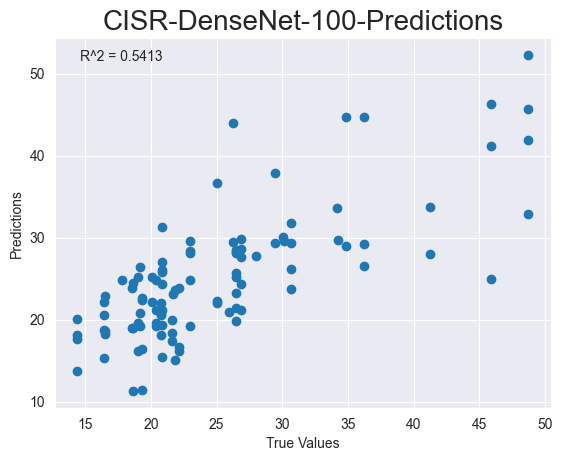


Running experiment Raw, dataset CISR, test Images, model DenseNet, epoch 300
Epoch 1/300


2023-05-03 16:55:36.738674: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 273.1998 - mse: 273.1998 - mae: 13.3983 - root_mean_squared_error: 16.5288

2023-05-03 16:56:00.316499: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 39s 3s/step - loss: 273.1998 - mse: 273.1998 - mae: 13.3983 - root_mean_squared_error: 16.5288 - val_loss: 164.5864 - val_mse: 164.5864 - val_mae: 11.1938 - val_root_mean_squared_error: 12.8291
Epoch 2/300
11/11 [==============================] - 10s 814ms/step - loss: 111.1585 - mse: 111.1585 - mae: 8.3474 - root_mean_squared_error: 10.5432 - val_loss: 118.1856 - val_mse: 118.1856 - val_mae: 7.6793 - val_root_mean_squared_error: 10.8713
Epoch 3/300
11/11 [==============================] - 7s 646ms/step - loss: 81.1211 - mse: 81.1211 - mae: 6.8886 - root_mean_squared_error: 9.0067 - val_loss: 65.6765 - val_mse: 65.6765 - val_mae: 6.5756 - val_root_mean_squared_error: 8.1041
Epoch 4/300
11/11 [==============================] - 5s 472ms/step - loss: 64.9300 - mse: 64.9300 - mae: 6.1076 - root_mean_squared_error: 8.0579 - val_loss: 54.0190 - val_mse: 54.0190 - val_mae: 5.4941 - val_root_mean_squared_error: 7.3498
Epoch 5/300
11/11 [================

2023-05-03 17:09:59.331580: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 21s 4s/step - loss: 55.8579 - mse: 55.8579 - mae: 5.9073 - root_mean_squared_error: 7.4738
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 140, 140, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 146, 146, 3)  0          ['input_1[0][0]']                
                                                                                                  
 conv1/conv (Conv2D)            (None, 70, 70, 64)   9408        ['zero_padding2d[0][0]']         
                                                               

<Figure size 640x480 with 0 Axes>

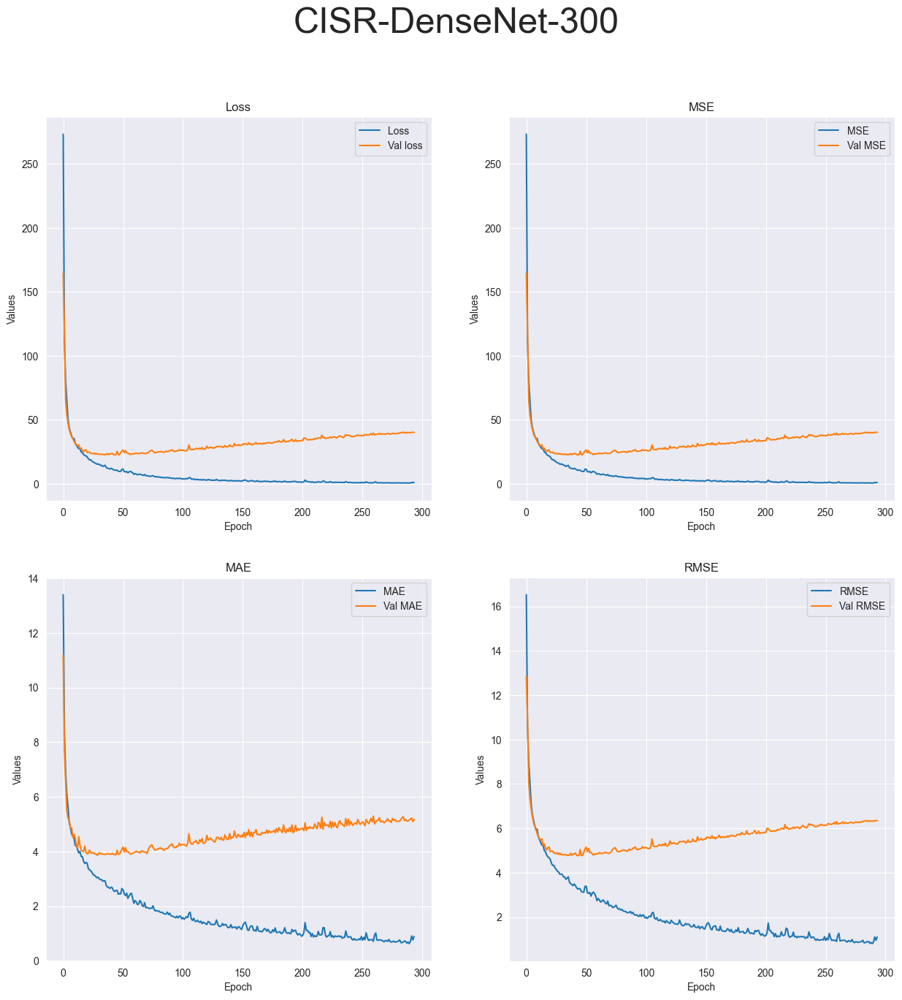

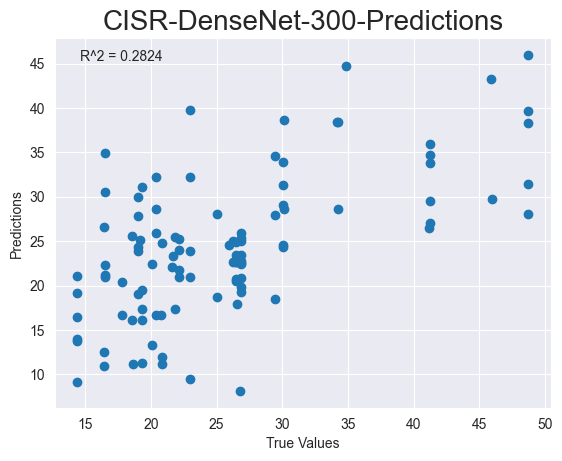


Running experiment Raw, dataset CISR, test Images, model MobileNet, epoch 100
Epoch 1/100


2023-05-03 17:10:32.679315: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 247.9998 - mse: 247.9998 - mae: 13.3614 - root_mean_squared_error: 15.7480

2023-05-03 17:10:44.108615: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 18s 1s/step - loss: 247.9998 - mse: 247.9998 - mae: 13.3614 - root_mean_squared_error: 15.7480 - val_loss: 73.9478 - val_mse: 73.9478 - val_mae: 7.1019 - val_root_mean_squared_error: 8.5993
Epoch 2/100
11/11 [==============================] - 3s 291ms/step - loss: 92.2859 - mse: 92.2859 - mae: 6.8441 - root_mean_squared_error: 9.6066 - val_loss: 61.2621 - val_mse: 61.2621 - val_mae: 6.3778 - val_root_mean_squared_error: 7.8270
Epoch 3/100
11/11 [==============================] - 2s 155ms/step - loss: 59.7905 - mse: 59.7905 - mae: 6.2792 - root_mean_squared_error: 7.7324 - val_loss: 58.0094 - val_mse: 58.0094 - val_mae: 5.5947 - val_root_mean_squared_error: 7.6164
Epoch 4/100
11/11 [==============================] - 1s 130ms/step - loss: 45.2207 - mse: 45.2207 - mae: 4.9707 - root_mean_squared_error: 6.7246 - val_loss: 48.0653 - val_mse: 48.0653 - val_mae: 5.6554 - val_root_mean_squared_error: 6.9329
Epoch 5/100
11/11 [===========================

2023-05-03 17:12:23.108398: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 7s 829ms/step - loss: 25.4439 - mse: 25.4439 - mae: 3.9542 - root_mean_squared_error: 5.0442
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 140, 140, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 70, 70, 32)        864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 70, 70, 32)       128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 70, 70, 32)        0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 70, 70, 32)       288       
                                                             

<Figure size 640x480 with 0 Axes>

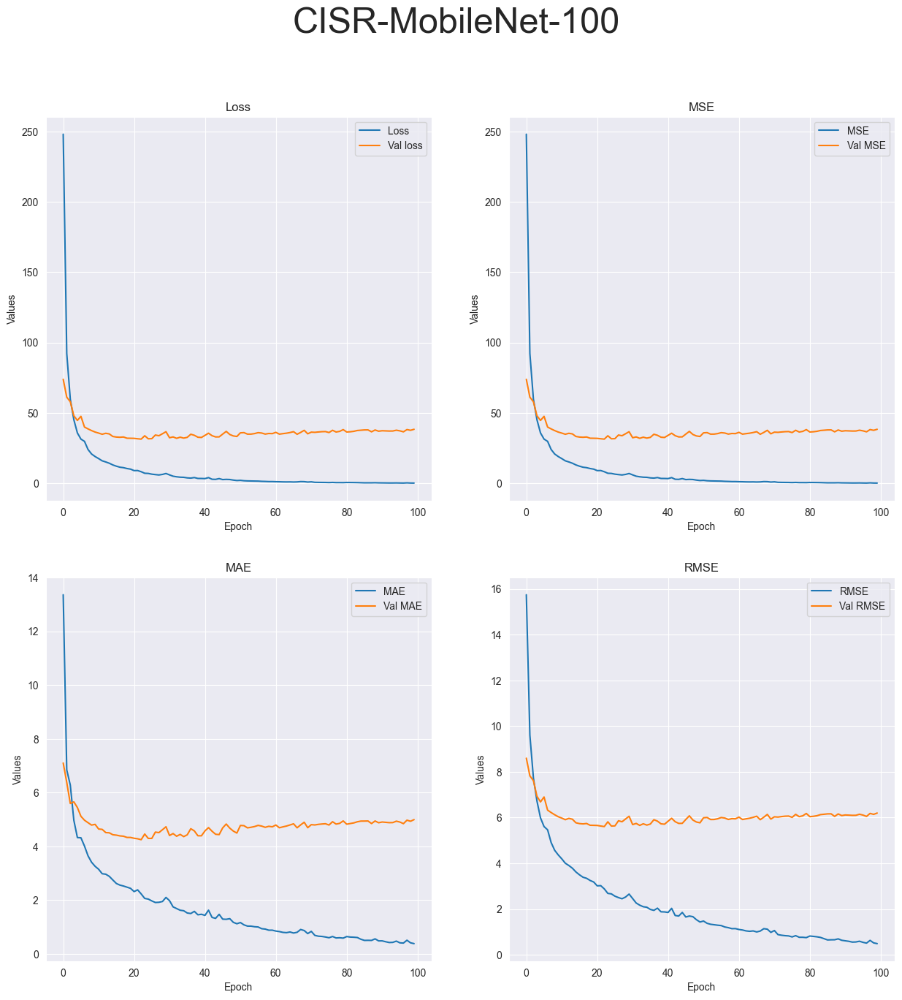

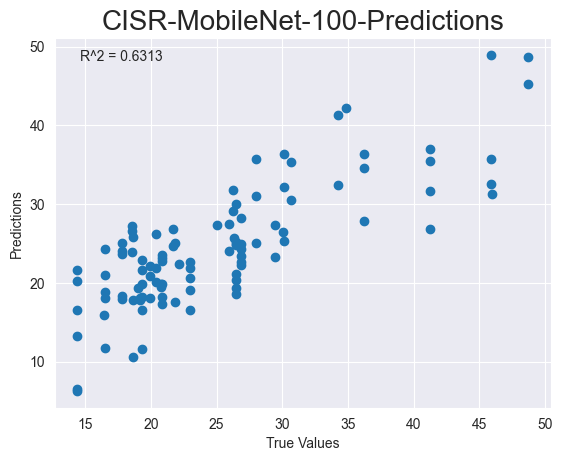


Running experiment Raw, dataset CISR, test Images, model MobileNet, epoch 300
Epoch 1/300


2023-05-03 17:12:38.137706: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 244.0897 - mse: 244.0897 - mae: 13.2831 - root_mean_squared_error: 15.6234

2023-05-03 17:12:46.998433: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 15s 934ms/step - loss: 244.0897 - mse: 244.0897 - mae: 13.2831 - root_mean_squared_error: 15.6234 - val_loss: 69.2410 - val_mse: 69.2410 - val_mae: 7.0835 - val_root_mean_squared_error: 8.3211
Epoch 2/300
11/11 [==============================] - 3s 314ms/step - loss: 96.4814 - mse: 96.4814 - mae: 7.1240 - root_mean_squared_error: 9.8225 - val_loss: 55.3530 - val_mse: 55.3530 - val_mae: 6.1979 - val_root_mean_squared_error: 7.4400
Epoch 3/300
11/11 [==============================] - 2s 196ms/step - loss: 60.9628 - mse: 60.9628 - mae: 6.4100 - root_mean_squared_error: 7.8079 - val_loss: 37.3857 - val_mse: 37.3857 - val_mae: 4.3358 - val_root_mean_squared_error: 6.1144
Epoch 4/300
11/11 [==============================] - 3s 332ms/step - loss: 44.3337 - mse: 44.3337 - mae: 4.9739 - root_mean_squared_error: 6.6584 - val_loss: 38.5255 - val_mse: 38.5255 - val_mae: 4.7337 - val_root_mean_squared_error: 6.2069
Epoch 5/300
11/11 [========================

2023-05-03 17:16:57.598880: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 7s 1s/step - loss: 41.5280 - mse: 41.5280 - mae: 4.5803 - root_mean_squared_error: 6.4442
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 140, 140, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 70, 70, 32)        864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 70, 70, 32)       128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 70, 70, 32)        0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 70, 70, 32)       288       
                                                                

<Figure size 640x480 with 0 Axes>

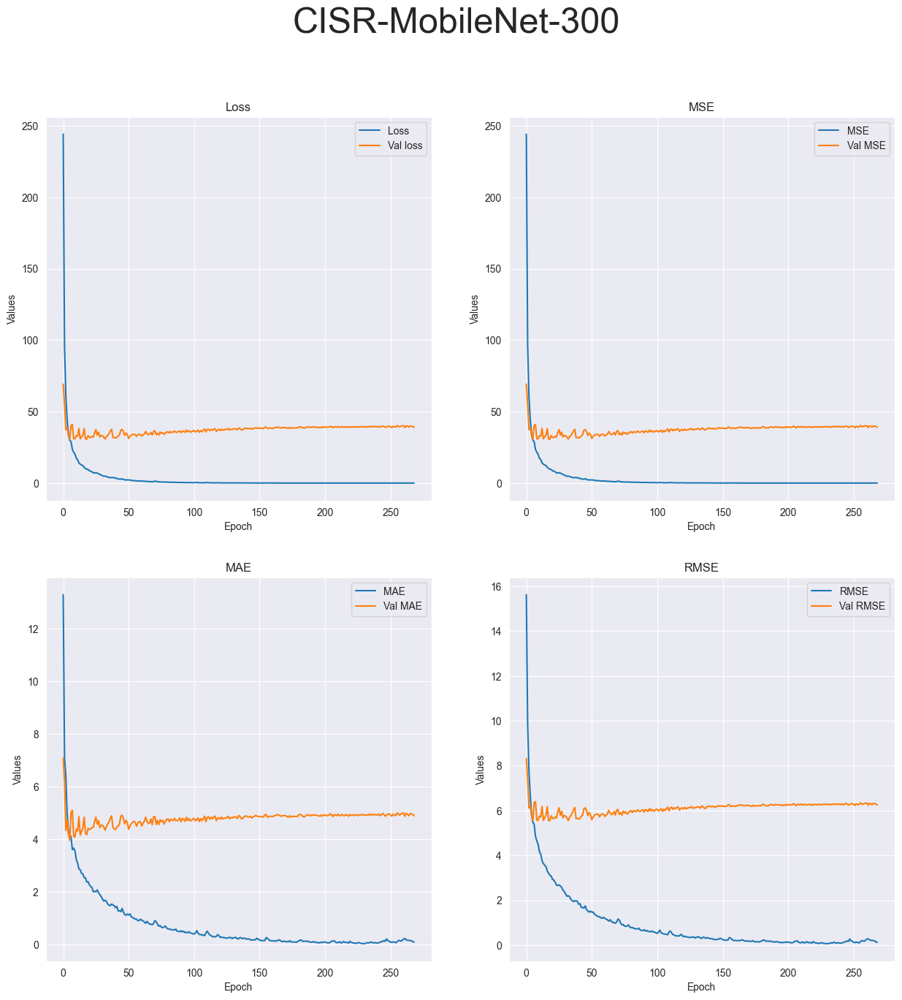

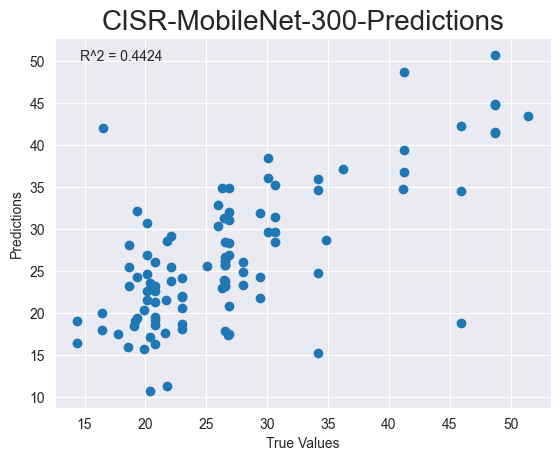

<Figure size 640x480 with 0 Axes>

In [18]:
results_dict_CNN3 = results_dict_CNN2.copy()

results_dict_CNN3 = run_all_experiments(experimentsCNNRawStrawberries, results_dict_CNN3)
with open("resultsCNN3.json", 'w') as f:
    json.dump(results_dict_CNN3, f)
with open("resultsCNNAll.json", 'w') as f:
    json.dump(results_dict_CNN3, f)

In [8]:
#PROVISIONAL

results_dict_CNN3 = {}
with open('resultsCNNAll.json') as json_file:
    results_dict_CNN3 = json.load(json_file)

print(results_dict_CNN3)

{'Raw': {'Images': {'CIBR': {'CNN': {'100': {'r2': -0.004041072212986885, 'loss': 0.425820529460907, 'mse': 0.425820529460907, 'mae': 0.4974079132080078, 'rmse': 0.6525492668151855}, '300': {'r2': -0.28635505761112245, 'loss': 0.3195154368877411, 'mse': 0.3195154368877411, 'mae': 0.44928333163261414, 'rmse': 0.5652569532394409}}, 'DenseNet': {'100': {'r2': -0.44493061337426054, 'loss': 1.0411388874053955, 'mse': 1.0411388874053955, 'mae': 0.8645024299621582, 'rmse': 1.020362138748169}, '300': {'r2': -0.9744979839520378, 'loss': 0.9882475137710571, 'mse': 0.9882475137710571, 'mae': 0.7977596521377563, 'rmse': 0.9941064119338989}}, 'MobileNet': {'100': {'r2': -0.5500927296410199, 'loss': 1.2789806127548218, 'mse': 1.2789806127548218, 'mae': 1.0103901624679565, 'rmse': 1.1309202909469604}, '300': {'r2': -2.0988388365925834, 'loss': 1.2886801958084106, 'mse': 1.2886801958084106, 'mae': 0.8523396253585815, 'rmse': 1.1352005004882812}}}, 'CIRR': {'CNN': {'100': {'r2': -0.007139206571461276, 

In [9]:
results_dict_CNN4 = results_dict_CNN3.copy()

results_dict_CNN4 = run_all_experiments(experimentsCNNYoloBlueberries, results_dict_CNN4)
with open("resultsCNN4.json", 'w') as f:
    json.dump(results_dict_CNN4, f)
with open("resultsCNNAll.json", 'w') as f:
    json.dump(results_dict_CNN4, f)

Running experiment YOLO, dataset CIBY, test Images, model CNN, epoch 100
Epoch 1/100


2023-05-03 17:28:27.624931: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-05-03 17:28:27.624954: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-05-03 17:28:27.763619: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-05-03 17:28:28.016963: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 203ms/step - loss: 967.6505 - mse: 967.6505 - mae: 23.8818 - root_mean_squared_error: 31.1071 - val_loss: 99.1353 - val_mse: 99.1353 - val_mae: 9.9331 - val_root_mean_squared_error: 9.9567
Epoch 2/100
1/3 [=========>....................] - ETA: 0s - loss: 95.7414 - mse: 95.7414 - mae: 9.7553 - root_mean_squared_error: 9.7848

2023-05-03 17:28:28.626714: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 95ms/step - loss: 88.0687 - mse: 88.0687 - mae: 9.3391 - root_mean_squared_error: 9.3845 - val_loss: 31.1700 - val_mse: 31.1700 - val_mae: 5.5170 - val_root_mean_squared_error: 5.5830
Epoch 3/100
3/3 [==============================] - 0s 78ms/step - loss: 27.2337 - mse: 27.2337 - mae: 4.2328 - root_mean_squared_error: 5.2186 - val_loss: 2.4658 - val_mse: 2.4658 - val_mae: 1.3415 - val_root_mean_squared_error: 1.5703
Epoch 4/100
3/3 [==============================] - 0s 76ms/step - loss: 13.9597 - mse: 13.9597 - mae: 3.2155 - root_mean_squared_error: 3.7363 - val_loss: 13.6698 - val_mse: 13.6698 - val_mae: 3.6041 - val_root_mean_squared_error: 3.6973
Epoch 5/100
3/3 [==============================] - 0s 81ms/step - loss: 10.4866 - mse: 10.4866 - mae: 2.5560 - root_mean_squared_error: 3.2383 - val_loss: 4.0162 - val_mse: 4.0162 - val_mae: 1.7255 - val_root_mean_squared_error: 2.0040
Epoch 6/100
3/3 [==============================] - 0s 87ms/step 

2023-05-03 17:28:50.980828: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Running experiment YOLO, dataset CIBY, test Images, model CNN, epoch 300
Epoch 1/300
1/3 [=========>....................] - ETA: 0s - loss: 92.8841 - mse: 92.8841 - mae: 9.6001 - root_mean_squared_error: 9.6376

2023-05-03 17:28:52.955494: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 170ms/step - loss: 1213.6674 - mse: 1213.6674 - mae: 26.4558 - root_mean_squared_error: 34.8377 - val_loss: 98.1852 - val_mse: 98.1852 - val_mae: 9.8857 - val_root_mean_squared_error: 9.9088
Epoch 2/300
1/3 [=========>....................] - ETA: 0s - loss: 100.9269 - mse: 100.9269 - mae: 10.0043 - root_mean_squared_error: 10.0462

2023-05-03 17:28:53.402858: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 81ms/step - loss: 90.6163 - mse: 90.6163 - mae: 9.4756 - root_mean_squared_error: 9.5193 - val_loss: 60.2130 - val_mse: 60.2130 - val_mae: 7.7282 - val_root_mean_squared_error: 7.7597
Epoch 3/300
3/3 [==============================] - 0s 76ms/step - loss: 32.1680 - mse: 32.1680 - mae: 5.3227 - root_mean_squared_error: 5.6717 - val_loss: 15.1122 - val_mse: 15.1122 - val_mae: 3.7015 - val_root_mean_squared_error: 3.8874
Epoch 4/300
3/3 [==============================] - 0s 77ms/step - loss: 6.9705 - mse: 6.9705 - mae: 2.1965 - root_mean_squared_error: 2.6402 - val_loss: 6.9081 - val_mse: 6.9081 - val_mae: 2.5117 - val_root_mean_squared_error: 2.6283
Epoch 5/300
3/3 [==============================] - 0s 76ms/step - loss: 3.4907 - mse: 3.4907 - mae: 1.6090 - root_mean_squared_error: 1.8683 - val_loss: 4.1647 - val_mse: 4.1647 - val_mae: 1.8434 - val_root_mean_squared_error: 2.0408
Epoch 6/300
3/3 [==============================] - 0s 76ms/step - lo

2023-05-03 17:30:00.542150: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment YOLO, dataset CIBY, test Images, model DenseNet, epoch 100
Epoch 1/100


2023-05-03 17:30:07.577712: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 34.4596 - mse: 34.4596 - mae: 4.8560 - root_mean_squared_error: 5.8702

2023-05-03 17:30:11.475548: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 9s 2s/step - loss: 34.4596 - mse: 34.4596 - mae: 4.8560 - root_mean_squared_error: 5.8702 - val_loss: 20.6584 - val_mse: 20.6584 - val_mae: 4.1896 - val_root_mean_squared_error: 4.5452
Epoch 2/100
3/3 [==============================] - 1s 338ms/step - loss: 29.6231 - mse: 29.6231 - mae: 5.1590 - root_mean_squared_error: 5.4427 - val_loss: 13.1816 - val_mse: 13.1816 - val_mae: 3.2482 - val_root_mean_squared_error: 3.6306
Epoch 3/100
3/3 [==============================] - 1s 283ms/step - loss: 7.5598 - mse: 7.5598 - mae: 2.1454 - root_mean_squared_error: 2.7495 - val_loss: 8.3953 - val_mse: 8.3953 - val_mae: 2.5819 - val_root_mean_squared_error: 2.8975
Epoch 4/100
3/3 [==============================] - 1s 437ms/step - loss: 11.2709 - mse: 11.2709 - mae: 3.2102 - root_mean_squared_error: 3.3572 - val_loss: 14.1476 - val_mse: 14.1476 - val_mae: 3.5505 - val_root_mean_squared_error: 3.7613
Epoch 5/100
3/3 [==============================] - 1s 256ms/ste

2023-05-03 17:31:20.101767: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 3s 3s/step - loss: 1.0935 - mse: 1.0935 - mae: 0.8240 - root_mean_squared_error: 1.0457
IM SAVING
Running experiment YOLO, dataset CIBY, test Images, model DenseNet, epoch 300
Epoch 1/300


2023-05-03 17:31:33.074741: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 34.7096 - mse: 34.7096 - mae: 4.8981 - root_mean_squared_error: 5.8915

2023-05-03 17:31:38.987388: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 13s 3s/step - loss: 34.7096 - mse: 34.7096 - mae: 4.8981 - root_mean_squared_error: 5.8915 - val_loss: 27.0806 - val_mse: 27.0806 - val_mae: 4.6914 - val_root_mean_squared_error: 5.2039
Epoch 2/300
3/3 [==============================] - 1s 410ms/step - loss: 28.7302 - mse: 28.7302 - mae: 5.1069 - root_mean_squared_error: 5.3601 - val_loss: 19.3204 - val_mse: 19.3204 - val_mae: 3.8697 - val_root_mean_squared_error: 4.3955
Epoch 3/300
3/3 [==============================] - 1s 268ms/step - loss: 7.1584 - mse: 7.1584 - mae: 2.1161 - root_mean_squared_error: 2.6755 - val_loss: 6.9693 - val_mse: 6.9693 - val_mae: 2.4716 - val_root_mean_squared_error: 2.6399
Epoch 4/300
3/3 [==============================] - 1s 271ms/step - loss: 10.3543 - mse: 10.3543 - mae: 3.0542 - root_mean_squared_error: 3.2178 - val_loss: 14.6154 - val_mse: 14.6154 - val_mae: 3.6564 - val_root_mean_squared_error: 3.8230
Epoch 5/300
3/3 [==============================] - 1s 238ms/st

2023-05-03 17:35:07.607147: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 3s 3s/step - loss: 1.1243 - mse: 1.1243 - mae: 0.8774 - root_mean_squared_error: 1.0603
IM SAVING
Running experiment YOLO, dataset CIBY, test Images, model MobileNet, epoch 100
Epoch 1/100


2023-05-03 17:35:17.119980: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 41.0379 - mse: 41.0379 - mae: 5.1959 - root_mean_squared_error: 6.4061

2023-05-03 17:35:18.815424: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 653ms/step - loss: 41.0379 - mse: 41.0379 - mae: 5.1959 - root_mean_squared_error: 6.4061 - val_loss: 54.9814 - val_mse: 54.9814 - val_mae: 6.9600 - val_root_mean_squared_error: 7.4149
Epoch 2/100
3/3 [==============================] - 0s 108ms/step - loss: 41.9617 - mse: 41.9617 - mae: 6.0061 - root_mean_squared_error: 6.4778 - val_loss: 3.8994 - val_mse: 3.8994 - val_mae: 1.6650 - val_root_mean_squared_error: 1.9747
Epoch 3/100
3/3 [==============================] - 0s 74ms/step - loss: 7.9092 - mse: 7.9092 - mae: 2.3620 - root_mean_squared_error: 2.8123 - val_loss: 23.9300 - val_mse: 23.9300 - val_mae: 4.7586 - val_root_mean_squared_error: 4.8918
Epoch 4/100
3/3 [==============================] - 0s 86ms/step - loss: 20.2651 - mse: 20.2651 - mae: 4.3611 - root_mean_squared_error: 4.5017 - val_loss: 3.4638 - val_mse: 3.4638 - val_mae: 1.3964 - val_root_mean_squared_error: 1.8611
Epoch 5/100
3/3 [==============================] - 0s 85ms/step 

2023-05-03 17:35:41.046816: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 1s 787ms/step - loss: 1.6164 - mse: 1.6164 - mae: 1.0609 - root_mean_squared_error: 1.2714
IM SAVING
Running experiment YOLO, dataset CIBY, test Images, model MobileNet, epoch 300
Epoch 1/300


2023-05-03 17:35:45.923446: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 43.5236 - mse: 43.5236 - mae: 5.5150 - root_mean_squared_error: 6.5972

2023-05-03 17:35:47.411200: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 582ms/step - loss: 43.5236 - mse: 43.5236 - mae: 5.5150 - root_mean_squared_error: 6.5972 - val_loss: 57.8771 - val_mse: 57.8771 - val_mae: 7.3924 - val_root_mean_squared_error: 7.6077
Epoch 2/300
3/3 [==============================] - 0s 82ms/step - loss: 36.7942 - mse: 36.7942 - mae: 5.3699 - root_mean_squared_error: 6.0658 - val_loss: 2.4740 - val_mse: 2.4740 - val_mae: 1.2524 - val_root_mean_squared_error: 1.5729
Epoch 3/300
3/3 [==============================] - 0s 162ms/step - loss: 9.4919 - mse: 9.4919 - mae: 2.6360 - root_mean_squared_error: 3.0809 - val_loss: 16.8382 - val_mse: 16.8382 - val_mae: 3.9871 - val_root_mean_squared_error: 4.1034
Epoch 4/300
3/3 [==============================] - 0s 68ms/step - loss: 15.6241 - mse: 15.6241 - mae: 3.6851 - root_mean_squared_error: 3.9527 - val_loss: 1.2402 - val_mse: 1.2402 - val_mae: 0.9047 - val_root_mean_squared_error: 1.1136
Epoch 5/300
3/3 [==============================] - 0s 69ms/step 

2023-05-03 17:36:47.558328: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 1s 585ms/step - loss: 1.0313 - mse: 1.0313 - mae: 0.8124 - root_mean_squared_error: 1.0155
IM SAVING


<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

In [10]:
results_dict_CNN5 = results_dict_CNN4.copy()

results_dict_CNN5 = run_all_experiments(experimentsCNNYoloRaspberries, results_dict_CNN5)
with open("resultsCNN5.json", 'w') as f:
    json.dump(results_dict_CNN5, f)
with open("resultsCNNAll.json", 'w') as f:
    json.dump(results_dict_CNN5, f)

Running experiment YOLO, dataset CIRY, test Images, model CNN, epoch 100
Epoch 1/100


2023-05-03 17:38:03.434146: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 2025.3927 - mse: 2025.3927 - mae: 13.0425 - root_mean_squared_error: 45.0044

2023-05-03 17:38:05.693934: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 3s 127ms/step - loss: 2025.3927 - mse: 2025.3927 - mae: 13.0425 - root_mean_squared_error: 45.0044 - val_loss: 0.6458 - val_mse: 0.6458 - val_mae: 0.6113 - val_root_mean_squared_error: 0.8036
Epoch 2/100
16/16 [==============================] - 1s 89ms/step - loss: 0.7158 - mse: 0.7158 - mae: 0.6812 - root_mean_squared_error: 0.8460 - val_loss: 0.6091 - val_mse: 0.6091 - val_mae: 0.6185 - val_root_mean_squared_error: 0.7804
Epoch 3/100
16/16 [==============================] - 1s 75ms/step - loss: 0.6848 - mse: 0.6848 - mae: 0.6664 - root_mean_squared_error: 0.8276 - val_loss: 0.7171 - val_mse: 0.7171 - val_mae: 0.7205 - val_root_mean_squared_error: 0.8468
Epoch 4/100
16/16 [==============================] - 1s 72ms/step - loss: 0.7041 - mse: 0.7041 - mae: 0.6780 - root_mean_squared_error: 0.8391 - val_loss: 0.6973 - val_mse: 0.6973 - val_mae: 0.6286 - val_root_mean_squared_error: 0.8350
Epoch 5/100
16/16 [==============================] - 1s 69m

2023-05-03 17:39:57.534963: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 67ms/step - loss: 0.6661 - mse: 0.6661 - mae: 0.6527 - root_mean_squared_error: 0.8161
IM SAVING
Running experiment YOLO, dataset CIRY, test Images, model CNN, epoch 300
Epoch 1/300


2023-05-03 17:40:01.506516: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 1033.4967 - mse: 1033.4967 - mae: 10.0209 - root_mean_squared_error: 32.1480

2023-05-03 17:40:03.759595: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 3s 126ms/step - loss: 1033.4967 - mse: 1033.4967 - mae: 10.0209 - root_mean_squared_error: 32.1480 - val_loss: 0.6985 - val_mse: 0.6985 - val_mae: 0.7088 - val_root_mean_squared_error: 0.8358
Epoch 2/300
16/16 [==============================] - 1s 76ms/step - loss: 0.7233 - mse: 0.7233 - mae: 0.6667 - root_mean_squared_error: 0.8505 - val_loss: 0.6942 - val_mse: 0.6942 - val_mae: 0.7031 - val_root_mean_squared_error: 0.8332
Epoch 3/300
16/16 [==============================] - 1s 70ms/step - loss: 0.7000 - mse: 0.7000 - mae: 0.6649 - root_mean_squared_error: 0.8367 - val_loss: 0.6546 - val_mse: 0.6546 - val_mae: 0.6612 - val_root_mean_squared_error: 0.8091
Epoch 4/300
16/16 [==============================] - 1s 72ms/step - loss: 0.8287 - mse: 0.8287 - mae: 0.7319 - root_mean_squared_error: 0.9103 - val_loss: 0.6903 - val_mse: 0.6903 - val_mae: 0.7000 - val_root_mean_squared_error: 0.8309
Epoch 5/300
16/16 [==============================] - 1s 73m

2023-05-03 17:46:19.276078: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 55ms/step - loss: 0.6635 - mse: 0.6635 - mae: 0.6771 - root_mean_squared_error: 0.8146
IM SAVING
Running experiment YOLO, dataset CIRY, test Images, model DenseNet, epoch 100
Epoch 1/100


2023-05-03 17:46:28.409945: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 7.6439 - mse: 7.6439 - mae: 2.2722 - root_mean_squared_error: 2.7648

2023-05-03 17:46:36.827843: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 17s 718ms/step - loss: 7.6439 - mse: 7.6439 - mae: 2.2722 - root_mean_squared_error: 2.7648 - val_loss: 1.0522 - val_mse: 1.0522 - val_mae: 0.8082 - val_root_mean_squared_error: 1.0258
Epoch 2/100
16/16 [==============================] - 4s 221ms/step - loss: 1.7579 - mse: 1.7579 - mae: 1.0637 - root_mean_squared_error: 1.3259 - val_loss: 1.3333 - val_mse: 1.3333 - val_mae: 0.9633 - val_root_mean_squared_error: 1.1547
Epoch 3/100
16/16 [==============================] - 4s 240ms/step - loss: 0.9841 - mse: 0.9841 - mae: 0.8070 - root_mean_squared_error: 0.9920 - val_loss: 0.7182 - val_mse: 0.7182 - val_mae: 0.6742 - val_root_mean_squared_error: 0.8474
Epoch 4/100
16/16 [==============================] - 3s 211ms/step - loss: 0.7055 - mse: 0.7055 - mae: 0.6881 - root_mean_squared_error: 0.8400 - val_loss: 0.8181 - val_mse: 0.8181 - val_mae: 0.7382 - val_root_mean_squared_error: 0.9045
Epoch 5/100
16/16 [==============================] - 4s 227ms/s

2023-05-03 17:52:43.265142: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 8s 970ms/step - loss: 0.7351 - mse: 0.7351 - mae: 0.6832 - root_mean_squared_error: 0.8574
IM SAVING
Running experiment YOLO, dataset CIRY, test Images, model DenseNet, epoch 300
Epoch 1/300


2023-05-03 17:53:04.844316: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 7.7853 - mse: 7.7853 - mae: 2.2986 - root_mean_squared_error: 2.7902

2023-05-03 17:53:15.836454: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 23s 944ms/step - loss: 7.7853 - mse: 7.7853 - mae: 2.2986 - root_mean_squared_error: 2.7902 - val_loss: 1.2738 - val_mse: 1.2738 - val_mae: 0.9319 - val_root_mean_squared_error: 1.1286
Epoch 2/300
16/16 [==============================] - 4s 230ms/step - loss: 2.2689 - mse: 2.2689 - mae: 1.2321 - root_mean_squared_error: 1.5063 - val_loss: 1.1804 - val_mse: 1.1804 - val_mae: 0.9092 - val_root_mean_squared_error: 1.0865
Epoch 3/300
16/16 [==============================] - 4s 256ms/step - loss: 0.9990 - mse: 0.9990 - mae: 0.8028 - root_mean_squared_error: 0.9995 - val_loss: 0.8348 - val_mse: 0.8348 - val_mae: 0.7226 - val_root_mean_squared_error: 0.9137
Epoch 4/300
16/16 [==============================] - 6s 364ms/step - loss: 0.6482 - mse: 0.6482 - mae: 0.6442 - root_mean_squared_error: 0.8051 - val_loss: 0.7920 - val_mse: 0.7920 - val_mae: 0.7075 - val_root_mean_squared_error: 0.8899
Epoch 5/300
16/16 [==============================] - 7s 435ms/s

2023-05-03 18:09:44.973019: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 12s 2s/step - loss: 0.9420 - mse: 0.9420 - mae: 0.7225 - root_mean_squared_error: 0.9706
IM SAVING
Running experiment YOLO, dataset CIRY, test Images, model MobileNet, epoch 100
Epoch 1/100


2023-05-03 18:10:06.291180: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 5.4163 - mse: 5.4163 - mae: 1.9322 - root_mean_squared_error: 2.3273

2023-05-03 18:10:11.049822: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 9s 311ms/step - loss: 5.4163 - mse: 5.4163 - mae: 1.9322 - root_mean_squared_error: 2.3273 - val_loss: 1.2000 - val_mse: 1.2000 - val_mae: 0.8950 - val_root_mean_squared_error: 1.0954
Epoch 2/100
16/16 [==============================] - 1s 76ms/step - loss: 1.1787 - mse: 1.1787 - mae: 0.8654 - root_mean_squared_error: 1.0857 - val_loss: 1.0117 - val_mse: 1.0117 - val_mae: 0.8084 - val_root_mean_squared_error: 1.0058
Epoch 3/100
16/16 [==============================] - 1s 66ms/step - loss: 0.6292 - mse: 0.6292 - mae: 0.6292 - root_mean_squared_error: 0.7932 - val_loss: 0.8240 - val_mse: 0.8240 - val_mae: 0.7314 - val_root_mean_squared_error: 0.9078
Epoch 4/100
16/16 [==============================] - 1s 70ms/step - loss: 0.4573 - mse: 0.4573 - mae: 0.5422 - root_mean_squared_error: 0.6762 - val_loss: 0.6794 - val_mse: 0.6794 - val_mae: 0.6751 - val_root_mean_squared_error: 0.8243
Epoch 5/100
16/16 [==============================] - 1s 80ms/step -

2023-05-03 18:12:16.383476: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 3s 349ms/step - loss: 2.6454 - mse: 2.6454 - mae: 1.3916 - root_mean_squared_error: 1.6265
IM SAVING
Running experiment YOLO, dataset CIRY, test Images, model MobileNet, epoch 300
Epoch 1/300


2023-05-03 18:12:28.247089: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 5.3790 - mse: 5.3790 - mae: 1.9083 - root_mean_squared_error: 2.3193

2023-05-03 18:12:32.381601: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 10s 350ms/step - loss: 5.3790 - mse: 5.3790 - mae: 1.9083 - root_mean_squared_error: 2.3193 - val_loss: 1.0517 - val_mse: 1.0517 - val_mae: 0.8318 - val_root_mean_squared_error: 1.0255
Epoch 2/300
16/16 [==============================] - 2s 112ms/step - loss: 1.3775 - mse: 1.3775 - mae: 0.9567 - root_mean_squared_error: 1.1737 - val_loss: 0.7162 - val_mse: 0.7162 - val_mae: 0.6523 - val_root_mean_squared_error: 0.8463
Epoch 3/300
16/16 [==============================] - 1s 84ms/step - loss: 0.6096 - mse: 0.6096 - mae: 0.6279 - root_mean_squared_error: 0.7807 - val_loss: 0.6863 - val_mse: 0.6863 - val_mae: 0.6586 - val_root_mean_squared_error: 0.8284
Epoch 4/300
16/16 [==============================] - 1s 73ms/step - loss: 0.4586 - mse: 0.4586 - mae: 0.5528 - root_mean_squared_error: 0.6772 - val_loss: 0.5068 - val_mse: 0.5068 - val_mae: 0.5845 - val_root_mean_squared_error: 0.7119
Epoch 5/300
16/16 [==============================] - 1s 68ms/step

2023-05-03 18:17:59.569229: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 4s 599ms/step - loss: 0.8684 - mse: 0.8684 - mae: 0.7244 - root_mean_squared_error: 0.9319
IM SAVING


<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

In [7]:
#PROVISIONAL

results_dict_CNN5 = {}
with open('resultsCNNAll.json') as json_file:
    results_dict_CNN5 = json.load(json_file)

print(results_dict_CNN5)

{'Raw': {'Images': {'CIBR': {'CNN': {'100': {'r2': -0.004041072212986885, 'loss': 0.425820529460907, 'mse': 0.425820529460907, 'mae': 0.4974079132080078, 'rmse': 0.6525492668151855}, '300': {'r2': -0.28635505761112245, 'loss': 0.3195154368877411, 'mse': 0.3195154368877411, 'mae': 0.44928333163261414, 'rmse': 0.5652569532394409}}, 'DenseNet': {'100': {'r2': -0.44493061337426054, 'loss': 1.0411388874053955, 'mse': 1.0411388874053955, 'mae': 0.8645024299621582, 'rmse': 1.020362138748169}, '300': {'r2': -0.9744979839520378, 'loss': 0.9882475137710571, 'mse': 0.9882475137710571, 'mae': 0.7977596521377563, 'rmse': 0.9941064119338989}}, 'MobileNet': {'100': {'r2': -0.5500927296410199, 'loss': 1.2789806127548218, 'mse': 1.2789806127548218, 'mae': 1.0103901624679565, 'rmse': 1.1309202909469604}, '300': {'r2': -2.0988388365925834, 'loss': 1.2886801958084106, 'mse': 1.2886801958084106, 'mae': 0.8523396253585815, 'rmse': 1.1352005004882812}}}, 'CIRR': {'CNN': {'100': {'r2': -0.007139206571461276, 

In [8]:
results_dict_CNN6 = results_dict_CNN5.copy()

results_dict_CNN6 = run_all_experiments(experimentsCNNYoloStrawberries, results_dict_CNN6)
with open("resultsCNN6.json", 'w') as f:
    json.dump(results_dict_CNN6, f)
with open("resultsCNNAll.json", 'w') as f:
    json.dump(results_dict_CNN6, f)

Running experiment YOLO, dataset CISY, test Images, model CNN, epoch 100
Epoch 1/100


2023-05-03 18:21:48.742761: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-05-03 18:21:48.742785: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-05-03 18:21:48.924674: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-05-03 18:21:49.165040: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 97ms/step - loss: 2163.0286 - mse: 2163.0286 - mae: 33.4019 - root_mean_squared_error: 46.5084 - val_loss: 494.0356 - val_mse: 494.0356 - val_mae: 20.2543 - val_root_mean_squared_error: 22.2269
Epoch 2/100


2023-05-03 18:21:50.322847: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 67ms/step - loss: 195.4960 - mse: 195.4960 - mae: 10.6506 - root_mean_squared_error: 13.9820 - val_loss: 103.3689 - val_mse: 103.3689 - val_mae: 9.0728 - val_root_mean_squared_error: 10.1670
Epoch 3/100
11/11 [==============================] - 1s 69ms/step - loss: 108.2377 - mse: 108.2377 - mae: 8.4358 - root_mean_squared_error: 10.4037 - val_loss: 87.4665 - val_mse: 87.4665 - val_mae: 6.6962 - val_root_mean_squared_error: 9.3524
Epoch 4/100
11/11 [==============================] - 1s 69ms/step - loss: 85.6312 - mse: 85.6312 - mae: 7.0490 - root_mean_squared_error: 9.2537 - val_loss: 82.7264 - val_mse: 82.7264 - val_mae: 7.8087 - val_root_mean_squared_error: 9.0954
Epoch 5/100
11/11 [==============================] - 1s 70ms/step - loss: 82.1736 - mse: 82.1736 - mae: 6.9291 - root_mean_squared_error: 9.0650 - val_loss: 67.5464 - val_mse: 67.5464 - val_mae: 6.4950 - val_root_mean_squared_error: 8.2187
Epoch 6/100
11/11 [=======================

2023-05-03 18:23:05.038395: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 42ms/step - loss: 73.9549 - mse: 73.9549 - mae: 7.2390 - root_mean_squared_error: 8.5997
IM SAVING
Running experiment YOLO, dataset CISY, test Images, model CNN, epoch 300
Epoch 1/300


2023-05-03 18:23:07.603833: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 97ms/step - loss: 2001.2042 - mse: 2001.2042 - mae: 32.5893 - root_mean_squared_error: 44.7348 - val_loss: 212.4178 - val_mse: 212.4178 - val_mae: 11.3406 - val_root_mean_squared_error: 14.5746
Epoch 2/300


2023-05-03 18:23:08.699188: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 68ms/step - loss: 134.6252 - mse: 134.6252 - mae: 9.7152 - root_mean_squared_error: 11.6028 - val_loss: 109.5641 - val_mse: 109.5641 - val_mae: 7.6199 - val_root_mean_squared_error: 10.4673
Epoch 3/300
11/11 [==============================] - 1s 67ms/step - loss: 105.4652 - mse: 105.4652 - mae: 7.1499 - root_mean_squared_error: 10.2696 - val_loss: 90.6462 - val_mse: 90.6462 - val_mae: 7.7317 - val_root_mean_squared_error: 9.5208
Epoch 4/300
11/11 [==============================] - 1s 67ms/step - loss: 88.5505 - mse: 88.5505 - mae: 7.8573 - root_mean_squared_error: 9.4101 - val_loss: 104.4128 - val_mse: 104.4128 - val_mae: 7.5464 - val_root_mean_squared_error: 10.2183
Epoch 5/300
11/11 [==============================] - 1s 67ms/step - loss: 81.2411 - mse: 81.2411 - mae: 6.6213 - root_mean_squared_error: 9.0134 - val_loss: 89.9580 - val_mse: 89.9580 - val_mae: 7.6408 - val_root_mean_squared_error: 9.4846
Epoch 6/300
11/11 [=====================

2023-05-03 18:26:51.263278: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 39ms/step - loss: 140.9573 - mse: 140.9573 - mae: 8.7390 - root_mean_squared_error: 11.8725
IM SAVING
Running experiment YOLO, dataset CISY, test Images, model DenseNet, epoch 100
Epoch 1/100


2023-05-03 18:27:00.474082: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 261.2612 - mse: 261.2612 - mae: 13.0877 - root_mean_squared_error: 16.1636

2023-05-03 18:27:06.974020: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 13s 781ms/step - loss: 261.2612 - mse: 261.2612 - mae: 13.0877 - root_mean_squared_error: 16.1636 - val_loss: 205.2877 - val_mse: 205.2877 - val_mae: 12.8428 - val_root_mean_squared_error: 14.3279
Epoch 2/100
11/11 [==============================] - 3s 244ms/step - loss: 109.6961 - mse: 109.6961 - mae: 8.3257 - root_mean_squared_error: 10.4736 - val_loss: 95.1518 - val_mse: 95.1518 - val_mae: 6.8903 - val_root_mean_squared_error: 9.7546
Epoch 3/100
11/11 [==============================] - 2s 191ms/step - loss: 65.3827 - mse: 65.3827 - mae: 6.1895 - root_mean_squared_error: 8.0860 - val_loss: 77.7687 - val_mse: 77.7687 - val_mae: 7.5923 - val_root_mean_squared_error: 8.8187
Epoch 4/100
11/11 [==============================] - 2s 200ms/step - loss: 53.5835 - mse: 53.5835 - mae: 5.7279 - root_mean_squared_error: 7.3201 - val_loss: 57.7104 - val_mse: 57.7104 - val_mae: 5.4818 - val_root_mean_squared_error: 7.5967
Epoch 5/100
11/11 [=================

2023-05-03 18:30:58.763597: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 7s 949ms/step - loss: 30.9414 - mse: 30.9414 - mae: 4.1752 - root_mean_squared_error: 5.5625
IM SAVING
Running experiment YOLO, dataset CISY, test Images, model DenseNet, epoch 300
Epoch 1/300


2023-05-03 18:31:17.141776: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 290.8603 - mse: 290.8603 - mae: 14.2774 - root_mean_squared_error: 17.0546

2023-05-03 18:31:24.939478: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 18s 1s/step - loss: 290.8603 - mse: 290.8603 - mae: 14.2774 - root_mean_squared_error: 17.0546 - val_loss: 146.8963 - val_mse: 146.8963 - val_mae: 10.8693 - val_root_mean_squared_error: 12.1201
Epoch 2/300
11/11 [==============================] - 3s 209ms/step - loss: 103.6209 - mse: 103.6209 - mae: 7.9086 - root_mean_squared_error: 10.1794 - val_loss: 138.4895 - val_mse: 138.4895 - val_mae: 8.2077 - val_root_mean_squared_error: 11.7682
Epoch 3/300
11/11 [==============================] - 2s 202ms/step - loss: 69.4450 - mse: 69.4450 - mae: 6.4832 - root_mean_squared_error: 8.3334 - val_loss: 82.7230 - val_mse: 82.7230 - val_mae: 7.8346 - val_root_mean_squared_error: 9.0952
Epoch 4/300
11/11 [==============================] - 3s 250ms/step - loss: 53.0397 - mse: 53.0397 - mae: 5.7119 - root_mean_squared_error: 7.2828 - val_loss: 84.2392 - val_mse: 84.2392 - val_mae: 6.6753 - val_root_mean_squared_error: 9.1782
Epoch 5/300
11/11 [=================

2023-05-03 18:43:53.966752: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 8s 1s/step - loss: 52.4744 - mse: 52.4744 - mae: 5.5359 - root_mean_squared_error: 7.2439
IM SAVING
Running experiment YOLO, dataset CISY, test Images, model MobileNet, epoch 100
Epoch 1/100


2023-05-03 18:44:09.337836: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 227.8285 - mse: 227.8285 - mae: 12.7789 - root_mean_squared_error: 15.0940

2023-05-03 18:44:11.576675: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 4s 231ms/step - loss: 227.8285 - mse: 227.8285 - mae: 12.7789 - root_mean_squared_error: 15.0940 - val_loss: 73.5124 - val_mse: 73.5124 - val_mae: 6.5586 - val_root_mean_squared_error: 8.5739
Epoch 2/100
11/11 [==============================] - 1s 64ms/step - loss: 98.5014 - mse: 98.5014 - mae: 7.1861 - root_mean_squared_error: 9.9248 - val_loss: 64.0000 - val_mse: 64.0000 - val_mae: 6.2937 - val_root_mean_squared_error: 8.0000
Epoch 3/100
11/11 [==============================] - 1s 57ms/step - loss: 74.0278 - mse: 74.0278 - mae: 7.2276 - root_mean_squared_error: 8.6039 - val_loss: 71.3287 - val_mse: 71.3287 - val_mae: 5.9349 - val_root_mean_squared_error: 8.4456
Epoch 4/100
11/11 [==============================] - 1s 60ms/step - loss: 50.6313 - mse: 50.6313 - mae: 5.0621 - root_mean_squared_error: 7.1156 - val_loss: 45.5575 - val_mse: 45.5575 - val_mae: 5.3080 - val_root_mean_squared_error: 6.7496
Epoch 5/100
11/11 [============================

2023-05-03 18:45:29.383750: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 2s 204ms/step - loss: 41.8257 - mse: 41.8257 - mae: 5.0129 - root_mean_squared_error: 6.4673
IM SAVING
Running experiment YOLO, dataset CISY, test Images, model MobileNet, epoch 300
Epoch 1/300


2023-05-03 18:45:35.726820: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 216.1817 - mse: 216.1817 - mae: 12.5381 - root_mean_squared_error: 14.7031

2023-05-03 18:45:37.708060: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 4s 215ms/step - loss: 216.1817 - mse: 216.1817 - mae: 12.5381 - root_mean_squared_error: 14.7031 - val_loss: 77.6872 - val_mse: 77.6872 - val_mae: 7.4193 - val_root_mean_squared_error: 8.8140
Epoch 2/300
11/11 [==============================] - 1s 66ms/step - loss: 86.4163 - mse: 86.4163 - mae: 6.8123 - root_mean_squared_error: 9.2960 - val_loss: 61.9747 - val_mse: 61.9747 - val_mae: 6.4263 - val_root_mean_squared_error: 7.8724
Epoch 3/300
11/11 [==============================] - 1s 54ms/step - loss: 58.6736 - mse: 58.6736 - mae: 6.2676 - root_mean_squared_error: 7.6599 - val_loss: 50.7065 - val_mse: 50.7065 - val_mae: 5.4472 - val_root_mean_squared_error: 7.1209
Epoch 4/300
11/11 [==============================] - 1s 72ms/step - loss: 48.1767 - mse: 48.1767 - mae: 5.1126 - root_mean_squared_error: 6.9409 - val_loss: 48.0978 - val_mse: 48.0978 - val_mae: 5.4882 - val_root_mean_squared_error: 6.9353
Epoch 5/300
11/11 [============================

2023-05-03 18:49:15.608423: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 2s 271ms/step - loss: 36.3969 - mse: 36.3969 - mae: 4.5554 - root_mean_squared_error: 6.0330
IM SAVING


<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

In [7]:
#AQUI ME QUEDEEEEEEEE

#PROVISIONAL

results_dict_CNN6 = {}
with open('resultsCNNAll.json') as json_file:
    results_dict_CNN6 = json.load(json_file)

print(results_dict_CNN6)

{'Raw': {'Images': {'CIBR': {'CNN': {'100': {'r2': -0.004041072212986885, 'loss': 0.425820529460907, 'mse': 0.425820529460907, 'mae': 0.4974079132080078, 'rmse': 0.6525492668151855}, '300': {'r2': -0.28635505761112245, 'loss': 0.3195154368877411, 'mse': 0.3195154368877411, 'mae': 0.44928333163261414, 'rmse': 0.5652569532394409}}, 'DenseNet': {'100': {'r2': -0.44493061337426054, 'loss': 1.0411388874053955, 'mse': 1.0411388874053955, 'mae': 0.8645024299621582, 'rmse': 1.020362138748169}, '300': {'r2': -0.9744979839520378, 'loss': 0.9882475137710571, 'mse': 0.9882475137710571, 'mae': 0.7977596521377563, 'rmse': 0.9941064119338989}}, 'MobileNet': {'100': {'r2': -0.5500927296410199, 'loss': 1.2789806127548218, 'mse': 1.2789806127548218, 'mae': 1.0103901624679565, 'rmse': 1.1309202909469604}, '300': {'r2': -2.0988388365925834, 'loss': 1.2886801958084106, 'mse': 1.2886801958084106, 'mae': 0.8523396253585815, 'rmse': 1.1352005004882812}}}, 'CIRR': {'CNN': {'100': {'r2': -0.007139206571461276, 

In [8]:
results_dict_CNN7 = results_dict_CNN6.copy()

results_dict_CNN7 = run_all_experiments(experimentsCNNDetectronBlueberries, results_dict_CNN7)
with open("resultsCNN7.json", 'w') as f:
    json.dump(results_dict_CNN7, f)
with open("resultsCNNAll.json", 'w') as f:
    json.dump(results_dict_CNN7, f)

Running experiment Detectron2, dataset CIBD, test Images, model CNN, epoch 100


2023-05-03 19:05:20.468410: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-05-03 19:05:20.468439: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-05-03 19:05:20.675136: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


Epoch 1/100


2023-05-03 19:05:20.958319: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 223ms/step - loss: 2255.6567 - mse: 2255.6567 - mae: 33.9435 - root_mean_squared_error: 47.4938 - val_loss: 102.8239 - val_mse: 102.8239 - val_mae: 10.1062 - val_root_mean_squared_error: 10.1402
Epoch 2/100
1/3 [=========>....................] - ETA: 0s - loss: 99.0326 - mse: 99.0326 - mae: 9.9214 - root_mean_squared_error: 9.9515

2023-05-03 19:05:21.648612: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 84ms/step - loss: 83.6637 - mse: 83.6637 - mae: 9.0813 - root_mean_squared_error: 9.1468 - val_loss: 20.6257 - val_mse: 20.6257 - val_mae: 4.4492 - val_root_mean_squared_error: 4.5416
Epoch 3/100
3/3 [==============================] - 0s 78ms/step - loss: 17.9073 - mse: 17.9073 - mae: 3.0954 - root_mean_squared_error: 4.2317 - val_loss: 1.1303 - val_mse: 1.1303 - val_mae: 0.8211 - val_root_mean_squared_error: 1.0632
Epoch 4/100
3/3 [==============================] - 0s 80ms/step - loss: 2.5938 - mse: 2.5938 - mae: 1.1587 - root_mean_squared_error: 1.6105 - val_loss: 1.6885 - val_mse: 1.6885 - val_mae: 1.1248 - val_root_mean_squared_error: 1.2994
Epoch 5/100
3/3 [==============================] - 0s 80ms/step - loss: 1.4009 - mse: 1.4009 - mae: 0.9055 - root_mean_squared_error: 1.1836 - val_loss: 1.5743 - val_mse: 1.5743 - val_mae: 1.1359 - val_root_mean_squared_error: 1.2547
Epoch 6/100
3/3 [==============================] - 0s 78ms/step - loss

2023-05-03 19:05:43.852110: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset CIBD, test Images, model CNN, epoch 300
Epoch 1/300


2023-05-03 19:05:45.901391: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 196ms/step - loss: 2811.7256 - mse: 2811.7256 - mae: 34.3196 - root_mean_squared_error: 53.0257 - val_loss: 97.7555 - val_mse: 97.7555 - val_mae: 9.8336 - val_root_mean_squared_error: 9.8871
Epoch 2/300
1/3 [=========>....................] - ETA: 0s - loss: 95.5392 - mse: 95.5392 - mae: 9.7569 - root_mean_squared_error: 9.7744

2023-05-03 19:05:46.420995: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 83ms/step - loss: 88.8911 - mse: 88.8911 - mae: 9.3990 - root_mean_squared_error: 9.4282 - val_loss: 59.0877 - val_mse: 59.0877 - val_mae: 7.6243 - val_root_mean_squared_error: 7.6869
Epoch 3/300
3/3 [==============================] - 0s 75ms/step - loss: 47.1556 - mse: 47.1556 - mae: 6.0200 - root_mean_squared_error: 6.8670 - val_loss: 1.3427 - val_mse: 1.3427 - val_mae: 1.0071 - val_root_mean_squared_error: 1.1587
Epoch 4/300
3/3 [==============================] - 0s 78ms/step - loss: 4.8869 - mse: 4.8869 - mae: 1.9376 - root_mean_squared_error: 2.2106 - val_loss: 9.5135 - val_mse: 9.5135 - val_mae: 2.9468 - val_root_mean_squared_error: 3.0844
Epoch 5/300
3/3 [==============================] - 0s 76ms/step - loss: 6.1561 - mse: 6.1561 - mae: 2.1460 - root_mean_squared_error: 2.4812 - val_loss: 1.7746 - val_mse: 1.7746 - val_mae: 1.1729 - val_root_mean_squared_error: 1.3322
Epoch 6/300
3/3 [==============================] - 0s 75ms/step - loss

2023-05-03 19:06:51.464639: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


IM SAVING
Running experiment Detectron2, dataset CIBD, test Images, model DenseNet, epoch 100
Epoch 1/100


2023-05-03 19:06:58.010925: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 39.4919 - mse: 39.4919 - mae: 5.1355 - root_mean_squared_error: 6.2843

2023-05-03 19:07:03.639799: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 11s 3s/step - loss: 39.4919 - mse: 39.4919 - mae: 5.1355 - root_mean_squared_error: 6.2843 - val_loss: 21.3791 - val_mse: 21.3791 - val_mae: 4.3190 - val_root_mean_squared_error: 4.6238
Epoch 2/100
3/3 [==============================] - 1s 351ms/step - loss: 26.3306 - mse: 26.3306 - mae: 4.8249 - root_mean_squared_error: 5.1313 - val_loss: 17.0396 - val_mse: 17.0396 - val_mae: 3.8390 - val_root_mean_squared_error: 4.1279
Epoch 3/100
3/3 [==============================] - 1s 272ms/step - loss: 7.4063 - mse: 7.4063 - mae: 2.2292 - root_mean_squared_error: 2.7214 - val_loss: 3.5265 - val_mse: 3.5265 - val_mae: 1.6773 - val_root_mean_squared_error: 1.8779
Epoch 4/100
3/3 [==============================] - 1s 242ms/step - loss: 9.5657 - mse: 9.5657 - mae: 2.8162 - root_mean_squared_error: 3.0928 - val_loss: 12.9581 - val_mse: 12.9581 - val_mae: 3.4997 - val_root_mean_squared_error: 3.5997
Epoch 5/100
3/3 [==============================] - 1s 244ms/step

2023-05-03 19:08:13.036062: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 3s 3s/step - loss: 0.5942 - mse: 0.5942 - mae: 0.6205 - root_mean_squared_error: 0.7708
IM SAVING
Running experiment Detectron2, dataset CIBD, test Images, model DenseNet, epoch 300
Epoch 1/300


2023-05-03 19:08:24.882866: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 36.6923 - mse: 36.6923 - mae: 4.9198 - root_mean_squared_error: 6.0574

2023-05-03 19:08:30.408595: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 12s 3s/step - loss: 36.6923 - mse: 36.6923 - mae: 4.9198 - root_mean_squared_error: 6.0574 - val_loss: 22.8370 - val_mse: 22.8370 - val_mae: 4.4567 - val_root_mean_squared_error: 4.7788
Epoch 2/300
3/3 [==============================] - 1s 363ms/step - loss: 31.1352 - mse: 31.1352 - mae: 5.2687 - root_mean_squared_error: 5.5799 - val_loss: 20.1117 - val_mse: 20.1117 - val_mae: 4.1616 - val_root_mean_squared_error: 4.4846
Epoch 3/300
3/3 [==============================] - 1s 308ms/step - loss: 8.8681 - mse: 8.8681 - mae: 2.4746 - root_mean_squared_error: 2.9779 - val_loss: 5.4087 - val_mse: 5.4087 - val_mae: 1.9285 - val_root_mean_squared_error: 2.3257
Epoch 4/300
3/3 [==============================] - 1s 240ms/step - loss: 10.3955 - mse: 10.3955 - mae: 2.9801 - root_mean_squared_error: 3.2242 - val_loss: 16.9833 - val_mse: 16.9833 - val_mae: 3.9591 - val_root_mean_squared_error: 4.1211
Epoch 5/300
3/3 [==============================] - 1s 266ms/st

2023-05-03 19:12:14.869444: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 3s 3s/step - loss: 1.7130 - mse: 1.7130 - mae: 0.9554 - root_mean_squared_error: 1.3088
IM SAVING
Running experiment Detectron2, dataset CIBD, test Images, model MobileNet, epoch 100
Epoch 1/100


2023-05-03 19:12:23.889529: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 41.5696 - mse: 41.5696 - mae: 5.3661 - root_mean_squared_error: 6.4474

2023-05-03 19:12:25.671013: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 807ms/step - loss: 41.5696 - mse: 41.5696 - mae: 5.3661 - root_mean_squared_error: 6.4474 - val_loss: 53.6112 - val_mse: 53.6112 - val_mae: 6.8533 - val_root_mean_squared_error: 7.3220
Epoch 2/100
3/3 [==============================] - 0s 95ms/step - loss: 32.2978 - mse: 32.2978 - mae: 5.0046 - root_mean_squared_error: 5.6831 - val_loss: 2.9627 - val_mse: 2.9627 - val_mae: 1.3909 - val_root_mean_squared_error: 1.7212
Epoch 3/100
3/3 [==============================] - 0s 96ms/step - loss: 10.2784 - mse: 10.2784 - mae: 2.7151 - root_mean_squared_error: 3.2060 - val_loss: 18.7314 - val_mse: 18.7314 - val_mae: 4.1288 - val_root_mean_squared_error: 4.3280
Epoch 4/100
3/3 [==============================] - 0s 81ms/step - loss: 14.6397 - mse: 14.6397 - mae: 3.4699 - root_mean_squared_error: 3.8262 - val_loss: 2.3589 - val_mse: 2.3589 - val_mae: 1.2728 - val_root_mean_squared_error: 1.5359
Epoch 5/100
3/3 [==============================] - 0s 67ms/step

2023-05-03 19:12:45.439614: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 1s 882ms/step - loss: 1.4944 - mse: 1.4944 - mae: 0.9776 - root_mean_squared_error: 1.2224
IM SAVING
Running experiment Detectron2, dataset CIBD, test Images, model MobileNet, epoch 300
Epoch 1/300


2023-05-03 19:12:50.873236: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 42.1855 - mse: 42.1855 - mae: 5.3636 - root_mean_squared_error: 6.4950

2023-05-03 19:12:52.586903: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 4s 690ms/step - loss: 42.1855 - mse: 42.1855 - mae: 5.3636 - root_mean_squared_error: 6.4950 - val_loss: 51.3110 - val_mse: 51.3110 - val_mae: 6.6810 - val_root_mean_squared_error: 7.1632
Epoch 2/300
3/3 [==============================] - 0s 110ms/step - loss: 33.7265 - mse: 33.7265 - mae: 5.3069 - root_mean_squared_error: 5.8075 - val_loss: 2.7546 - val_mse: 2.7546 - val_mae: 1.2679 - val_root_mean_squared_error: 1.6597
Epoch 3/300
3/3 [==============================] - 0s 111ms/step - loss: 14.1045 - mse: 14.1045 - mae: 3.1180 - root_mean_squared_error: 3.7556 - val_loss: 22.5151 - val_mse: 22.5151 - val_mae: 4.5627 - val_root_mean_squared_error: 4.7450
Epoch 4/300
3/3 [==============================] - 0s 86ms/step - loss: 17.9708 - mse: 17.9708 - mae: 3.7937 - root_mean_squared_error: 4.2392 - val_loss: 2.0735 - val_mse: 2.0735 - val_mae: 1.0865 - val_root_mean_squared_error: 1.4400
Epoch 5/300
3/3 [==============================] - 0s 71ms/st

2023-05-03 19:13:46.953442: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 1s 529ms/step - loss: 0.9756 - mse: 0.9756 - mae: 0.7906 - root_mean_squared_error: 0.9877
IM SAVING


<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

In [5]:
#AQUI ME QUEDEEEEEEEE

#PROVISIONAL

results_dict_CNN7 = {}
with open('resultsCNNAll.json') as json_file:
    results_dict_CNN7 = json.load(json_file)

print(results_dict_CNN7)

{'Raw': {'Images': {'CIBR': {'CNN': {'100': {'r2': -0.004041072212986885, 'loss': 0.425820529460907, 'mse': 0.425820529460907, 'mae': 0.4974079132080078, 'rmse': 0.6525492668151855}, '300': {'r2': -0.28635505761112245, 'loss': 0.3195154368877411, 'mse': 0.3195154368877411, 'mae': 0.44928333163261414, 'rmse': 0.5652569532394409}}, 'DenseNet': {'100': {'r2': -0.44493061337426054, 'loss': 1.0411388874053955, 'mse': 1.0411388874053955, 'mae': 0.8645024299621582, 'rmse': 1.020362138748169}, '300': {'r2': -0.9744979839520378, 'loss': 0.9882475137710571, 'mse': 0.9882475137710571, 'mae': 0.7977596521377563, 'rmse': 0.9941064119338989}}, 'MobileNet': {'100': {'r2': -0.5500927296410199, 'loss': 1.2789806127548218, 'mse': 1.2789806127548218, 'mae': 1.0103901624679565, 'rmse': 1.1309202909469604}, '300': {'r2': -2.0988388365925834, 'loss': 1.2886801958084106, 'mse': 1.2886801958084106, 'mae': 0.8523396253585815, 'rmse': 1.1352005004882812}}}, 'CIRR': {'CNN': {'100': {'r2': -0.007139206571461276, 

In [8]:
results_dict_CNN8 = results_dict_CNN7.copy()

results_dict_CNN8 = run_all_experiments(experimentsCNNDetectronRaspberries, results_dict_CNN8)
with open("resultsCNN8.json", 'w') as f:
    json.dump(results_dict_CNN8, f)
with open("resultsCNNAll.json", 'w') as f:
    json.dump(results_dict_CNN8, f)

Running experiment Detectron2, dataset CIRD, test Images, model CNN, epoch 100


2023-05-03 22:20:22.814330: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-05-03 22:20:22.814357: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-05-03 22:20:23.017783: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


Epoch 1/100


2023-05-03 22:20:23.259264: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 2179.6638 - mse: 2179.6638 - mae: 14.0839 - root_mean_squared_error: 46.6869

2023-05-03 22:20:24.823237: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 92ms/step - loss: 2179.6638 - mse: 2179.6638 - mae: 14.0839 - root_mean_squared_error: 46.6869 - val_loss: 2.3322 - val_mse: 2.3322 - val_mae: 1.3487 - val_root_mean_squared_error: 1.5272
Epoch 2/100
16/16 [==============================] - 1s 69ms/step - loss: 1.0609 - mse: 1.0609 - mae: 0.8288 - root_mean_squared_error: 1.0300 - val_loss: 0.6526 - val_mse: 0.6526 - val_mae: 0.6948 - val_root_mean_squared_error: 0.8078
Epoch 3/100
16/16 [==============================] - 1s 70ms/step - loss: 0.7776 - mse: 0.7776 - mae: 0.7126 - root_mean_squared_error: 0.8818 - val_loss: 0.5921 - val_mse: 0.5921 - val_mae: 0.6090 - val_root_mean_squared_error: 0.7695
Epoch 4/100
16/16 [==============================] - 1s 69ms/step - loss: 0.7047 - mse: 0.7047 - mae: 0.6595 - root_mean_squared_error: 0.8394 - val_loss: 0.5676 - val_mse: 0.5676 - val_mae: 0.6384 - val_root_mean_squared_error: 0.7534
Epoch 5/100
16/16 [==============================] - 1s 70ms

2023-05-03 22:22:14.932381: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 0s 37ms/step - loss: 0.9155 - mse: 0.9155 - mae: 0.7375 - root_mean_squared_error: 0.9568
IM SAVING
Running experiment Detectron2, dataset CIRD, test Images, model CNN, epoch 300
Epoch 1/300


2023-05-03 22:22:18.070307: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 681.3654 - mse: 681.3654 - mae: 8.4200 - root_mean_squared_error: 26.1030

2023-05-03 22:22:19.558853: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 93ms/step - loss: 681.3654 - mse: 681.3654 - mae: 8.4200 - root_mean_squared_error: 26.1030 - val_loss: 0.7751 - val_mse: 0.7751 - val_mae: 0.7523 - val_root_mean_squared_error: 0.8804
Epoch 2/300
16/16 [==============================] - 1s 70ms/step - loss: 0.7137 - mse: 0.7137 - mae: 0.6807 - root_mean_squared_error: 0.8448 - val_loss: 0.6593 - val_mse: 0.6593 - val_mae: 0.6197 - val_root_mean_squared_error: 0.8119
Epoch 3/300
16/16 [==============================] - 1s 69ms/step - loss: 0.6803 - mse: 0.6803 - mae: 0.6632 - root_mean_squared_error: 0.8248 - val_loss: 0.6577 - val_mse: 0.6577 - val_mae: 0.6700 - val_root_mean_squared_error: 0.8110
Epoch 4/300
16/16 [==============================] - 1s 69ms/step - loss: 0.7279 - mse: 0.7279 - mae: 0.6782 - root_mean_squared_error: 0.8531 - val_loss: 0.7198 - val_mse: 0.7198 - val_mae: 0.7174 - val_root_mean_squared_error: 0.8484
Epoch 5/300
16/16 [==============================] - 1s 69ms/st

2023-05-03 22:27:48.291635: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 1s 99ms/step - loss: 0.9473 - mse: 0.9473 - mae: 0.8535 - root_mean_squared_error: 0.9733
IM SAVING
Running experiment Detectron2, dataset CIRD, test Images, model DenseNet, epoch 100
Epoch 1/100


2023-05-03 22:27:57.022864: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 7.1490 - mse: 7.1490 - mae: 2.1731 - root_mean_squared_error: 2.6738

2023-05-03 22:28:04.962392: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 15s 620ms/step - loss: 7.1490 - mse: 7.1490 - mae: 2.1731 - root_mean_squared_error: 2.6738 - val_loss: 1.1148 - val_mse: 1.1148 - val_mae: 0.8602 - val_root_mean_squared_error: 1.0559
Epoch 2/100
16/16 [==============================] - 3s 177ms/step - loss: 1.9843 - mse: 1.9843 - mae: 1.1481 - root_mean_squared_error: 1.4086 - val_loss: 0.9177 - val_mse: 0.9177 - val_mae: 0.7746 - val_root_mean_squared_error: 0.9580
Epoch 3/100
16/16 [==============================] - 3s 168ms/step - loss: 0.9007 - mse: 0.9007 - mae: 0.7701 - root_mean_squared_error: 0.9491 - val_loss: 0.7943 - val_mse: 0.7943 - val_mae: 0.7182 - val_root_mean_squared_error: 0.8912
Epoch 4/100
16/16 [==============================] - 3s 183ms/step - loss: 0.6492 - mse: 0.6492 - mae: 0.6569 - root_mean_squared_error: 0.8057 - val_loss: 0.7565 - val_mse: 0.7565 - val_mae: 0.6958 - val_root_mean_squared_error: 0.8698
Epoch 5/100
16/16 [==============================] - 3s 177ms/s

2023-05-03 22:33:05.841138: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 7s 930ms/step - loss: 0.7816 - mse: 0.7816 - mae: 0.7147 - root_mean_squared_error: 0.8841
IM SAVING
Running experiment Detectron2, dataset CIRD, test Images, model DenseNet, epoch 300
Epoch 1/300


2023-05-03 22:33:25.788446: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 7.2278 - mse: 7.2278 - mae: 2.2149 - root_mean_squared_error: 2.6884

2023-05-03 22:33:34.385690: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 17s 695ms/step - loss: 7.2278 - mse: 7.2278 - mae: 2.2149 - root_mean_squared_error: 2.6884 - val_loss: 1.3536 - val_mse: 1.3536 - val_mae: 0.9736 - val_root_mean_squared_error: 1.1634
Epoch 2/300
16/16 [==============================] - 4s 260ms/step - loss: 1.6904 - mse: 1.6904 - mae: 1.0482 - root_mean_squared_error: 1.3001 - val_loss: 0.9479 - val_mse: 0.9479 - val_mae: 0.7967 - val_root_mean_squared_error: 0.9736
Epoch 3/300
16/16 [==============================] - 3s 211ms/step - loss: 0.9413 - mse: 0.9413 - mae: 0.7567 - root_mean_squared_error: 0.9702 - val_loss: 0.9175 - val_mse: 0.9175 - val_mae: 0.7828 - val_root_mean_squared_error: 0.9578
Epoch 4/300
16/16 [==============================] - 4s 222ms/step - loss: 0.6890 - mse: 0.6890 - mae: 0.6464 - root_mean_squared_error: 0.8301 - val_loss: 1.0651 - val_mse: 1.0651 - val_mae: 0.8303 - val_root_mean_squared_error: 1.0320
Epoch 5/300
16/16 [==============================] - 3s 190ms/s

2023-05-03 22:48:42.797186: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 7s 858ms/step - loss: 1.0651 - mse: 1.0651 - mae: 0.8194 - root_mean_squared_error: 1.0321
IM SAVING
Running experiment Detectron2, dataset CIRD, test Images, model MobileNet, epoch 100
Epoch 1/100


2023-05-03 22:48:57.419508: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 4.7618 - mse: 4.7618 - mae: 1.7661 - root_mean_squared_error: 2.1821

2023-05-03 22:49:00.730420: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 6s 211ms/step - loss: 4.7618 - mse: 4.7618 - mae: 1.7661 - root_mean_squared_error: 2.1821 - val_loss: 1.5980 - val_mse: 1.5980 - val_mae: 1.0636 - val_root_mean_squared_error: 1.2641
Epoch 2/100
16/16 [==============================] - 1s 73ms/step - loss: 1.7169 - mse: 1.7169 - mae: 1.0533 - root_mean_squared_error: 1.3103 - val_loss: 1.3686 - val_mse: 1.3686 - val_mae: 0.9140 - val_root_mean_squared_error: 1.1699
Epoch 3/100
16/16 [==============================] - 1s 62ms/step - loss: 0.6589 - mse: 0.6589 - mae: 0.6562 - root_mean_squared_error: 0.8117 - val_loss: 0.8245 - val_mse: 0.8245 - val_mae: 0.7451 - val_root_mean_squared_error: 0.9080
Epoch 4/100
16/16 [==============================] - 1s 62ms/step - loss: 0.4827 - mse: 0.4827 - mae: 0.5512 - root_mean_squared_error: 0.6947 - val_loss: 0.7002 - val_mse: 0.7002 - val_mae: 0.7064 - val_root_mean_squared_error: 0.8368
Epoch 5/100
16/16 [==============================] - 1s 59ms/step -

2023-05-03 22:50:51.420254: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 2s 229ms/step - loss: 0.8452 - mse: 0.8452 - mae: 0.7147 - root_mean_squared_error: 0.9194
IM SAVING
Running experiment Detectron2, dataset CIRD, test Images, model MobileNet, epoch 300
Epoch 1/300


2023-05-03 22:51:01.785105: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 5.2162 - mse: 5.2162 - mae: 1.8861 - root_mean_squared_error: 2.2839

2023-05-03 22:51:05.550000: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 7s 305ms/step - loss: 5.2162 - mse: 5.2162 - mae: 1.8861 - root_mean_squared_error: 2.2839 - val_loss: 1.1803 - val_mse: 1.1803 - val_mae: 0.8402 - val_root_mean_squared_error: 1.0864
Epoch 2/300
16/16 [==============================] - 1s 79ms/step - loss: 1.2922 - mse: 1.2922 - mae: 0.9069 - root_mean_squared_error: 1.1368 - val_loss: 1.4616 - val_mse: 1.4616 - val_mae: 0.9840 - val_root_mean_squared_error: 1.2090
Epoch 3/300
16/16 [==============================] - 1s 61ms/step - loss: 0.7988 - mse: 0.7988 - mae: 0.7147 - root_mean_squared_error: 0.8937 - val_loss: 0.8366 - val_mse: 0.8366 - val_mae: 0.7529 - val_root_mean_squared_error: 0.9146
Epoch 4/300
16/16 [==============================] - 1s 59ms/step - loss: 0.4642 - mse: 0.4642 - mae: 0.5425 - root_mean_squared_error: 0.6813 - val_loss: 0.9102 - val_mse: 0.9102 - val_mae: 0.7790 - val_root_mean_squared_error: 0.9540
Epoch 5/300
16/16 [==============================] - 1s 58ms/step -

2023-05-03 22:55:53.670935: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


5/5 [==============================] - 2s 208ms/step - loss: 1.7246 - mse: 1.7246 - mae: 1.0524 - root_mean_squared_error: 1.3132
IM SAVING


<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

In [5]:
#esta sigue

#PROVISIONAL

results_dict_CNN8 = {}
with open('resultsCNNAll.json') as json_file:
    results_dict_CNN8 = json.load(json_file)

print(results_dict_CNN8)

{'Raw': {'Images': {'CIBR': {'CNN': {'100': {'r2': -0.004041072212986885, 'loss': 0.425820529460907, 'mse': 0.425820529460907, 'mae': 0.4974079132080078, 'rmse': 0.6525492668151855}, '300': {'r2': -0.28635505761112245, 'loss': 0.3195154368877411, 'mse': 0.3195154368877411, 'mae': 0.44928333163261414, 'rmse': 0.5652569532394409}}, 'DenseNet': {'100': {'r2': -0.44493061337426054, 'loss': 1.0411388874053955, 'mse': 1.0411388874053955, 'mae': 0.8645024299621582, 'rmse': 1.020362138748169}, '300': {'r2': -0.9744979839520378, 'loss': 0.9882475137710571, 'mse': 0.9882475137710571, 'mae': 0.7977596521377563, 'rmse': 0.9941064119338989}}, 'MobileNet': {'100': {'r2': -0.5500927296410199, 'loss': 1.2789806127548218, 'mse': 1.2789806127548218, 'mae': 1.0103901624679565, 'rmse': 1.1309202909469604}, '300': {'r2': -2.0988388365925834, 'loss': 1.2886801958084106, 'mse': 1.2886801958084106, 'mae': 0.8523396253585815, 'rmse': 1.1352005004882812}}}, 'CIRR': {'CNN': {'100': {'r2': -0.007139206571461276, 

In [6]:
results_dict_CNN9 = results_dict_CNN8.copy()

results_dict_CNN9 = run_all_experiments(experimentsCNNDetectronStrawberries, results_dict_CNN9)
with open("resultsCNN9.json", 'w') as f:
    json.dump(results_dict_CNN9, f)
with open("resultsCNNAll.json", 'w') as f:
    json.dump(results_dict_CNN9, f)

Running experiment Detectron2, dataset CISD, test Images, model CNN, epoch 100


2023-05-03 23:12:32.188945: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-05-03 23:12:32.189001: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Epoch 1/100


2023-05-03 23:12:32.551752: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-05-03 23:12:32.848747: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 1935.5104 - mse: 1935.5104 - mae: 32.5868 - root_mean_squared_error: 43.9944

2023-05-03 23:12:34.168471: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 135ms/step - loss: 1935.5104 - mse: 1935.5104 - mae: 32.5868 - root_mean_squared_error: 43.9944 - val_loss: 112.3098 - val_mse: 112.3098 - val_mae: 8.9909 - val_root_mean_squared_error: 10.5976
Epoch 2/100
11/11 [==============================] - 1s 74ms/step - loss: 116.0464 - mse: 116.0464 - mae: 8.3174 - root_mean_squared_error: 10.7725 - val_loss: 86.0641 - val_mse: 86.0641 - val_mae: 6.5562 - val_root_mean_squared_error: 9.2771
Epoch 3/100
11/11 [==============================] - 1s 69ms/step - loss: 95.0508 - mse: 95.0508 - mae: 7.4556 - root_mean_squared_error: 9.7494 - val_loss: 76.2148 - val_mse: 76.2148 - val_mae: 6.5493 - val_root_mean_squared_error: 8.7301
Epoch 4/100
11/11 [==============================] - 1s 77ms/step - loss: 88.4441 - mse: 88.4441 - mae: 7.3399 - root_mean_squared_error: 9.4045 - val_loss: 73.7224 - val_mse: 73.7224 - val_mae: 6.3406 - val_root_mean_squared_error: 8.5862
Epoch 5/100
11/11 [====================

2023-05-03 23:13:49.571905: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 39ms/step - loss: 78.7249 - mse: 78.7249 - mae: 6.3928 - root_mean_squared_error: 8.8727
IM SAVING
Running experiment Detectron2, dataset CISD, test Images, model CNN, epoch 300
Epoch 1/300


2023-05-03 23:13:52.539723: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 121ms/step - loss: 2266.1333 - mse: 2266.1333 - mae: 34.8932 - root_mean_squared_error: 47.6039 - val_loss: 264.3691 - val_mse: 264.3691 - val_mae: 13.6561 - val_root_mean_squared_error: 16.2594
Epoch 2/300


2023-05-03 23:13:53.912282: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 74ms/step - loss: 147.3093 - mse: 147.3093 - mae: 9.7629 - root_mean_squared_error: 12.1371 - val_loss: 106.4277 - val_mse: 106.4277 - val_mae: 7.0097 - val_root_mean_squared_error: 10.3164
Epoch 3/300
11/11 [==============================] - 1s 68ms/step - loss: 92.8727 - mse: 92.8727 - mae: 7.2457 - root_mean_squared_error: 9.6370 - val_loss: 80.1082 - val_mse: 80.1082 - val_mae: 7.2885 - val_root_mean_squared_error: 8.9503
Epoch 4/300
11/11 [==============================] - 1s 66ms/step - loss: 80.1822 - mse: 80.1822 - mae: 6.6969 - root_mean_squared_error: 8.9545 - val_loss: 81.6361 - val_mse: 81.6361 - val_mae: 7.5002 - val_root_mean_squared_error: 9.0353
Epoch 5/300
11/11 [==============================] - 1s 67ms/step - loss: 74.2426 - mse: 74.2426 - mae: 6.5416 - root_mean_squared_error: 8.6164 - val_loss: 76.8599 - val_mse: 76.8599 - val_mae: 6.9688 - val_root_mean_squared_error: 8.7670
Epoch 6/300
11/11 [===========================

2023-05-03 23:17:44.661170: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 0s 66ms/step - loss: 146.2025 - mse: 146.2025 - mae: 9.4204 - root_mean_squared_error: 12.0914
IM SAVING
Running experiment Detectron2, dataset CISD, test Images, model DenseNet, epoch 100
Epoch 1/100


2023-05-03 23:17:55.810156: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 284.2115 - mse: 284.2115 - mae: 14.3184 - root_mean_squared_error: 16.8586

2023-05-03 23:18:01.958017: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 15s 937ms/step - loss: 284.2115 - mse: 284.2115 - mae: 14.3184 - root_mean_squared_error: 16.8586 - val_loss: 182.4080 - val_mse: 182.4080 - val_mae: 12.0301 - val_root_mean_squared_error: 13.5059
Epoch 2/100
11/11 [==============================] - 4s 341ms/step - loss: 109.8429 - mse: 109.8429 - mae: 8.1257 - root_mean_squared_error: 10.4806 - val_loss: 106.6198 - val_mse: 106.6198 - val_mae: 7.3578 - val_root_mean_squared_error: 10.3257
Epoch 3/100
11/11 [==============================] - 3s 298ms/step - loss: 77.5829 - mse: 77.5829 - mae: 6.6605 - root_mean_squared_error: 8.8081 - val_loss: 80.9662 - val_mse: 80.9662 - val_mae: 7.8085 - val_root_mean_squared_error: 8.9981
Epoch 4/100
11/11 [==============================] - 3s 263ms/step - loss: 62.1882 - mse: 62.1882 - mae: 6.0355 - root_mean_squared_error: 7.8859 - val_loss: 61.8625 - val_mse: 61.8625 - val_mae: 5.9743 - val_root_mean_squared_error: 7.8653
Epoch 5/100
11/11 [==============

2023-05-03 23:21:55.557883: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 6s 1s/step - loss: 29.6920 - mse: 29.6920 - mae: 4.5409 - root_mean_squared_error: 5.4490
IM SAVING
Running experiment Detectron2, dataset CISD, test Images, model DenseNet, epoch 300
Epoch 1/300


2023-05-03 23:22:13.015747: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 299.4730 - mse: 299.4730 - mae: 14.1688 - root_mean_squared_error: 17.3053

2023-05-03 23:22:20.227164: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 15s 940ms/step - loss: 299.4730 - mse: 299.4730 - mae: 14.1688 - root_mean_squared_error: 17.3053 - val_loss: 198.3482 - val_mse: 198.3482 - val_mae: 12.5283 - val_root_mean_squared_error: 14.0836
Epoch 2/300
11/11 [==============================] - 3s 261ms/step - loss: 105.6804 - mse: 105.6804 - mae: 7.7337 - root_mean_squared_error: 10.2801 - val_loss: 112.5788 - val_mse: 112.5788 - val_mae: 7.1636 - val_root_mean_squared_error: 10.6103
Epoch 3/300
11/11 [==============================] - 2s 198ms/step - loss: 73.5576 - mse: 73.5576 - mae: 6.5698 - root_mean_squared_error: 8.5766 - val_loss: 92.6572 - val_mse: 92.6572 - val_mae: 7.7959 - val_root_mean_squared_error: 9.6259
Epoch 4/300
11/11 [==============================] - 2s 212ms/step - loss: 55.0013 - mse: 55.0013 - mae: 5.7536 - root_mean_squared_error: 7.4163 - val_loss: 75.0883 - val_mse: 75.0883 - val_mae: 6.1169 - val_root_mean_squared_error: 8.6654
Epoch 5/300
11/11 [==============

2023-05-03 23:38:00.552607: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 7s 1s/step - loss: 41.2314 - mse: 41.2314 - mae: 5.1851 - root_mean_squared_error: 6.4212
IM SAVING
Running experiment Detectron2, dataset CISD, test Images, model MobileNet, epoch 100
Epoch 1/100


2023-05-03 23:38:14.078978: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 266.5471 - mse: 266.5471 - mae: 13.7574 - root_mean_squared_error: 16.3263

2023-05-03 23:38:16.511760: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 4s 243ms/step - loss: 266.5471 - mse: 266.5471 - mae: 13.7574 - root_mean_squared_error: 16.3263 - val_loss: 96.6811 - val_mse: 96.6811 - val_mae: 8.3114 - val_root_mean_squared_error: 9.8327
Epoch 2/100
11/11 [==============================] - 1s 73ms/step - loss: 109.0250 - mse: 109.0250 - mae: 7.5758 - root_mean_squared_error: 10.4415 - val_loss: 74.8366 - val_mse: 74.8366 - val_mae: 7.0040 - val_root_mean_squared_error: 8.6508
Epoch 3/100
11/11 [==============================] - 1s 63ms/step - loss: 73.1877 - mse: 73.1877 - mae: 6.9736 - root_mean_squared_error: 8.5550 - val_loss: 61.7306 - val_mse: 61.7306 - val_mae: 5.7906 - val_root_mean_squared_error: 7.8569
Epoch 4/100
11/11 [==============================] - 1s 78ms/step - loss: 59.7085 - mse: 59.7085 - mae: 5.3988 - root_mean_squared_error: 7.7271 - val_loss: 67.8487 - val_mse: 67.8487 - val_mae: 6.8515 - val_root_mean_squared_error: 8.2370
Epoch 5/100
11/11 [=========================

2023-05-03 23:40:22.111399: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 4s 532ms/step - loss: 34.4833 - mse: 34.4833 - mae: 4.5383 - root_mean_squared_error: 5.8722
IM SAVING
Running experiment Detectron2, dataset CISD, test Images, model MobileNet, epoch 300
Epoch 1/300


2023-05-03 23:40:35.847927: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 239.9530 - mse: 239.9530 - mae: 13.0328 - root_mean_squared_error: 15.4904

2023-05-03 23:40:41.644463: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 13s 714ms/step - loss: 239.9530 - mse: 239.9530 - mae: 13.0328 - root_mean_squared_error: 15.4904 - val_loss: 64.8150 - val_mse: 64.8150 - val_mae: 6.3284 - val_root_mean_squared_error: 8.0508
Epoch 2/300
11/11 [==============================] - 2s 143ms/step - loss: 99.2896 - mse: 99.2896 - mae: 7.0361 - root_mean_squared_error: 9.9644 - val_loss: 54.1762 - val_mse: 54.1762 - val_mae: 5.7860 - val_root_mean_squared_error: 7.3605
Epoch 3/300
11/11 [==============================] - 3s 275ms/step - loss: 68.2680 - mse: 68.2680 - mae: 6.4919 - root_mean_squared_error: 8.2624 - val_loss: 46.2598 - val_mse: 46.2598 - val_mae: 4.9766 - val_root_mean_squared_error: 6.8015
Epoch 4/300
11/11 [==============================] - 1s 119ms/step - loss: 49.1598 - mse: 49.1598 - mae: 5.2176 - root_mean_squared_error: 7.0114 - val_loss: 39.3525 - val_mse: 39.3525 - val_mae: 4.7811 - val_root_mean_squared_error: 6.2732
Epoch 5/300
11/11 [========================

2023-05-03 23:46:39.367475: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


4/4 [==============================] - 4s 515ms/step - loss: 49.2512 - mse: 49.2512 - mae: 5.4729 - root_mean_squared_error: 7.0179
IM SAVING


<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

In [ ]:
import os
import pandas as pd


results_dict = {}
# Define the function for running a single experiment


def run_experiment(berry_type, experiment_name, dataset_name, data_ext, test_name, model_name, epoch):
    print(f"Running experiment {experiment_name}, dataset {dataset_name}, test {test_name}, model {model_name}, epoch {epoch}")

    print(dataset_name)
 
    print("EXTENTION",data_ext)
    dataframe = None
    if(data_ext == '.pkl'):
        dataframe = pd.read_pickle(dataset_name + data_ext)
    else:
        dataframe = pd.read_csv(dataset_name + data_ext)
    test = AutomaticLearning(dataframe, dataset_name + "-" + model_name, model_name)
    print("no ha tronado")
    test.buildData()
    test.buildModel()
    test.train(epoch)
    test.plot(berry_type + '-' + experiment_name, save = True, show = False)
    result = test.gather_data()
    return result


def run_all_experiments(experiments, save_path):
    for experiment_name, experiment in experiments.items():
        print(f"Running experiment: {experiment_name}")
        for berry_type, berry_experiment in experiment.items():
            print(f"Berry Type: {berry_type}")
            for test_name, test in berry_experiment['Tests'].items():
                print(f"Test Name: {test_name}")
                for dataset_name in test['Datasets']:
                    #data_ext = test["Extention"]
                    #data_path = os.path.join('data', berry_type, dataset_name + data_ext)
                    print(f"Dataset Name: {dataset_name}")
                    for model_name in test['Models']:
                        print(f"Model Name: {model_name}")
                        for epoch in test['Epochs']:
                            print(f"Epoch: {epoch}")
                            # Run the experiment
                            #folder = "./{berry_type}-{experiment_name}"
                            result = run_experiment(berry_type, experiment_name, dataset_name, test['Extention'], test_name, model_name, epoch)
                            # Store the result
                            if experiment_name not in results_dict:
                                results_dict[experiment_name] = {}
                            if test_name not in results_dict[experiment_name]:
                                results_dict[experiment_name][test_name] = {}
                            if dataset_name not in results_dict[experiment_name][test_name]:
                                results_dict[experiment_name][test_name][dataset_name] = {}
                            if model_name not in results_dict[experiment_name][test_name][dataset_name]:
                                results_dict[experiment_name][test_name][dataset_name][model_name] = {}
                            if epoch not in results_dict[experiment_name][test_name][dataset_name][model_name]:
                                results_dict[experiment_name][test_name][dataset_name][model_name][epoch] = {}
                            results_dict[experiment_name][test_name][dataset_name][model_name][epoch] = result



run_all_experiments(Experiments, "./")
with open("results2.json", 'w') as f:
    json.dump(results_dict, f)



In [11]:
import pandas as pd
import json

results_dict = {}

# Load results from JSON file
with open('/Users/pablo/Documents/Programacion/ImageFeatures/Experiments/resultsMachineLearning.json', 'r') as f:
    results_dict = json.load(f)

# Convert dictionary to DataFrame
rows = []
for experiment_name, experiment in results_dict.items():
    for test_name, test in experiment.items():
        for dataset_name, dataset in test.items():
            for model_name, model in dataset.items():
                for epoch, result in model.items():
                    row = {
                        'Experiment': experiment_name,
                        'Test': test_name,
                        'Dataset': dataset_name,
                        'Model': model_name,
                        'Epoch': int(epoch),
                        'R2': result['r2'],
                        'Loss': result['loss'],
                        'MSE': result['mse'],
                        'MAE': result['mae'],
                        'RMSE': result['rmse']
                    }
                    rows.append(row)
df = pd.DataFrame(rows)

# Group by experiment name and epoch, and calculate mean R2 value
grouped_by_experiment_epoch = df.groupby(['Experiment', 'Epoch'])['R2'].mean()

# Filter by experiments with the same number of epochs
same_epochs = df.groupby(['Epoch'])['Experiment'].nunique()
same_epochs = same_epochs[same_epochs > 1].index.tolist()
df_same_epochs = df[df['Epoch'].isin(same_epochs)]

# Group by dataset and model, and calculate mean R2 value
grouped_by_dataset_model = df.groupby(['Dataset', 'Model'])['R2'].mean()

# Filter by experiments with the same dataset
same_dataset = df.groupby(['Dataset'])['Experiment'].nunique()
same_dataset = same_dataset[same_dataset > 1].index.tolist()
df_same_dataset = df[df['Dataset'].isin(same_dataset)]

# Filter by experiments with the same models
same_models = df.groupby(['Model'])['Experiment'].nunique()
same_models = same_models[same_models > 1].index.tolist()
df_same_models = df[df['Model'].isin(same_models)]

# Sort by R2 value
df_sorted = df.sort_values('R2', ascending=False)


In [12]:
def compare_r2_by_class(results_dict):
    for experiment_name, experiment in results_dict.items():
        print(f"Experiment Name: {experiment_name}")
        for test_name, test in experiment.items():
            print(f"Test Name: {test_name}")
            for dataset_name, dataset in test.items():
                print(f"Dataset Name: {dataset_name}")
                for model_name, model in dataset.items():
                    print(f"Model Name: {model_name}")
                    for epoch, epoch_result in model.items():
                        print(f"Epoch: {epoch}")
                        for class_name, class_result in epoch_result.items():
                            print(f"Class Name: {class_name}")
                            # Filter experiments with the same class, experiment type, model, and number of epochs
                            same_experiments = [(ex_name, ex_result) for ex_name, ex_result in epoch_result.items() 
                                                if ex_name != class_name and ex_result.get('r2') is not None]
                            # Compare the R2 values between experiments
                            for ex_name, ex_result in same_experiments:
                                r2_diff = ex_result.get('r2') - class_result.get('r2')
                                print(f"Comparing Class {class_name} with {ex_name}: R2 Diff = {r2_diff}")



In [13]:
import seaborn as sns
import pandas as pd
import numpy as np

def plot_r2_heatmap(results_dict):
    # Create a pandas dataframe with the R2 values
    r2_data = []
    for experiment, experiment_data in results_dict.items():
        for test_name, test_data in experiment_data.items():
            for dataset_name, dataset_data in test_data.items():
                for model_name, model_data in dataset_data.items():
                    for epoch, epoch_data in model_data.items():
                        r2_data.append({
                            'experiment': experiment,
                            'test_name': test_name,
                            'dataset_name': dataset_name,
                            'model_name': model_name,
                            'epoch': epoch,
                            'r2': epoch_data['r2']
                        })
    r2_df = pd.DataFrame(r2_data)

    # Create a pivot table with the R2 values, indexed by experiment, type of experiment, model, and number of epochs
    pivot_table = pd.pivot_table(r2_df, values='r2', index=['experiment', 'test_name', 'dataset_name'], columns=['model_name', 'epoch'])

    # Create the heatmapth
    sns.set(font_scale=1.2)
    ax = sns.heatmap(pivot_table, cmap="YlGnBu", annot=True, fmt=".2f", annot_kws={"size": 12}, cbar_kws={'label': 'R2'})
    ax.set_title("R2 Comparison by Model and Epoch")
    ax.set_xlabel("Model and Epoch")
    ax.set_ylabel("Experiment and Type of Experiment")

    # Rotate the x-axis labels to improve readability
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')

    # Ensure the heatmap is fully displayed
    bottom, top = ax.get_ylim()
    ax.set_ylim(bottom + 0.5, top - 0.5)


In [14]:
import matplotlib.pyplot as plt
import numpy as np

def plot_r2_by_class(results_dict):
    r2_by_class = {}
    for experiment_name, experiment in results_dict.items():
        for test_name, test in experiment.items():
            for dataset_name, dataset in test.items():
                for model_name, model in dataset.items():
                    for epoch, result in model.items():
                        experiment_class = (experiment_name, test_name, dataset_name, model_name, epoch)
                        if experiment_class not in r2_by_class:
                            r2_by_class[experiment_class] = result['r2']
                        else:
                            r2_by_class[experiment_class] += result['r2']

    sorted_r2_by_class = sorted(r2_by_class.items(), key=lambda x: x[1], reverse=True)

    num_classes = len(sorted_r2_by_class)
    x = np.arange(num_classes)
    r2_values = [item[1] for item in sorted_r2_by_class]
    labels = [f"{item[0][0]} {item[0][1]} {item[0][2]} {item[0][3]} {item[0][4]}" for item in sorted_r2_by_class]

    plt.bar(x, r2_values)
    plt.xticks(x, labels, rotation=90)
    plt.ylabel('R2')
    plt.show()


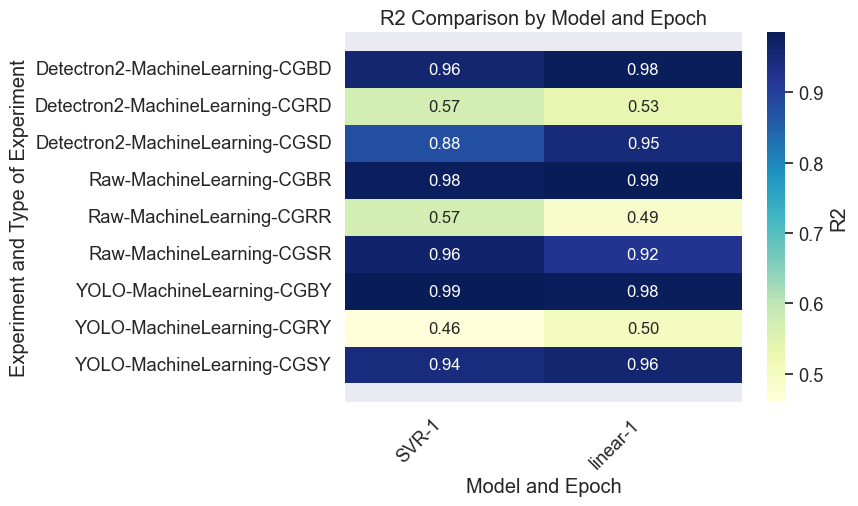

In [15]:
plot_r2_heatmap(results_dict)


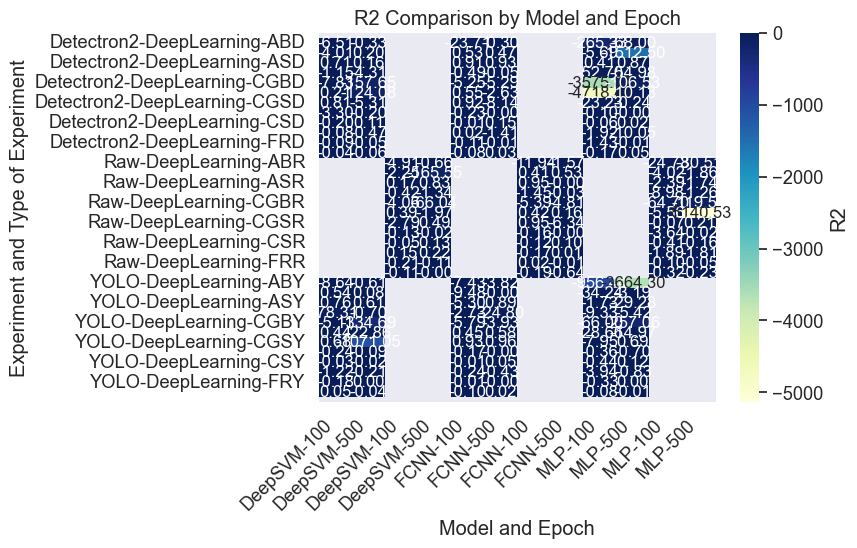

In [16]:
plot_r2_heatmap(results_dict_DLC)

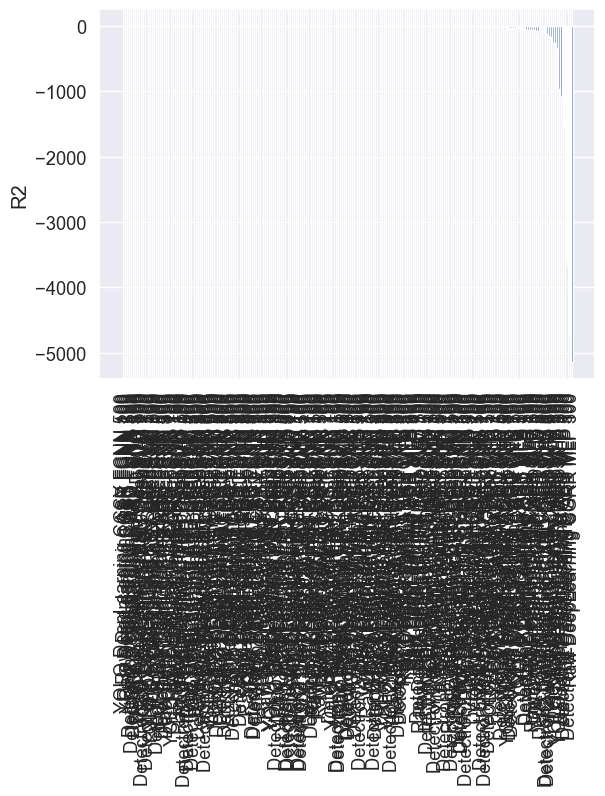

In [17]:
plot_r2_by_class(results_dict_DLC)

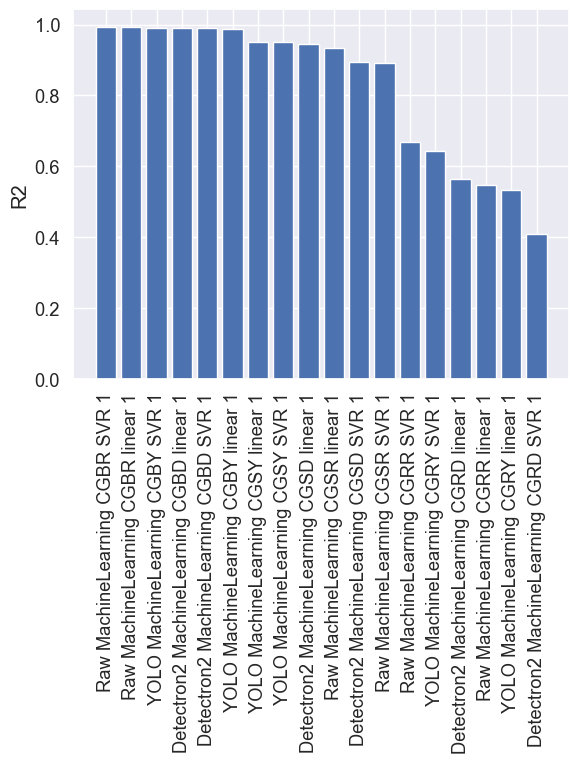

In [83]:
plot_r2_by_class(results_dict)

{'Raw': {'MachineLearning': {'CGBR': {'linear': {'1': {'r2': 0.9853256207471913, 'loss': None, 'mse': 0.0067148793736774735, 'mae': 0.0677157837923443, 'rmse': 0.08194436755309954}}, 'SVR': {'1': {'r2': 0.9779571449284651, 'loss': None, 'mse': 0.004318405991816957, 'mae': 0.044067504782681066, 'rmse': 0.06571457975074448}}}, 'CGRR': {'linear': {'1': {'r2': 0.48542676329732015, 'loss': None, 'mse': 0.31725169729176644, 'mae': 0.44539110251103653, 'rmse': 0.5632510073597441}}, 'SVR': {'1': {'r2': 0.5720874747977521, 'loss': None, 'mse': 0.24199844779564256, 'mae': 0.3573564447088807, 'rmse': 0.4919333773953975}}}, 'CGSR': {'linear': {'1': {'r2': 0.9217923962441629, 'loss': None, 'mse': 4.977966100817252, 'mae': 1.5130742999634992, 'rmse': 2.2311356078950584}}, 'SVR': {'1': {'r2': 0.9632027766646506, 'loss': None, 'mse': 3.1266857052551833, 'mae': 1.1051393672055243, 'rmse': 1.7682436781323956}}}}}, 'YOLO': {'MachineLearning': {'CGBY': {'linear': {'1': {'r2': 0.9824953995479875, 'loss': N

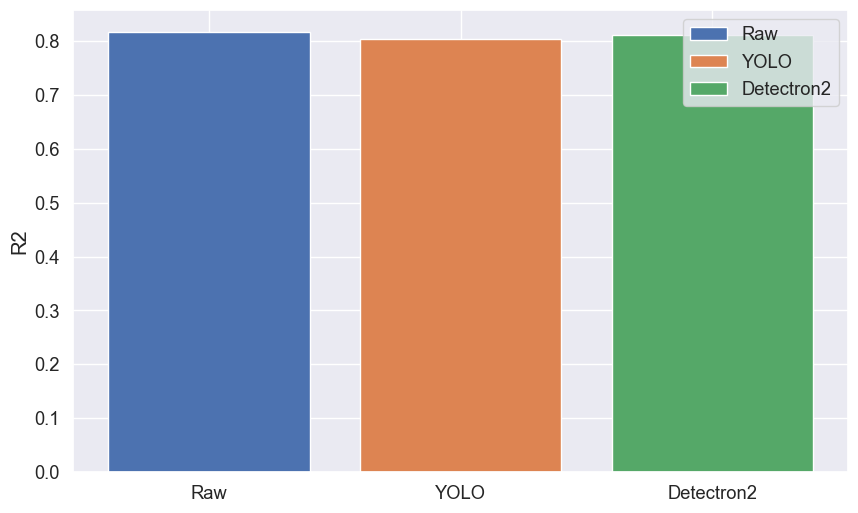

In [18]:
import matplotlib.pyplot as plt

print(results_dict)

def plot_r2(results_dict):
    # Create a dictionary to store the R2 values for each experiment
    r2_dict = {}

    
    # Loop through the results_dict and extract the R2 values
    for experiment_name, experiment in results_dict.items():
        for test_name, test in experiment.items():
            for dataset_name, dataset in test.items():
                for model_name, model in dataset.items():
                    for epoch, results in model.items():
                        r2 = results['r2']
                        # If the experiment name is not in the r2_dict, add it
                        if experiment_name not in r2_dict:
                            r2_dict[experiment_name] = []
                        if(r2 == None):
                            r2 = 0
                        r2_dict[experiment_name].append(r2)
    print("R2DICT",r2_dict)
    
    # Create a bar chart of the R2 values for each experiment
    fig, ax = plt.subplots(figsize=(10,6))
    for i, (experiment_name, r2_values) in enumerate(r2_dict.items()):
        ax.bar(i, sum(r2_values)/len(r2_values), label=experiment_name)
    ax.set_xticks(range(len(r2_dict)))
    ax.set_xticklabels(list(r2_dict.keys()))
    ax.set_ylabel('R2')
    ax.legend()
    plt.show()

plot_r2(results_dict)


R2DICT {'Raw': [-64.701839859492, -119.53302798603754, -5.38604791020252, -4.810571955260061, -4.055664748611606, -66.04184856391224, -1.893789621843018, -1.8143671567053556, -0.16783122655040628, 0.01158641810060923, 0.15402840993257683, 0.2215184145778768, -8.98173883755314, -1.258233160083031, -1.4538619646536413, -0.03133934784080217, -0.4240236105697166, -1.3437036531870494, -24.72634143368892, -80.50666042689025, -11.942665853511938, -1.5677076194853812, -4.914928943610575, -0.6565732804006612, -5.5614857790028145, -5140.528238167666, 0.41834760222257705, 0.15605657099323234, 0.3920312787641136, -1.9726502626230245, -0.10254927020394877, -0.04977172915262873, 0.015373900878739022, -0.0062728311468307485, -0.2103068570097686, -0.11394448665881929, -3.6358039385856715, -0.01800372126571692, -0.16440470462171186, -0.002523516008037463, -0.1343856581234364, -0.017525220223631788, -4.021466560375675, -1.86235963325879, 0.4105329141904742, 0.5296904279434731, -2.2532766911143813, -165.

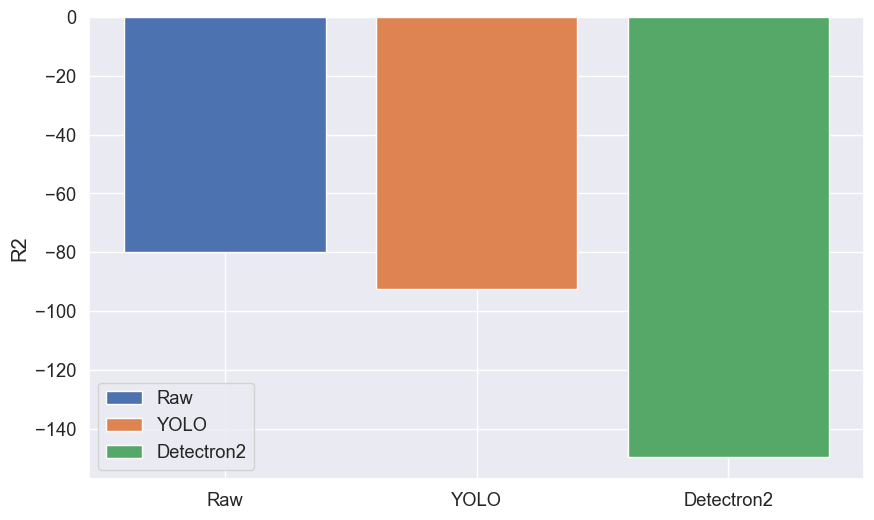

In [19]:
plot_r2(results_dict_DLC)

dict_items([('Raw', {'MachineLearning': {'CGBR': {'linear': {'1': {'r2': 0.9853256207471913, 'loss': None, 'mse': 0.0067148793736774735, 'mae': 0.0677157837923443, 'rmse': 0.08194436755309954}}, 'SVR': {'1': {'r2': 0.9779571449284651, 'loss': None, 'mse': 0.004318405991816957, 'mae': 0.044067504782681066, 'rmse': 0.06571457975074448}}}, 'CGRR': {'linear': {'1': {'r2': 0.48542676329732015, 'loss': None, 'mse': 0.31725169729176644, 'mae': 0.44539110251103653, 'rmse': 0.5632510073597441}}, 'SVR': {'1': {'r2': 0.5720874747977521, 'loss': None, 'mse': 0.24199844779564256, 'mae': 0.3573564447088807, 'rmse': 0.4919333773953975}}}, 'CGSR': {'linear': {'1': {'r2': 0.9217923962441629, 'loss': None, 'mse': 4.977966100817252, 'mae': 1.5130742999634992, 'rmse': 2.2311356078950584}}, 'SVR': {'1': {'r2': 0.9632027766646506, 'loss': None, 'mse': 3.1266857052551833, 'mae': 1.1051393672055243, 'rmse': 1.7682436781323956}}}}}), ('YOLO', {'MachineLearning': {'CGBY': {'linear': {'1': {'r2': 0.9824953995479

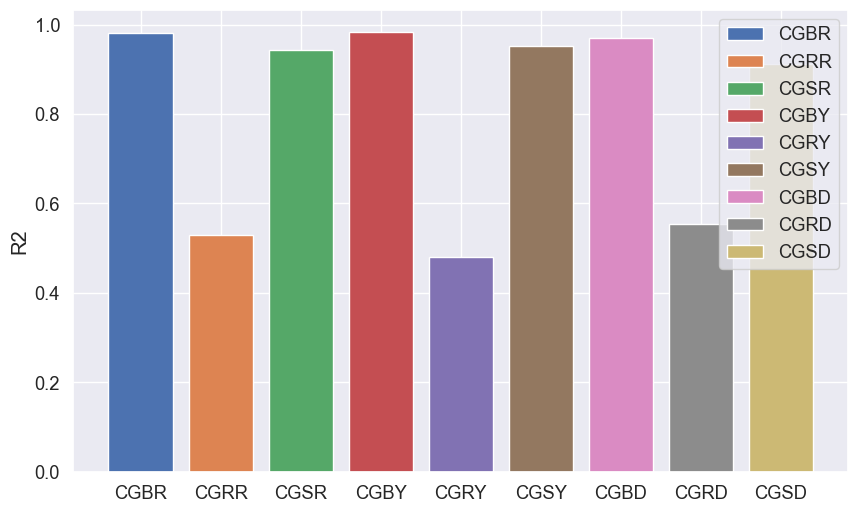

In [20]:
import matplotlib.pyplot as plt

def plot_r2_by_dataset(results_dict):
    # Create a dictionary to store the R2 values for each dataset
    r2_dict = {}
    
    # Loop through the results_dict and extract the R2 values
    for experiment_name, experiment in results_dict.items():
        print(results_dict.items())
        
        for test_name, test in experiment.items():
            print(test_name)
            for dataset_name, dataset in test.items():
                for model_name, model in dataset.items():
                    for epoch, results in model.items():
                        r2 = results['r2']
                        # If the dataset name is not in the r2_dict, add it
                        if dataset_name not in r2_dict:
                            r2_dict[dataset_name] = []
                        if(r2 == None):
                            r2 = 0
                        r2_dict[dataset_name].append(r2)
    
    # Create a bar chart of the R2 values for each dataset
    fig, ax = plt.subplots(figsize=(10,6))
    for i, (dataset_name, r2_values) in enumerate(r2_dict.items()):
        ax.bar(i, sum(r2_values)/len(r2_values), label=dataset_name)
    ax.set_xticks(range(len(r2_dict)))
    ax.set_xticklabels(list(r2_dict.keys()))
    ax.set_ylabel('R2')
    ax.legend()
    plt.show()
plot_r2_by_dataset(results_dict)


dict_items([('Raw', {'DeepLearning': {'CGBR': {'MLP': {'100': {'r2': -64.701839859492, 'loss': 18.549575805664062, 'mse': 18.549575805664062, 'mae': 4.2672224044799805, 'rmse': 4.30692195892334}, '500': {'r2': -119.53302798603754, 'loss': 85.44715881347656, 'mse': 85.44715881347656, 'mae': 9.205338478088379, 'rmse': 9.243762969970703}}, 'FCNN': {'100': {'r2': -5.38604791020252, 'loss': 2.576350450515747, 'mse': 2.576350450515747, 'mae': 1.3141248226165771, 'rmse': 1.6051013469696045}, '500': {'r2': -4.810571955260061, 'loss': 2.7025272846221924, 'mse': 2.7025272846221924, 'mae': 1.357565999031067, 'rmse': 1.6439365148544312}}, 'DeepSVM': {'100': {'r2': -4.055664748611606, 'loss': 2.6975085735321045, 'mse': 2.6625924110412598, 'mae': 1.2837483882904053, 'rmse': 1.6317452192306519}, '500': {'r2': -66.04184856391224, 'loss': 23.51694679260254, 'mse': 23.481536865234375, 'mae': 4.821601867675781, 'rmse': 4.845775127410889}}}, 'FBR': {'MLP': {'100': {'r2': -1.893789621843018, 'loss': 1.2066

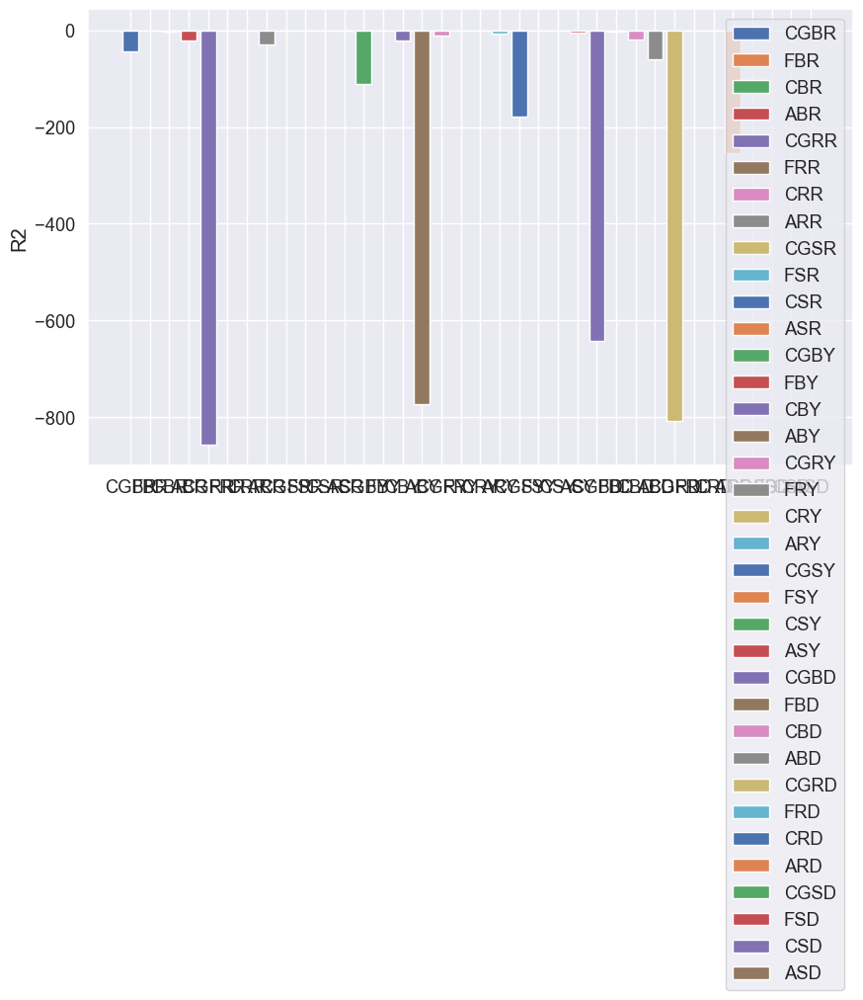

In [21]:
plot_r2_by_dataset(results_dict_DLC)

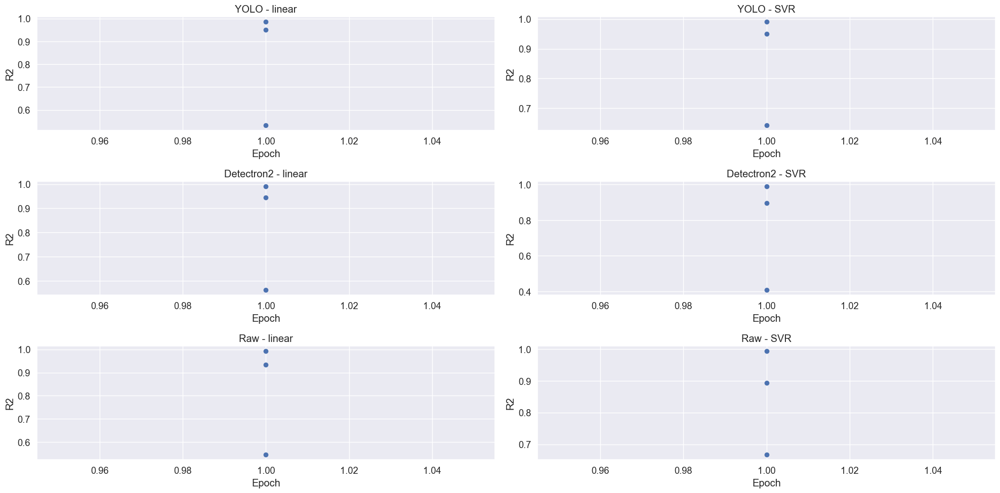

In [85]:
import matplotlib.pyplot as plt
import numpy as np

def plot_r2_by_model(results_dict):
    models = set()
    experiments = set()
    for experiment_name, experiment in results_dict.items():
        experiments.add(experiment_name)
        for test_name, test in experiment.items():
            for dataset_name, dataset in test.items():
                for model_name, model in dataset.items():
                    models.add(model_name)

    fig, axes = plt.subplots(len(experiments), len(models), figsize=(20, 10))
    if len(experiments) == 1 and len(models) == 1:
        axes = np.array([[axes]])
    elif len(experiments) == 1 or len(models) == 1:
        axes = axes.reshape((1, -1))

    for i, experiment_name in enumerate(experiments):
        for j, model_name in enumerate(models):
            r2_values = []
            epochs = []
            for test_name, test in results_dict[experiment_name].items():
                for dataset_name, dataset in test.items():
                    if model_name in dataset:
                        model_results = dataset[model_name]
                        for epoch, epoch_results in model_results.items():
                            if epoch_results is not None:
                                r2_values.append(epoch_results['r2'])
                                epochs.append(int(epoch))
            if len(r2_values) > 0:
                axes[i, j].scatter(epochs, r2_values)
                axes[i, j].set_title(f"{experiment_name} - {model_name}")
                axes[i, j].set_xlabel("Epoch")
                axes[i, j].set_ylabel("R2")
    
    plt.tight_layout()
    plt.show()


plot_r2_by_model(results_dict)

In [ ]:

testcnn = AutomaticLearning(pd.read_pickle("croppedimagesRaspberriesRaw.pkl"), "CIRR-ResNet", "ResNet")
testcnn.buildData()
testcnn.buildModel()
testcnn.train(40)
testcnn.plot()

   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
plotting linear


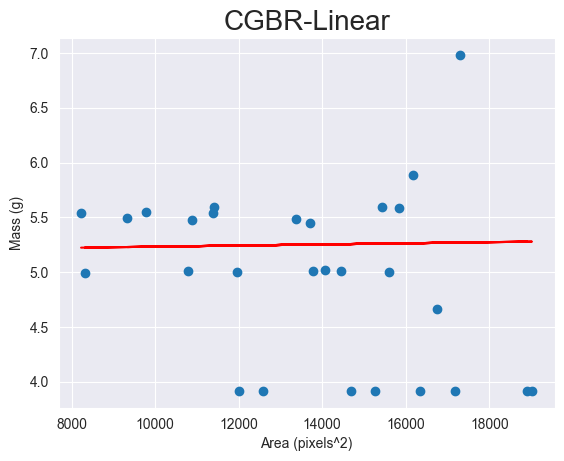

R-squared value: -0.1392


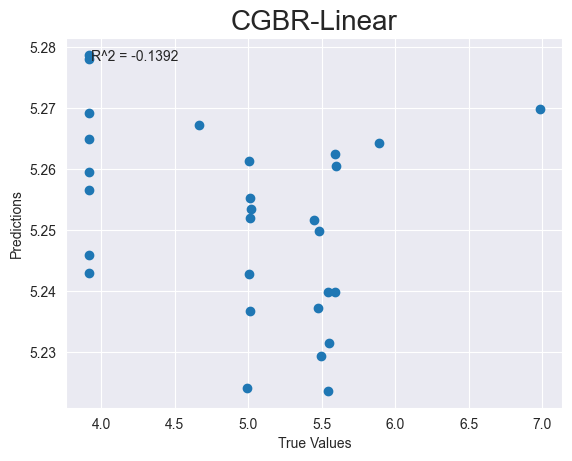

In [53]:
testcnn = AutomaticLearning(pd.read_csv("CGBR.csv"), "CGBR-Linear", "linear")
testcnn.buildData()
testcnn.buildModel()
testcnn.train(400)
testcnn.plot()


plotting linear


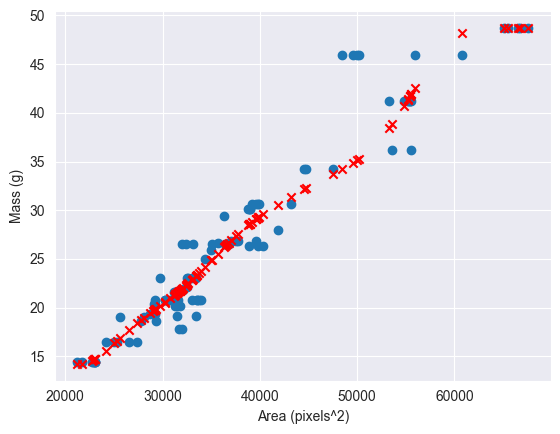

R-squared value: 0.9178


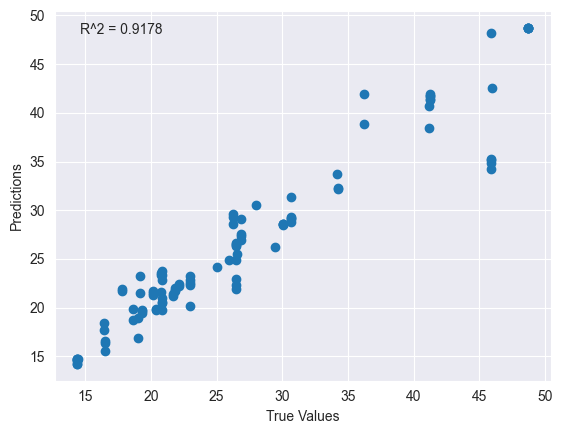

In [8]:

testsvr = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaSVR")
testsvr.buildData()
testsvr.buildModel("SVR")
testsvr.train(2200)
testsvr.plot()


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 64)                832       
                                                                 
 dense_9 (Dense)             (None, 32)                2080      
                                                                 
 dense_10 (Dense)            (None, 16)                528       
                                                                 
 dense_11 (Dense)            (None, 1)                 17        
                                                                 
Total params: 3,457
Trainable params: 3,457
Non-trainable params: 0
_________________________________________________________________
None


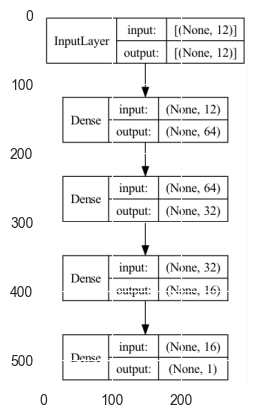

Epoch 1/10
 1/11 [=>............................] - ETA: 5s - loss: 377022.3750 - mse: 377022.3750 - mae: 587.8816 - root_mean_squared_error: 614.0215

2023-04-29 04:02:14.868265: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 31ms/step - loss: 15895854.0000 - mse: 15895854.0000 - mae: 2913.8459 - root_mean_squared_error: 3986.9604 - val_loss: 101860.9062 - val_mse: 101860.9062 - val_mae: 307.9383 - val_root_mean_squared_error: 319.1566
Epoch 2/10
 8/11 [====================>.........] - ETA: 0s - loss: 976481.5000 - mse: 976481.5000 - mae: 914.2033 - root_mean_squared_error: 988.1708

2023-04-29 04:02:15.240663: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 0s 11ms/step - loss: 946390.3125 - mse: 946390.3125 - mae: 904.1191 - root_mean_squared_error: 972.8259 - val_loss: 377234.4062 - val_mse: 377234.4062 - val_mae: 592.2183 - val_root_mean_squared_error: 614.1941
Epoch 3/10
11/11 [==============================] - 0s 11ms/step - loss: 122046.0703 - mse: 122046.0703 - mae: 296.6097 - root_mean_squared_error: 349.3509 - val_loss: 3624.8376 - val_mse: 3624.8376 - val_mae: 57.6960 - val_root_mean_squared_error: 60.2066
Epoch 4/10
11/11 [==============================] - 0s 11ms/step - loss: 737.0602 - mse: 737.0602 - mae: 19.2511 - root_mean_squared_error: 27.1489 - val_loss: 249.6129 - val_mse: 249.6129 - val_mae: 15.3938 - val_root_mean_squared_error: 15.7991
Epoch 5/10
11/11 [==============================] - 0s 10ms/step - loss: 384.6152 - mse: 384.6152 - mae: 18.9756 - root_mean_squared_error: 19.6116 - val_loss: 388.4864 - val_mse: 388.4864 - val_mae: 19.1997 - val_root_mean_squared_error: 19.71

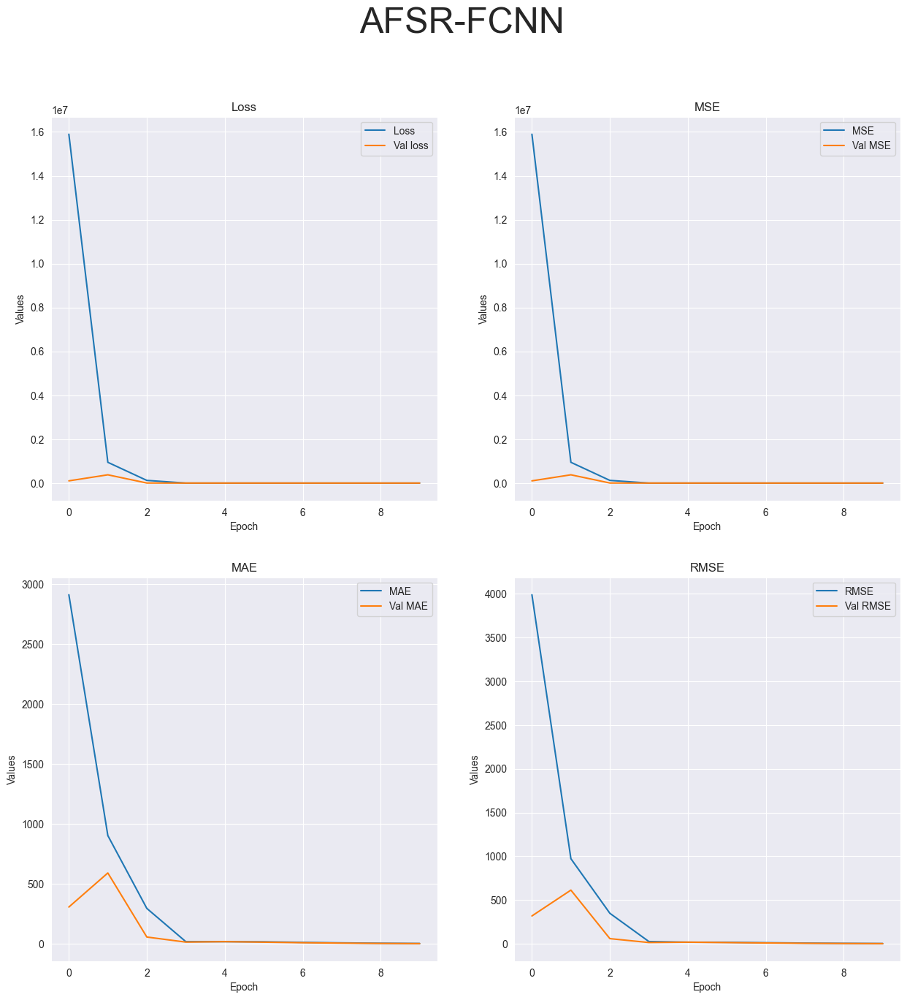

R-squared value: 0.8525


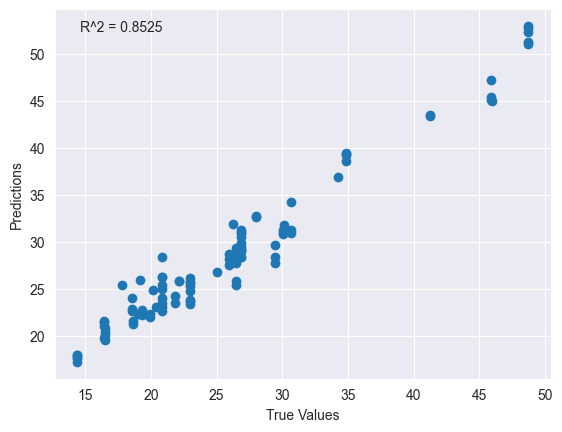

In [13]:

muchas = AutomaticLearning(pd.read_csv("allfeaturesStrawberriesRaw.csv"), "AFSR-FCNN")
muchas.buildData()
muchas.buildModel("FCNN")
muchas.train(10)
muchas.plot()

plotting linear


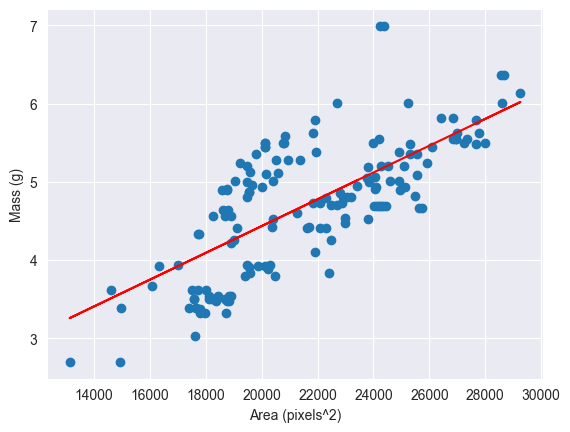

R-squared value: 0.5422


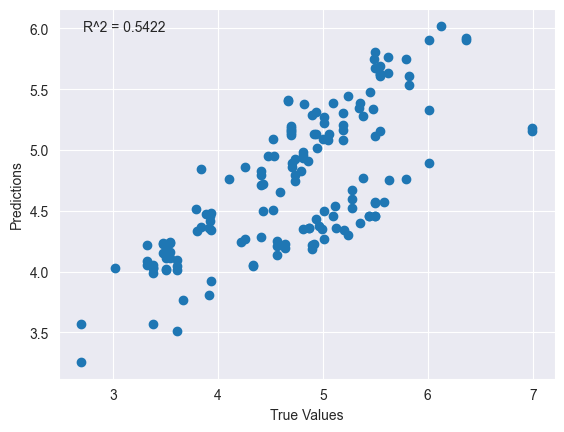

plotting linear


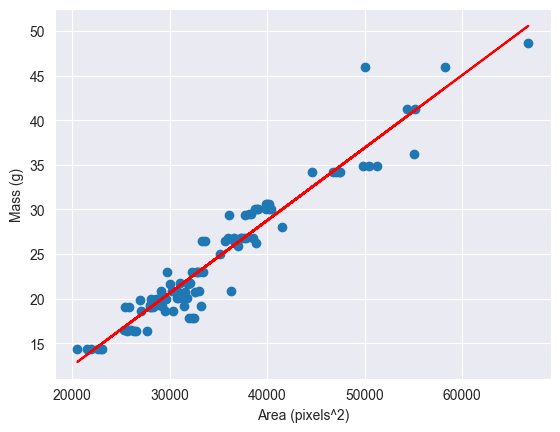

R-squared value: 0.9251


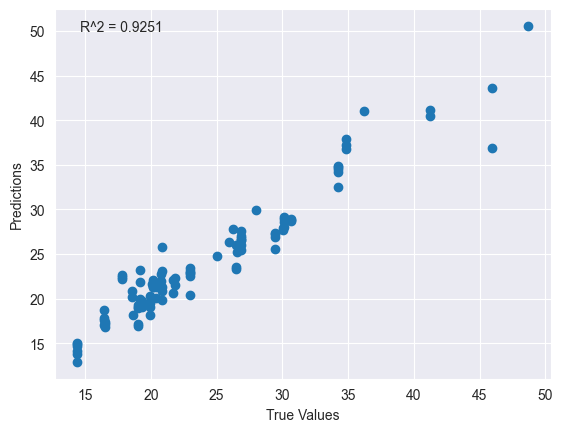

plotting linear


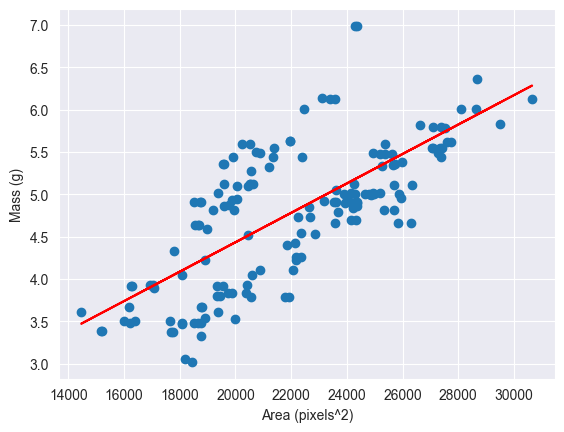

R-squared value: 0.5080


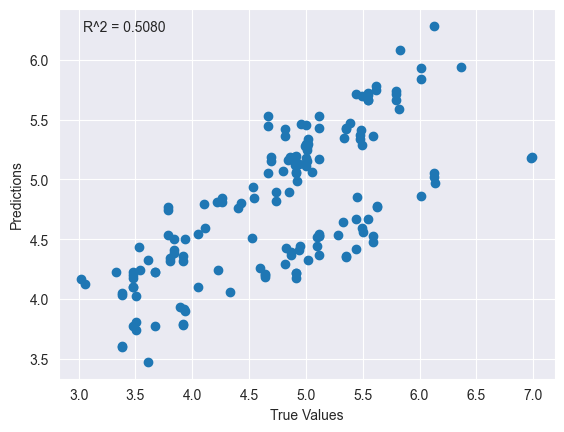

plotting linear


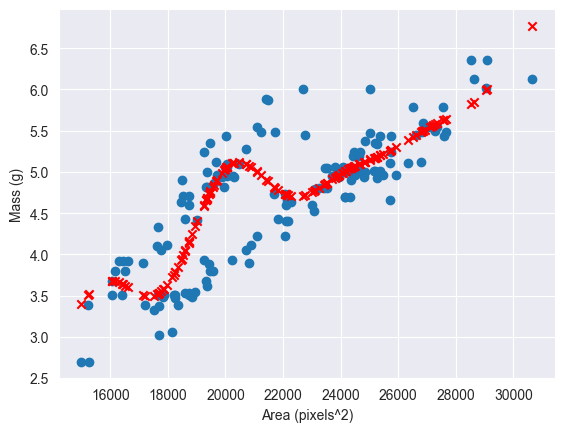

R-squared value: 0.6757


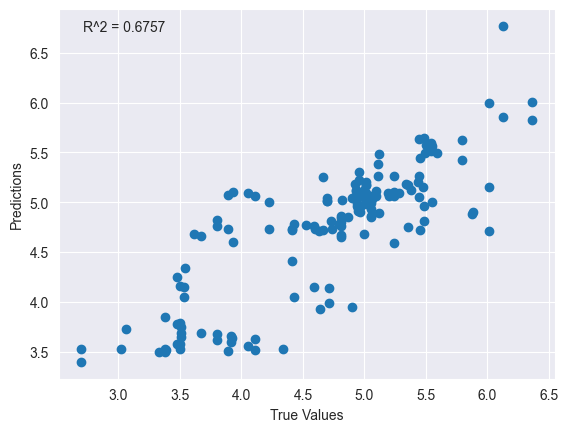

Model: "sequential_107"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_369 (Dense)           (None, 64)                192       
                                                                 
 dropout_112 (Dropout)       (None, 64)                0         
                                                                 
 dense_370 (Dense)           (None, 32)                2080      
                                                                 
 dropout_113 (Dropout)       (None, 32)                0         
                                                                 
 dense_371 (Dense)           (None, 1)                 33        
                                                                 
Total params: 2,305
Trainable params: 2,305
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:10.454677: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 1663239.3750 - mse: 1663239.3750 - mae: 836.0511 - root_mean_squared_error: 1289.6664

2023-04-29 03:39:11.773911: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 64ms/step - loss: 1663239.3750 - mse: 1663239.3750 - mae: 836.0511 - root_mean_squared_error: 1289.6664 - val_loss: 57952.4336 - val_mse: 57952.4336 - val_mae: 237.5029 - val_root_mean_squared_error: 240.7331
Epoch 2/5
16/16 [==============================] - 0s 16ms/step - loss: 50696.3398 - mse: 50696.3398 - mae: 166.3529 - root_mean_squared_error: 225.1585 - val_loss: 920.8993 - val_mse: 920.8993 - val_mae: 29.9157 - val_root_mean_squared_error: 30.3463
Epoch 3/5
16/16 [==============================] - 0s 18ms/step - loss: 4578.2466 - mse: 4578.2466 - mae: 48.7814 - root_mean_squared_error: 67.6627 - val_loss: 107.3159 - val_mse: 107.3159 - val_mae: 10.2257 - val_root_mean_squared_error: 10.3593
Epoch 4/5
16/16 [==============================] - 0s 14ms/step - loss: 2107.4727 - mse: 2107.4727 - mae: 35.8980 - root_mean_squared_error: 45.9072 - val_loss: 133.2910 - val_mse: 133.2910 - val_mae: 11.3972 - val_root_mean_squared_error: 11.5452

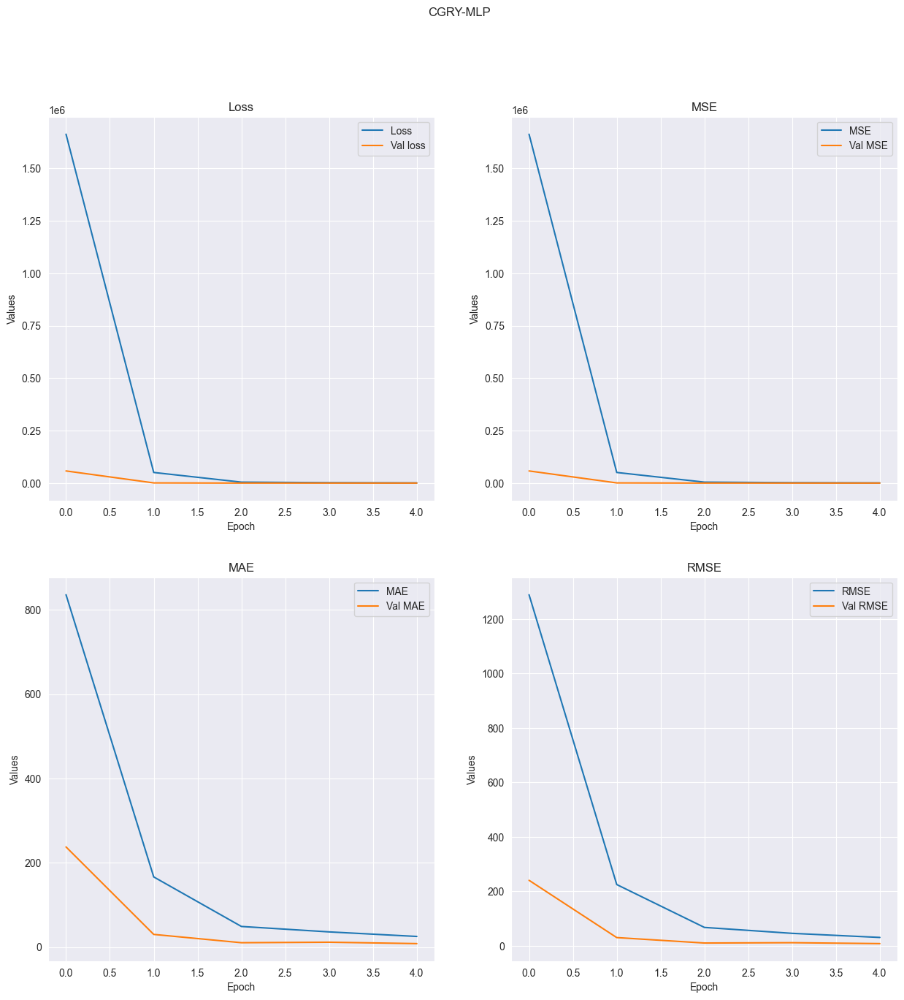

R-squared value: -122.9209


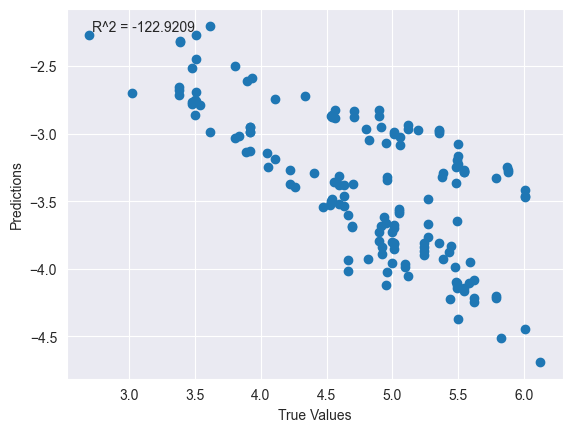

Model: "sequential_108"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_372 (Dense)           (None, 64)                192       
                                                                 
 dropout_114 (Dropout)       (None, 64)                0         
                                                                 
 dense_373 (Dense)           (None, 32)                2080      
                                                                 
 dropout_115 (Dropout)       (None, 32)                0         
                                                                 
 dense_374 (Dense)           (None, 1)                 33        
                                                                 
Total params: 2,305
Trainable params: 2,305
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:20.399078: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 7864849.5000 - mse: 7864849.5000 - mae: 1876.0809 - root_mean_squared_error: 2804.4338 

2023-04-29 03:39:21.810632: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 91ms/step - loss: 7864849.5000 - mse: 7864849.5000 - mae: 1876.0809 - root_mean_squared_error: 2804.4338 - val_loss: 166090.0469 - val_mse: 166090.0469 - val_mae: 389.9341 - val_root_mean_squared_error: 407.5415
Epoch 2/5
11/11 [==============================] - 0s 24ms/step - loss: 511054.8125 - mse: 511054.8125 - mae: 509.3962 - root_mean_squared_error: 714.8810 - val_loss: 57024.1289 - val_mse: 57024.1289 - val_mae: 228.5861 - val_root_mean_squared_error: 238.7973
Epoch 3/5
11/11 [==============================] - 0s 17ms/step - loss: 108829.0156 - mse: 108829.0156 - mae: 242.5318 - root_mean_squared_error: 329.8924 - val_loss: 6094.3706 - val_mse: 6094.3701 - val_mae: 74.8816 - val_root_mean_squared_error: 78.0664
Epoch 4/5
11/11 [==============================] - 0s 18ms/step - loss: 35150.0625 - mse: 35150.0625 - mae: 128.3465 - root_mean_squared_error: 187.4835 - val_loss: 115.6760 - val_mse: 115.6760 - val_mae: 10.3060 - val_root_mean

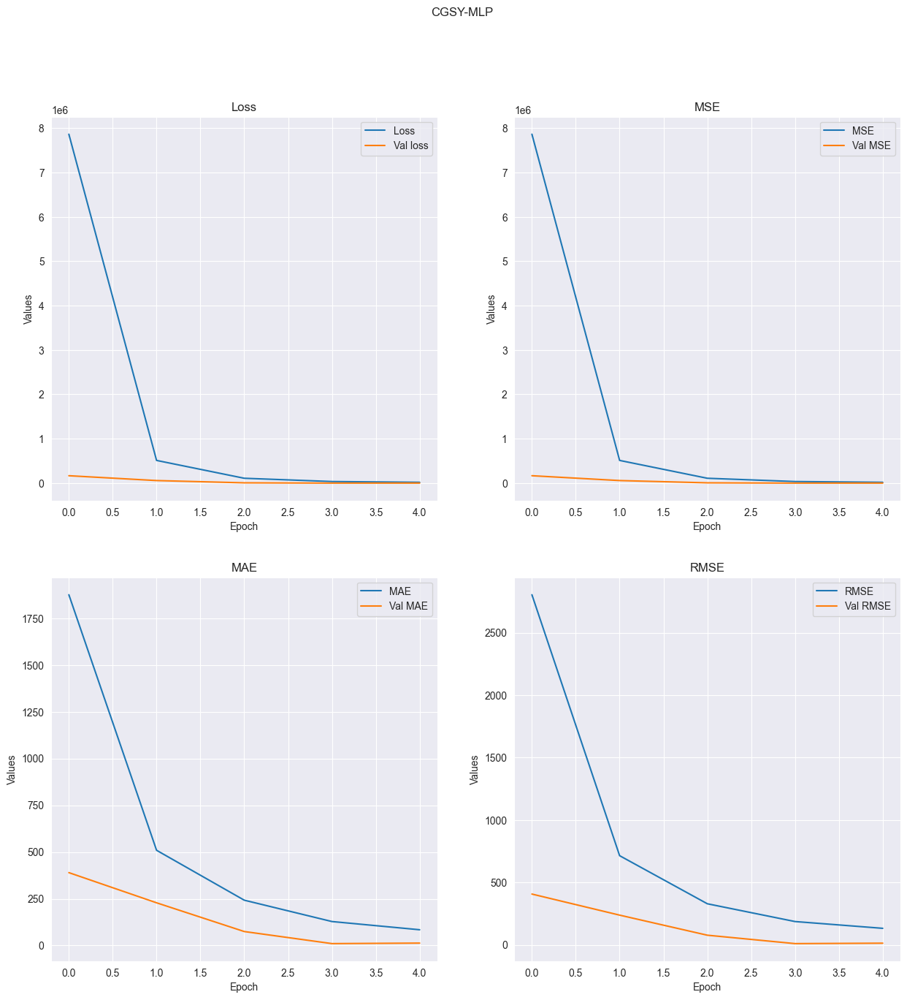

R-squared value: -0.7915


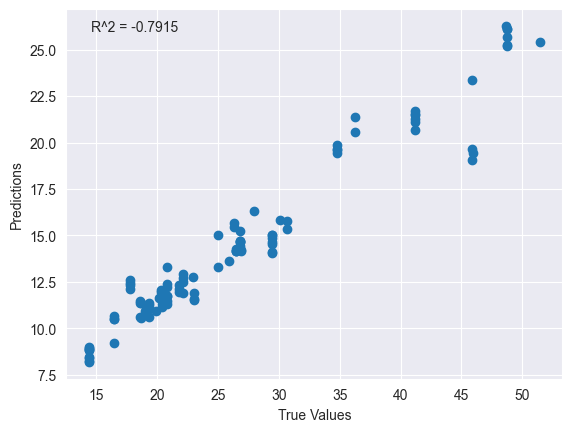

Model: "sequential_109"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_375 (Dense)           (None, 64)                192       
                                                                 
 dense_376 (Dense)           (None, 32)                2080      
                                                                 
 dense_377 (Dense)           (None, 16)                528       
                                                                 
 dense_378 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:23.873785: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 4046931.2500 - mse: 4046931.2500 - mae: 1404.9456 - root_mean_squared_error: 2011.6986

2023-04-29 03:39:24.804380: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 1s 56ms/step - loss: 4046931.2500 - mse: 4046931.2500 - mae: 1404.9456 - root_mean_squared_error: 2011.6986 - val_loss: 555599.4375 - val_mse: 555599.4375 - val_mae: 735.9260 - val_root_mean_squared_error: 745.3854
Epoch 2/5
16/16 [==============================] - 0s 13ms/step - loss: 168030.3438 - mse: 168030.3438 - mae: 328.9428 - root_mean_squared_error: 409.9150 - val_loss: 46.6384 - val_mse: 46.6384 - val_mae: 6.6897 - val_root_mean_squared_error: 6.8292
Epoch 3/5
16/16 [==============================] - 0s 15ms/step - loss: 4408.6826 - mse: 4408.6826 - mae: 61.4353 - root_mean_squared_error: 66.3979 - val_loss: 6530.2080 - val_mse: 6530.2080 - val_mae: 79.7497 - val_root_mean_squared_error: 80.8097
Epoch 4/5
16/16 [==============================] - 0s 10ms/step - loss: 4162.0752 - mse: 4162.0752 - mae: 62.9008 - root_mean_squared_error: 64.5141 - val_loss: 1974.3805 - val_mse: 1974.3805 - val_mae: 43.8345 - val_root_mean_squared_error: 44

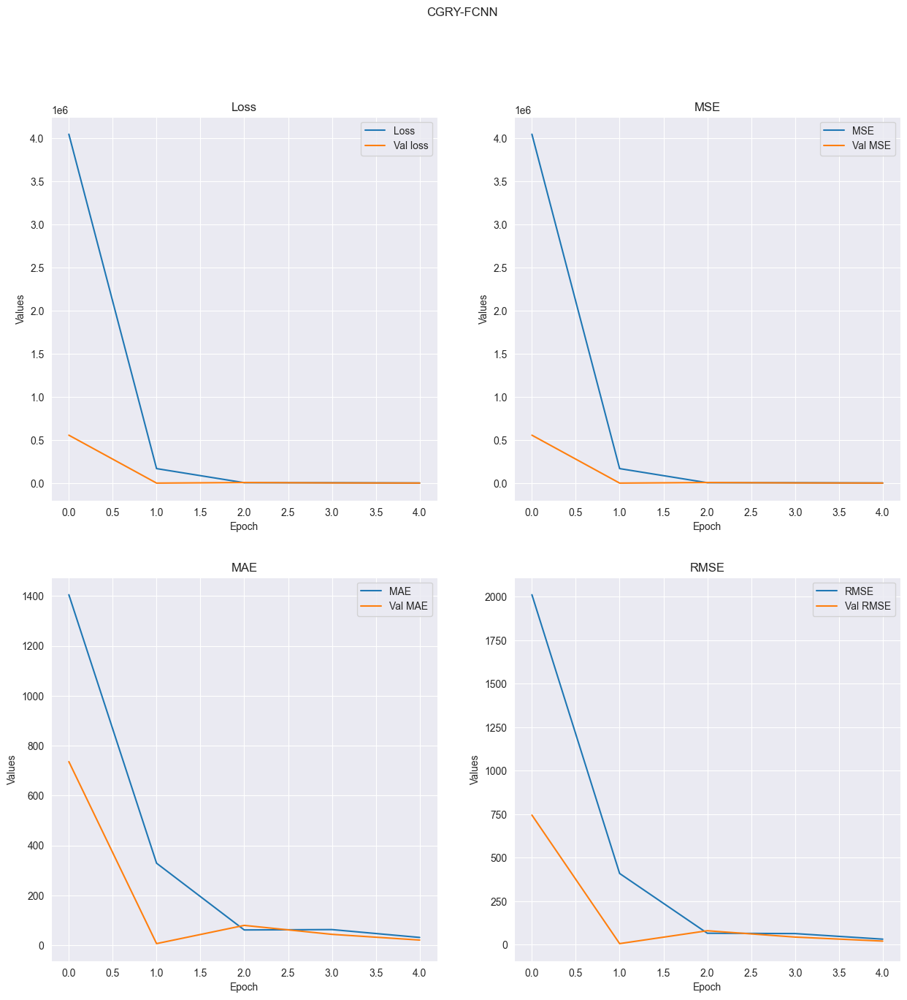

R-squared value: -738.7749


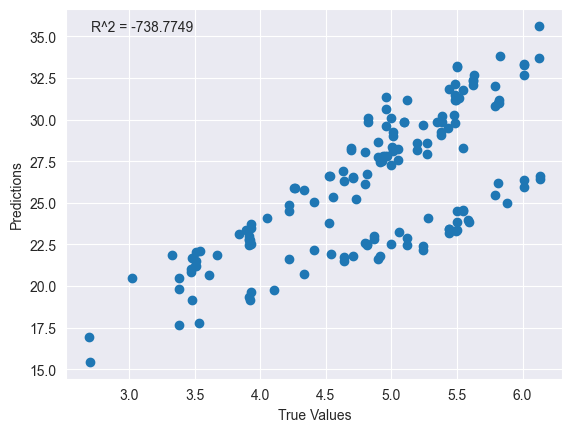

Model: "sequential_110"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_379 (Dense)           (None, 64)                192       
                                                                 
 dense_380 (Dense)           (None, 32)                2080      
                                                                 
 dense_381 (Dense)           (None, 16)                528       
                                                                 
 dense_382 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:26.990116: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 23710192.0000 - mse: 23710192.0000 - mae: 3670.8171 - root_mean_squared_error: 4869.3110

2023-04-29 03:39:28.050524: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 93ms/step - loss: 23710192.0000 - mse: 23710192.0000 - mae: 3670.8171 - root_mean_squared_error: 4869.3110 - val_loss: 729364.1250 - val_mse: 729364.1250 - val_mae: 819.8881 - val_root_mean_squared_error: 854.0282
Epoch 2/5
11/11 [==============================] - 0s 25ms/step - loss: 168845.9531 - mse: 168845.9531 - mae: 339.4226 - root_mean_squared_error: 410.9087 - val_loss: 94275.0938 - val_mse: 94275.0938 - val_mae: 294.4102 - val_root_mean_squared_error: 307.0425
Epoch 3/5
11/11 [==============================] - 0s 15ms/step - loss: 64092.6992 - mse: 64092.6992 - mae: 240.5644 - root_mean_squared_error: 253.1654 - val_loss: 26051.3789 - val_mse: 26051.3789 - val_mae: 154.6329 - val_root_mean_squared_error: 161.4044
Epoch 4/5
11/11 [==============================] - 0s 13ms/step - loss: 11585.3242 - mse: 11585.3242 - mae: 96.6171 - root_mean_squared_error: 107.6351 - val_loss: 786.8887 - val_mse: 786.8887 - val_mae: 26.5961 - val_root_m

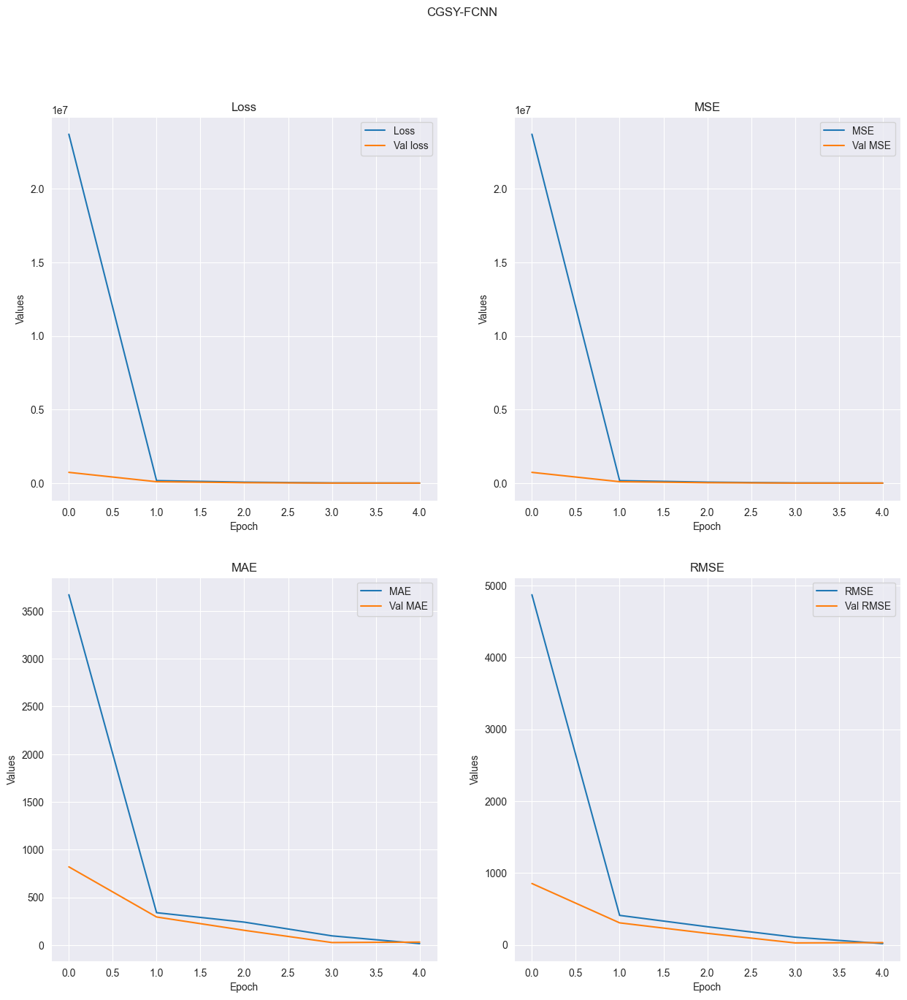

R-squared value: -14.0293


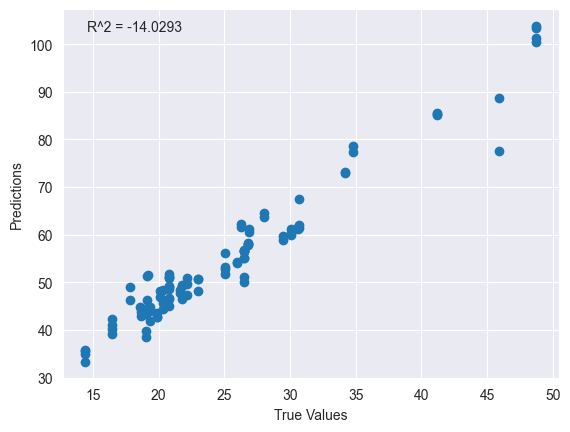

Model: "sequential_111"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_383 (Dense)           (None, 64)                128       
                                                                 
 dense_384 (Dense)           (None, 32)                2080      
                                                                 
 dense_385 (Dense)           (None, 16)                528       
                                                                 
 dense_386 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/50


2023-04-29 03:39:30.141956: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 19372782.0000 - mse: 19372782.0000 - mae: 3406.9805 - root_mean_squared_error: 4401.4521

2023-04-29 03:39:31.058009: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 75ms/step - loss: 19372782.0000 - mse: 19372782.0000 - mae: 3406.9805 - root_mean_squared_error: 4401.4521 - val_loss: 17714.7266 - val_mse: 17714.7266 - val_mae: 127.6721 - val_root_mean_squared_error: 133.0967
Epoch 2/50
11/11 [==============================] - 0s 17ms/step - loss: 932430.1250 - mse: 932430.1250 - mae: 873.2705 - root_mean_squared_error: 965.6242 - val_loss: 421392.2500 - val_mse: 421392.2500 - val_mae: 623.6829 - val_root_mean_squared_error: 649.1473
Epoch 3/50
11/11 [==============================] - 0s 18ms/step - loss: 122324.6250 - mse: 122324.6250 - mae: 275.8206 - root_mean_squared_error: 349.7494 - val_loss: 1564.3717 - val_mse: 1564.3717 - val_mae: 38.2025 - val_root_mean_squared_error: 39.5521
Epoch 4/50
11/11 [==============================] - 0s 16ms/step - loss: 17010.9688 - mse: 17010.9688 - mae: 118.5225 - root_mean_squared_error: 130.4261 - val_loss: 30145.5234 - val_mse: 30145.5234 - val_mae: 167.1085 - val

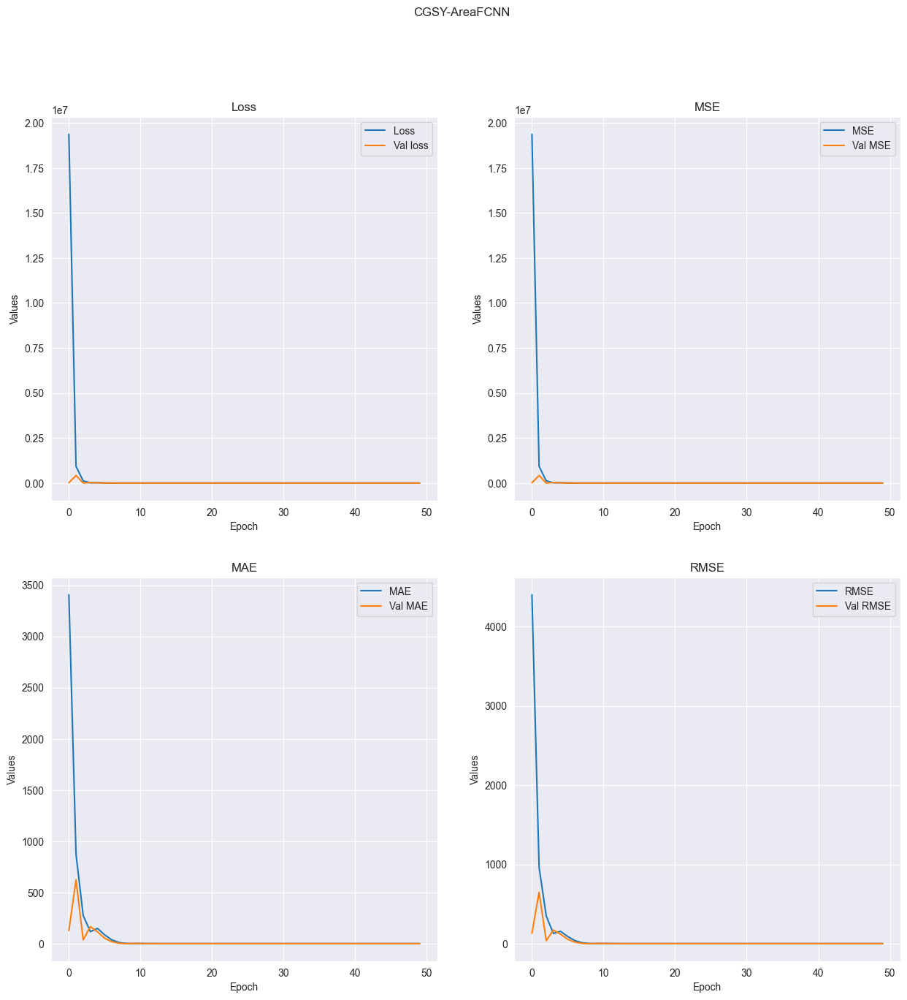

R-squared value: 0.9177


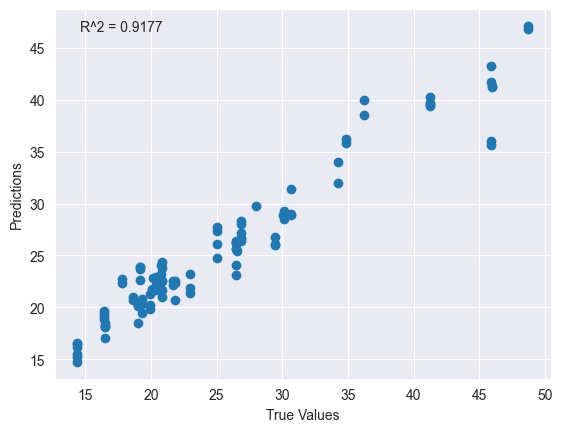

Model: "sequential_112"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_387 (Dense)           (None, 64)                128       
                                                                 
 dense_388 (Dense)           (None, 32)                2080      
                                                                 
 dense_389 (Dense)           (None, 16)                528       
                                                                 
 dense_390 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/500


2023-04-29 03:39:38.776629: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 18706208.0000 - mse: 18706208.0000 - mae: 3244.1116 - root_mean_squared_error: 4325.0674

2023-04-29 03:39:39.795213: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 77ms/step - loss: 18706208.0000 - mse: 18706208.0000 - mae: 3244.1116 - root_mean_squared_error: 4325.0674 - val_loss: 210354.5625 - val_mse: 210354.5625 - val_mae: 439.0882 - val_root_mean_squared_error: 458.6443
Epoch 2/500
11/11 [==============================] - 0s 19ms/step - loss: 1217078.6250 - mse: 1217078.6250 - mae: 1023.1184 - root_mean_squared_error: 1103.2129 - val_loss: 458335.7188 - val_mse: 458335.7188 - val_mae: 648.2742 - val_root_mean_squared_error: 677.0049
Epoch 3/500
11/11 [==============================] - 0s 11ms/step - loss: 112703.7422 - mse: 112703.7422 - mae: 262.1600 - root_mean_squared_error: 335.7138 - val_loss: 812.6620 - val_mse: 812.6620 - val_mae: 27.4941 - val_root_mean_squared_error: 28.5072
Epoch 4/500
11/11 [==============================] - 0s 28ms/step - loss: 9231.3857 - mse: 9231.3857 - mae: 87.2979 - root_mean_squared_error: 96.0801 - val_loss: 18772.8359 - val_mse: 18772.8359 - val_mae: 131.5238 - 

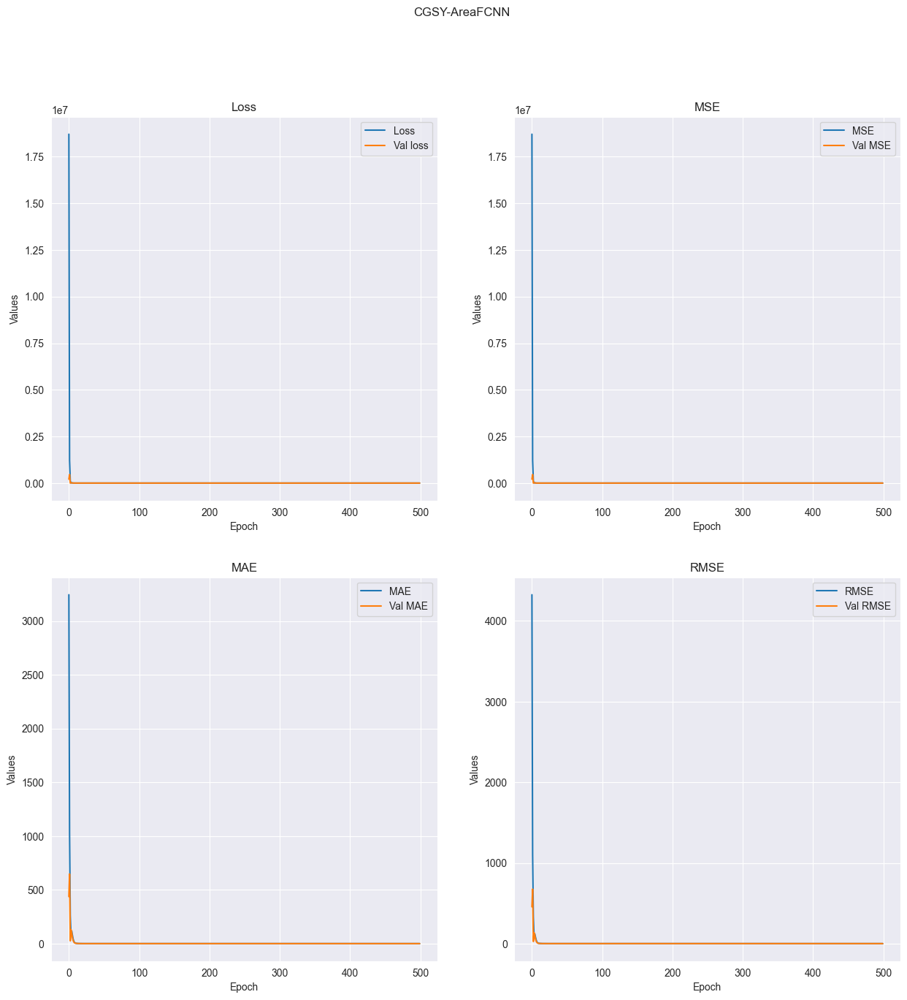

R-squared value: 0.8874


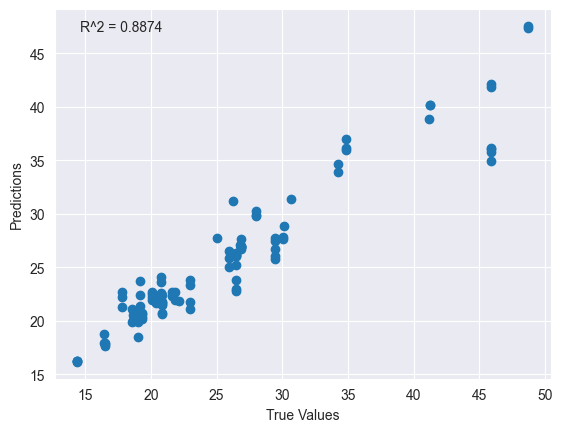

Model: "sequential_113"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_391 (Dense)           (None, 64)                128       
                                                                 
 dense_392 (Dense)           (None, 32)                2080      
                                                                 
 dense_393 (Dense)           (None, 16)                528       
                                                                 
 dense_394 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/2200


2023-04-29 03:40:37.817394: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 23307728.0000 - mse: 23307728.0000 - mae: 3674.7097 - root_mean_squared_error: 4827.8076

2023-04-29 03:40:38.868347: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 81ms/step - loss: 23307728.0000 - mse: 23307728.0000 - mae: 3674.7097 - root_mean_squared_error: 4827.8076 - val_loss: 664391.3125 - val_mse: 664391.3125 - val_mae: 789.2724 - val_root_mean_squared_error: 815.1021
Epoch 2/2200
11/11 [==============================] - 0s 15ms/step - loss: 147479.4062 - mse: 147479.4062 - mae: 324.7747 - root_mean_squared_error: 384.0305 - val_loss: 90890.5234 - val_mse: 90890.5234 - val_mae: 291.6838 - val_root_mean_squared_error: 301.4806
Epoch 3/2200
11/11 [==============================] - 0s 15ms/step - loss: 62459.0117 - mse: 62459.0117 - mae: 238.3114 - root_mean_squared_error: 249.9180 - val_loss: 26080.6699 - val_mse: 26080.6699 - val_mae: 156.1575 - val_root_mean_squared_error: 161.4951
Epoch 4/2200
11/11 [==============================] - 0s 12ms/step - loss: 11361.0537 - mse: 11361.0537 - mae: 94.6271 - root_mean_squared_error: 106.5882 - val_loss: 620.5366 - val_mse: 620.5366 - val_mae: 23.8500 - v

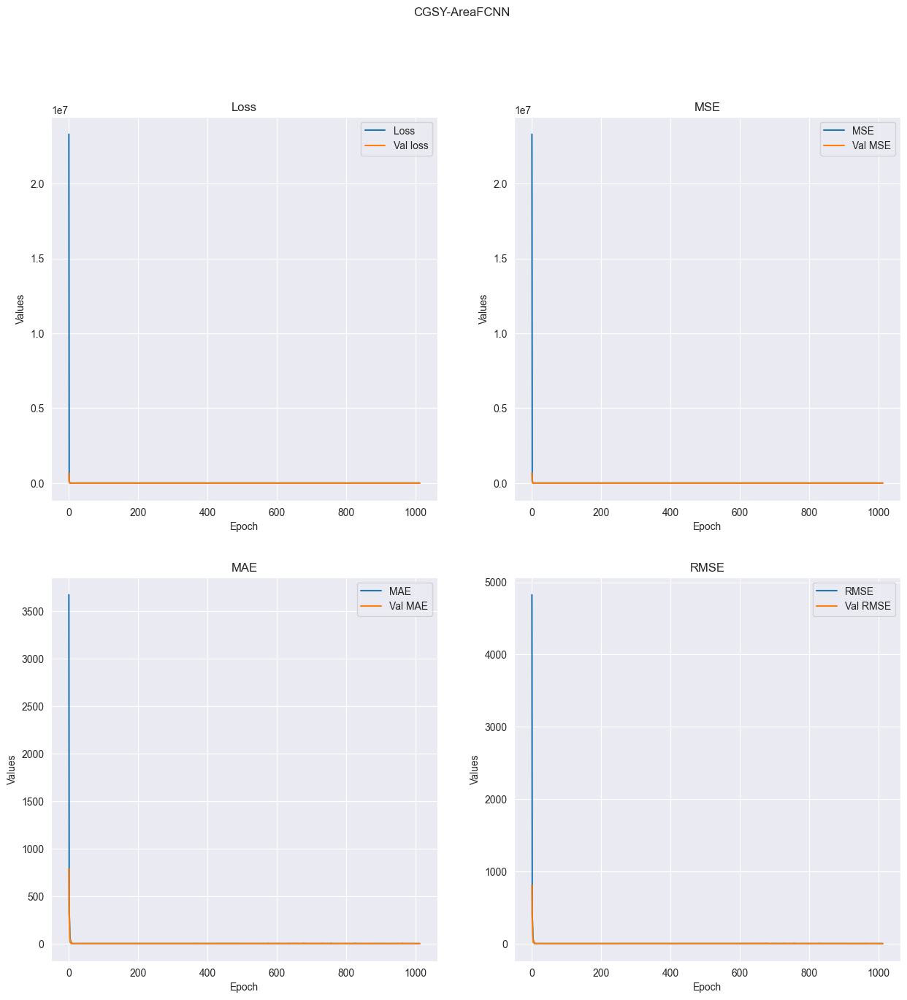

R-squared value: 0.9428


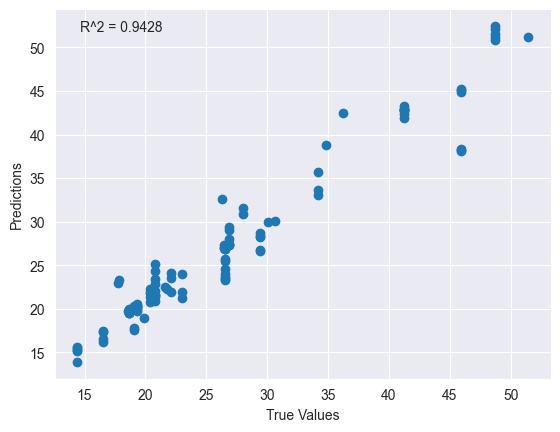

In [123]:

p3 = AutomaticLearning(pd.read_csv("classicgeometryRaspberriesRaw.csv").drop(["Roundness"], axis = 1), "CGRR-AreaLinear")
p3.buildData()
p3.buildModel("linear")
p3.train(2200)
p3.plot()

p1 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaLinear")
p1.buildData()
p1.buildModel("linear")
p1.train(2200)
p1.plot()

p2 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv").drop(["Roundness"], axis = 1), "CGRY-AreaLinear")
p2.buildData()
p2.buildModel("linear")
p2.train(2200)
p2.plot()


p4 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv").drop(["Roundness"], axis = 1), "CGRY-AreaSVR")
p4.buildData()
p4.buildModel("SVR")
p4.train(2200)
p4.plot()


p5 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv"), "CGRY-MLP")
p5.buildData()
p5.buildModel("MLP")
p5.train(5)
p5.plot()

p6 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv"), "CGSY-MLP")
p6.buildData()
p6.buildModel("MLP")
p6.train(5)
p6.plot()


p7 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv"), "CGRY-FCNN")
p7.buildData()
p7.buildModel("FCNN")
p7.train(5)
p7.plot()

p8 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv"), "CGSY-FCNN")
p8.buildData()
p8.buildModel("FCNN")
p8.train(5)
p8.plot()



p9 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p9.buildData()
p9.buildModel("FCNN")
p9.train(50)
p9.plot()


p10 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p10.buildData()
p10.buildModel("FCNN")
p10.train(500)
p10.plot()

p11 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p11.buildData()
p11.buildModel("FCNN")
p11.train(2200)
p11.plot()


